# Projet : Implémentez un modèle de scoring
# Code de modélisation (du prétraitement à la prédiction)
# Partie 1 : Prétraitement
## Imports

In [147]:
# Import des bibliothèques

import pandas as pd
import numpy as np
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [148]:
#Import des données

application_test = pd.read_csv("application_test.csv")
application_train = pd.read_csv("application_train.csv")
bureau = pd.read_csv("bureau.csv")
bureau_balance = pd.read_csv("bureau_balance.csv")
credit_card_balance = pd.read_csv("credit_card_balance.csv")
HomeCredit_columns_description = pd.read_csv("HomeCredit_columns_description.csv", encoding = "ISO-8859-1")
installments_payments = pd.read_csv("installments_payments.csv")
POS_CASH_balance = pd.read_csv("POS_CASH_balance.csv")
previous_application = pd.read_csv("previous_application.csv")
sample_submission = pd.read_csv("sample_submission.csv")

## Analyse des données

In [149]:
for i in range(len(HomeCredit_columns_description["Description"])):
    print(HomeCredit_columns_description["Table"][i])
    print(HomeCredit_columns_description["Row"][i])
    print(HomeCredit_columns_description["Description"][i])
    print("-"*10)

application_{train|test}.csv
SK_ID_CURR
ID of loan in our sample
----------
application_{train|test}.csv
TARGET
Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)
----------
application_{train|test}.csv
NAME_CONTRACT_TYPE
Identification if loan is cash or revolving
----------
application_{train|test}.csv
CODE_GENDER
Gender of the client
----------
application_{train|test}.csv
FLAG_OWN_CAR
Flag if the client owns a car
----------
application_{train|test}.csv
FLAG_OWN_REALTY
Flag if client owns a house or flat
----------
application_{train|test}.csv
CNT_CHILDREN
Number of children the client has
----------
application_{train|test}.csv
AMT_INCOME_TOTAL
Income of the client
----------
application_{train|test}.csv
AMT_CREDIT
Credit amount of the loan
----------
application_{train|test}.csv
AMT_ANNUITY
Loan annuity
----------
application_{train|test}.csv
AM

<ipython-input-150-f419a4285b42>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(application_test.isnull().sum().index,rotation=-90)


<BarContainer object of 121 artists>

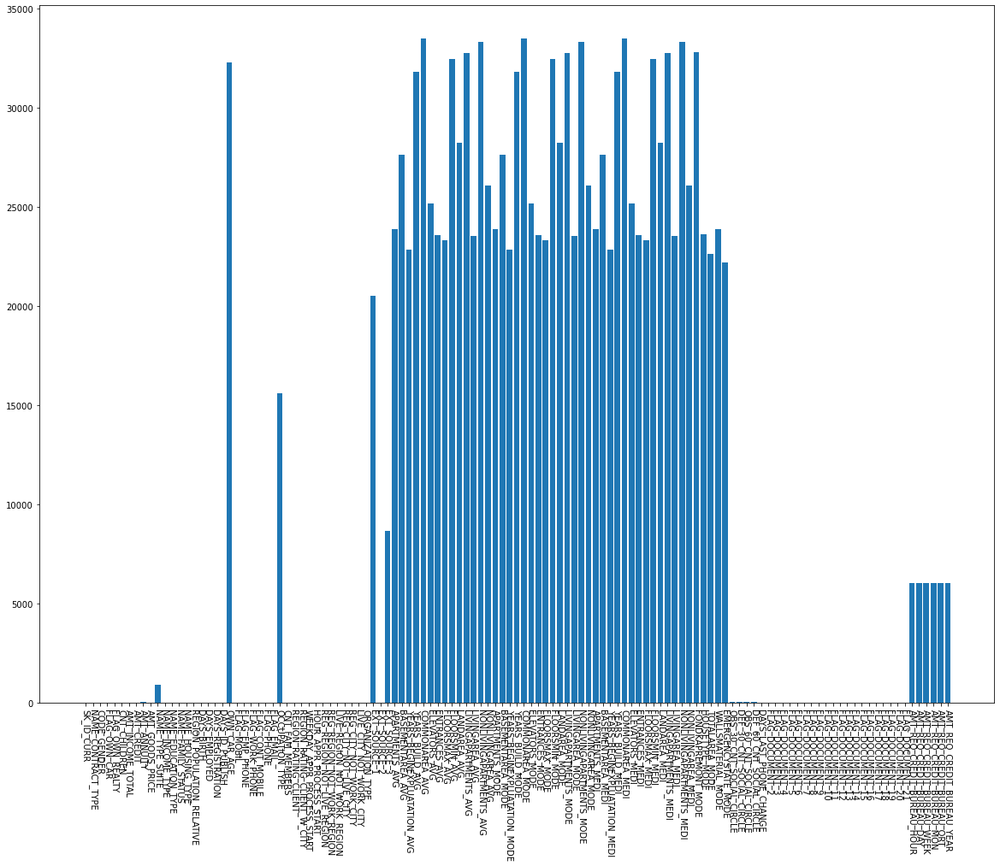

In [150]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(application_test.isnull().sum().index,rotation=-90)
ax.bar(application_test.isnull().sum().index,list(application_test.isnull().sum()))

<ipython-input-151-f53265115579>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(application_train.isnull().sum().index,rotation=-90)


<BarContainer object of 122 artists>

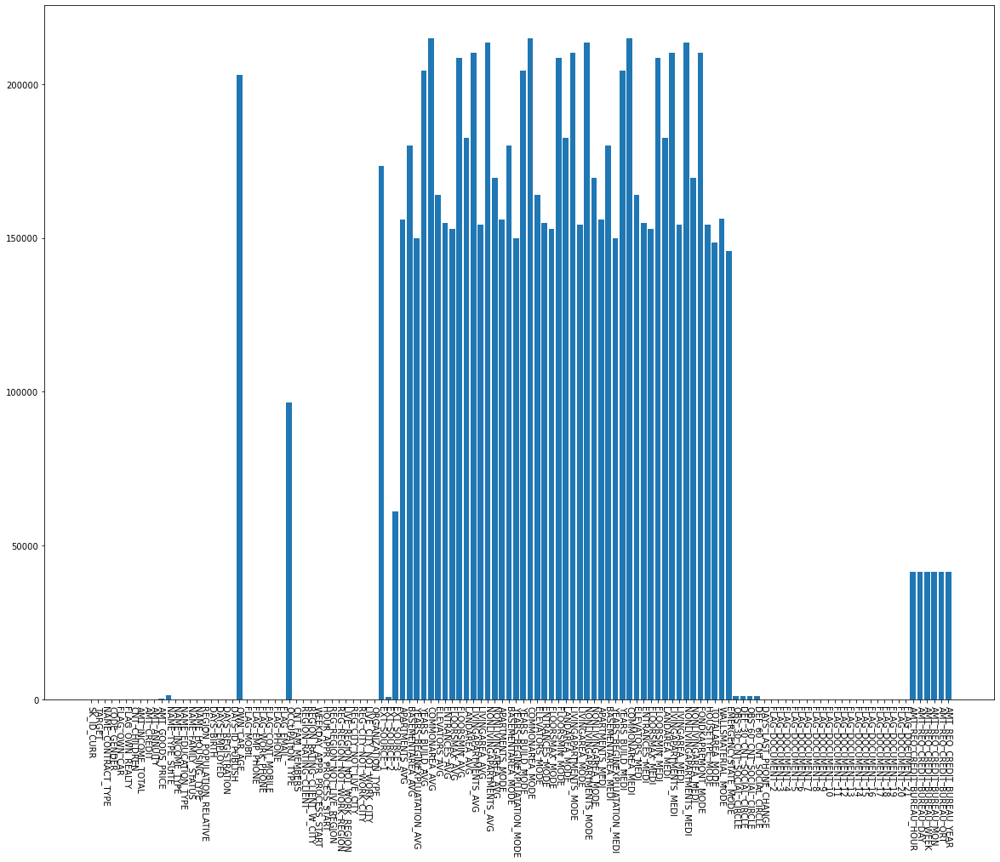

In [151]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(application_train.isnull().sum().index,rotation=-90)
ax.bar(application_train.isnull().sum().index,list(application_train.isnull().sum()))

<ipython-input-152-1f514cb94ab8>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(bureau.isnull().sum().index,rotation=-90)


Text(0.5, 1.0, 'Nombre de nan par colonne dans bureau')

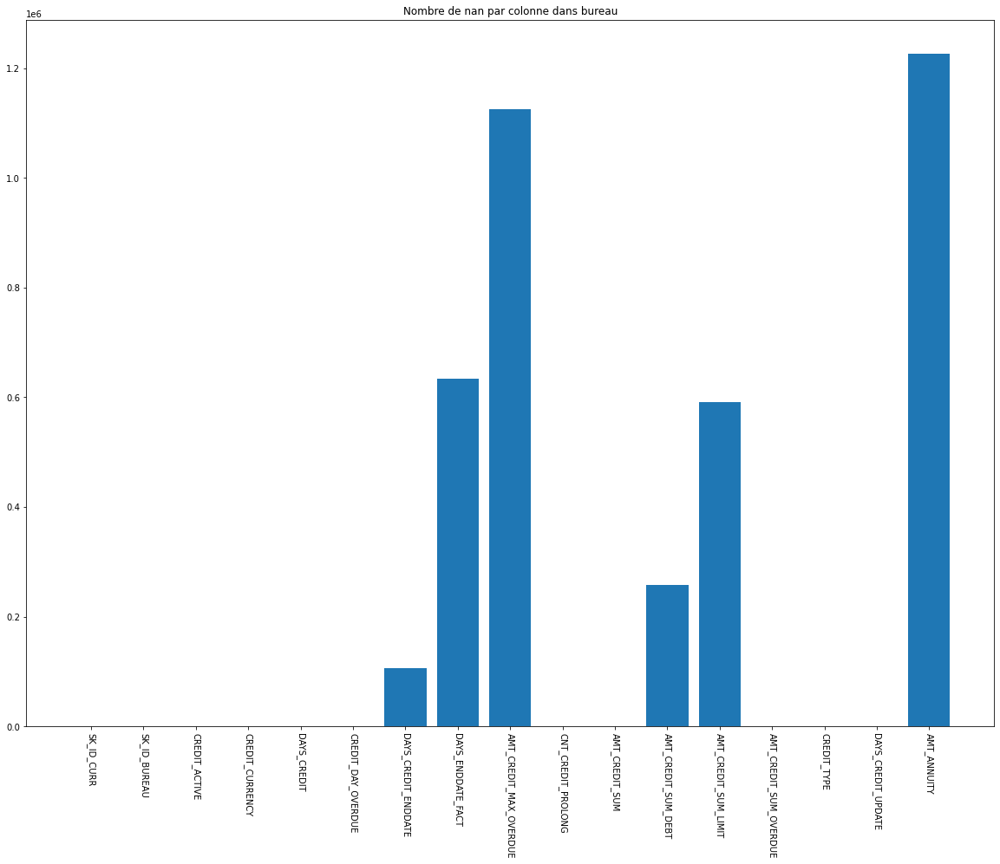

In [152]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(bureau.isnull().sum().index,rotation=-90)
ax.bar(bureau.isnull().sum().index,list(bureau.isnull().sum()))
plt.title("Nombre de nan par colonne dans bureau")

<ipython-input-153-f27867497328>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(bureau_balance.isnull().sum().index,rotation=-90)


<BarContainer object of 3 artists>

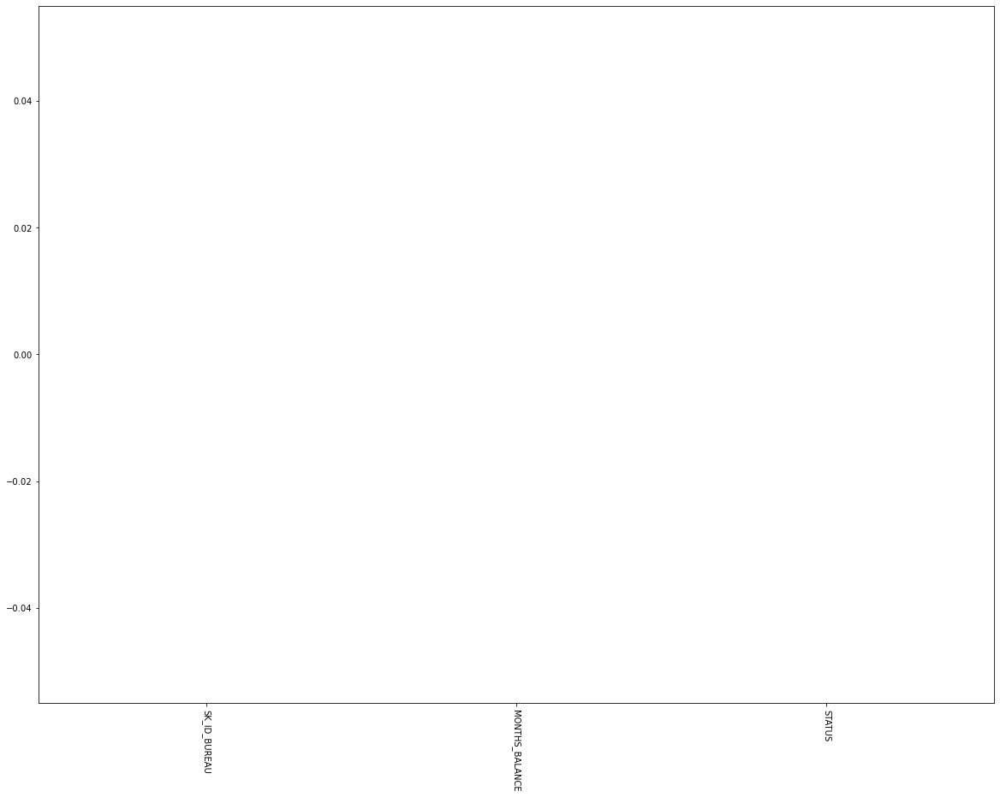

In [153]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(bureau_balance.isnull().sum().index,rotation=-90)
ax.bar(bureau_balance.isnull().sum().index,list(bureau_balance.isnull().sum()))

<ipython-input-154-71d8b6b31aa9>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(credit_card_balance.isnull().sum().index,rotation=-90)


<BarContainer object of 23 artists>

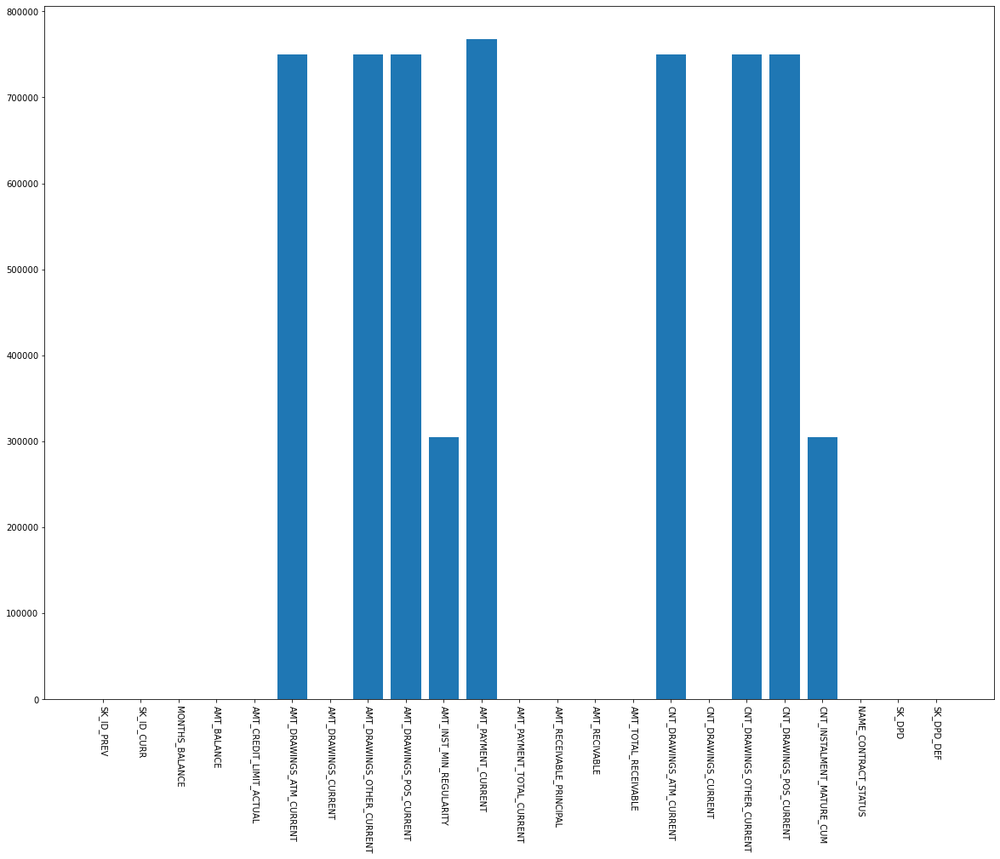

In [154]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(credit_card_balance.isnull().sum().index,rotation=-90)
ax.bar(credit_card_balance.isnull().sum().index,list(credit_card_balance.isnull().sum()))

<ipython-input-155-684538c1f147>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(installments_payments.isnull().sum().index,rotation=-90)


<BarContainer object of 8 artists>

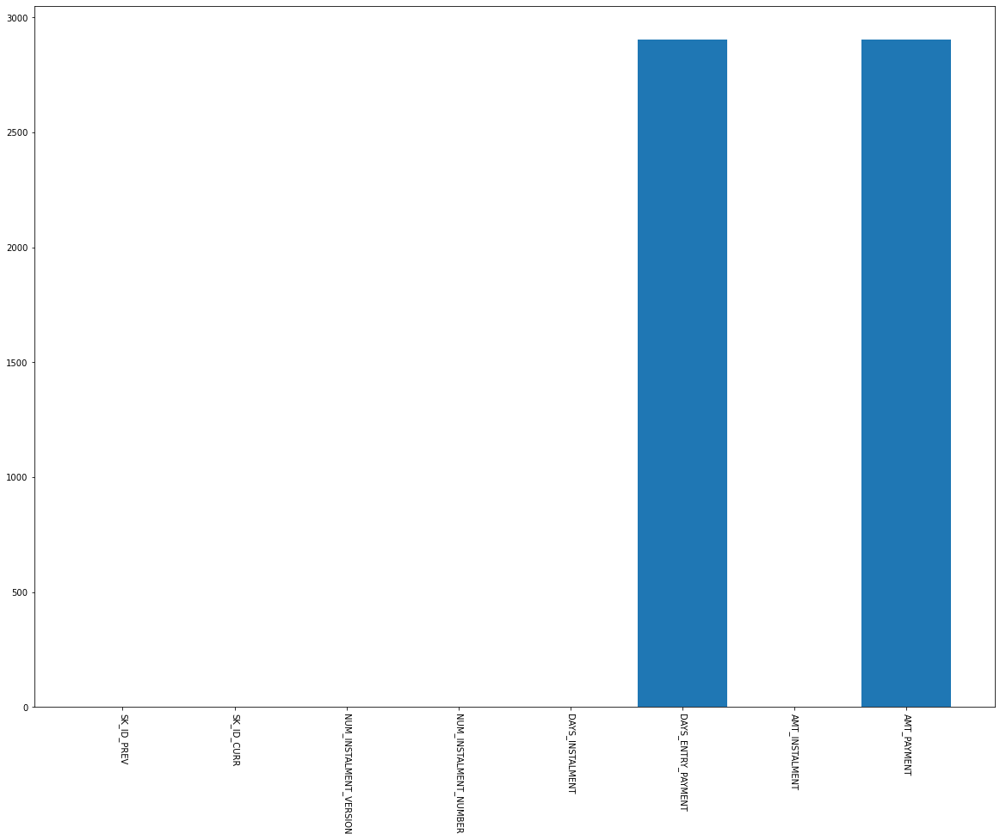

In [155]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(installments_payments.isnull().sum().index,rotation=-90)
ax.bar(installments_payments.isnull().sum().index,list(installments_payments.isnull().sum()))

<ipython-input-156-a715ddd0a0df>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(POS_CASH_balance.isnull().sum().index,rotation=-90)


<BarContainer object of 8 artists>

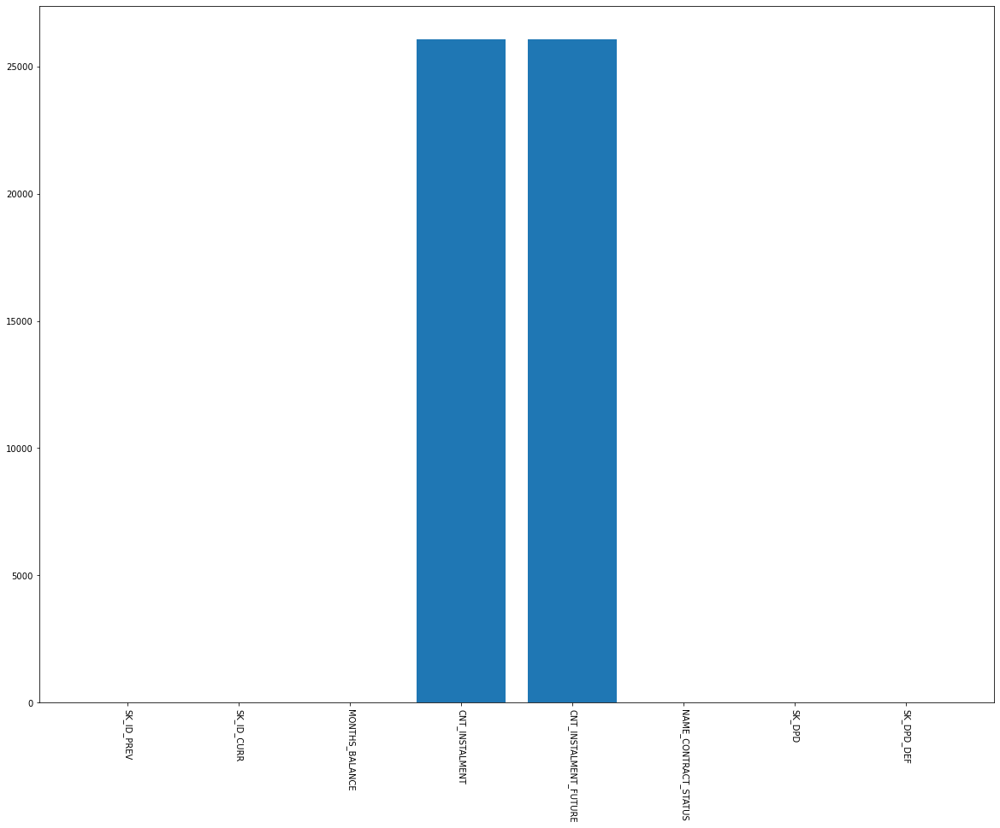

In [156]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(POS_CASH_balance.isnull().sum().index,rotation=-90)
ax.bar(POS_CASH_balance.isnull().sum().index,list(POS_CASH_balance.isnull().sum()))

<ipython-input-157-d31b48c7a97b>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(previous_application.isnull().sum().index,rotation=-90)


<BarContainer object of 37 artists>

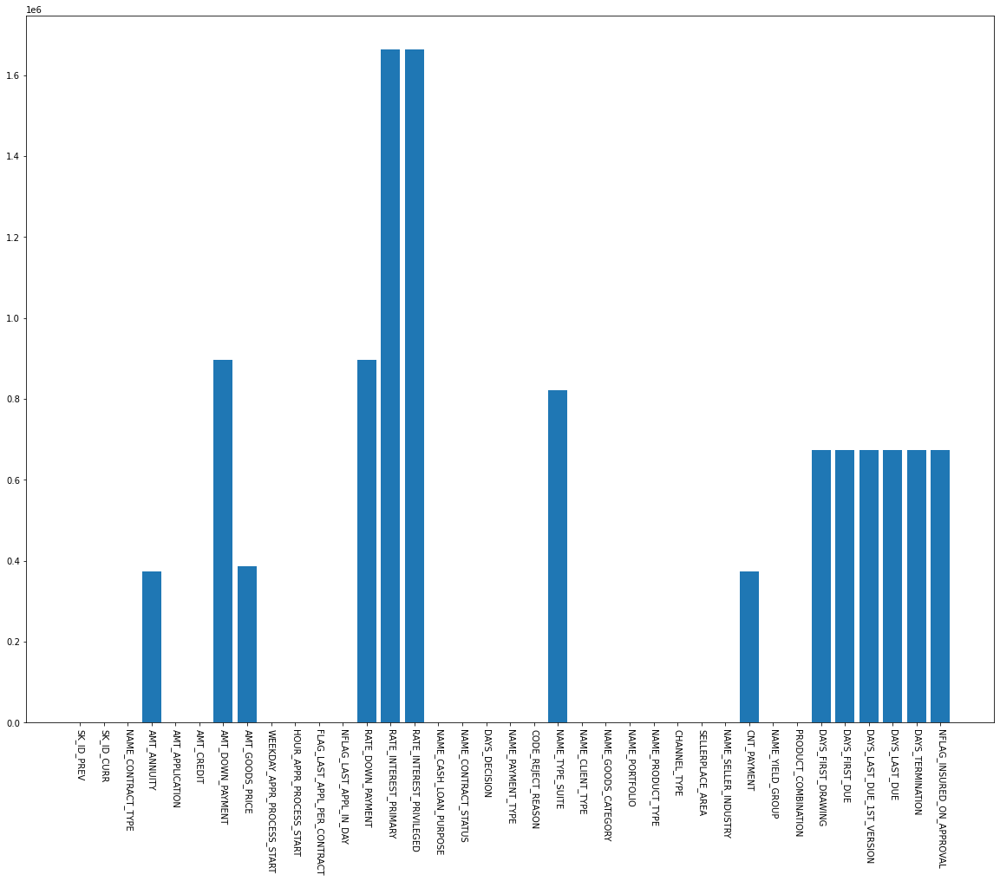

In [157]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(previous_application.isnull().sum().index,rotation=-90)
ax.bar(previous_application.isnull().sum().index,list(previous_application.isnull().sum()))

<ipython-input-158-85979844461d>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(sample_submission.isnull().sum().index,rotation=-90)


<BarContainer object of 2 artists>

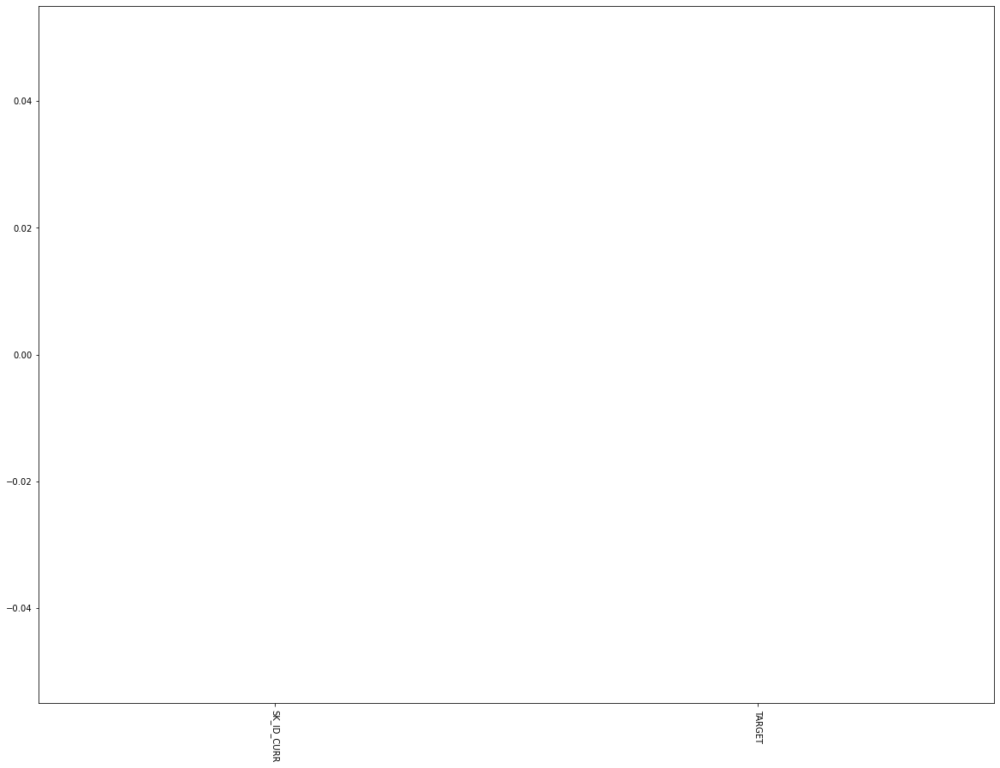

In [158]:
# Mesure : nombre de nan
fig = plt.figure(figsize=(20,15))
ax = plt.axes()
ax.set_xticklabels(sample_submission.isnull().sum().index,rotation=-90)
ax.bar(sample_submission.isnull().sum().index,list(sample_submission.isnull().sum()))

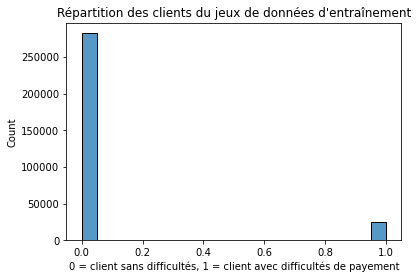

In [159]:
# Répartition de la variable cible :
sns.histplot(application_train['TARGET'])
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

## Gestion des valeurs aberrantes

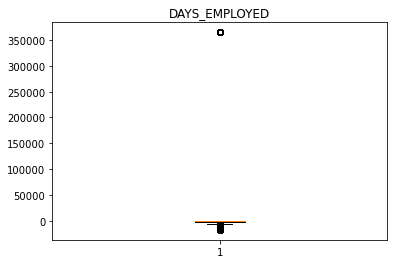

In [160]:
plt.boxplot(application_train[application_train['DAYS_EMPLOYED'].notnull()]['DAYS_EMPLOYED'])
plt.title('DAYS_EMPLOYED')
plt.show()

In [161]:
# Un problème :
application_train[application_train['DAYS_EMPLOYED']>50000]['DAYS_EMPLOYED'].value_counts()

365243    55374
Name: DAYS_EMPLOYED, dtype: int64

In [162]:
# NaN values for DAYS_EMPLOYED: 365 243 -> nan
application_train['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)

In [163]:
# Remove 4 applications with XNA CODE_GENDER (train set)
print("removing the applications with XNA CODE_GENDER :", application_train[application_train['CODE_GENDER'] == 'XNA'].shape)
application_train = application_train[application_train['CODE_GENDER'] != 'XNA']

removing the applications with XNA CODE_GENDER : (4, 122)


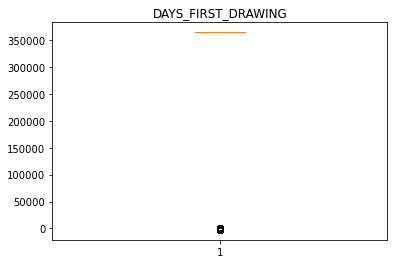

In [164]:
plt.boxplot(previous_application[previous_application['DAYS_FIRST_DRAWING'].notnull()]['DAYS_FIRST_DRAWING'])
plt.title('DAYS_FIRST_DRAWING')
plt.show()

In [165]:
print(previous_application[previous_application['DAYS_FIRST_DRAWING']>50000]['DAYS_FIRST_DRAWING'].value_counts())
print(previous_application[previous_application['DAYS_FIRST_DUE']>50000]['DAYS_FIRST_DUE'].value_counts())
print(previous_application[previous_application['DAYS_LAST_DUE_1ST_VERSION']>50000]['DAYS_LAST_DUE_1ST_VERSION'].value_counts())
print(previous_application[previous_application['DAYS_LAST_DUE']>50000]['DAYS_LAST_DUE'].value_counts())
print(previous_application[previous_application['DAYS_TERMINATION']>50000]['DAYS_TERMINATION'].value_counts())

365243.0    934444
Name: DAYS_FIRST_DRAWING, dtype: int64
365243.0    40645
Name: DAYS_FIRST_DUE, dtype: int64
365243.0    93864
Name: DAYS_LAST_DUE_1ST_VERSION, dtype: int64
365243.0    211221
Name: DAYS_LAST_DUE, dtype: int64
365243.0    225913
Name: DAYS_TERMINATION, dtype: int64


In [166]:
# Days 365.243 values -> nan
previous_application['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
previous_application['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
previous_application['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
previous_application['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
previous_application['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)

## Traitement des valeurs manquantes

In [167]:
matrices = [application_train, bureau, credit_card_balance, 
            installments_payments, POS_CASH_balance, previous_application]   
# sample_submission,bureau_balance : pas de nan
# application_test : pas utilisé

In [168]:
def remplissage_col(df,cut=0.1):
    base = len(df[df.columns[0]])
    col_short = []
    for i in df.columns:
        if len(df[df[i].notnull()][i])/base < cut:
            col_short += [i]
    print(len(col_short),'sur',len(df.columns))
    return col_short

In [169]:
for i in matrices :
    remplissage_col(i,cut=0.85)

52 sur 122
5 sur 17
7 sur 23
0 sur 8
0 sur 8
14 sur 37


In [170]:
application_train.drop(remplissage_col(application_train,cut=0.85), axis=1, inplace= True)
bureau.drop(remplissage_col(bureau,cut=0.85), axis=1, inplace= True)
credit_card_balance.drop(remplissage_col(credit_card_balance,cut=0.85), axis=1, inplace= True) 
previous_application.drop(remplissage_col(previous_application,cut=0.85), axis=1, inplace= True)

52 sur 122
5 sur 17
7 sur 23
14 sur 37


In [171]:
def nbcolnul(df):
    base_col = len(df.columns)
    base_line = len(df[df.columns[0]])
    col_nul = []
    nbnull = []
    n=0
    for i in df.columns:
        num = df[i].isnull().sum()
        if num > 0:
            col_nul += [i]
            nbnull += [num]
    return [col_nul,base_col,nbnull,base_line]

In [172]:
for i in matrices:
    a,b,c,d=nbcolnul(i)
    print(len(a),'colonnes avec null sur',b)
    print(c,'null dans les colonnes sur',d)

16 colonnes avec null sur 70
[12, 278, 1292, 2, 660, 1021, 1021, 1021, 1021, 1, 41519, 41519, 41519, 41519, 41519, 41519] null dans les colonnes sur 307507
2 colonnes avec null sur 12
[105553, 13] null dans les colonnes sur 1716428
2 colonnes avec null sur 16
[305236, 305236] null dans les colonnes sur 3840312
2 colonnes avec null sur 8
[2905, 2905] null dans les colonnes sur 13605401
2 colonnes avec null sur 8
[26071, 26087] null dans les colonnes sur 10001358
2 colonnes avec null sur 23
[1, 346] null dans les colonnes sur 1670214


In [173]:
col1=nbcolnul(application_train)[0]
print(application_train.shape)
application_train[application_train[col1[0]].isnull()|application_train[col1[1]].isnull()|
                  application_train[col1[2]].isnull()|application_train[col1[3]].isnull()|
                  application_train[col1[4]].isnull()|application_train[col1[5]].isnull()|
                  application_train[col1[6]].isnull()|application_train[col1[7]].isnull()|
                  application_train[col1[8]].isnull()|application_train[col1[9]].isnull()|
                  application_train[col1[10]].isnull()|application_train[col1[11]].isnull()|
                  application_train[col1[12]].isnull()|application_train[col1[13]].isnull()|
                  application_train[col1[14]].isnull()|application_train[col1[15]].isnull()].shape

(307507, 70)


(44088, 70)

In [174]:
# Au final on a 44088 lignes avec des null sur 307507 => on va drop les lignes avec des null
application_train.dropna(how='any',axis=0, inplace = True)

In [175]:
nbcolnul(application_train)

[[], 70, [], 263419]

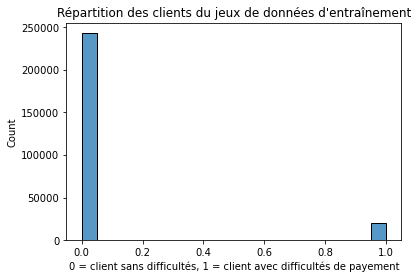

In [176]:
#Vérification : la répartition de target n'a pas changé.
sns.histplot(application_train['TARGET'])
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

In [177]:
col2=nbcolnul(bureau)[0]
print(bureau.shape)
print(bureau[bureau[col2[0]].isnull()|bureau[col2[1]].isnull()].shape)

(1716428, 12)
(105557, 12)


In [178]:
# Au final on a 105557 lignes avec des null sur 1716428 => on va drop les lignes avec des null
bureau.dropna(how='any',axis=0, inplace = True)

In [179]:
col3=nbcolnul(credit_card_balance)[0]
print(credit_card_balance.shape)
print(credit_card_balance[credit_card_balance[col3[0]].isnull()|credit_card_balance[col3[1]].isnull()].shape)

(3840312, 16)
(305236, 16)


In [180]:
# Au final on a 305236 lignes avec des null sur 3840312 => on va drop les lignes avec des null
credit_card_balance.dropna(how='any',axis=0, inplace = True)

In [181]:
col4=nbcolnul(installments_payments)[0]
print(installments_payments.shape)
print(installments_payments[installments_payments[col4[0]].isnull()|installments_payments[col4[1]].isnull()].shape)

(13605401, 8)
(2905, 8)


In [182]:
# Au final on a 2905 lignes avec des null sur 13605401 => on va drop les lignes avec des null
installments_payments.dropna(how='any',axis=0, inplace = True)

In [183]:
col5=nbcolnul(POS_CASH_balance)[0]
print(POS_CASH_balance.shape)
print(POS_CASH_balance[POS_CASH_balance[col5[0]].isnull()|POS_CASH_balance[col5[1]].isnull()].shape)

(10001358, 8)
(26184, 8)


In [184]:
# Au final on a 26184 lignes avec des null sur 10001358 => on va drop les lignes avec des null
POS_CASH_balance.dropna(how='any',axis=0, inplace = True)

In [185]:
col6=nbcolnul(previous_application)[0]
print(previous_application.shape)
print(previous_application[previous_application[col6[0]].isnull()|previous_application[col6[1]].isnull()].shape)

(1670214, 23)
(347, 23)


In [186]:
# Au final on a 347 lignes avec des null sur 1670214 => on va drop les lignes avec des null
previous_application.dropna(how='any',axis=0, inplace = True)

In [187]:
#Annulé
# On remplace les valeurs manquantes par la médiane après le one-hot encoding et le retrait des valeurs aberrantes
#for i in nbcolnul(application_test)[0]:
#    application_test[i] = application_test[i].fillna(application_test[i].median())

In [188]:
# Vérification : plus de null :
for i in matrices:
    a,b,c,d=nbcolnul(i)
    print(len(a),'colonnes avec null sur',b)
    print(c,'null dans les colonnes sur',d)

0 colonnes avec null sur 70
[] null dans les colonnes sur 263419
0 colonnes avec null sur 12
[] null dans les colonnes sur 1610871
0 colonnes avec null sur 16
[] null dans les colonnes sur 3535076
0 colonnes avec null sur 8
[] null dans les colonnes sur 13602496
0 colonnes avec null sur 8
[] null dans les colonnes sur 9975174
0 colonnes avec null sur 23
[] null dans les colonnes sur 1669867


## Préprocessing puis fusion des tables

In [189]:
# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = False):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

In [190]:
# Preprocess application_train
num_rows = None
nan_as_category = False
# Read data and merge
print("Train samples: {}, test samples: {}".format(len(application_train), len(application_test)))
df = application_train  #.append(application_test).reset_index() # On n'utilise pas les données de test

Train samples: 263419, test samples: 48744


In [191]:
# Vérification : identifiants uniques pour les merges
df['SK_ID_CURR'].value_counts()

100303    1
185359    1
279517    1
281564    1
287705    1
         ..
179709    1
177660    1
167419    1
165370    1
106548    1
Name: SK_ID_CURR, Length: 263419, dtype: int64

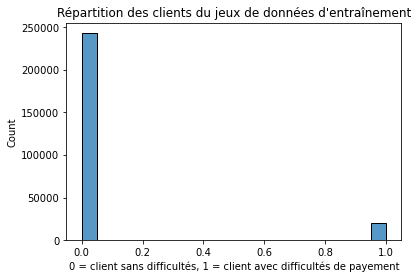

In [192]:
# Répartition bon/mauvais clients

sns.histplot(df['TARGET'])
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

In [193]:
# Categorical features with Binary encode (0 or 1; two categories)
for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
    df[bin_feature], uniques = pd.factorize(df[bin_feature])
# Categorical features with One-Hot encode
df, cat_cols = one_hot_encoder(df, nan_as_category)

In [194]:
# Vérification : on n'a pas créé de trous
nbcolnul(df)

[[], 160, [], 263419]

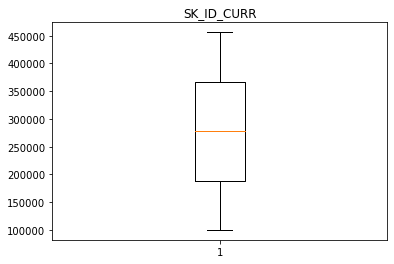

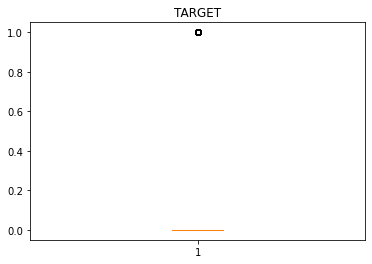

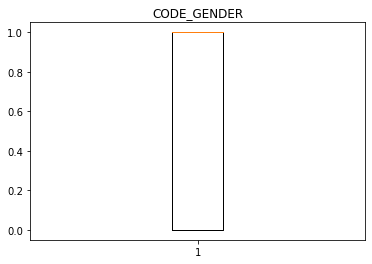

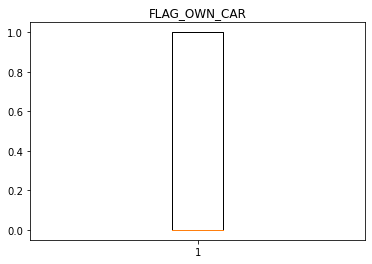

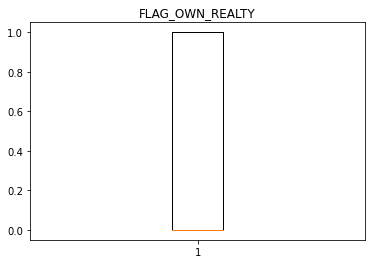

...

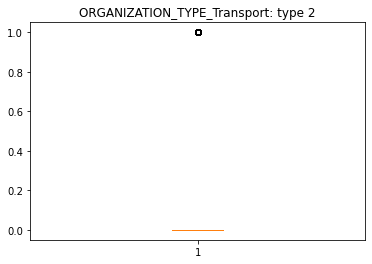

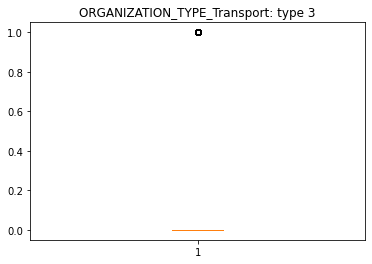

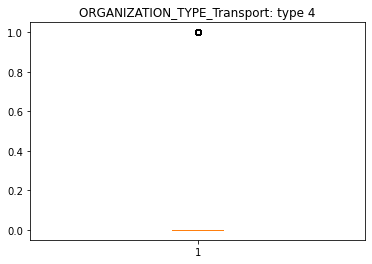

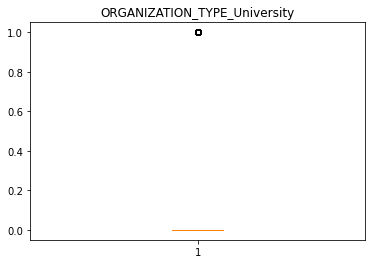

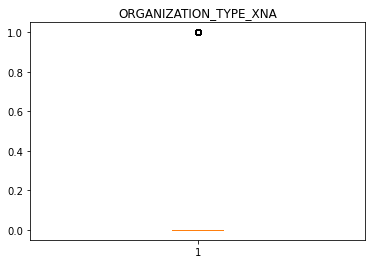

In [195]:
# Boxplot des variables :

for i in df.columns:
    plt.boxplot(df[i])
    plt.title(i)
    plt.show()

In [196]:
# Preprocess bureau.csv and bureau_balance.csv
num_rows = None
nan_as_category = True
bb = bureau_balance
bb, bb_cat = one_hot_encoder(bb, nan_as_category)
bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)

In [197]:
# Bureau and bureau_balance numeric features
num_aggregations = {
    'DAYS_CREDIT': ['mean'],
    'DAYS_CREDIT_ENDDATE': ['mean'],
    'DAYS_CREDIT_UPDATE': ['mean'],
    'CREDIT_DAY_OVERDUE': ['mean'],
    'AMT_CREDIT_SUM': ['sum'],
    'AMT_CREDIT_SUM_OVERDUE': ['mean'],
    'CNT_CREDIT_PROLONG': ['sum'],
}
# Bureau and bureau_balance categorical features
cat_aggregations = {}
for cat in bureau_cat: cat_aggregations[cat] = ['mean']
#for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']

bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])

In [198]:
nbcolnul(bureau_agg)

[[], 33, [], 303225]

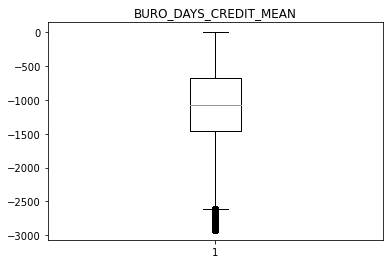

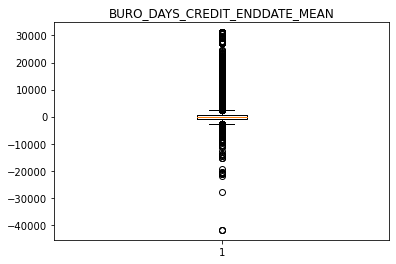

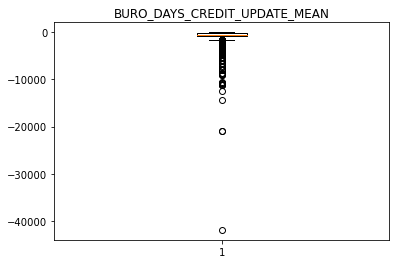

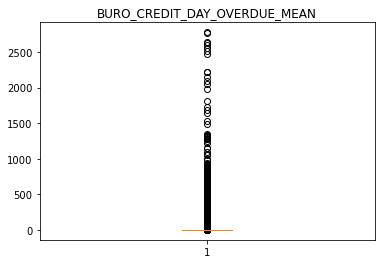

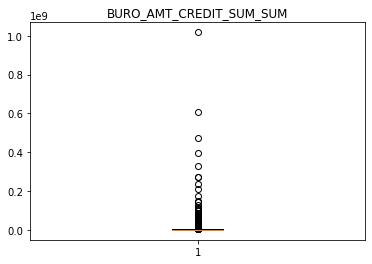

...

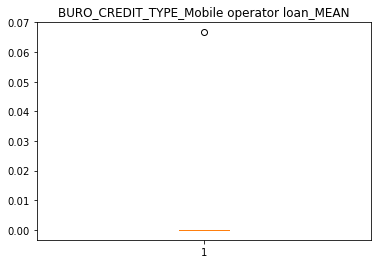

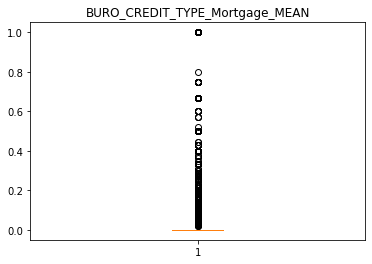

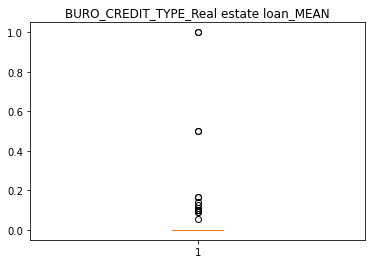

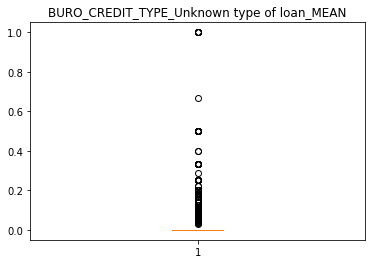

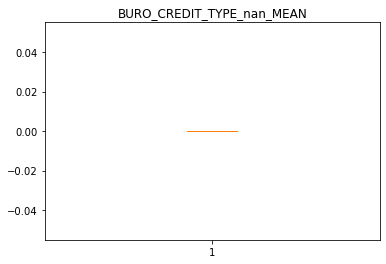

In [199]:
# Boxplot des variables :

for i in bureau_agg.columns:
    plt.boxplot(bureau_agg[i])
    plt.title(i)
    plt.show()

In [200]:
# Preprocess previous_applications.csv
num_rows = None
nan_as_category = True
prev = previous_application
prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)

In [201]:
# Previous applications numeric features
num_aggregations = {
    'AMT_APPLICATION': ['min', 'max', 'mean'],
    'AMT_CREDIT': ['min', 'max', 'mean'],
    'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
    'DAYS_DECISION': ['min', 'max', 'mean'],
}
# Previous applications categorical features
cat_aggregations = {}
for cat in cat_cols:
    cat_aggregations[cat] = ['mean']

prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])

In [202]:
nbcolnul(prev_agg)

[[], 162, [], 338857]

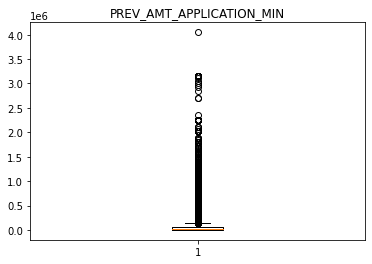

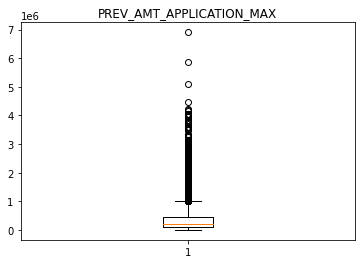

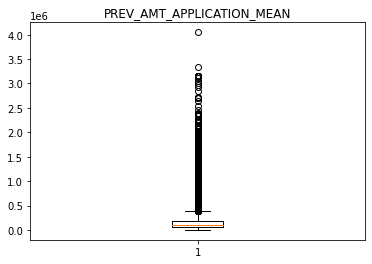

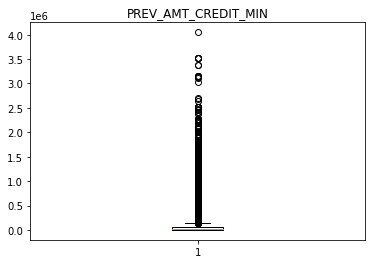

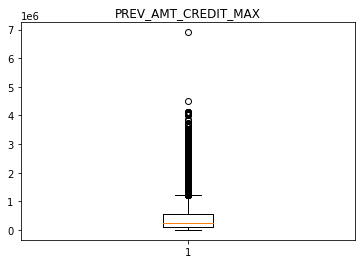

...

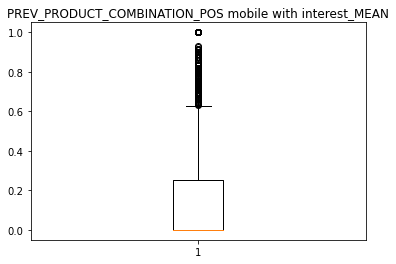

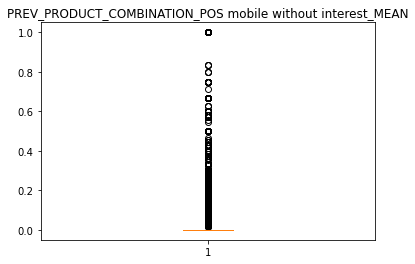

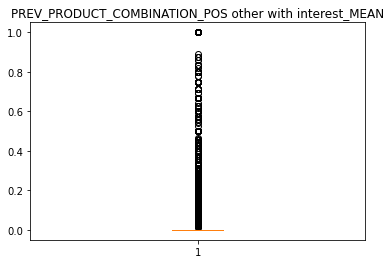

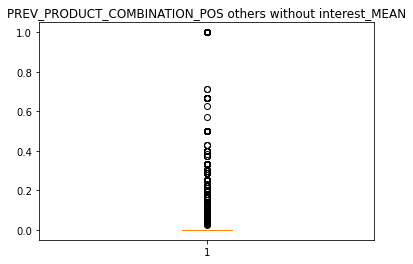

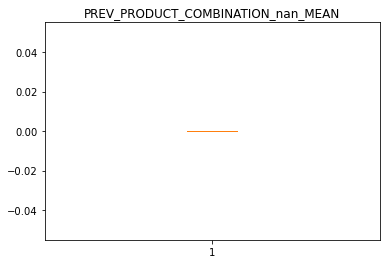

In [203]:
# Boxplot des variables :

for i in prev_agg.columns:
    plt.boxplot(prev_agg[i])
    plt.title(i)
    plt.show()

In [204]:
# Preprocess POS_CASH_balance.csv
num_rows = None
nan_as_category = True
pos = POS_CASH_balance
pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)

In [205]:
# Features
aggregations = {
    'MONTHS_BALANCE': ['max', 'mean', 'size'],
    'SK_DPD': ['max', 'mean'],
    'SK_DPD_DEF': ['max', 'mean']
}
for cat in cat_cols:
    aggregations[cat] = ['mean']

pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
# Count pos cash accounts
pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()

In [206]:
nbcolnul(pos_agg)

[[], 17, [], 337224]

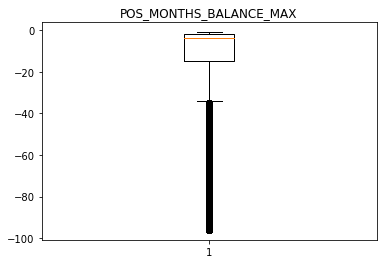

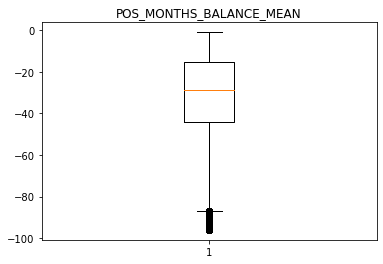

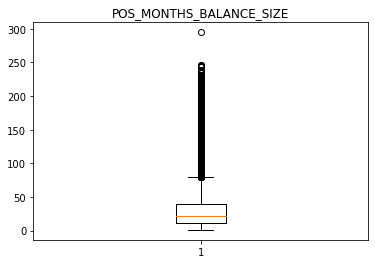

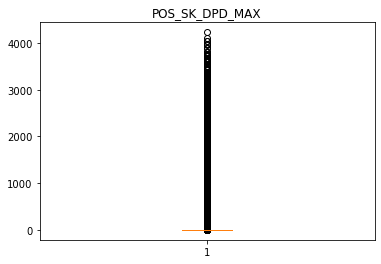

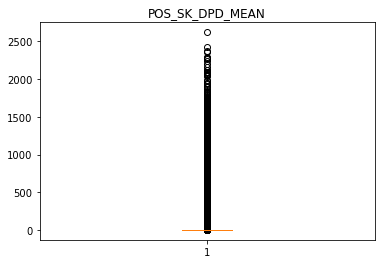

...

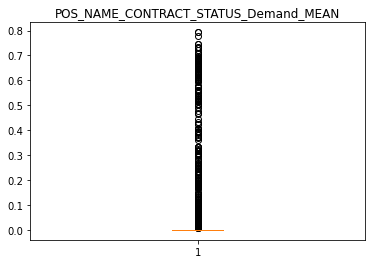

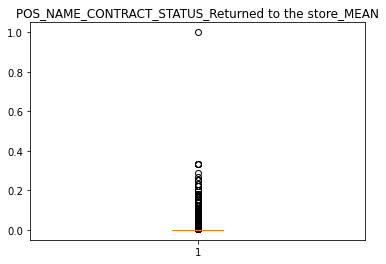

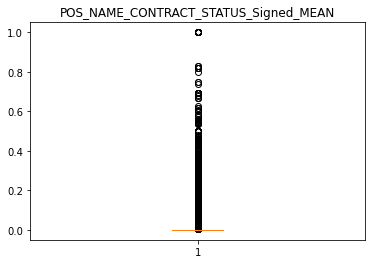

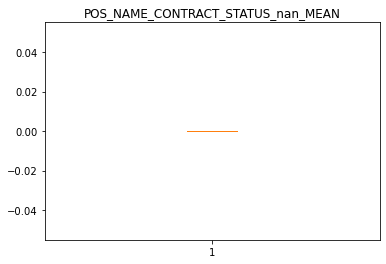

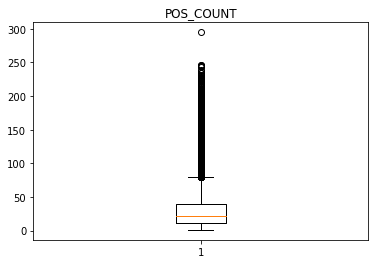

In [207]:
# Boxplot des variables :

for i in pos_agg.columns:
    plt.boxplot(pos_agg[i])
    plt.title(i)
    plt.show()

In [208]:
# Preprocess installments_payments.csv
num_rows = None
nan_as_category = True
ins = installments_payments
ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)

In [209]:
# Difference paid in each installment (amount paid and installment value)
ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
# Days past due and days before due (no negative values)
ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)

In [210]:
# Features: Perform aggregations
aggregations = {
    'NUM_INSTALMENT_VERSION': ['nunique'],
    'DPD': ['max', 'mean', 'sum'],
    'DBD': ['max', 'mean', 'sum'],
    'PAYMENT_DIFF': ['max', 'mean', 'sum'],
    'AMT_INSTALMENT': ['max', 'mean', 'sum'],
    'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
    'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
}
for cat in cat_cols:
    aggregations[cat] = ['mean']
ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
# Count installments accounts
ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()

In [211]:
nbcolnul(ins_agg)

[[], 21, [], 339578]

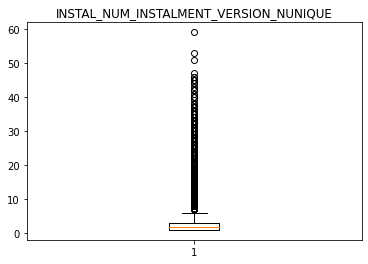

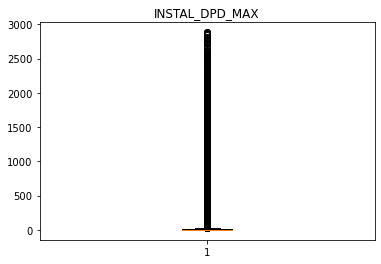

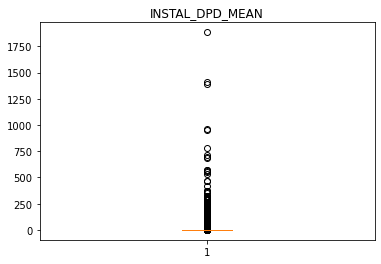

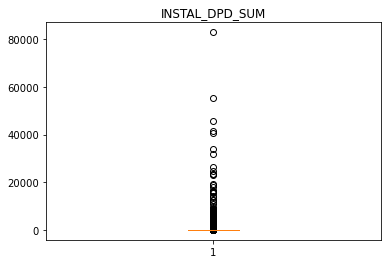

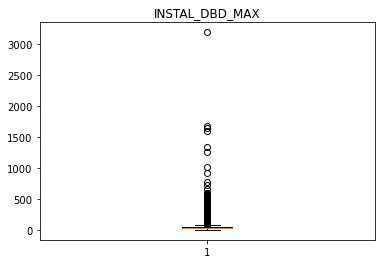

...

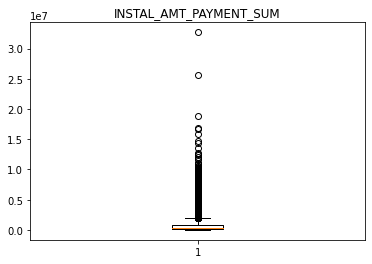

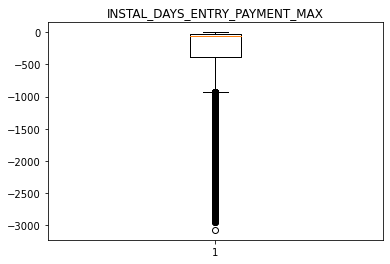

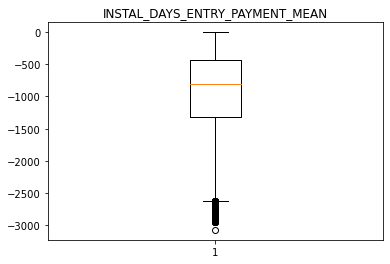

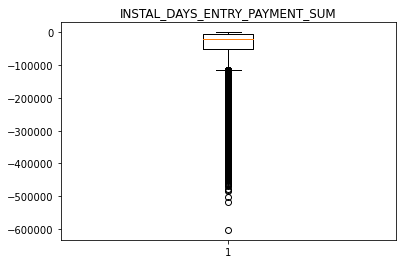

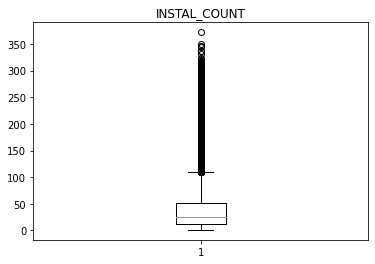

In [212]:
# Boxplot des variables :

for i in ins_agg.columns:
    plt.boxplot(ins_agg[i])
    plt.title(i)
    plt.show()

In [213]:
# Preprocess credit_card_balance.csv
num_rows = None
nan_as_category = True
cc = credit_card_balance
cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)

In [214]:
nbcolnul(cc)

[[], 20, [], 3535076]

In [215]:
# General aggregations
cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum'])
cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
# Count credit card lines
cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()

In [216]:
nbcolnul(cc_agg)

[[], 73, [], 103558]

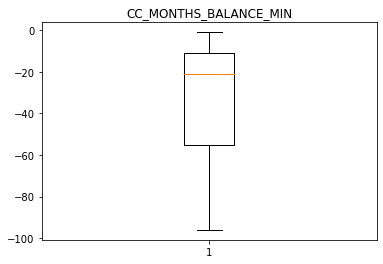

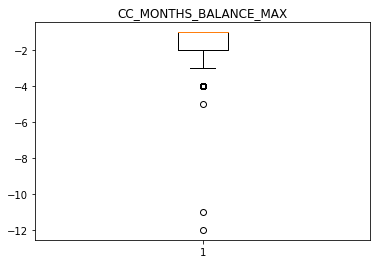

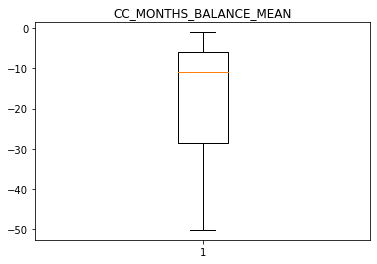

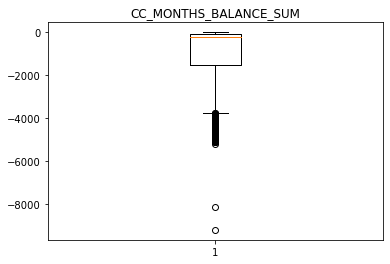

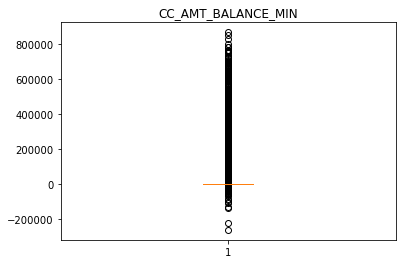

...

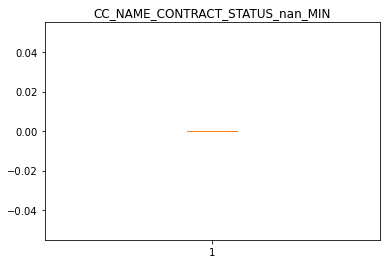

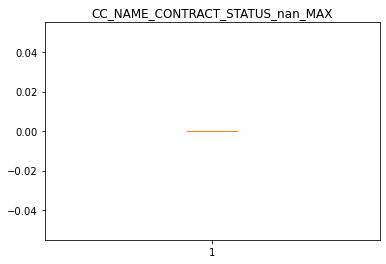

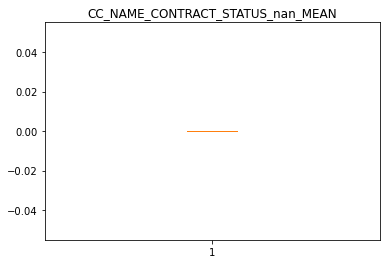

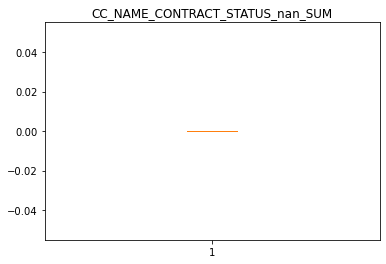

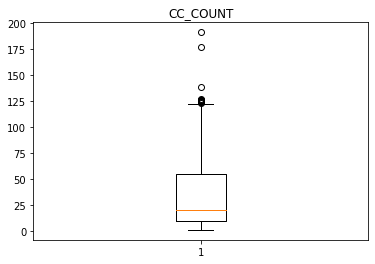

In [217]:
# Boxplot des variables :

for i in cc_agg.columns:
    plt.boxplot(cc_agg[i])
    plt.title(i)
    plt.show()

In [218]:
# Les jointures finales :
df = df.join(bureau_agg, how='inner', on='SK_ID_CURR')
print(nbcolnul(df))
df = df.join(prev_agg, how='inner', on='SK_ID_CURR')
print(nbcolnul(df))
df = df.join(pos_agg, how='inner', on='SK_ID_CURR')
print(nbcolnul(df))
df = df.join(ins_agg, how='inner', on='SK_ID_CURR')
print(nbcolnul(df))
df2 = df.join(cc_agg, how='inner', on='SK_ID_CURR')
print(nbcolnul(df2))
# On a trop peu de lignes restantes si on garde les données des cartes de crédit.

[[], 193, [], 258737]
[[], 355, [], 245621]
[[], 372, [], 243394]
[[], 393, [], 243196]
[[], 466, [], 72024]


In [219]:
df

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,INSTAL_AMT_INSTALMENT_MEAN,INSTAL_AMT_INSTALMENT_SUM,INSTAL_AMT_PAYMENT_MIN,INSTAL_AMT_PAYMENT_MAX,INSTAL_AMT_PAYMENT_MEAN,INSTAL_AMT_PAYMENT_SUM,INSTAL_DAYS_ENTRY_PAYMENT_MAX,INSTAL_DAYS_ENTRY_PAYMENT_MEAN,INSTAL_DAYS_ENTRY_PAYMENT_SUM,INSTAL_COUNT
0,100002,1,0,0,0,0,202500.0,406597.5,24700.5,351000.0,...,11559.247105,219625.695,9251.775,53093.745,11559.247105,219625.695,-49.0,-315.421053,-5993.0,19
1,100003,0,1,0,1,0,270000.0,1293502.5,35698.5,1129500.0,...,64754.586000,1618864.650,6662.970,560835.360,64754.586000,1618864.650,-544.0,-1385.320000,-34633.0,25
2,100004,0,0,1,0,0,67500.0,135000.0,6750.0,135000.0,...,7096.155000,21288.465,5357.250,10573.965,7096.155000,21288.465,-727.0,-761.666667,-2285.0,3
4,100007,0,0,0,0,0,121500.0,513000.0,21865.5,513000.0,...,12666.444545,835985.340,0.180,22678.785,12214.060227,806127.975,-14.0,-1032.242424,-68128.0,66
5,100008,0,0,0,0,0,99000.0,490495.5,27517.5,454500.0,...,27702.964286,969603.750,227.160,432218.295,27360.502714,957617.595,-82.0,-1237.800000,-43323.0,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307503,456247,0,1,0,0,0,112500.0,345510.0,17770.5,247500.0,...,5685.241231,761822.325,43.830,90990.000,5685.241231,761822.325,-34.0,-1606.014925,-215206.0,134
307505,456249,0,1,0,0,0,112500.0,225000.0,22050.0,225000.0,...,22771.410000,273256.920,22770.405,22782.465,22771.410000,273256.920,-1168.0,-1332.500000,-15990.0,12
307508,456253,0,1,0,0,0,153000.0,677664.0,29979.0,585000.0,...,4399.707857,61595.910,27.270,5575.185,4115.915357,57622.815,-1738.0,-2387.428571,-33424.0,14
307509,456254,1,1,0,0,0,171000.0,370107.0,20205.0,319500.0,...,10239.832895,194556.825,2296.440,19065.825,10239.832895,194556.825,-18.0,-161.263158,-3064.0,19


<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


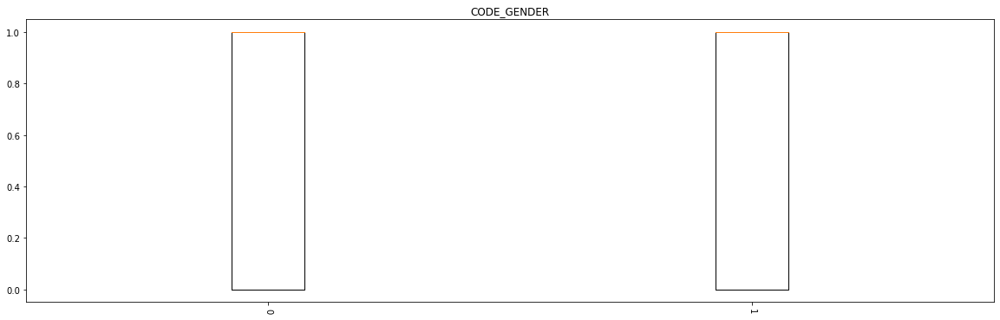

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


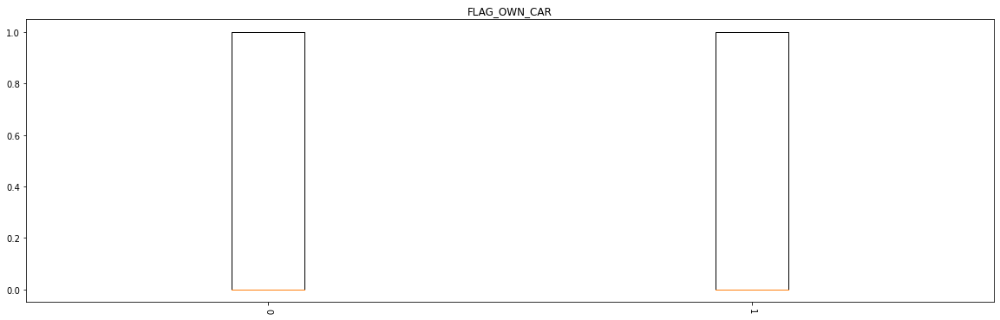

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


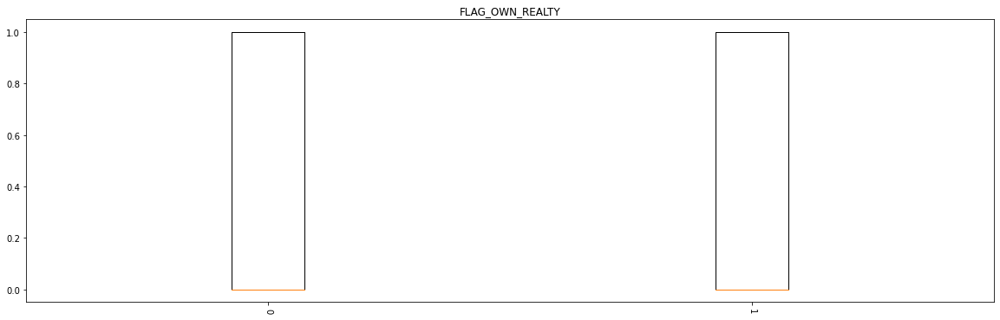

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


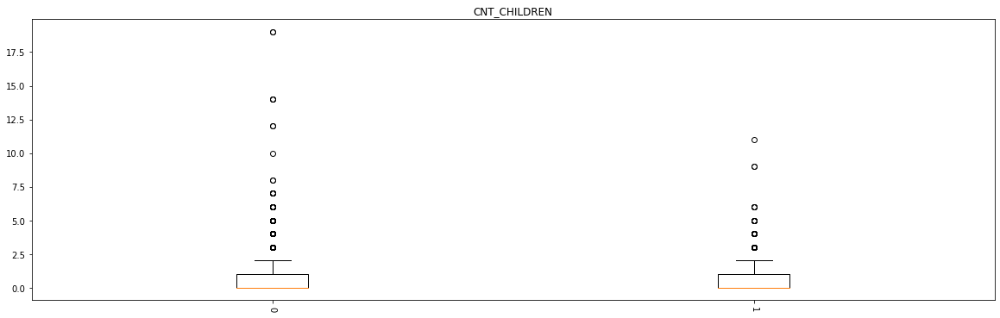

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


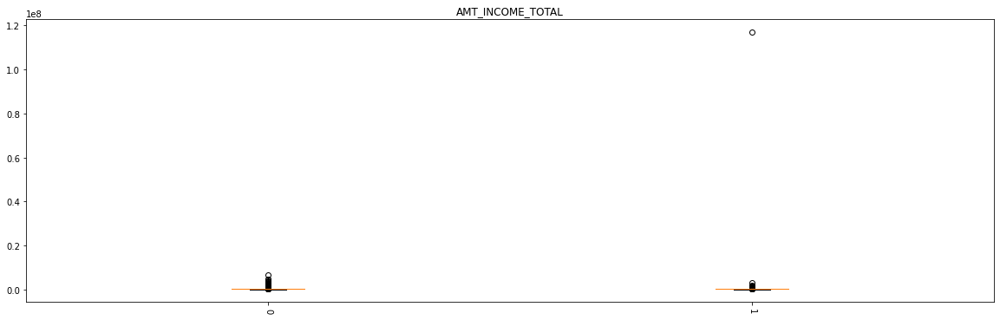

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


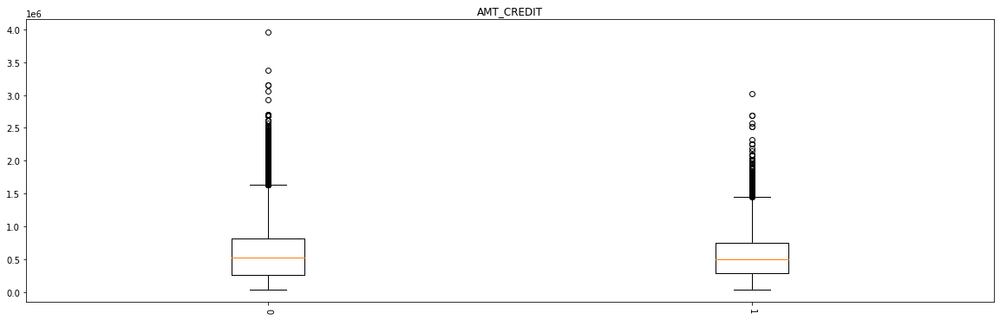

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


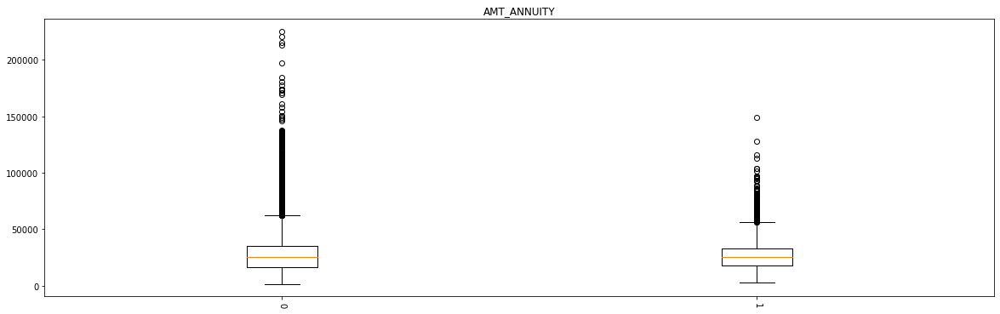

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


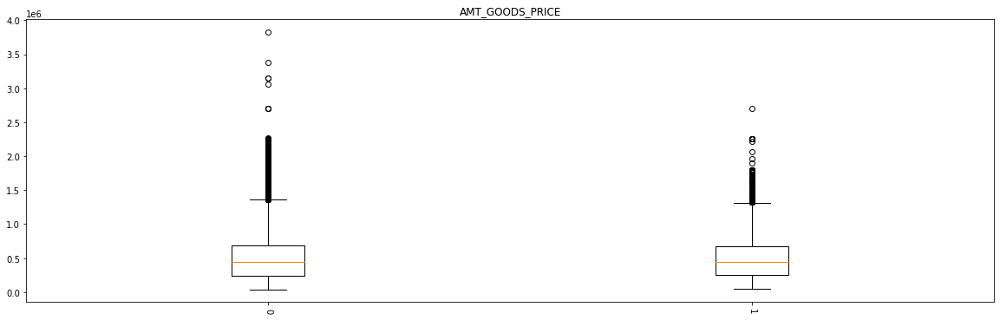

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


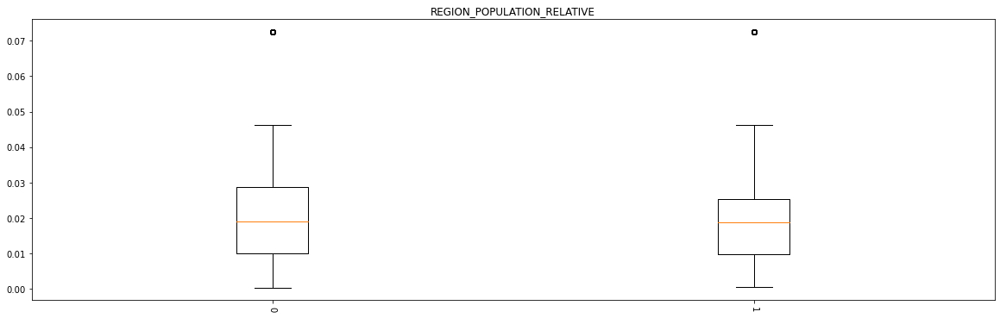

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


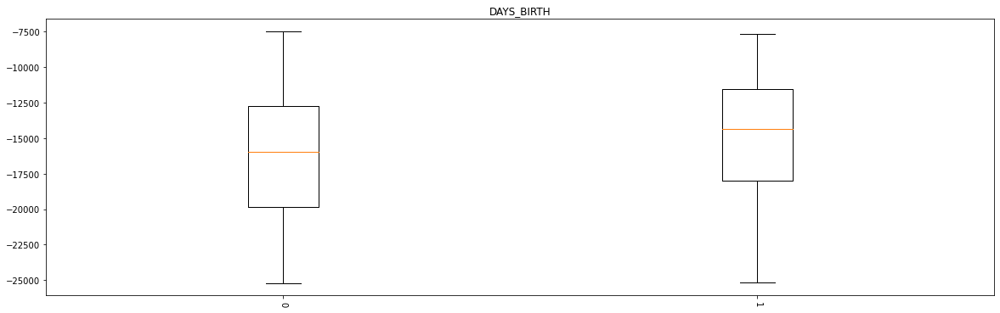

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


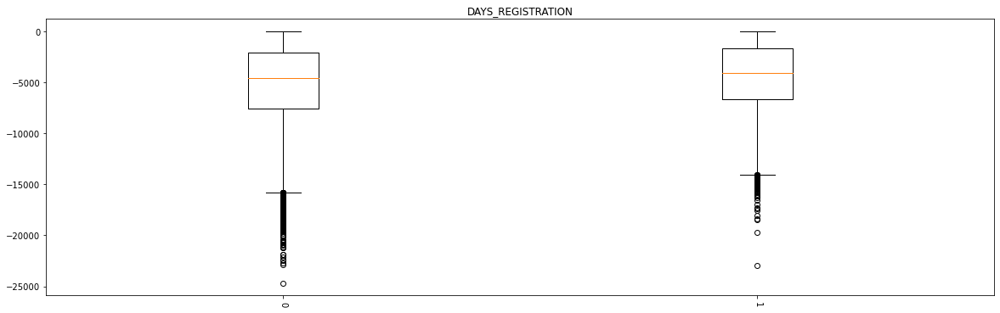

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


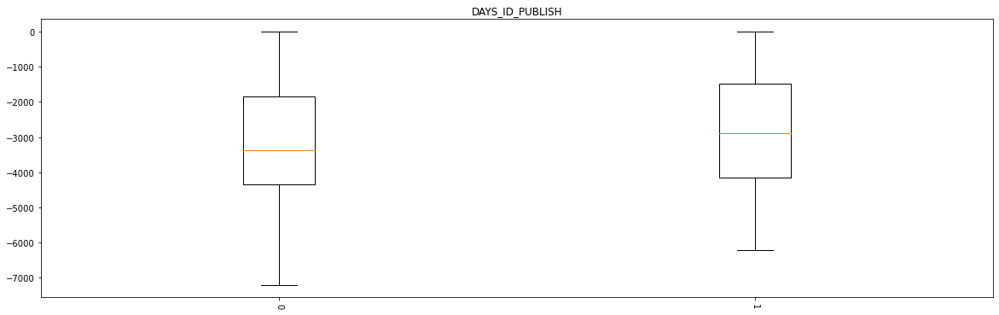

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


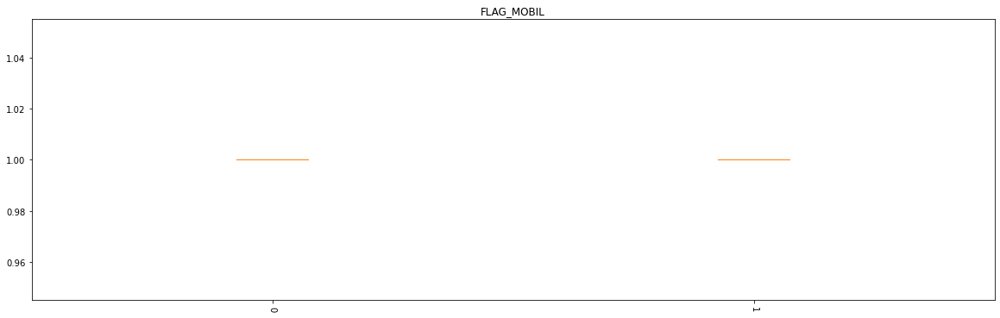

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


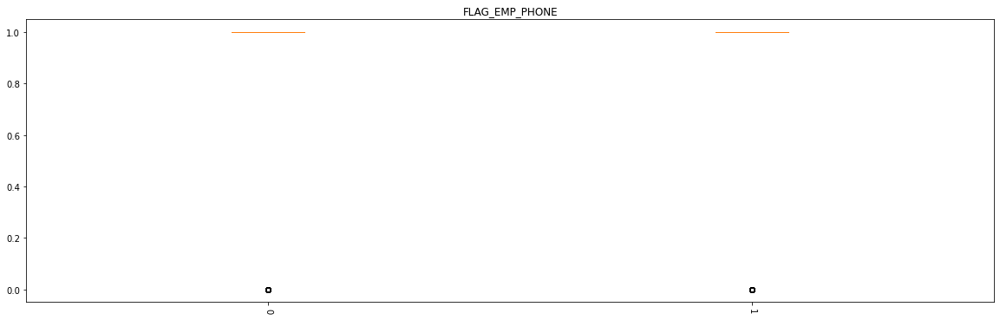

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


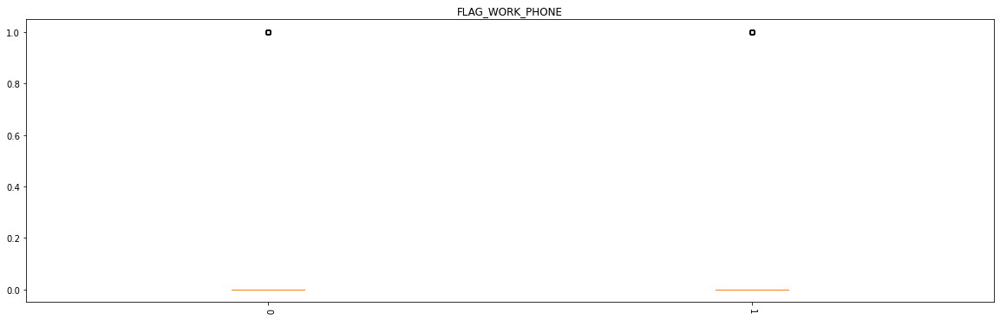

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


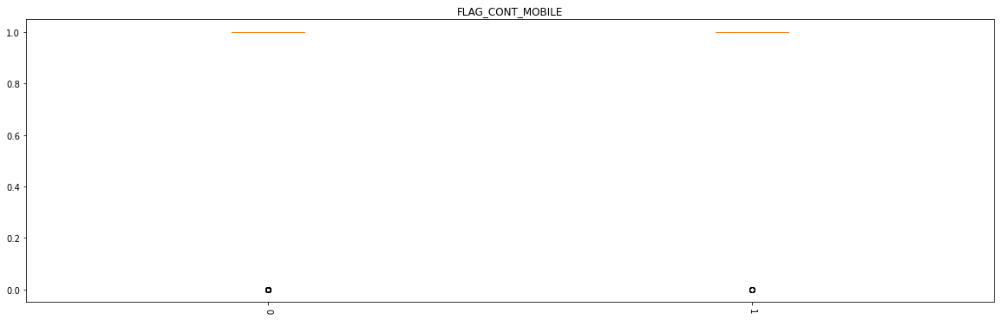

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


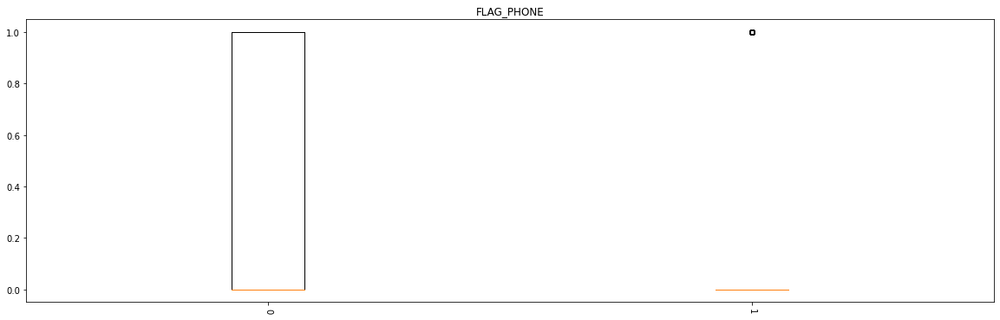

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


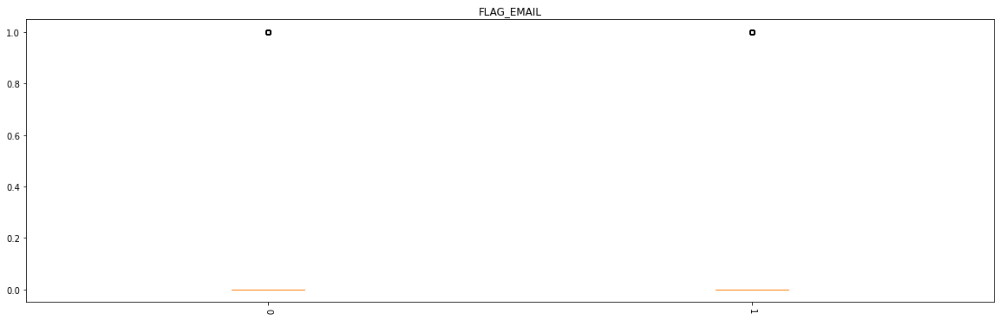

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


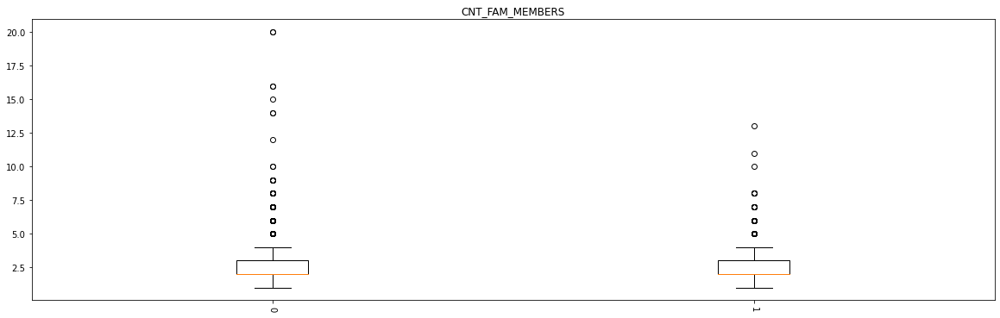

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


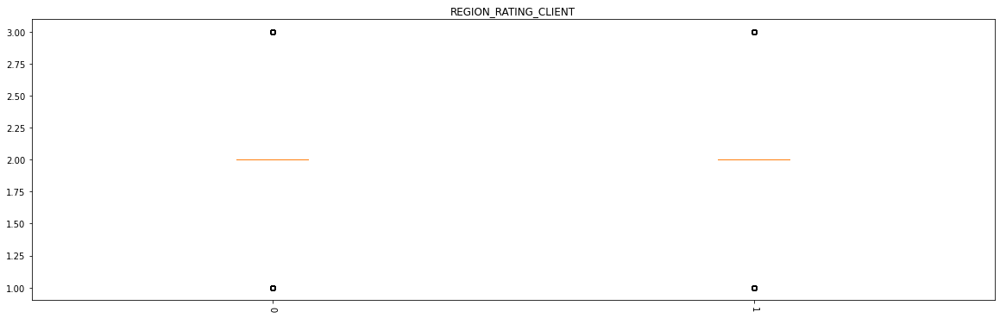

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


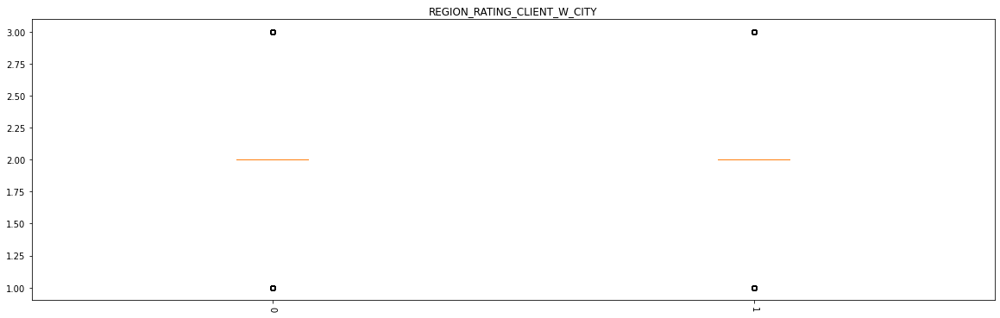

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


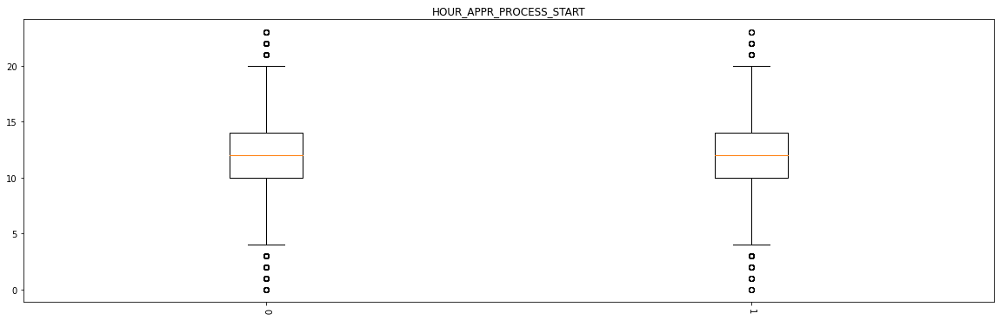

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


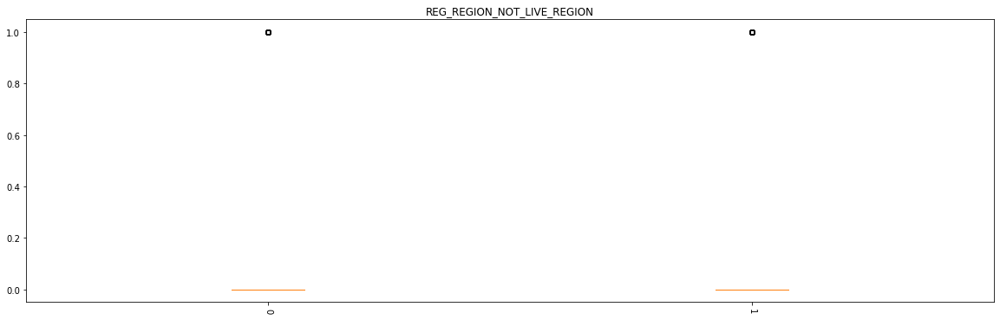

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


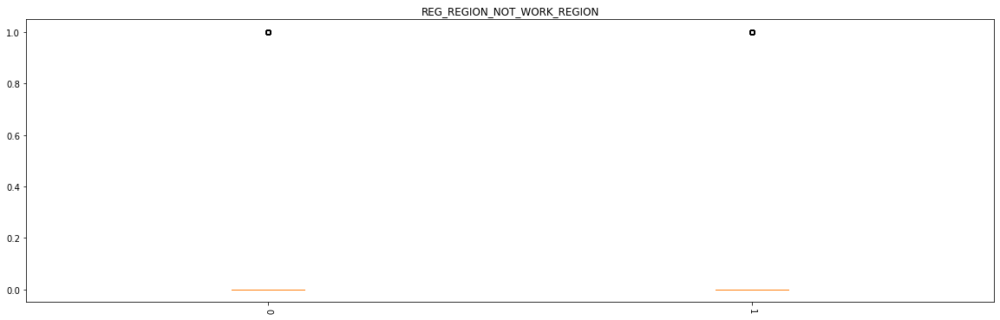

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


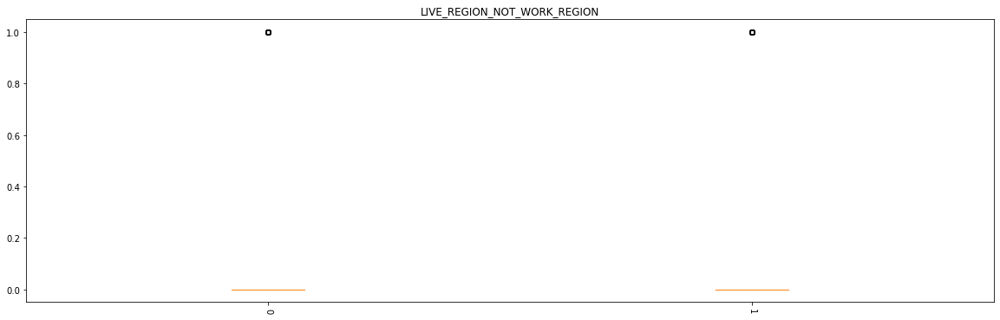

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


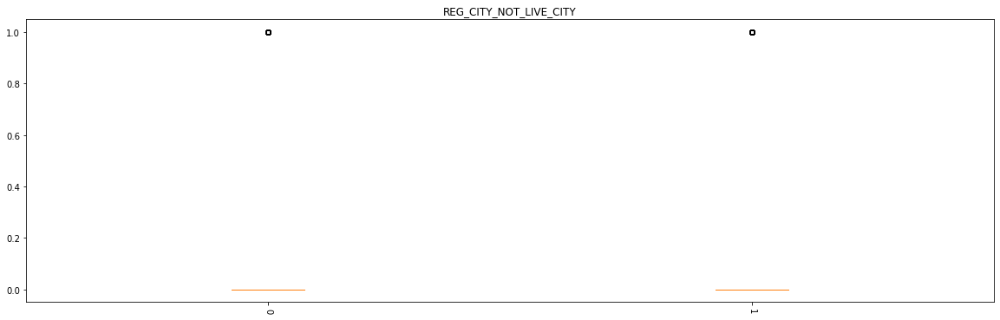

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


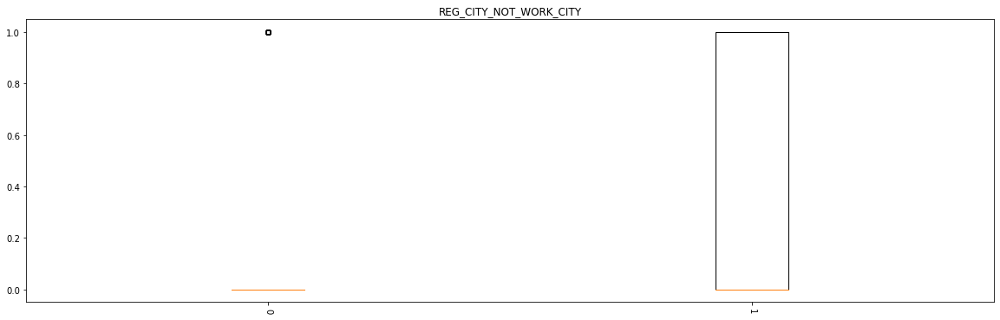

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


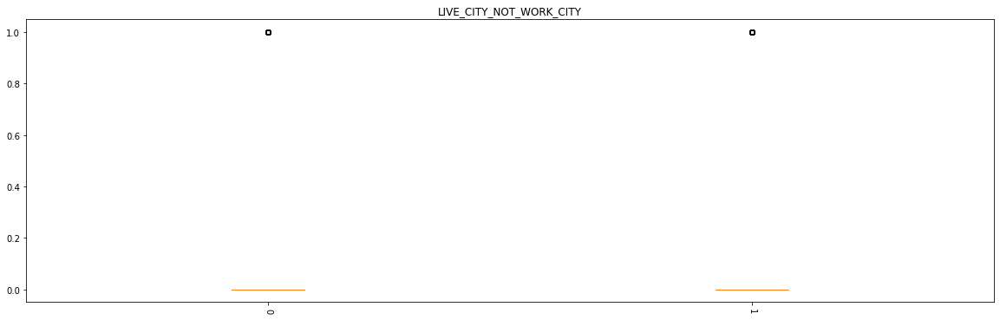

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


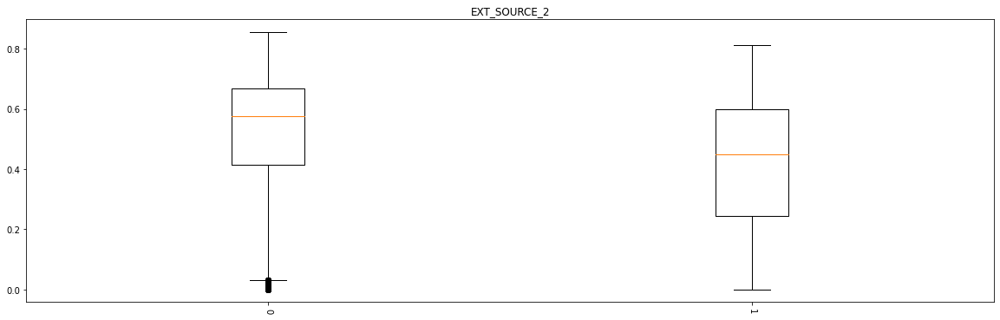

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


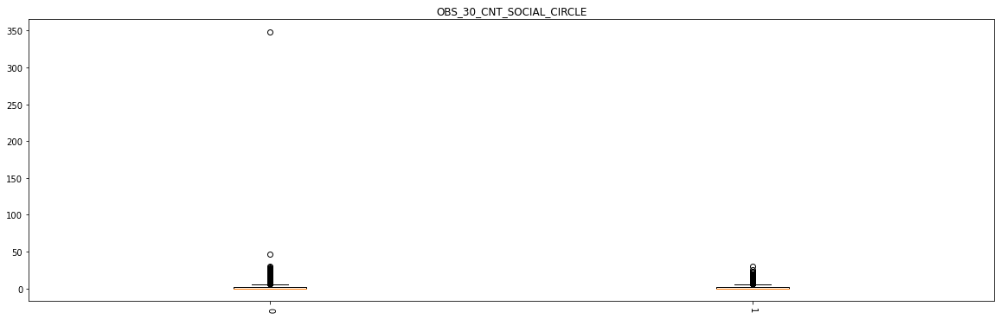

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


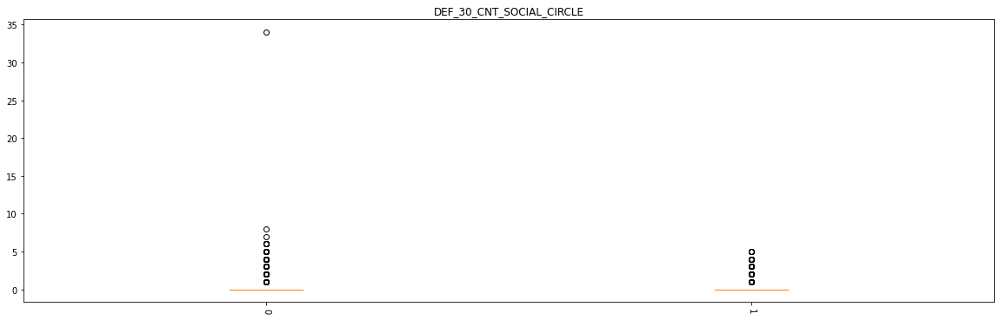

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


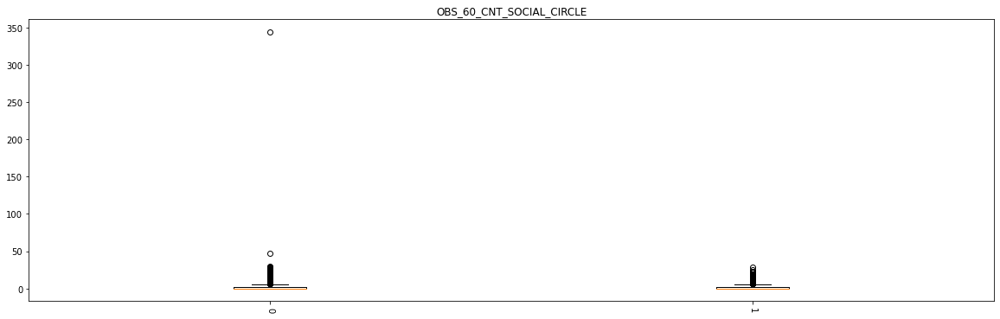

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


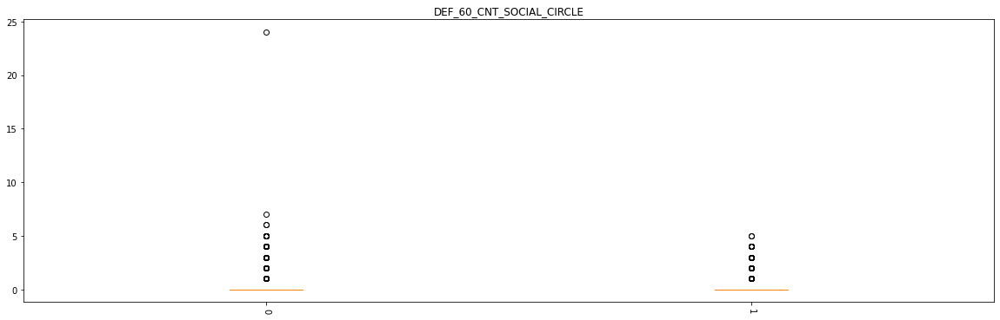

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


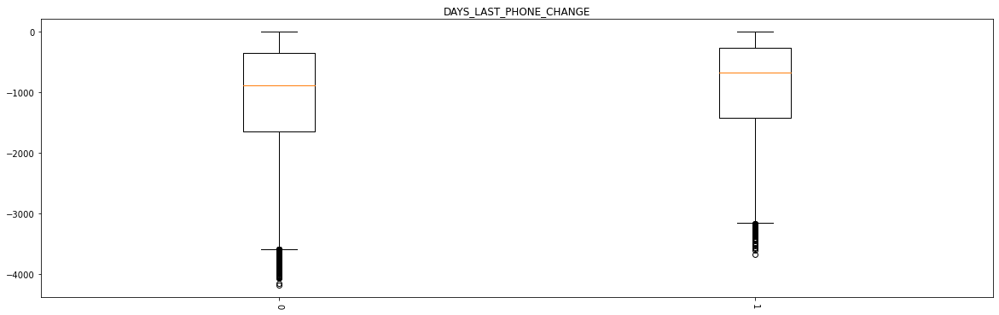

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


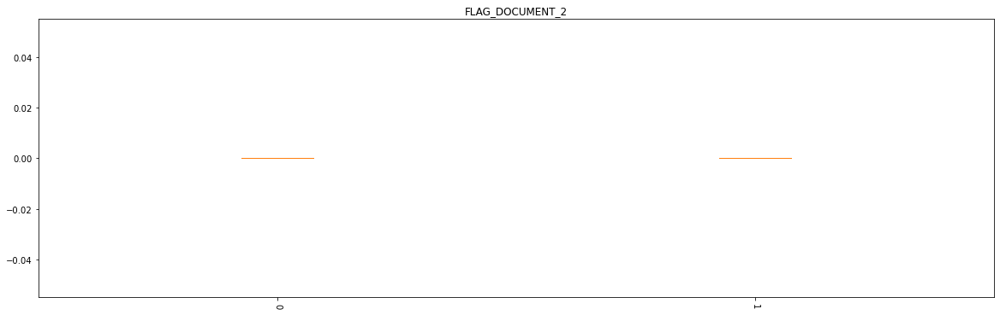

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


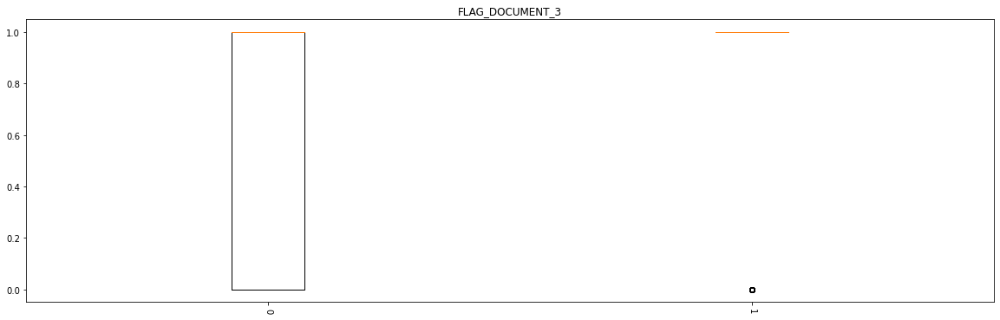

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


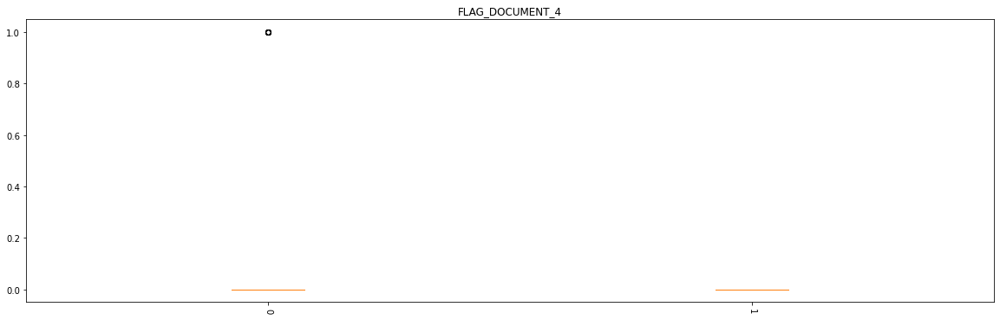

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


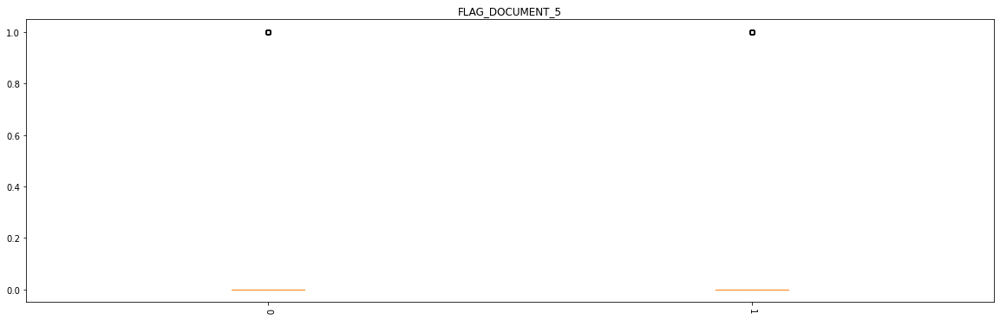

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


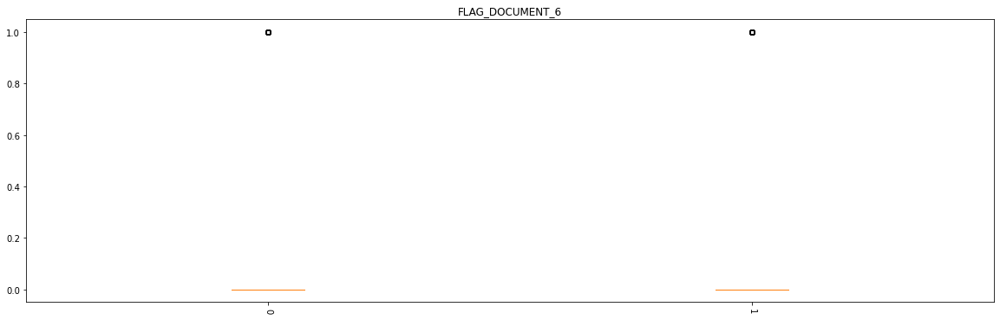

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


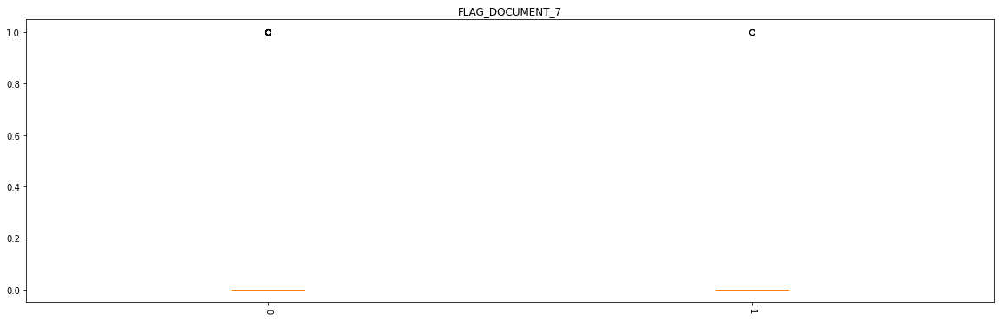

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


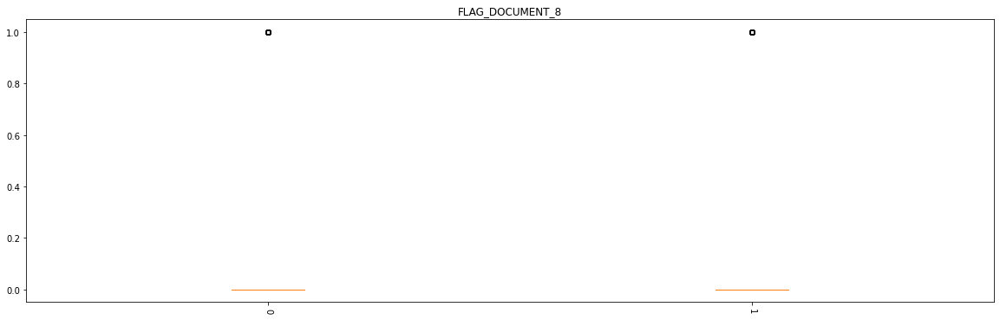

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


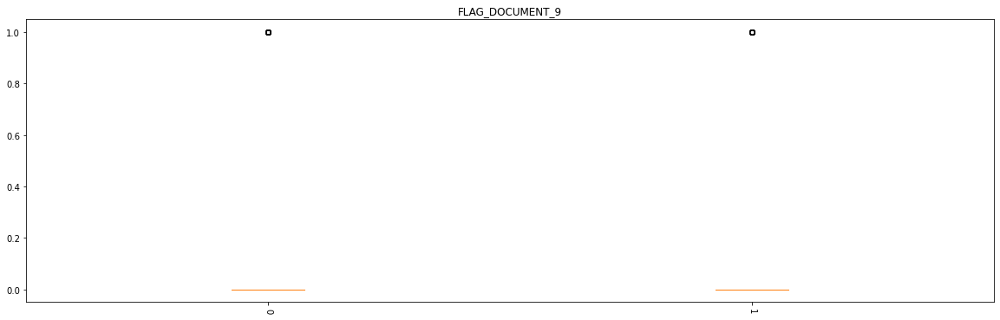

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


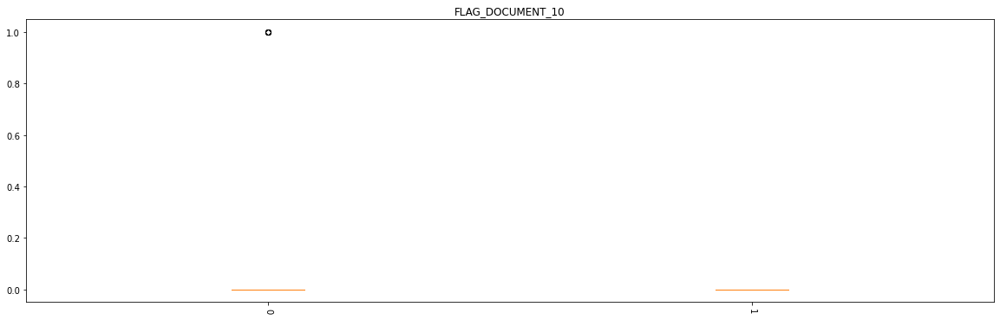

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


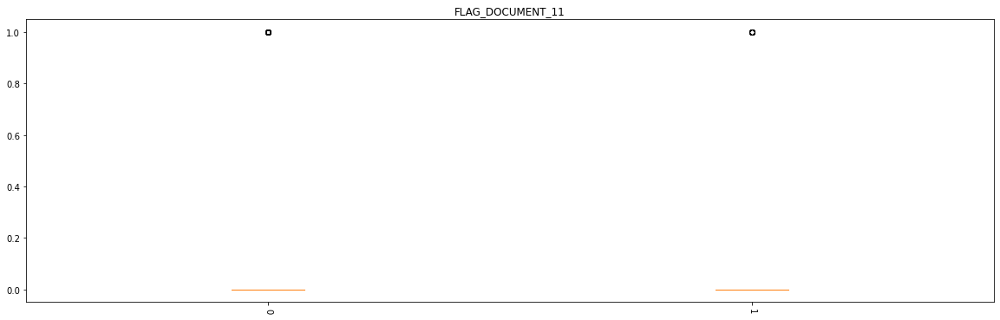

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


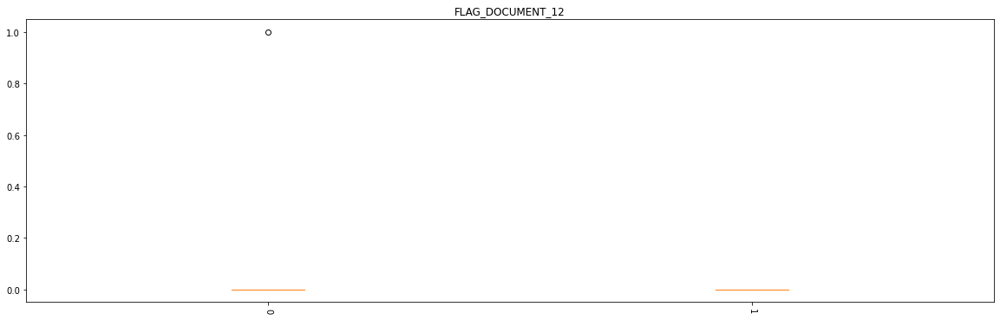

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


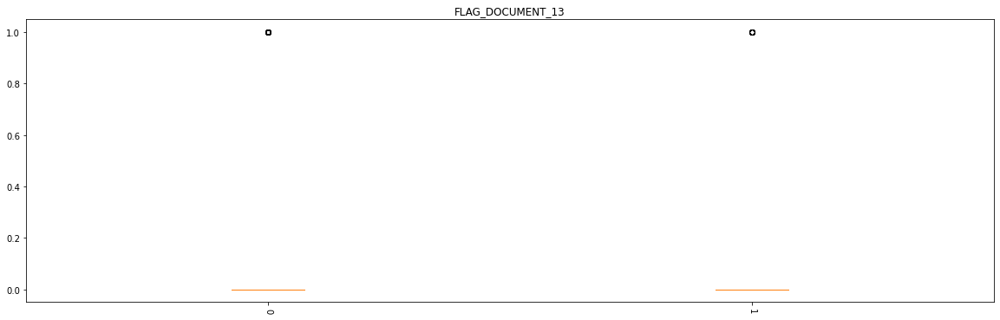

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


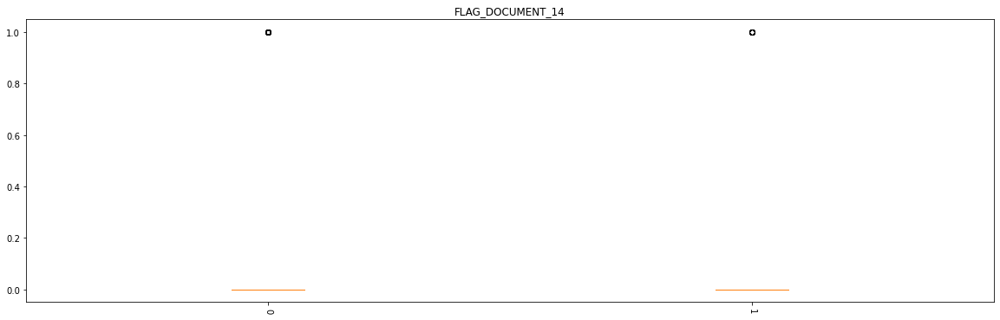

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


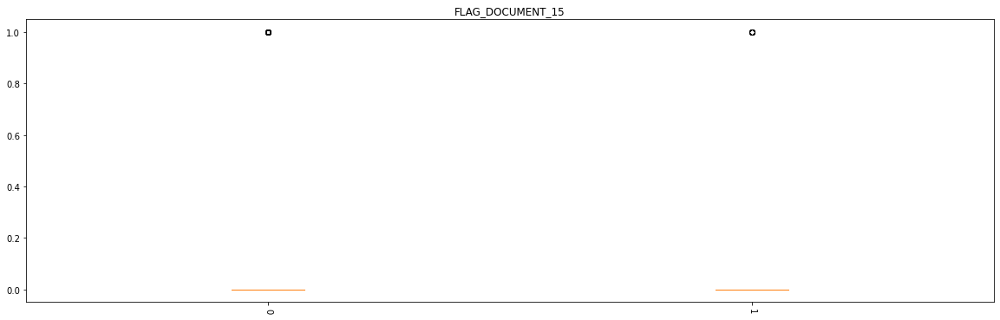

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


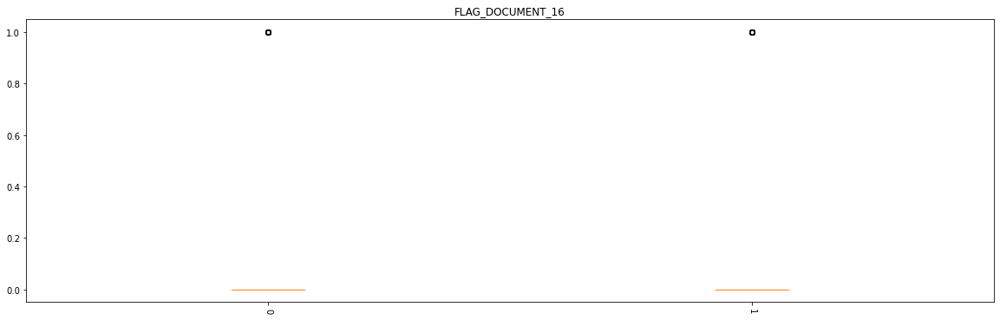

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


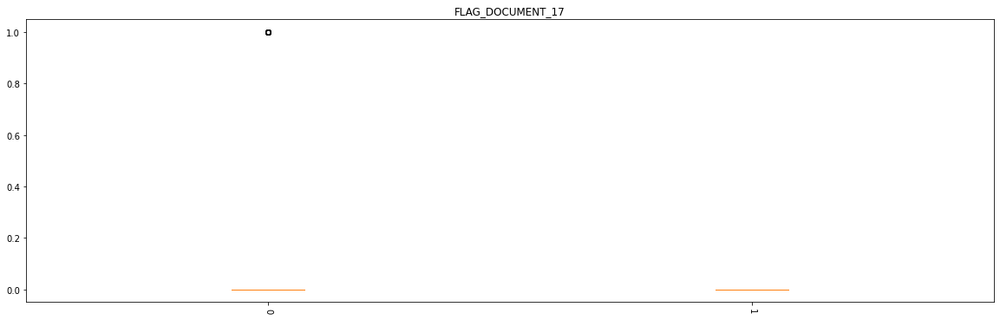

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


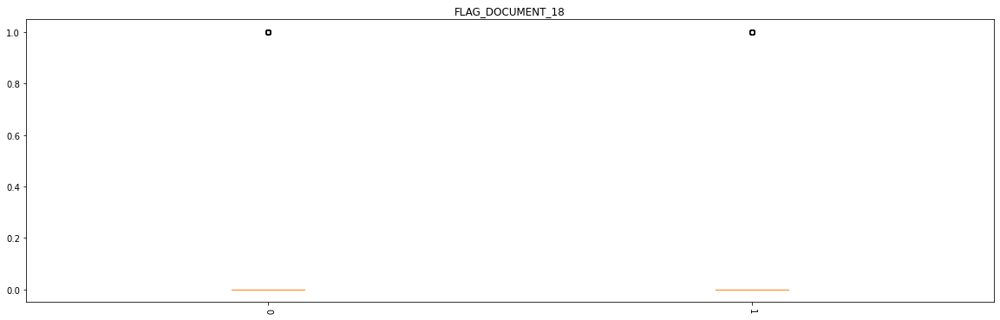

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


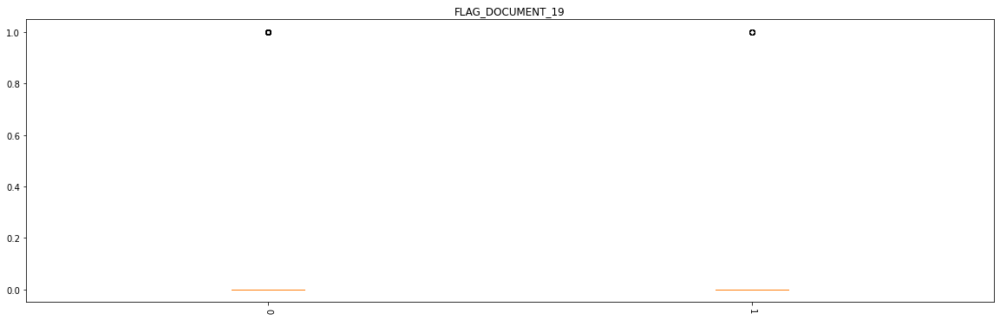

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


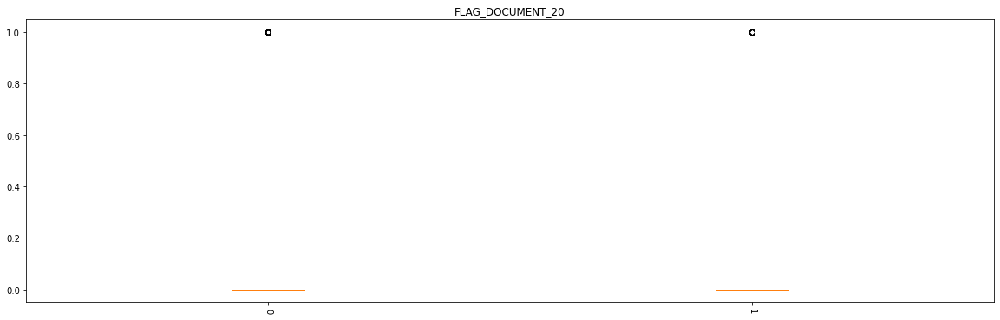

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


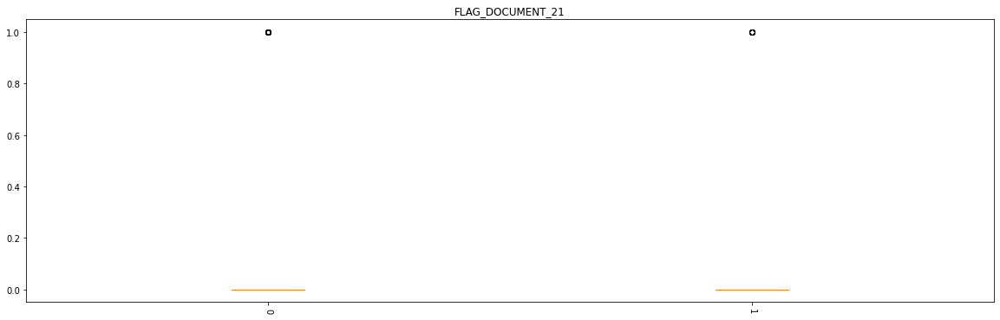

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


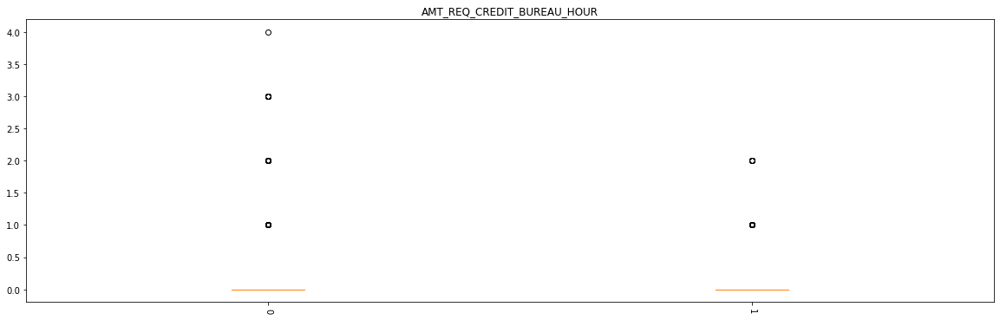

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


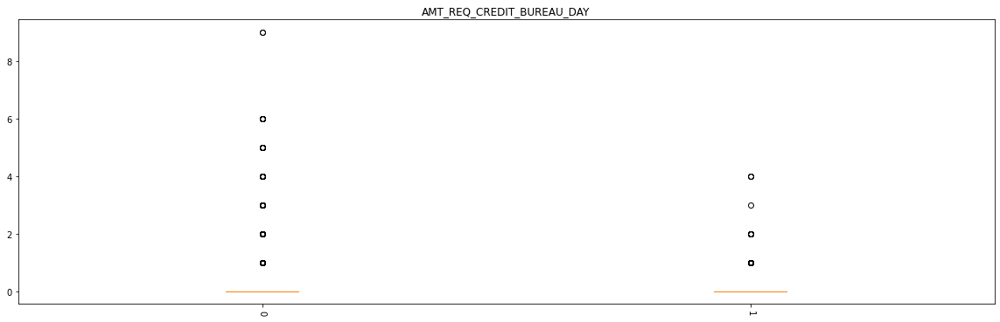

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


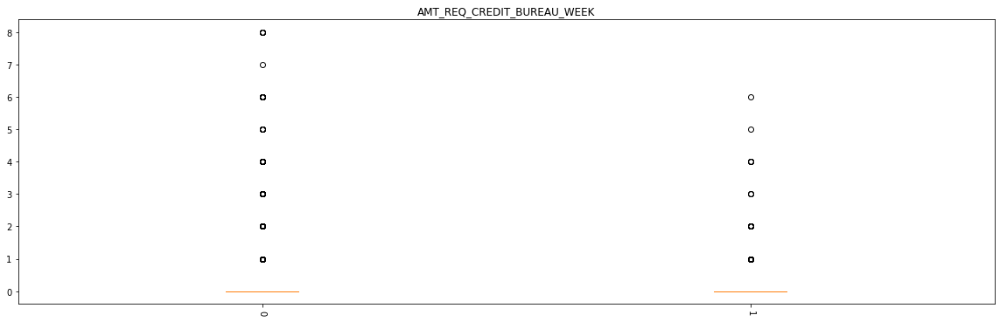

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


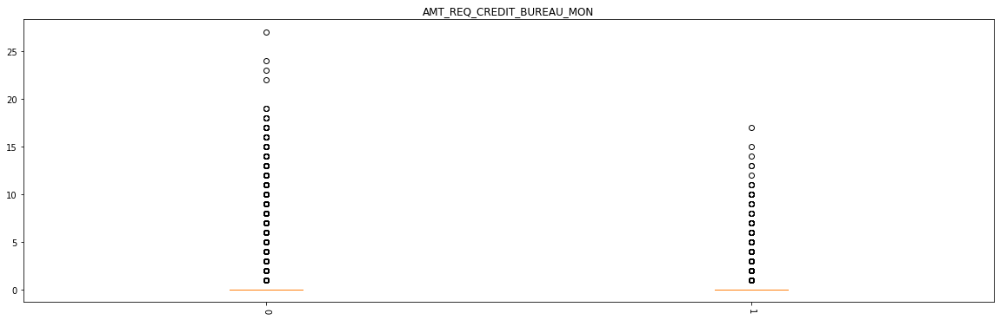

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


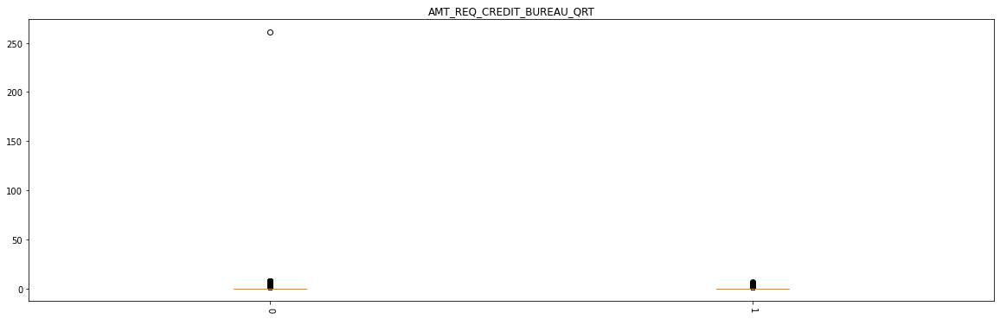

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


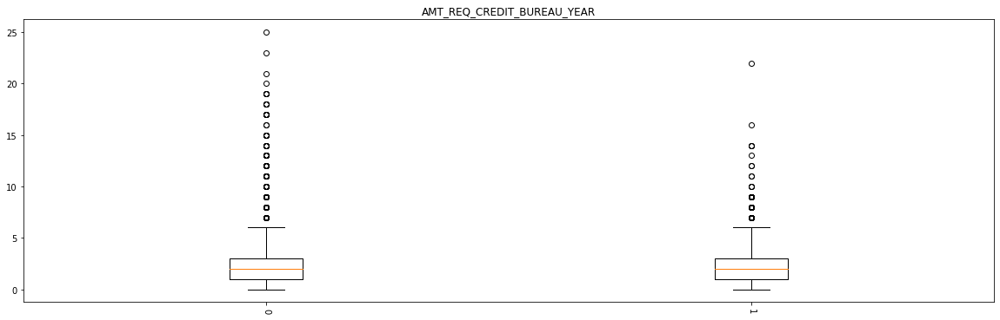

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


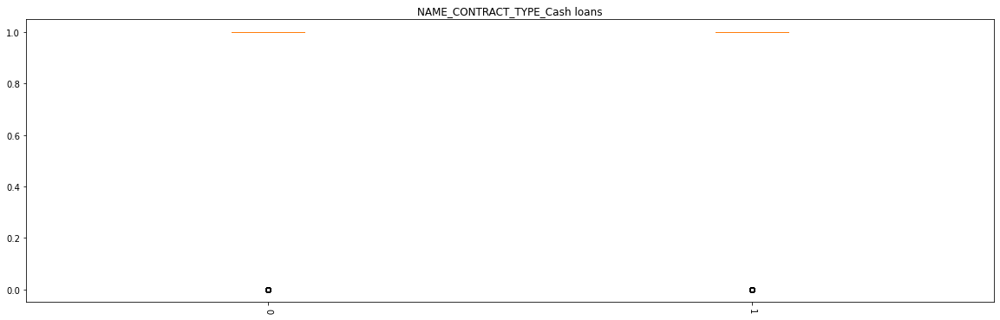

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


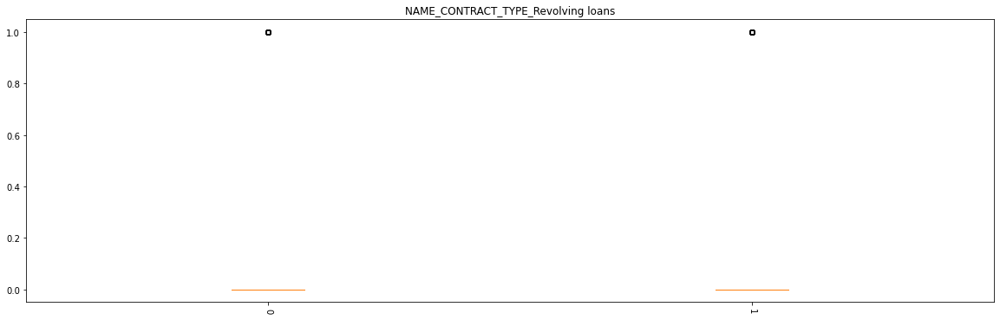

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


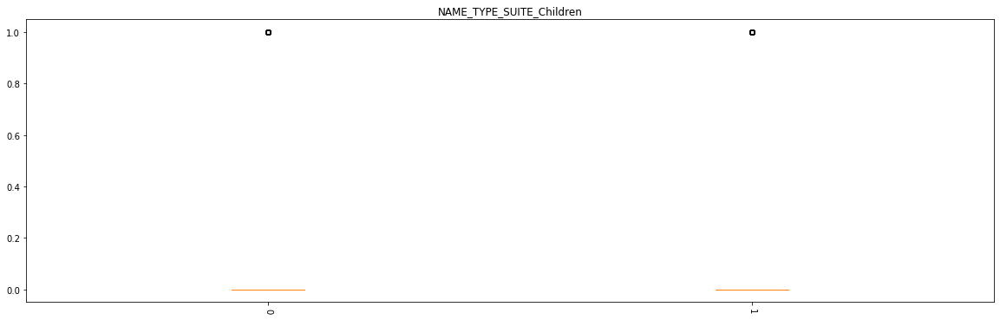

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


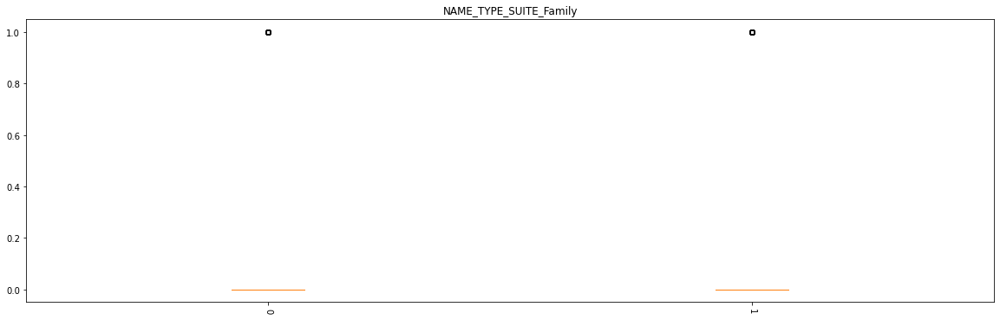

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


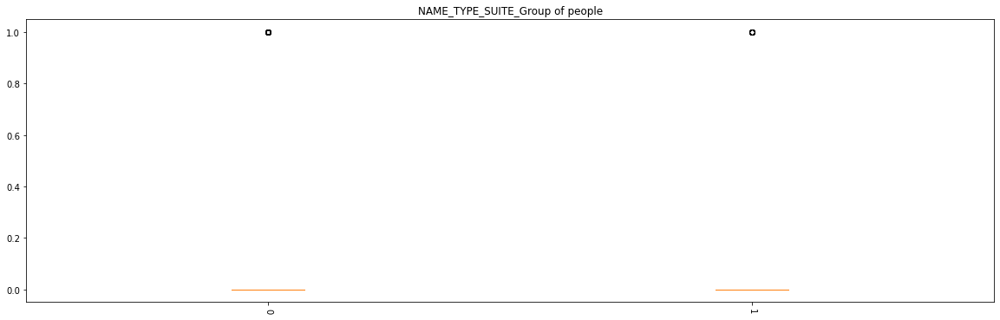

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


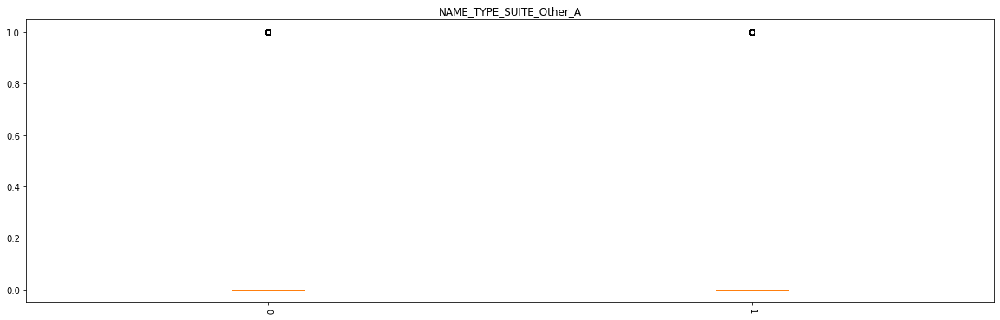

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


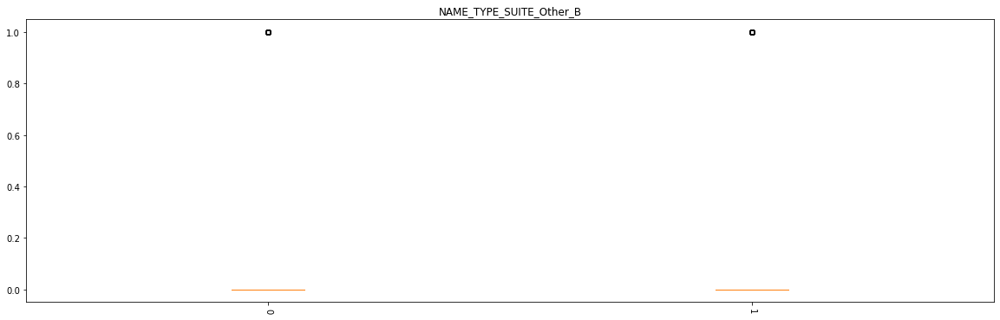

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


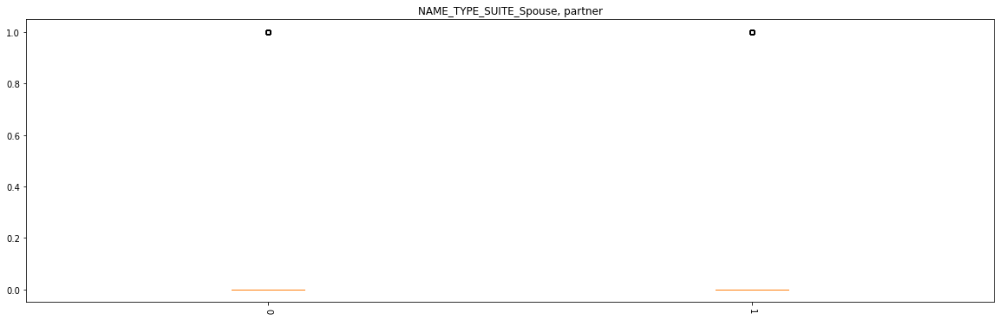

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


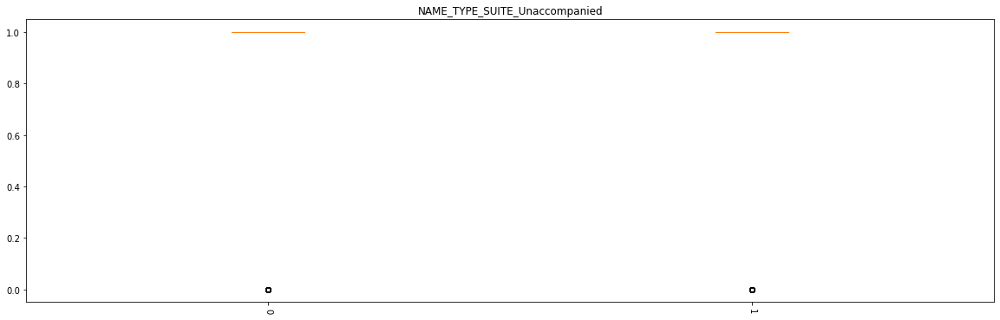

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


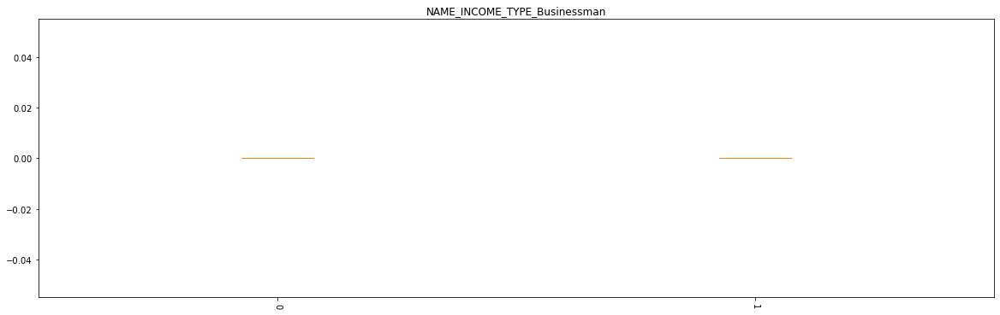

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


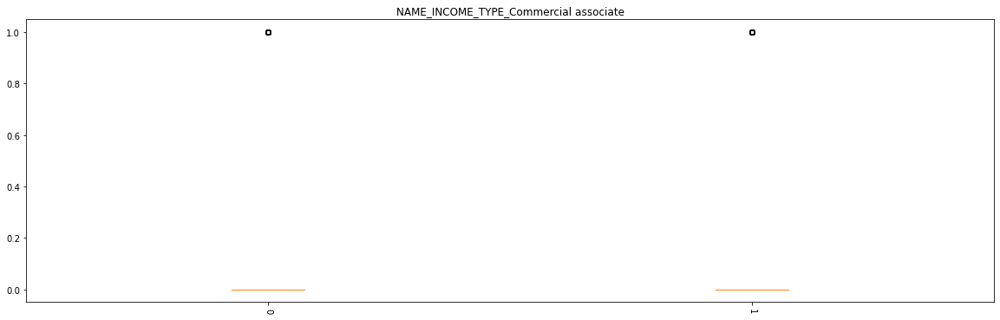

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


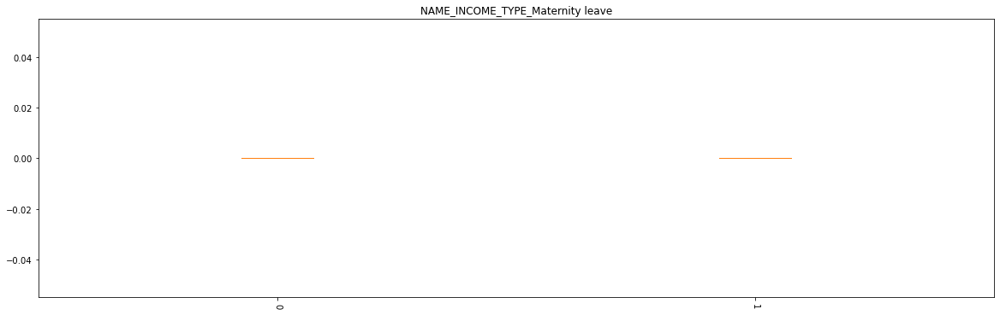

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


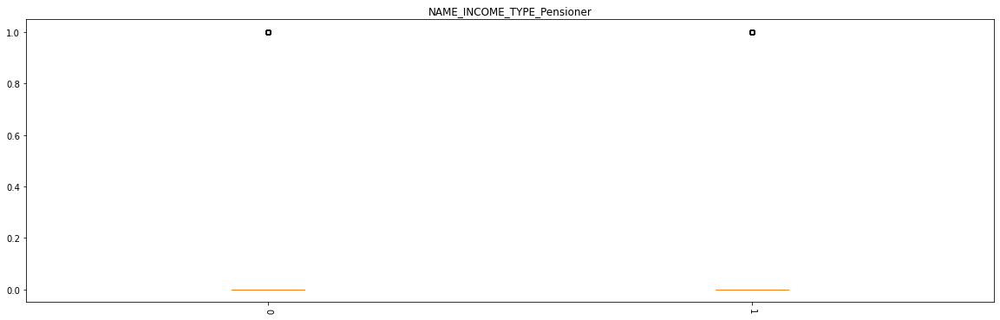

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


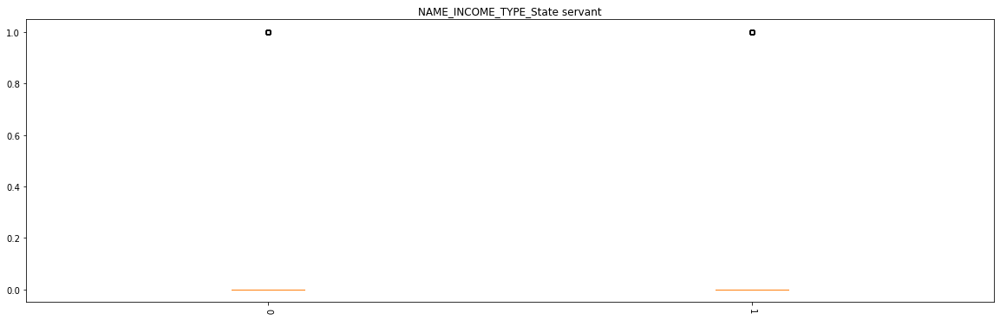

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


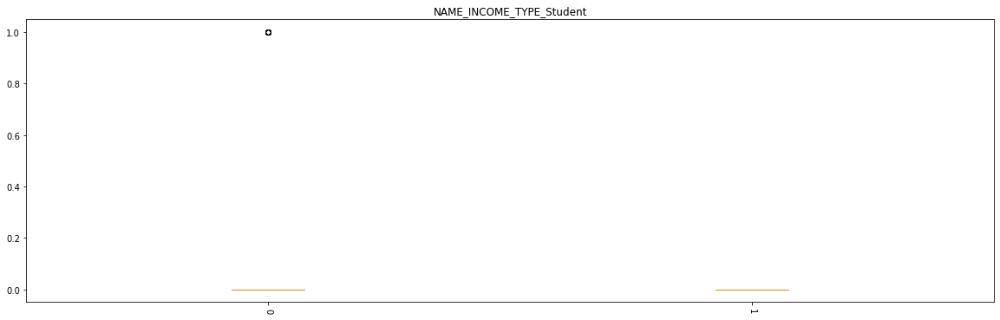

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


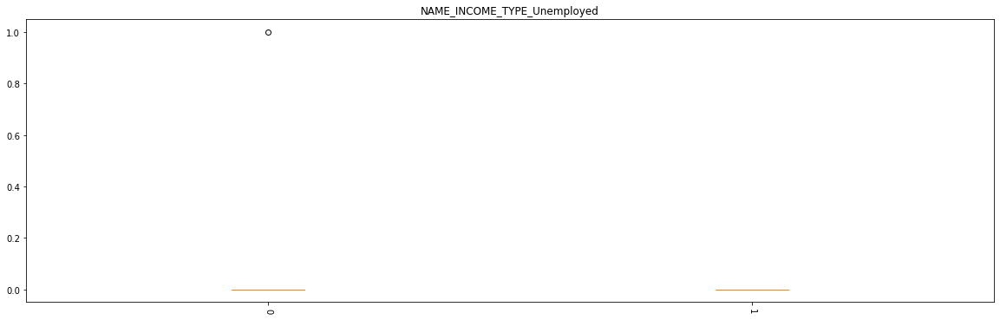

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


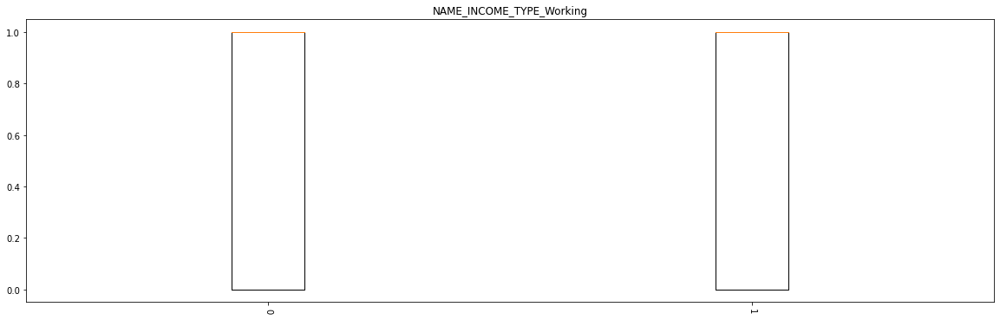

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


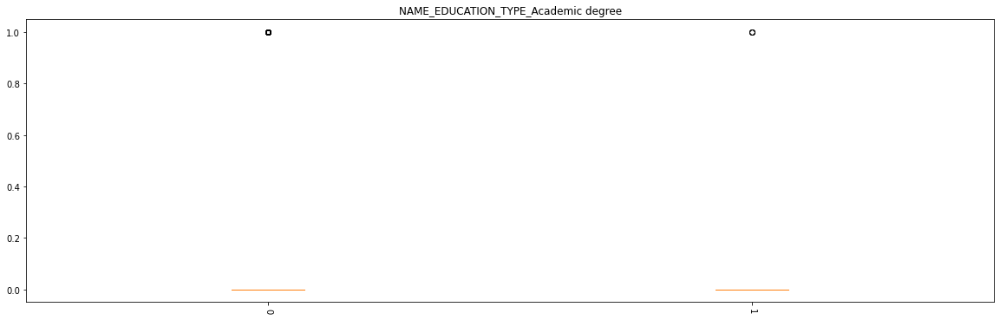

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


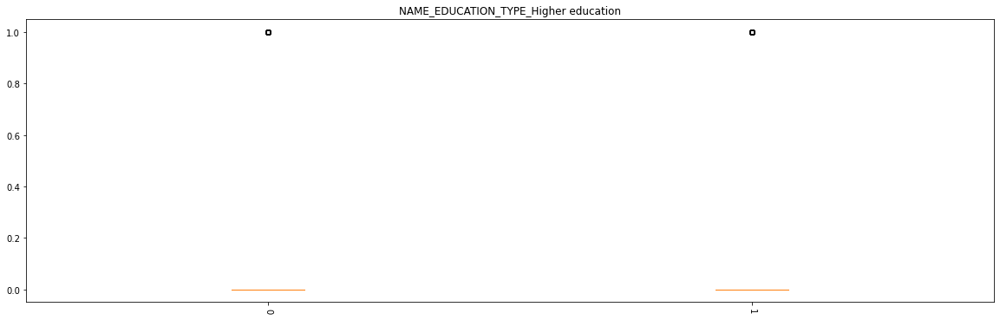

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


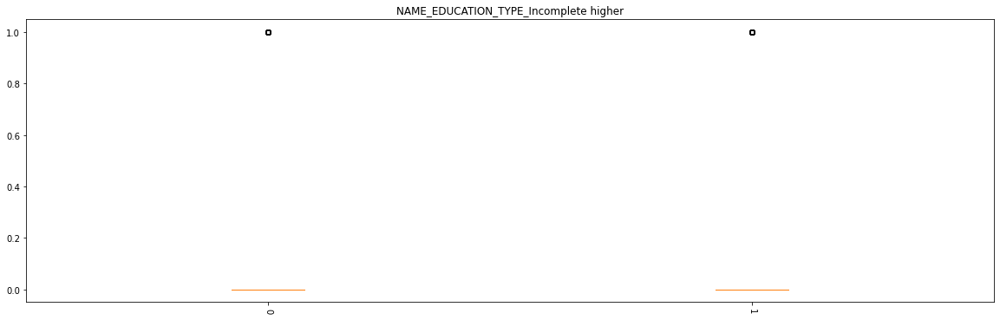

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


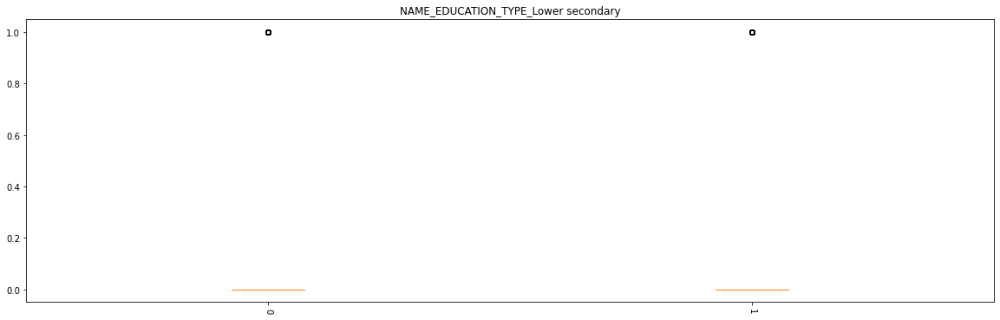

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


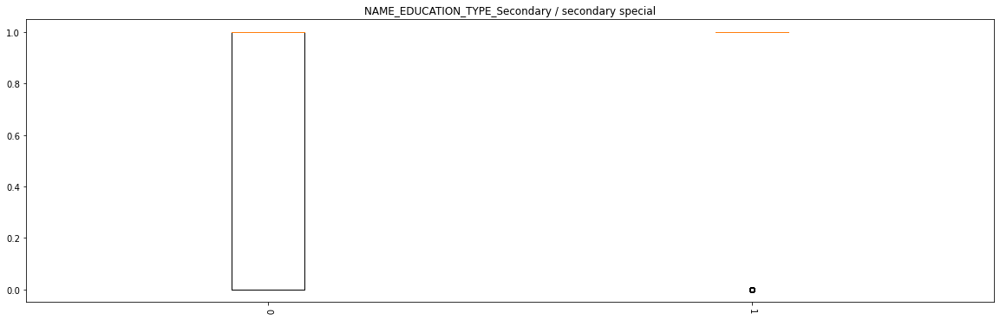

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


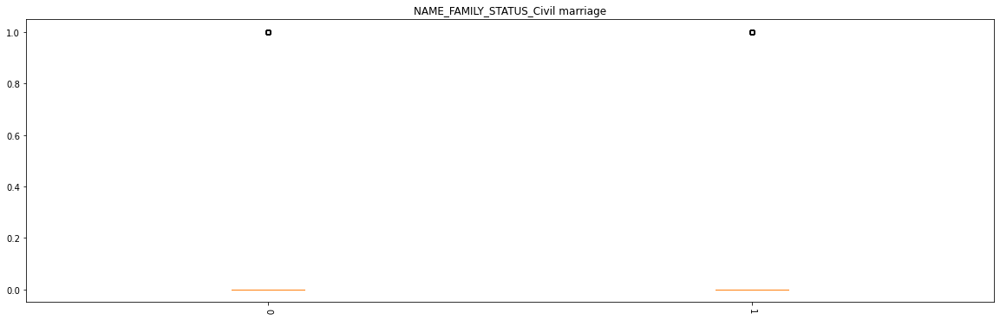

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


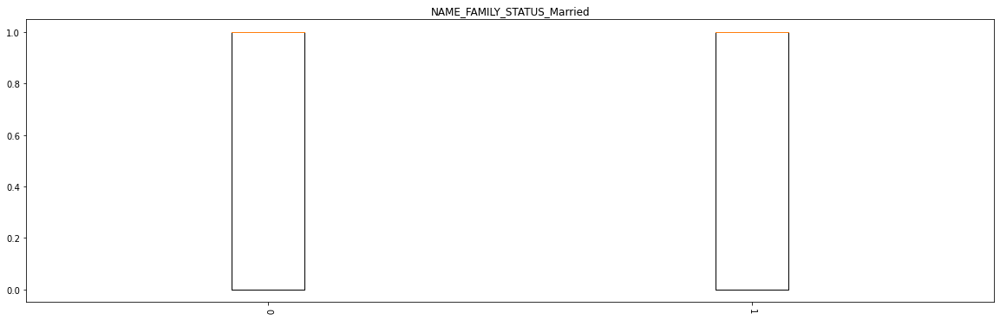

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


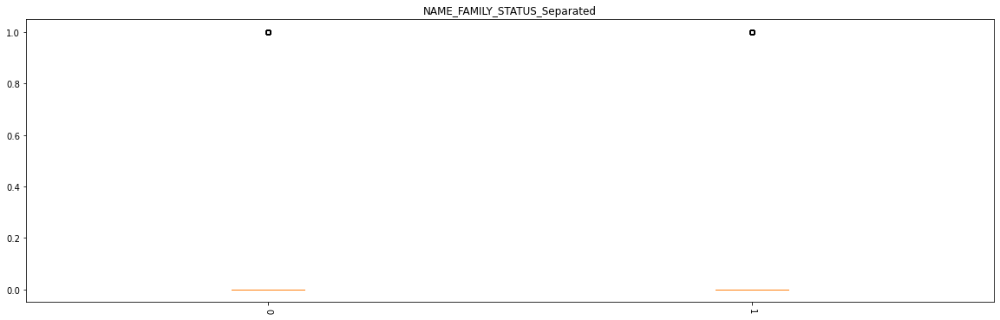

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


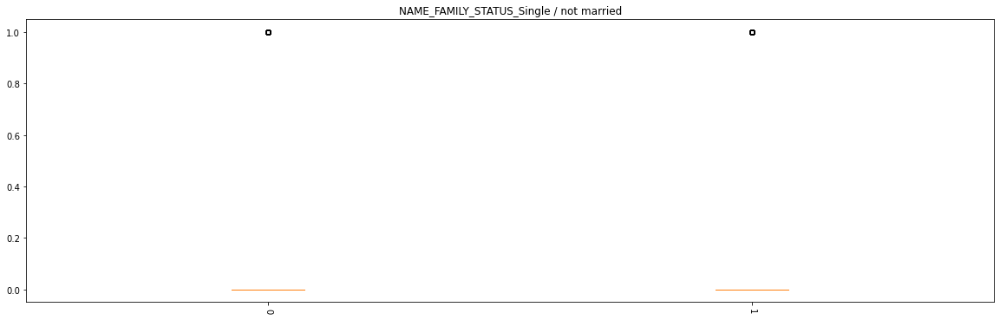

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


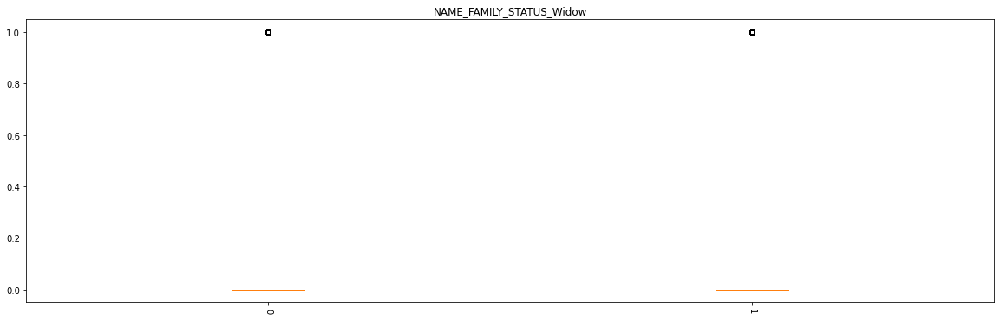

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


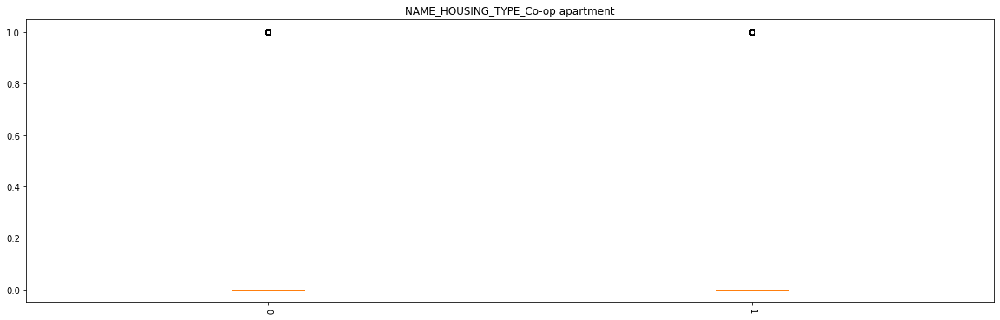

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


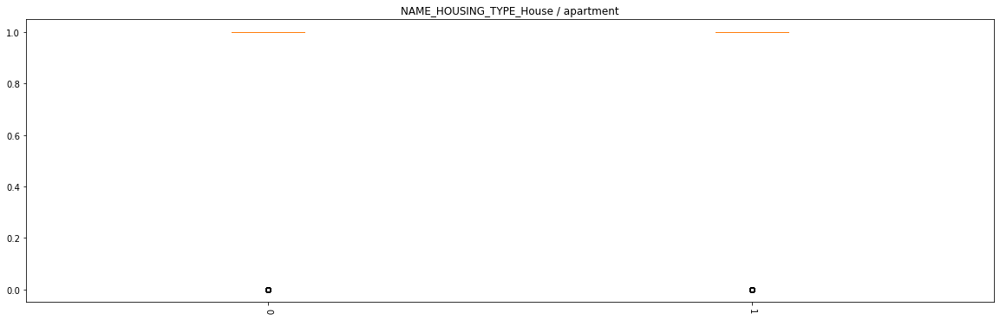

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


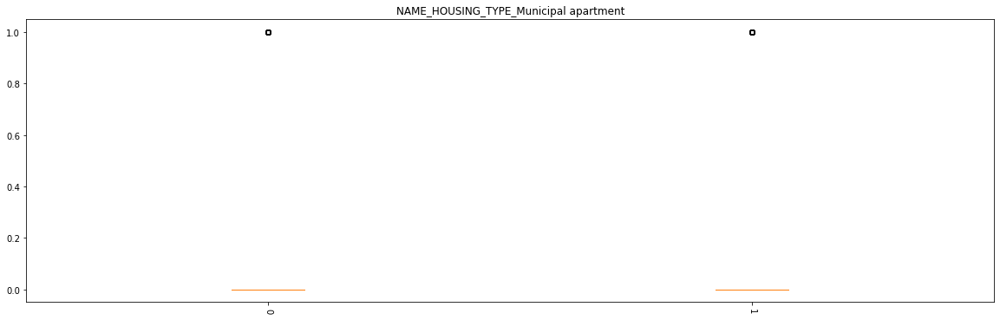

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


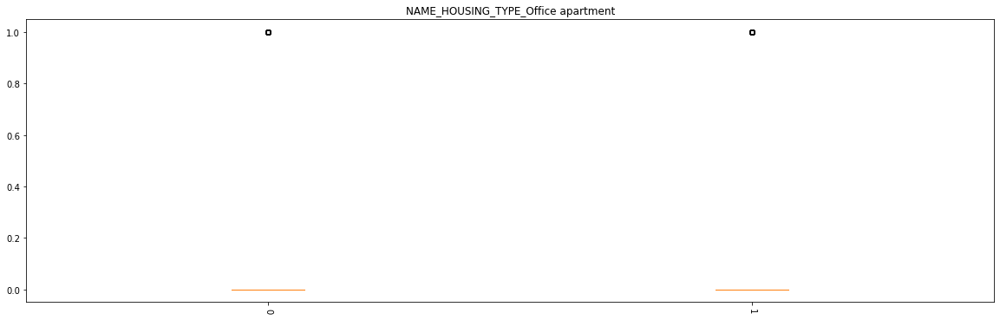

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


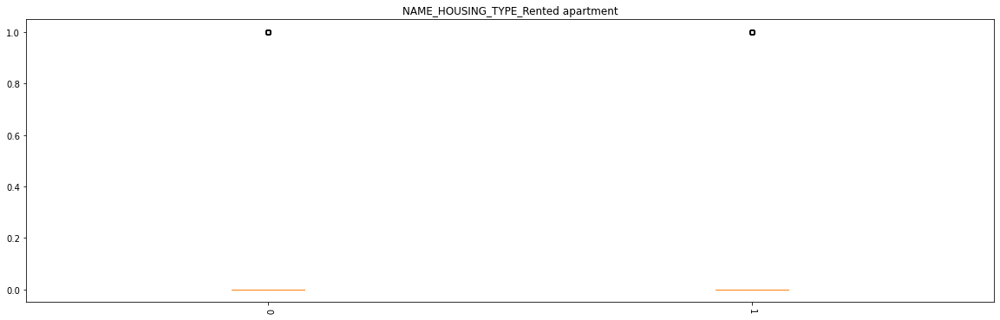

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


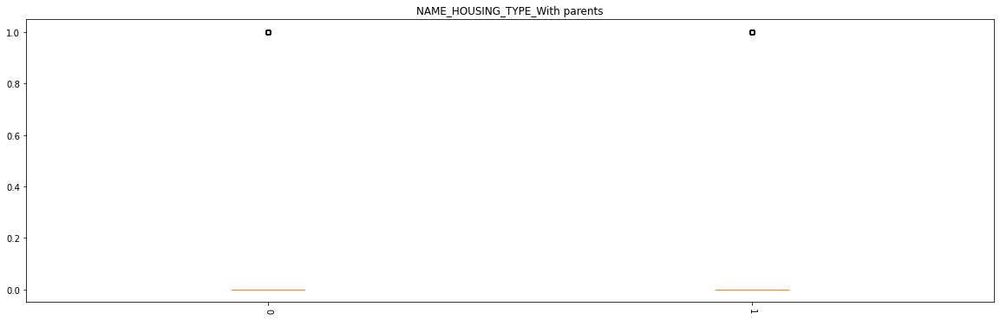

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


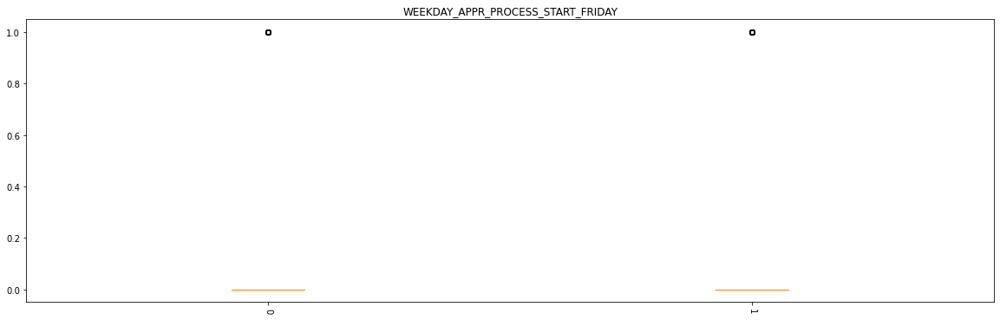

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


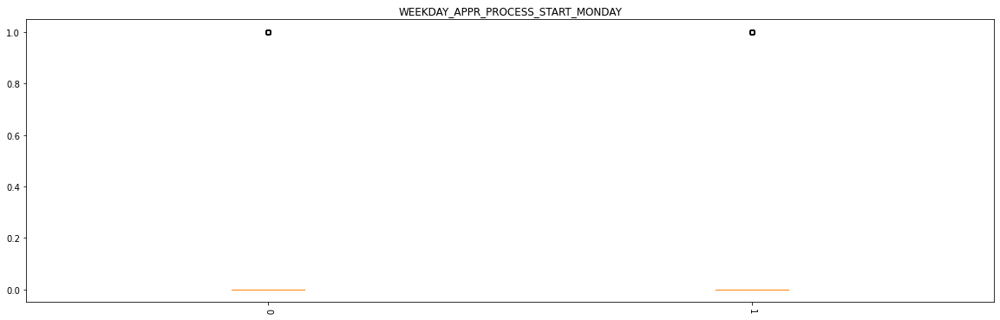

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


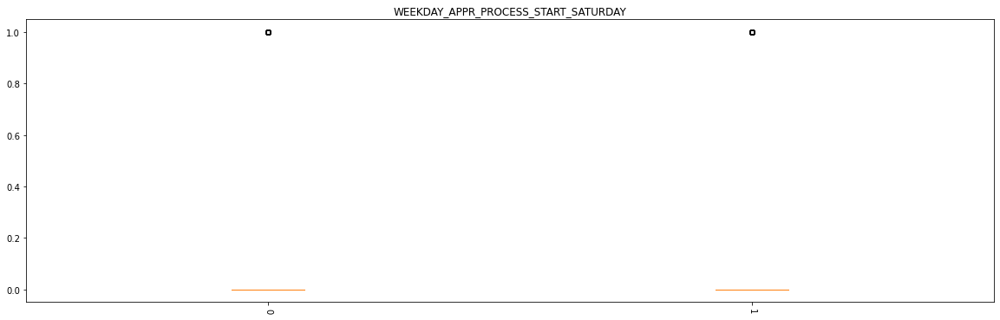

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


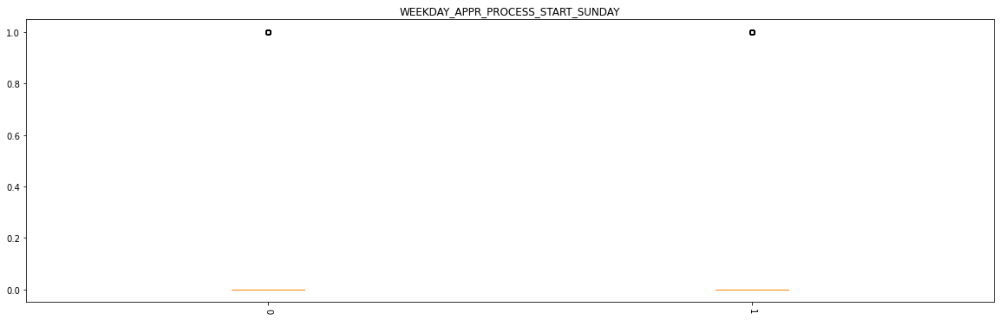

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


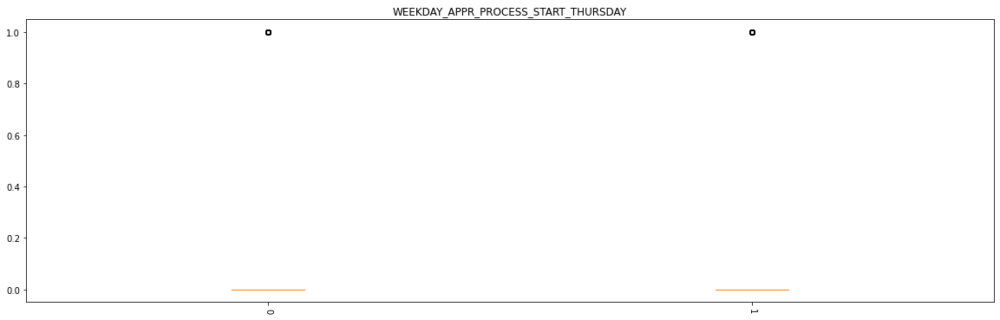

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


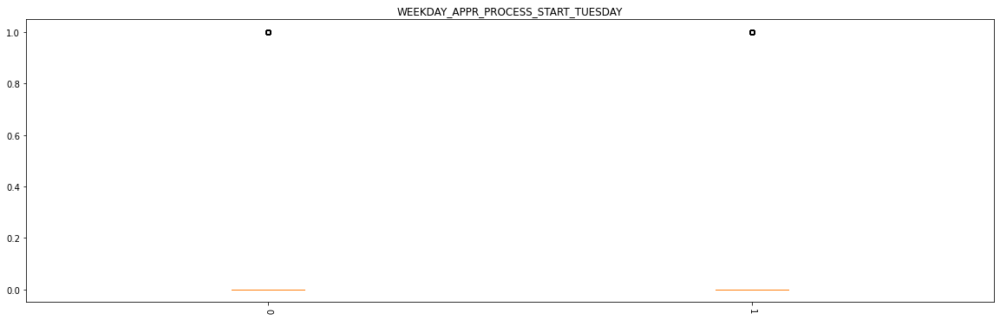

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


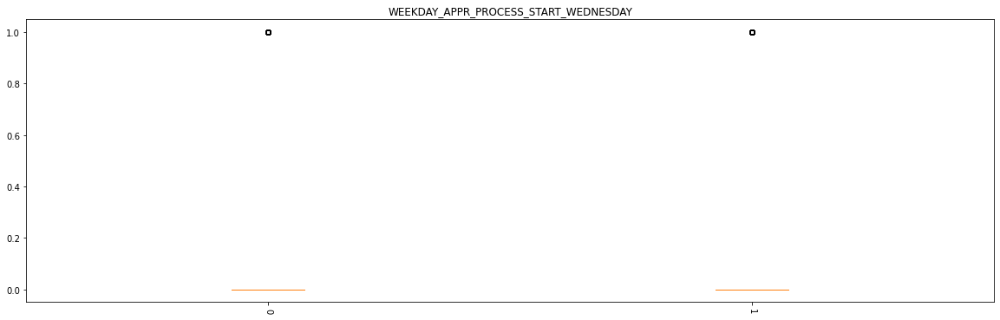

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


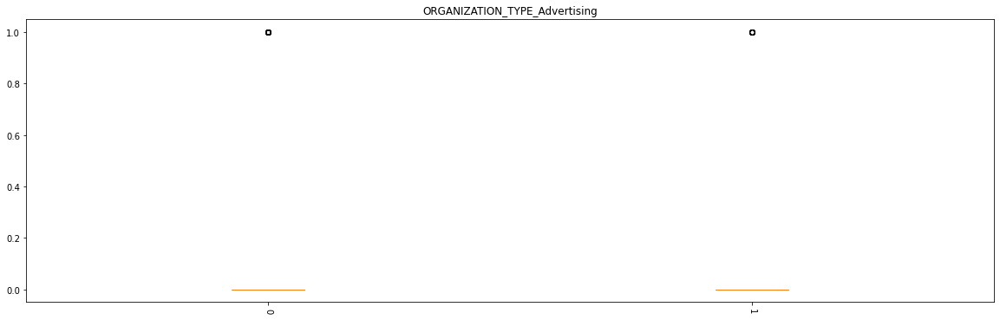

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


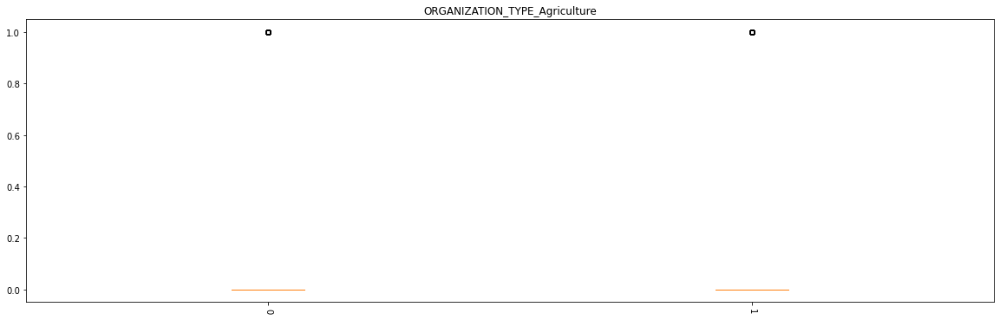

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


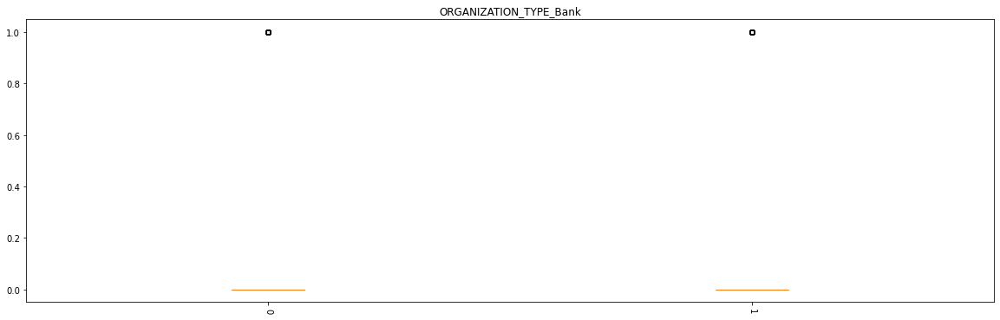

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


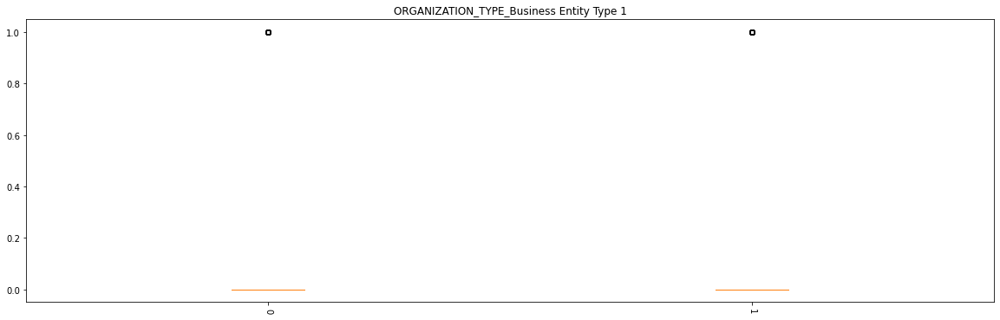

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


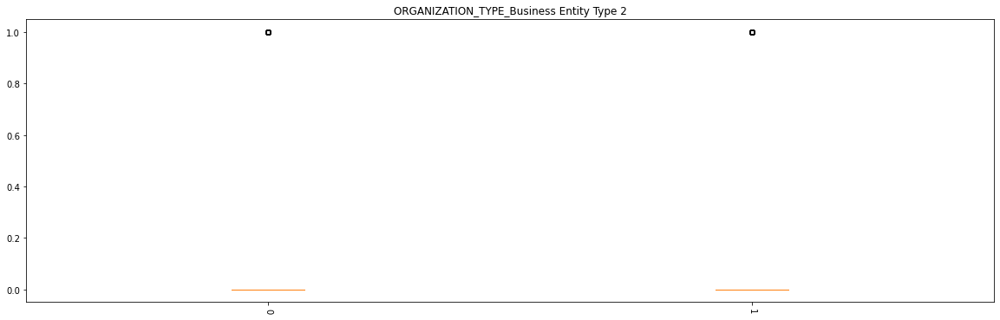

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


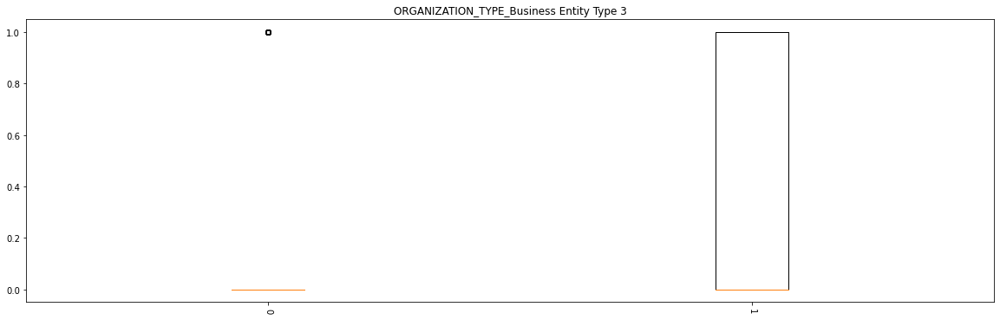

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


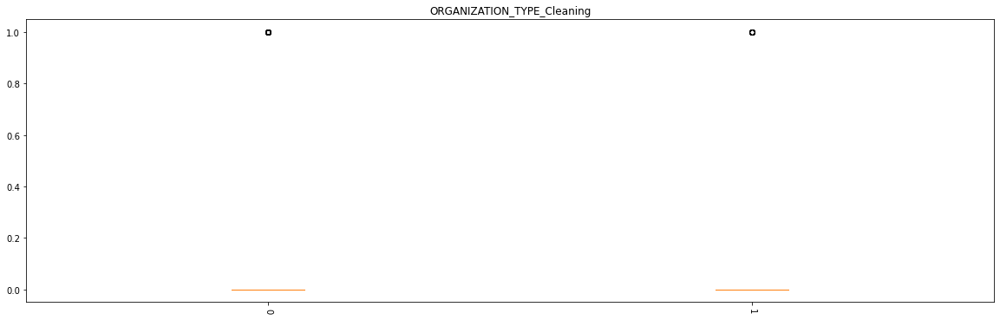

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


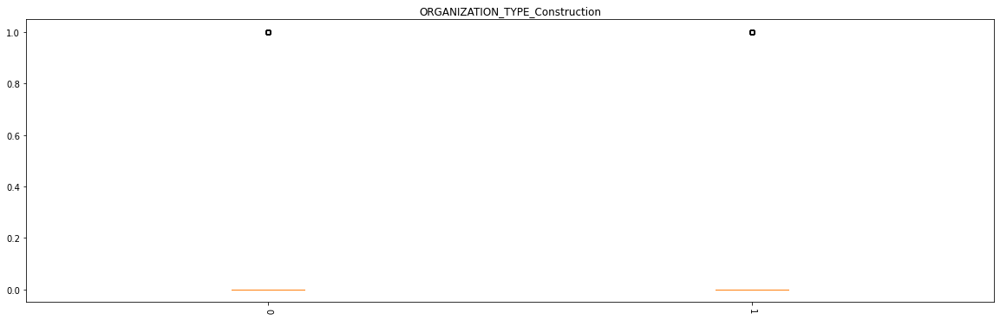

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


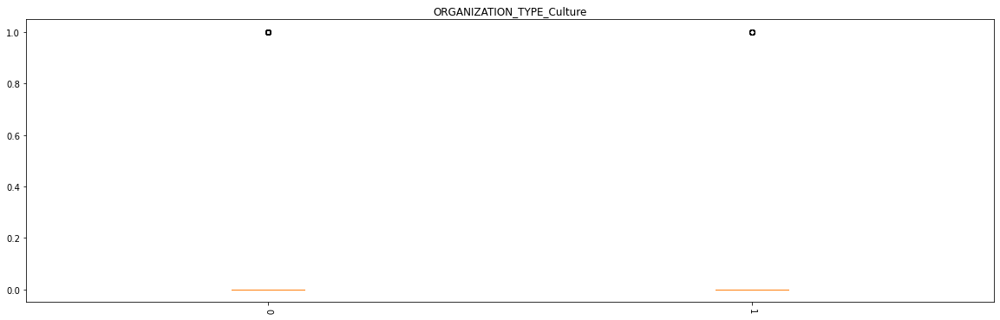

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


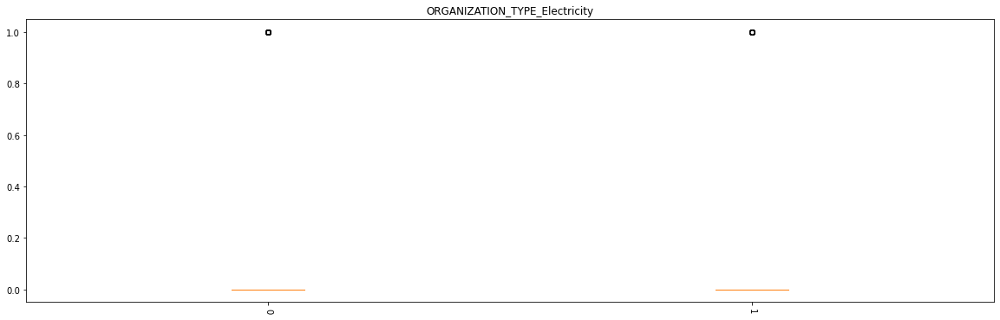

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


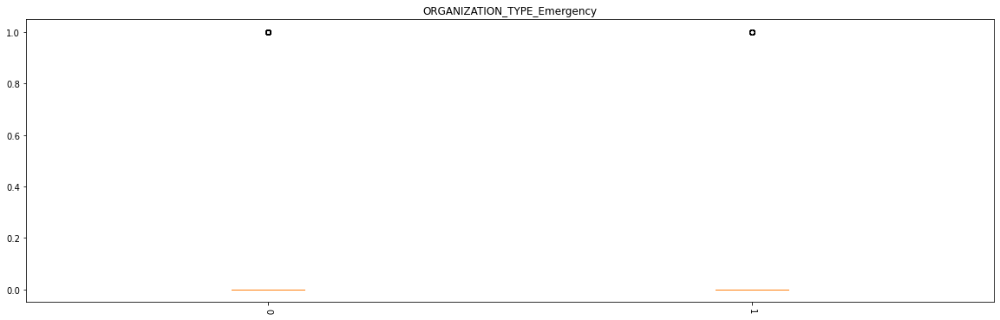

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


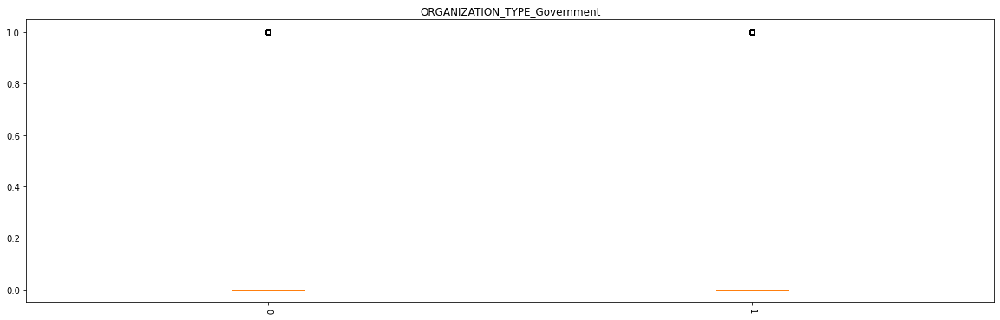

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


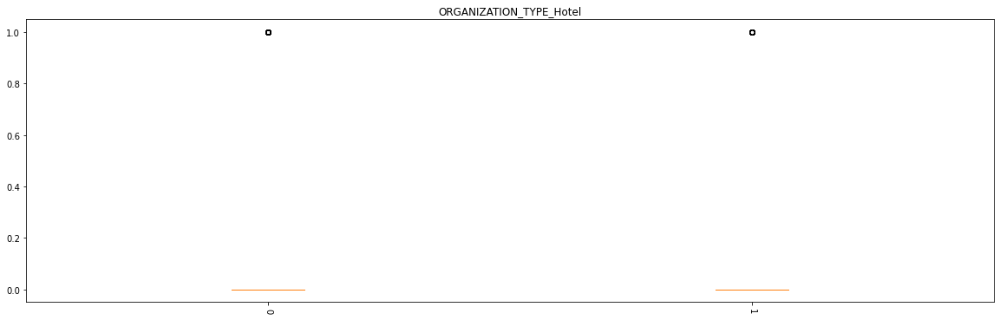

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


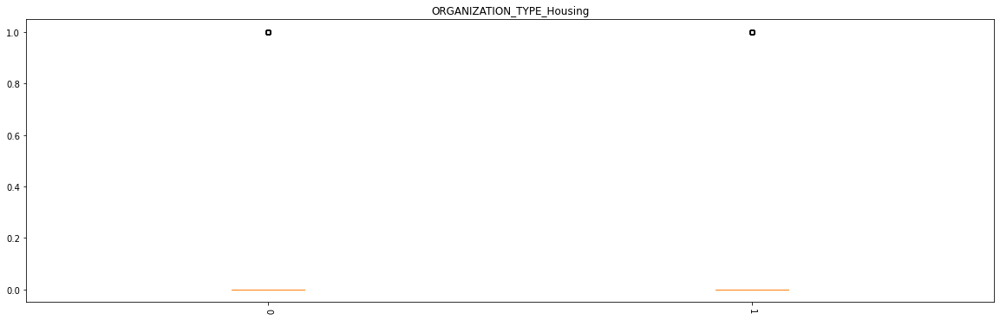

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


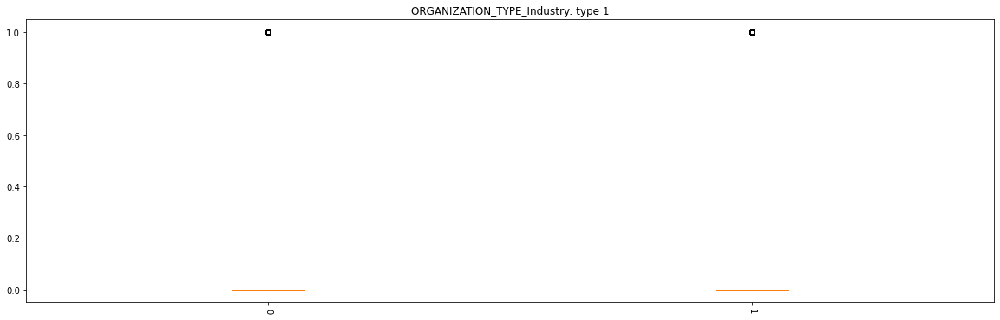

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


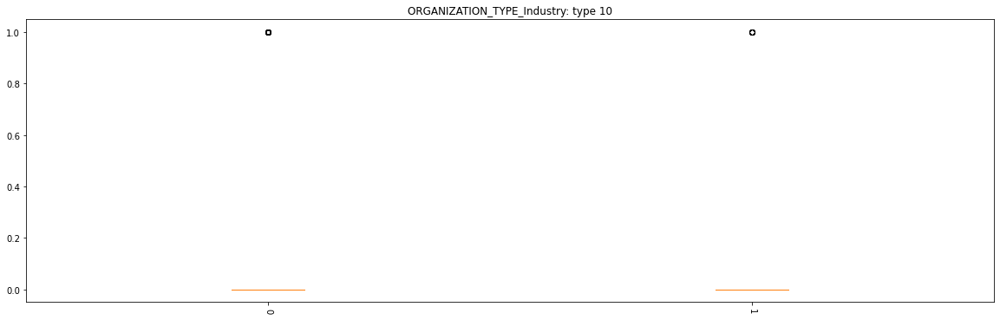

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


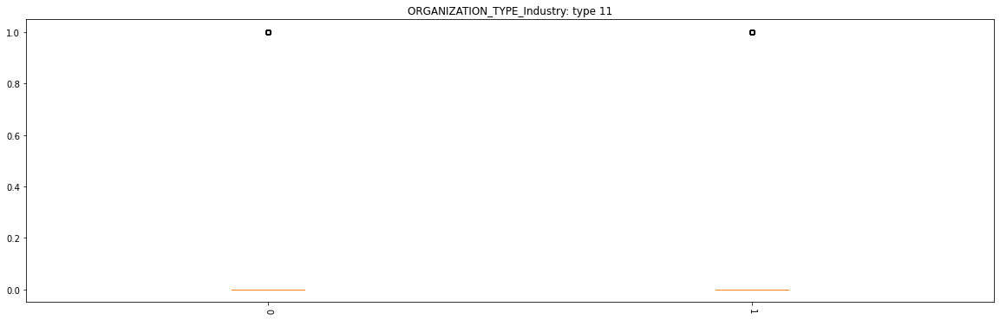

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


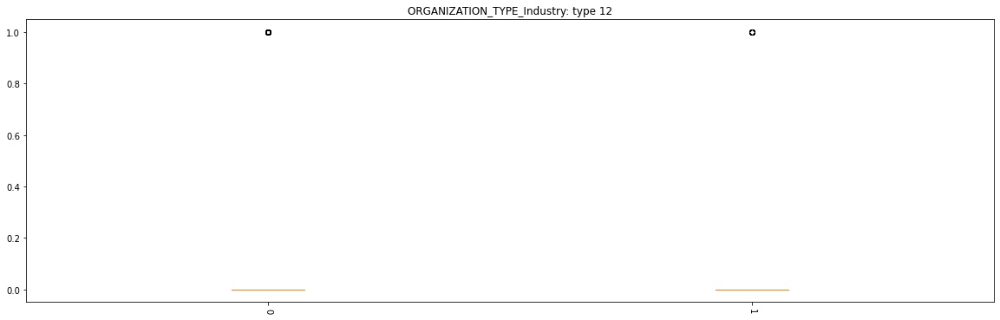

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


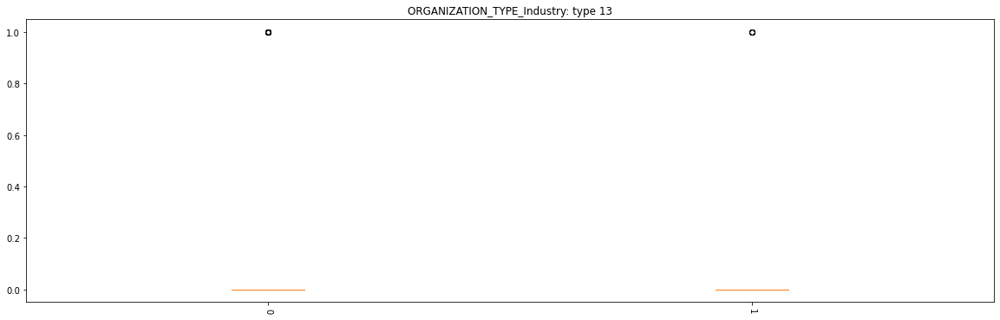

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


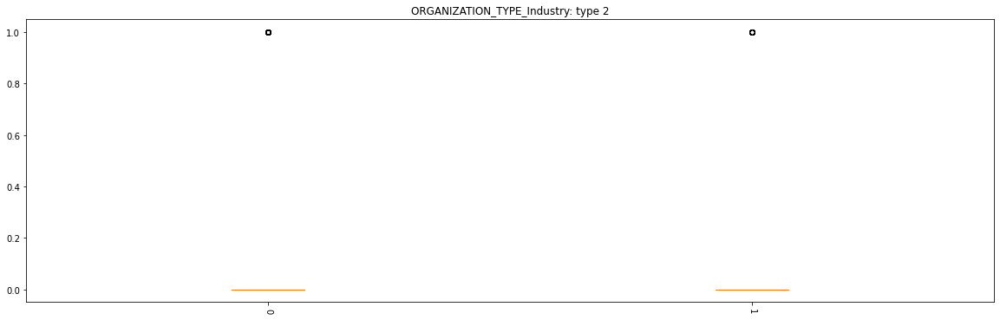

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


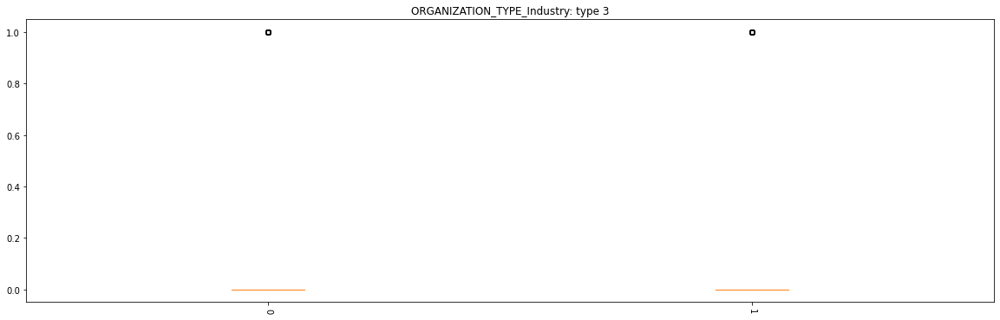

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


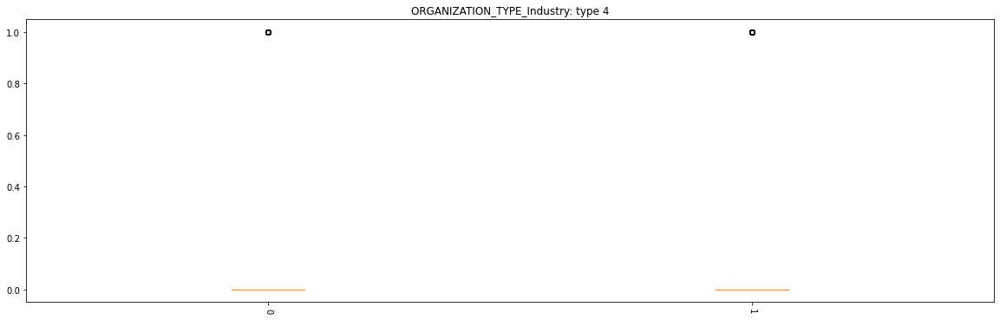

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


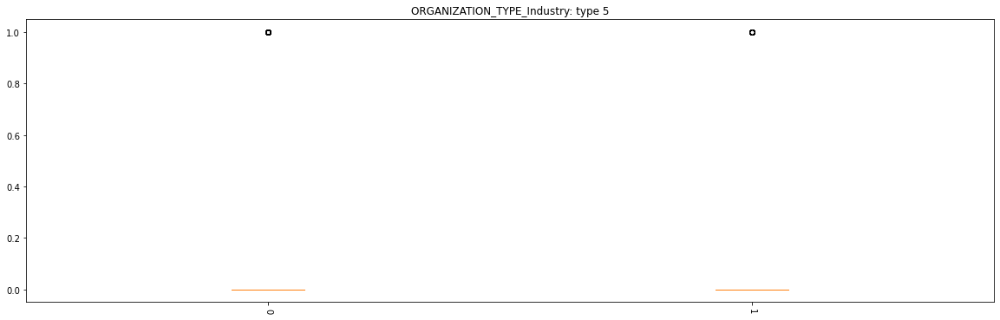

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


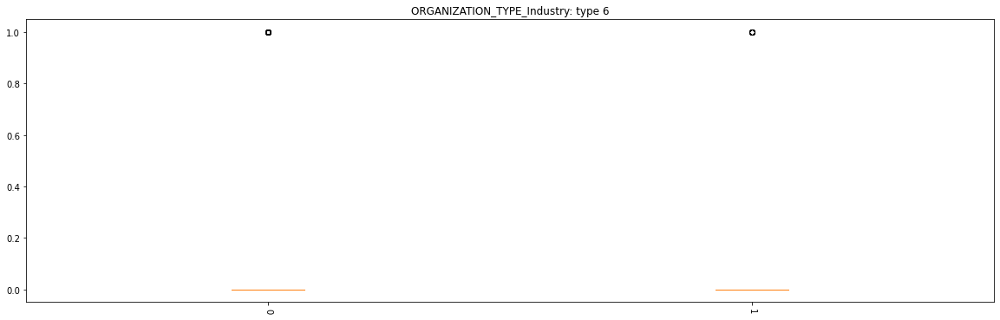

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


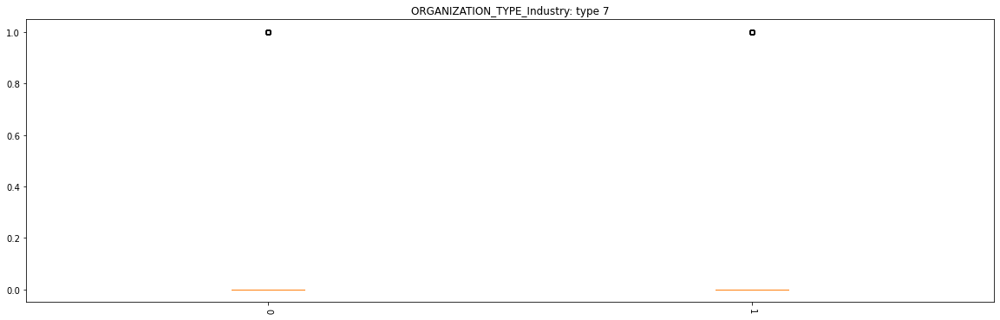

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


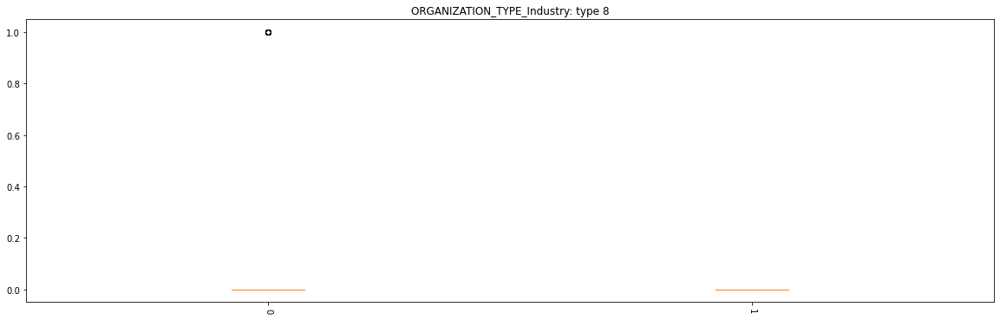

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


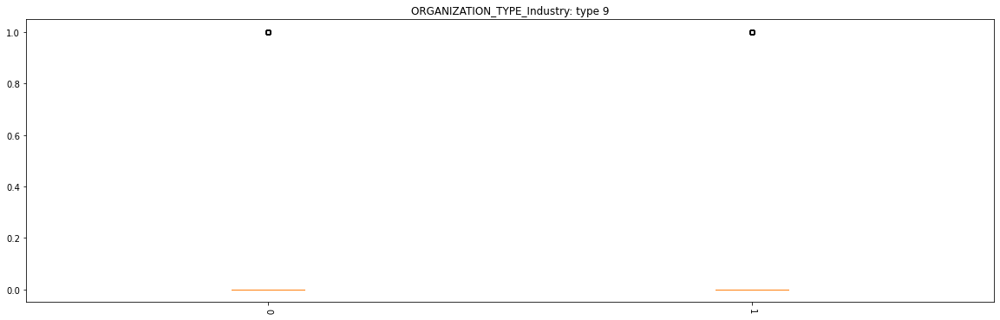

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


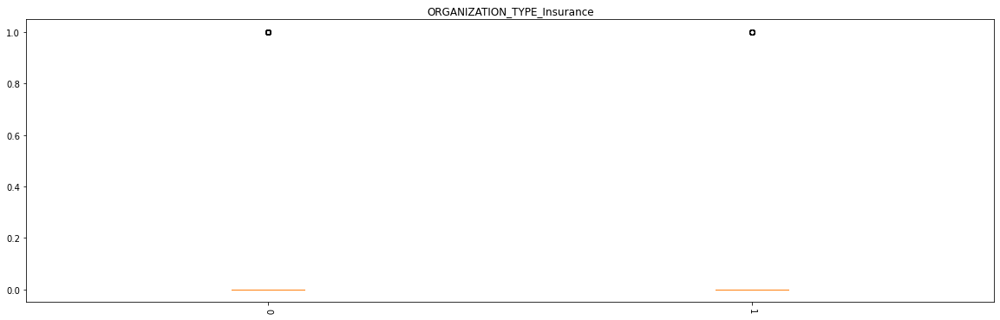

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


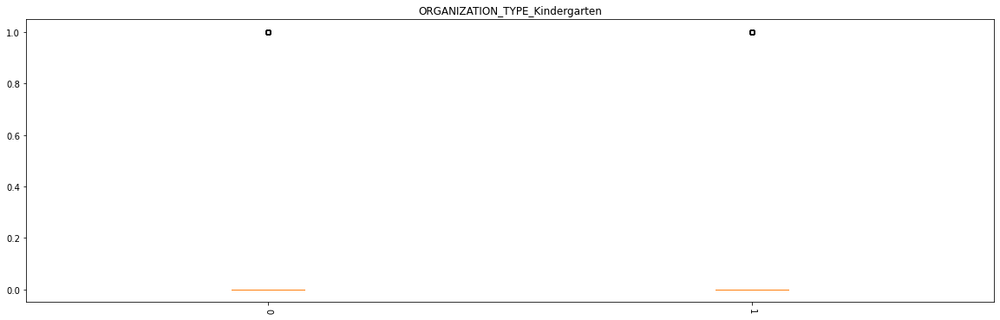

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


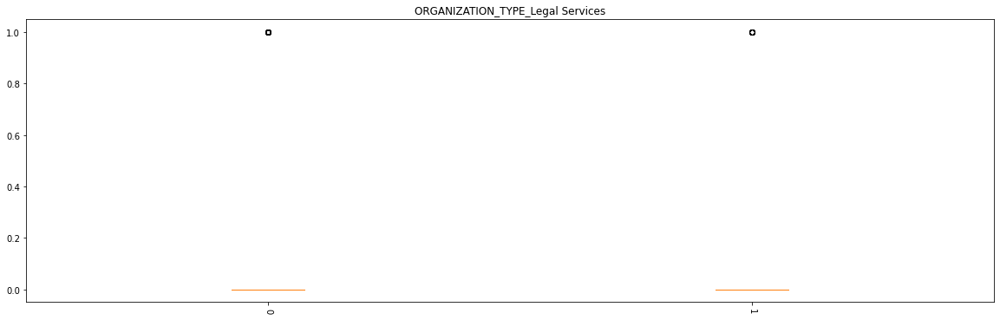

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


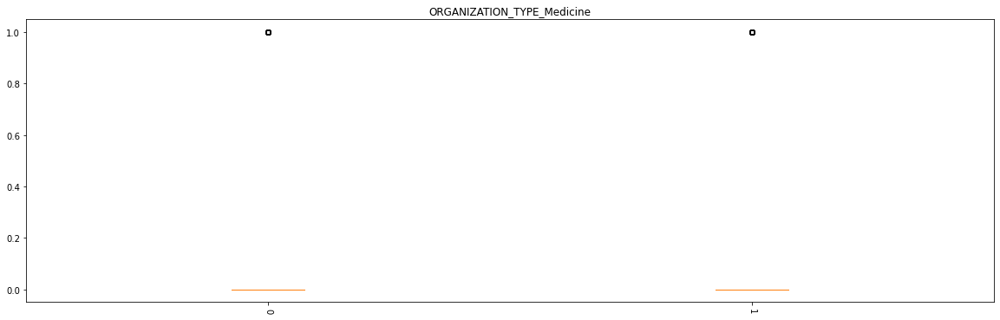

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


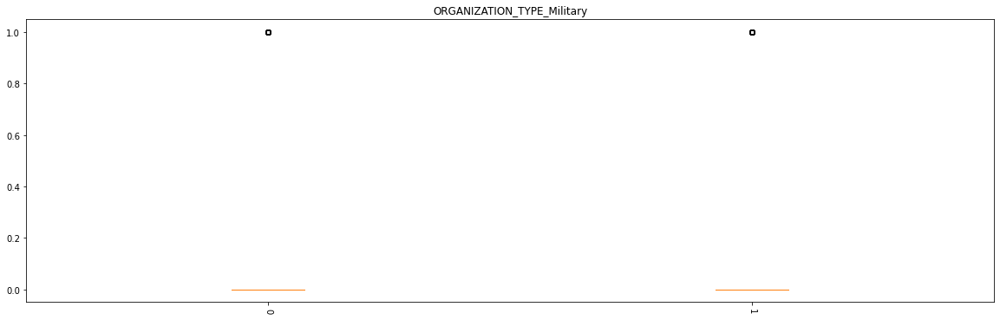

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


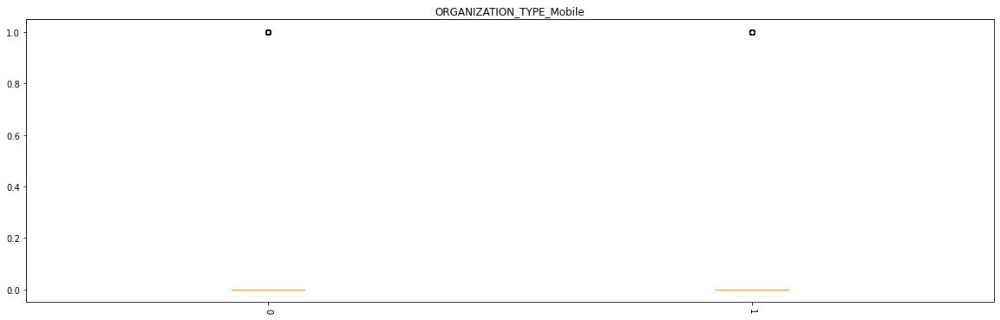

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


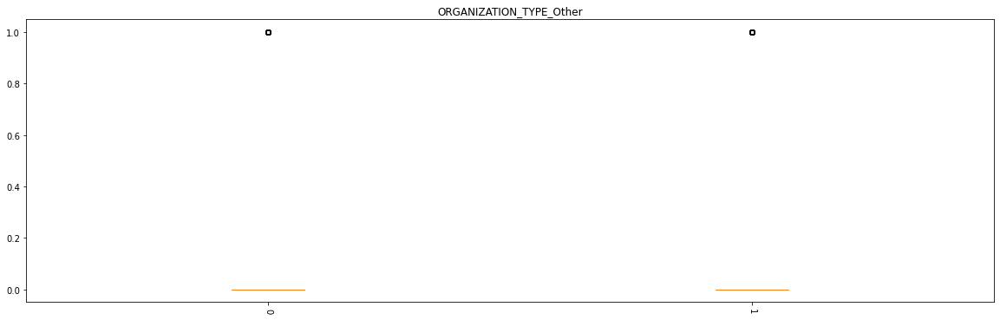

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


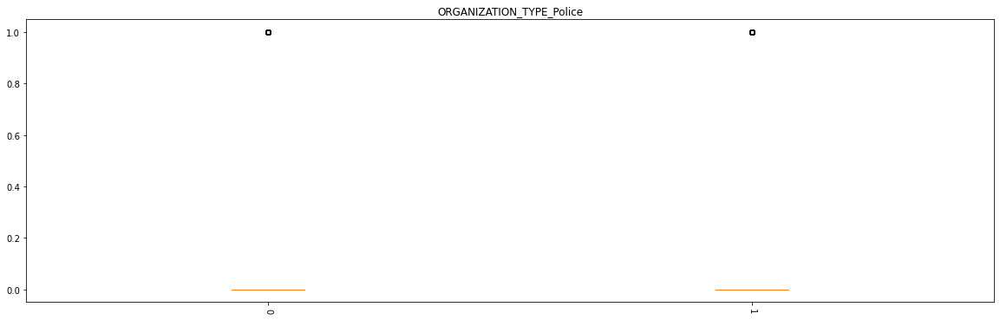

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


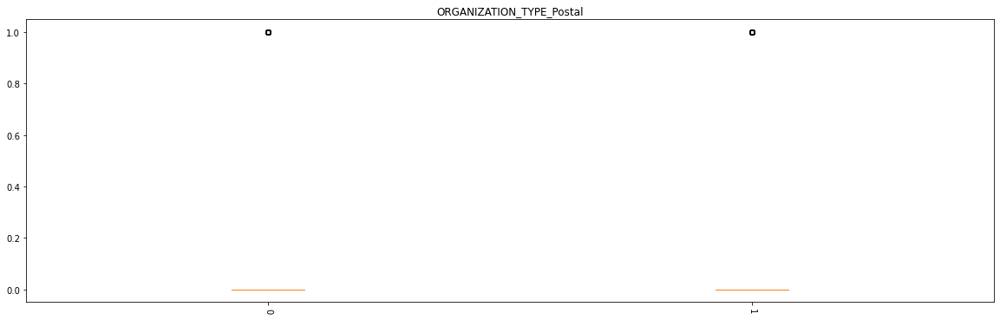

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


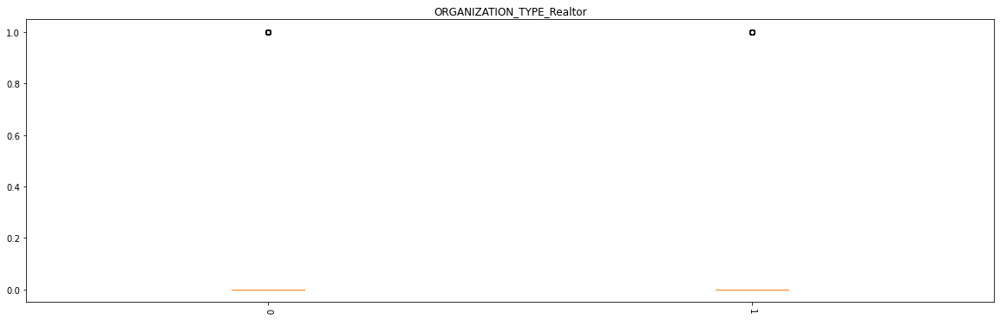

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


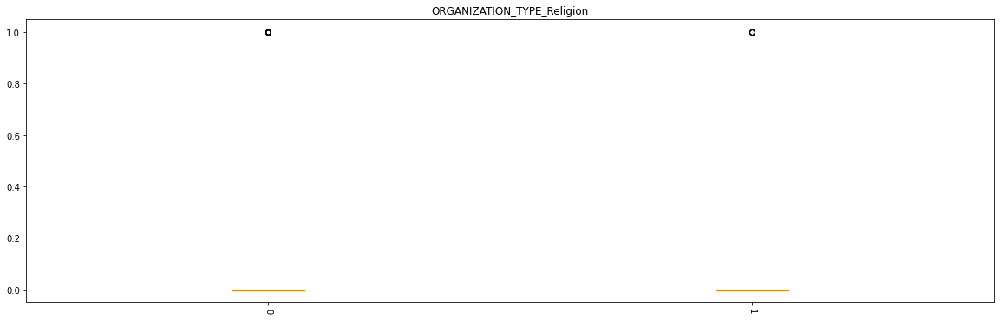

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


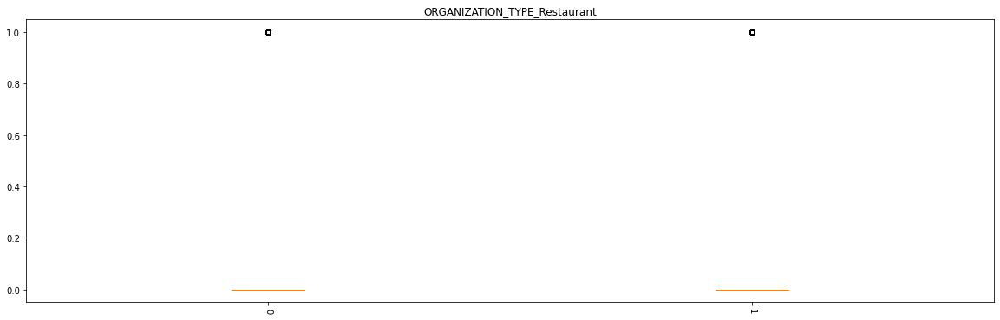

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


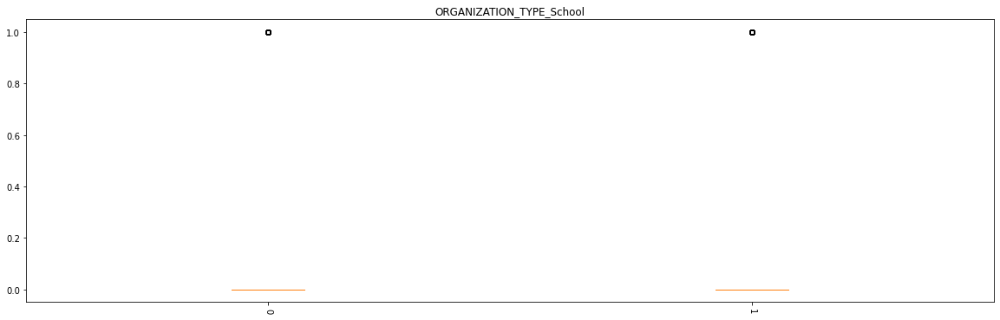

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


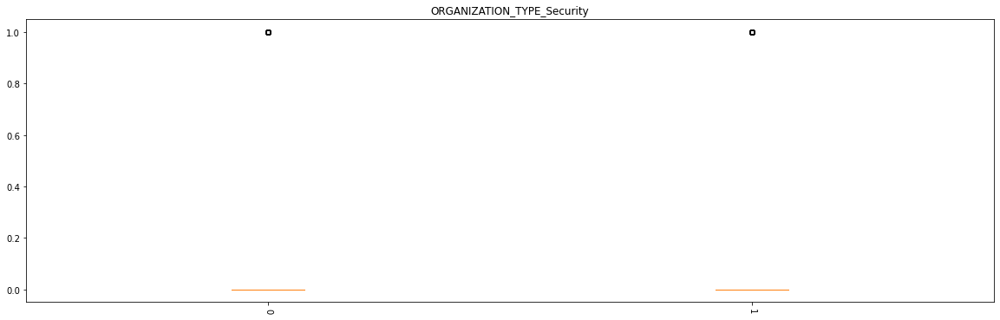

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


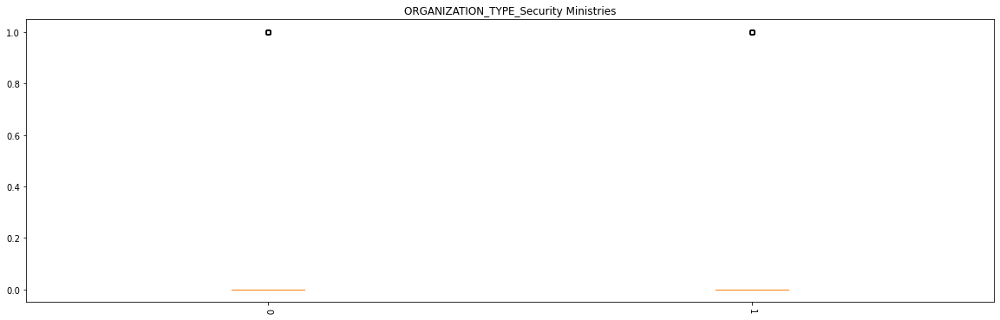

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


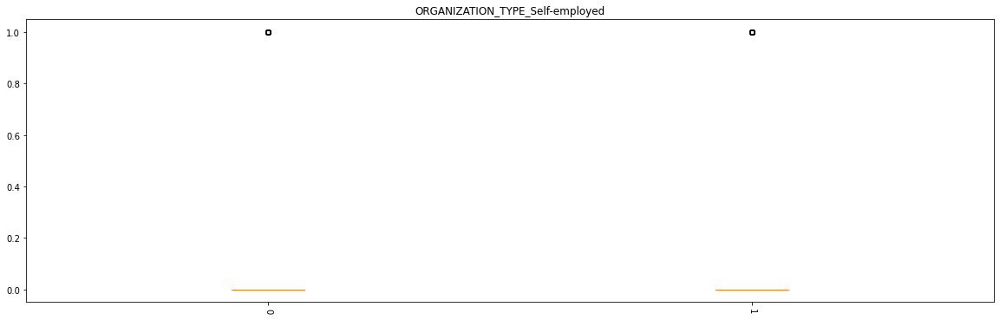

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


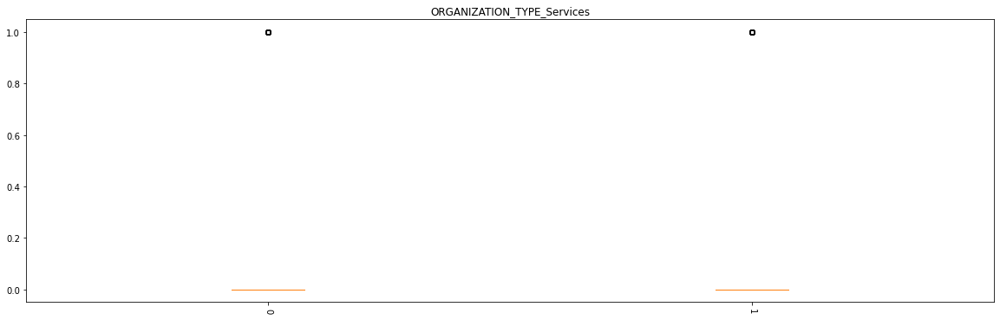

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


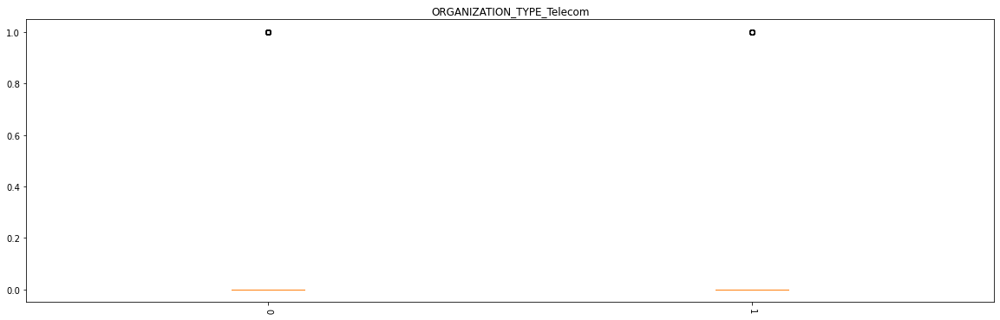

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


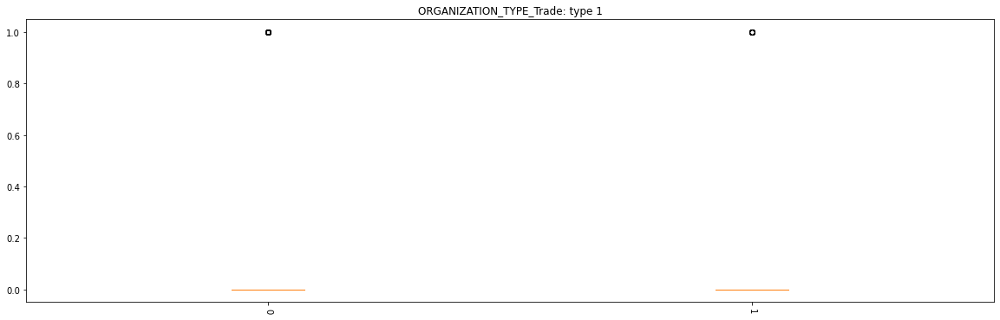

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


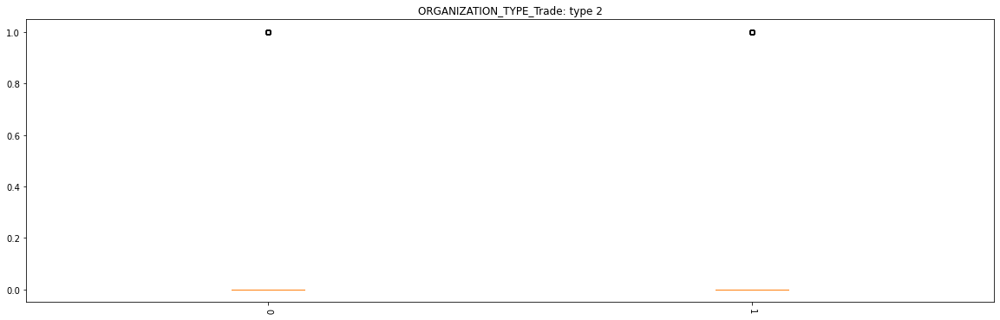

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


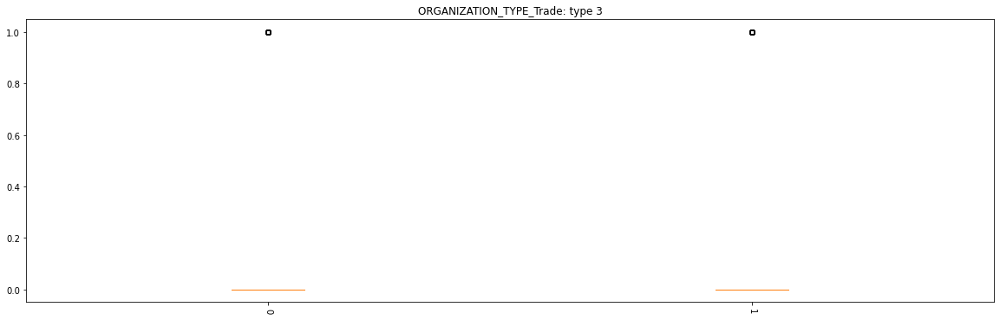

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


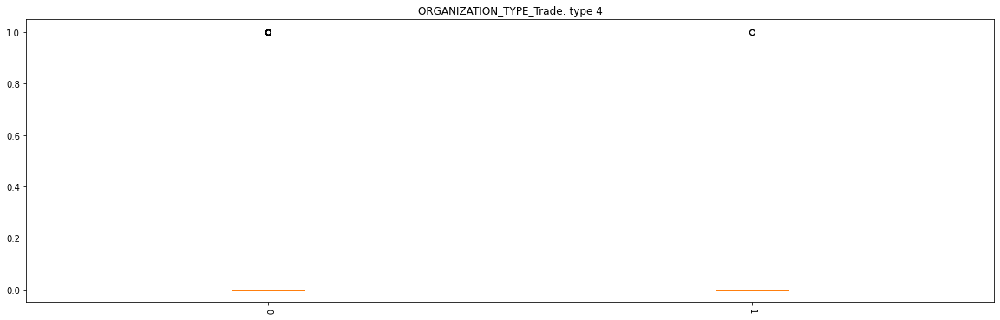

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


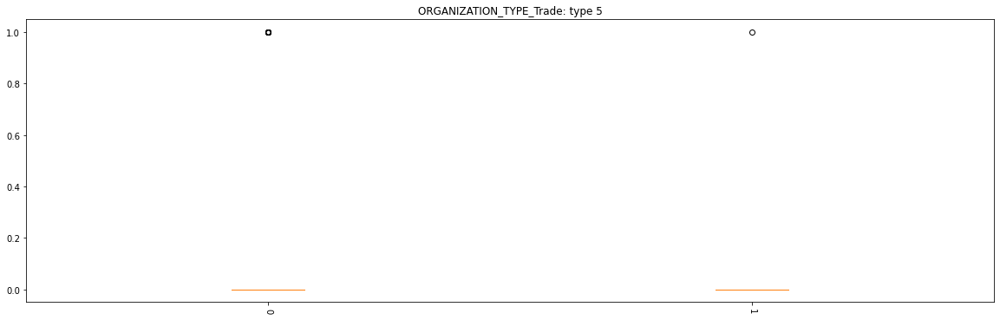

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


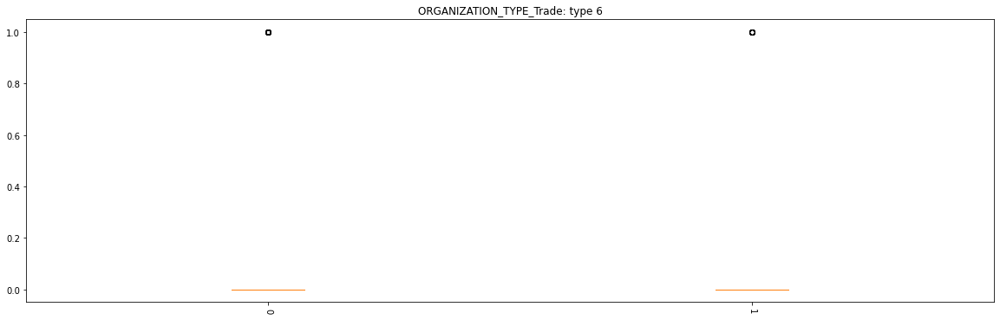

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


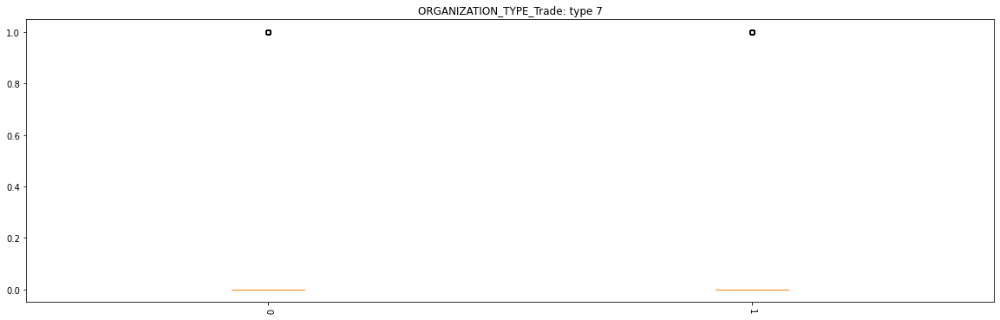

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


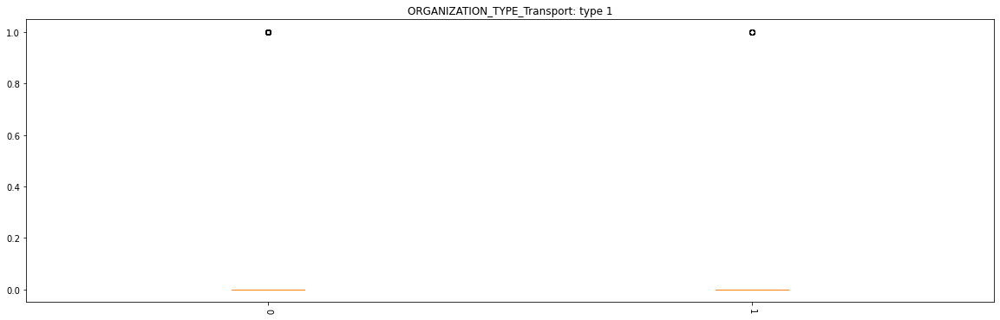

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


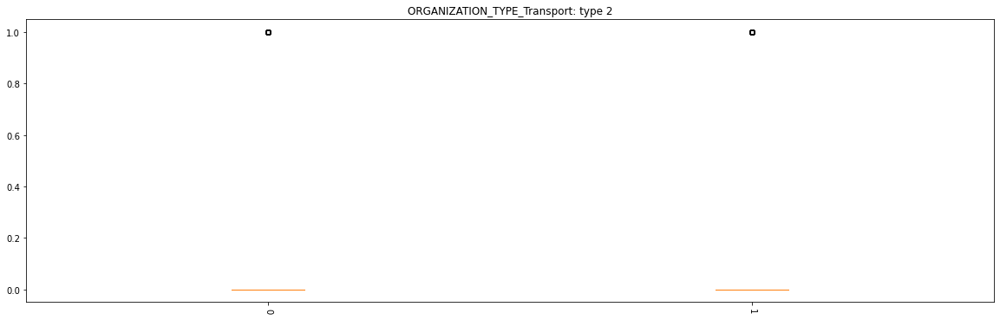

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


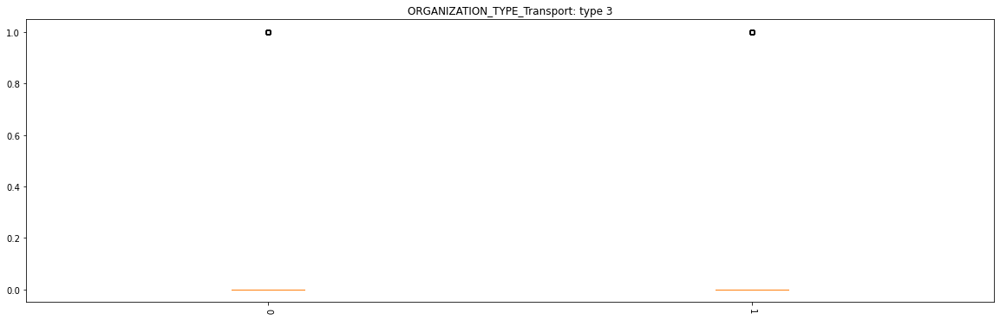

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


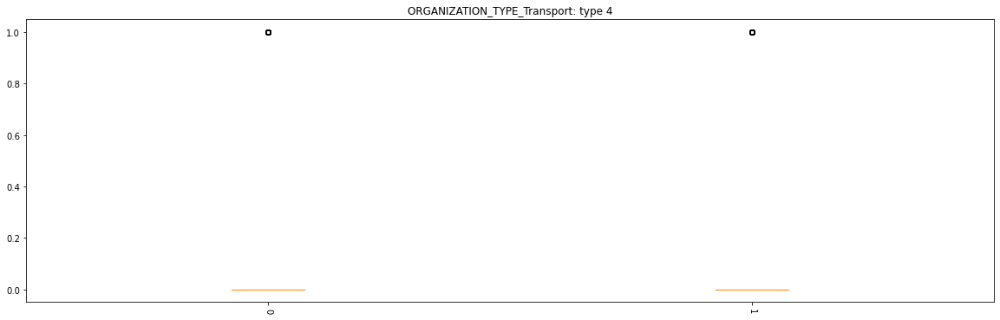

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


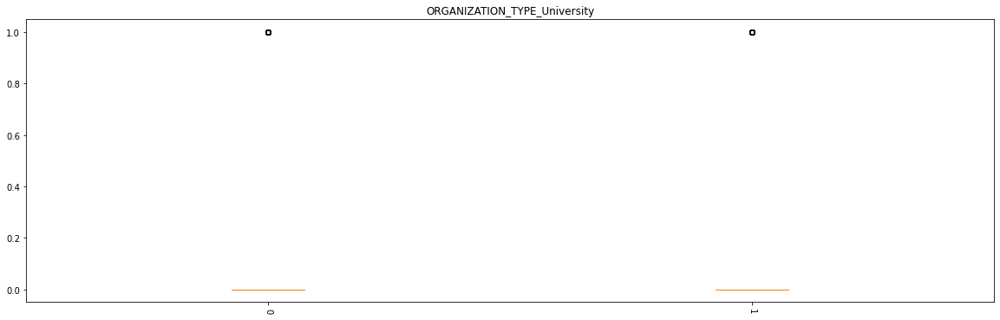

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


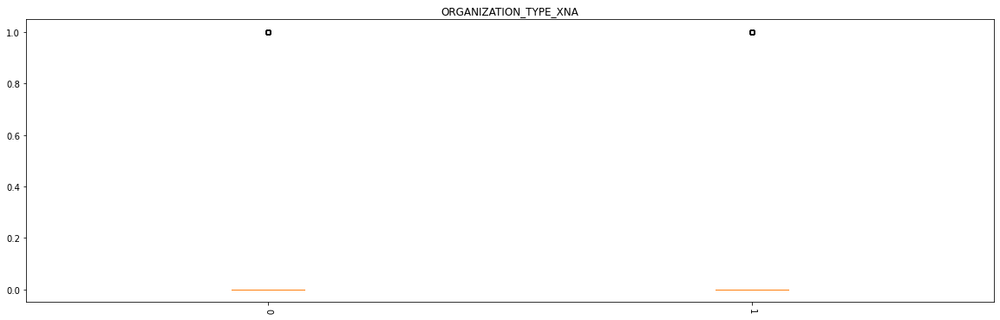

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


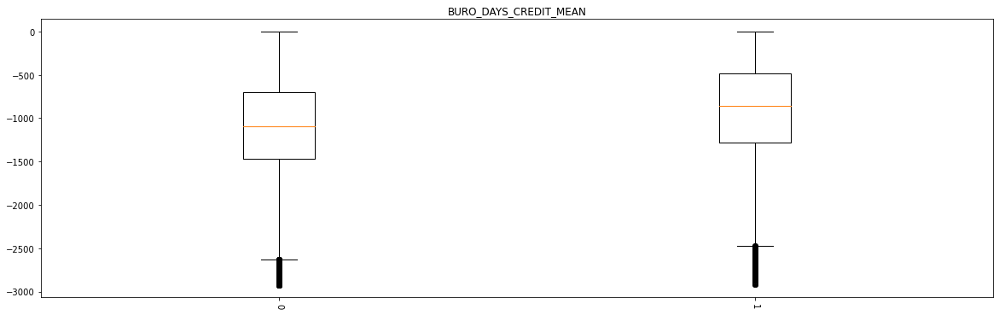

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


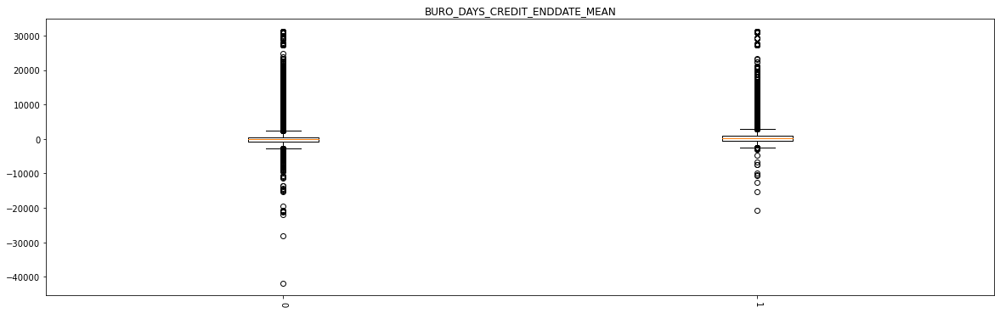

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


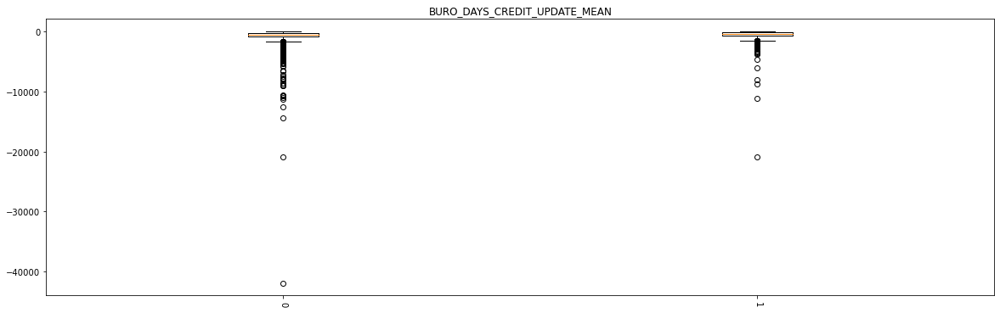

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


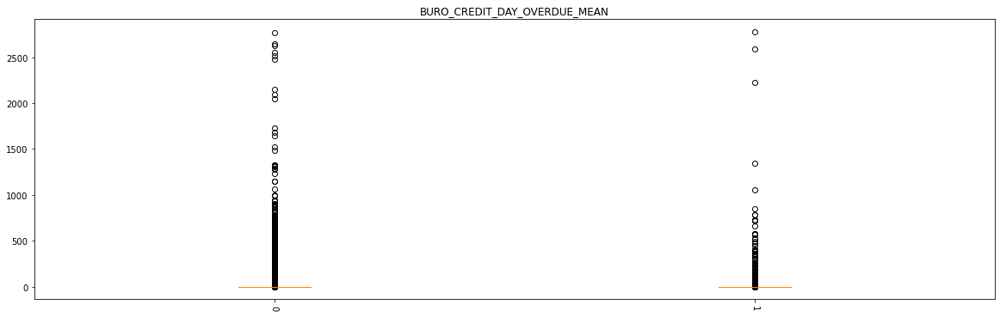

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


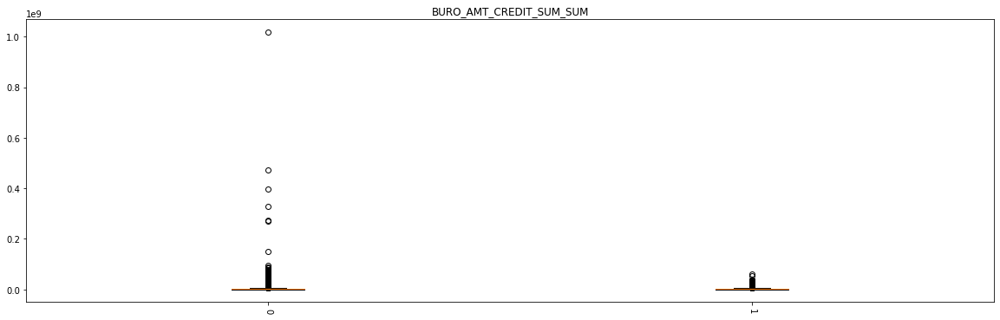

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


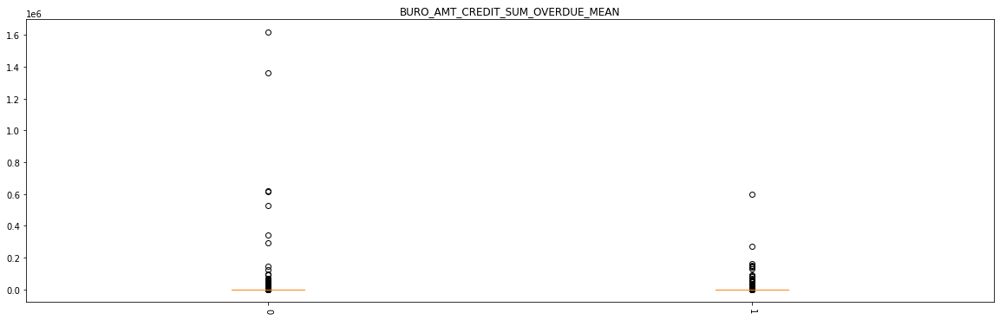

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


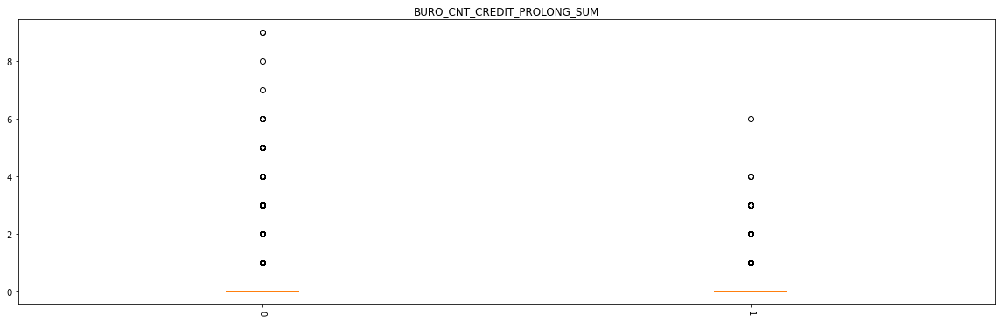

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


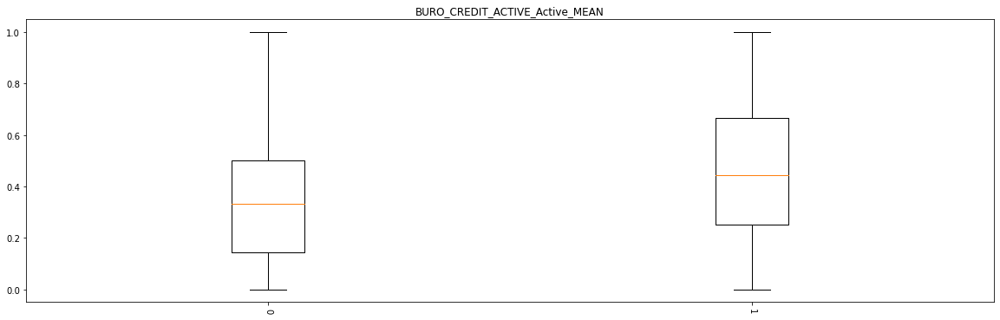

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


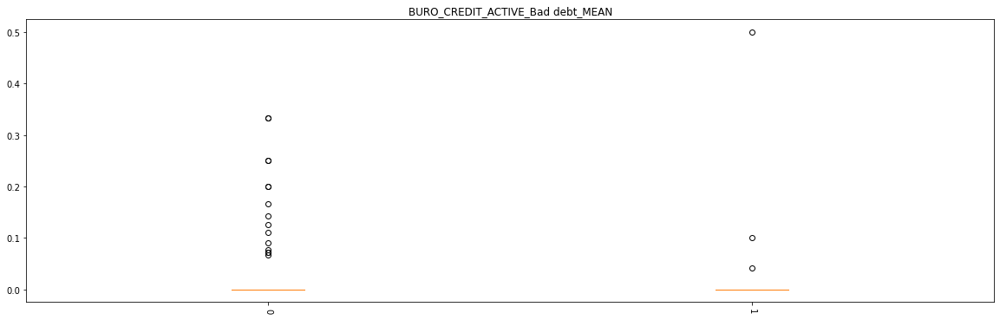

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


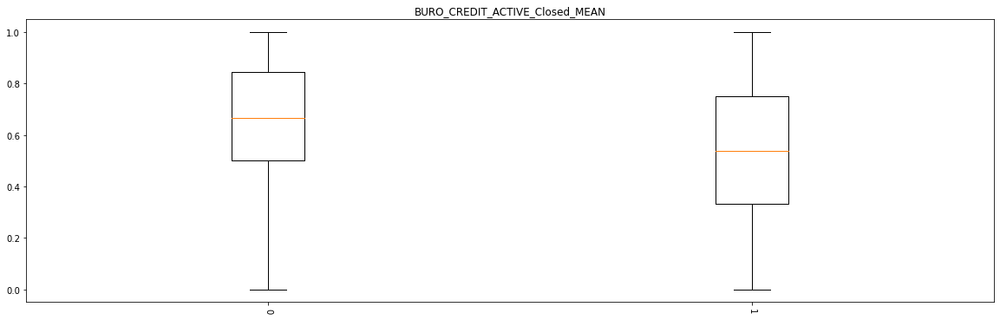

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


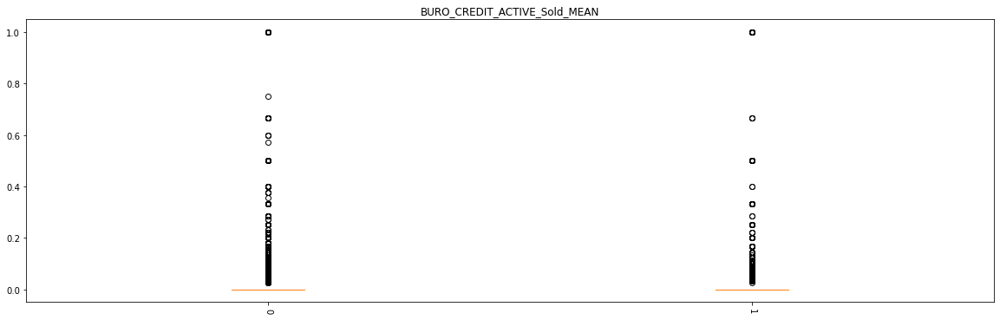

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


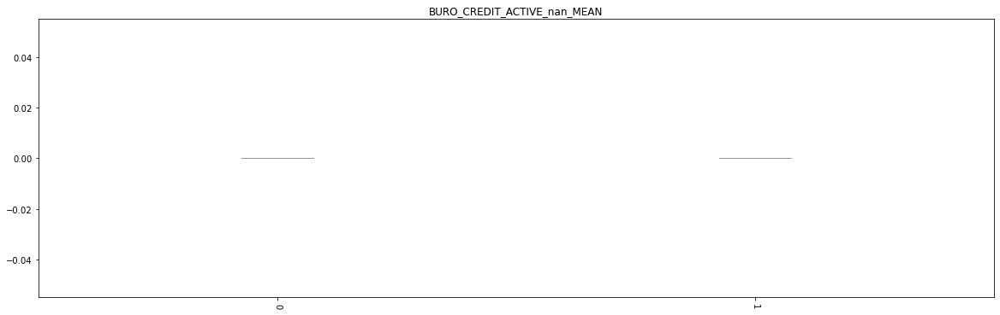

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


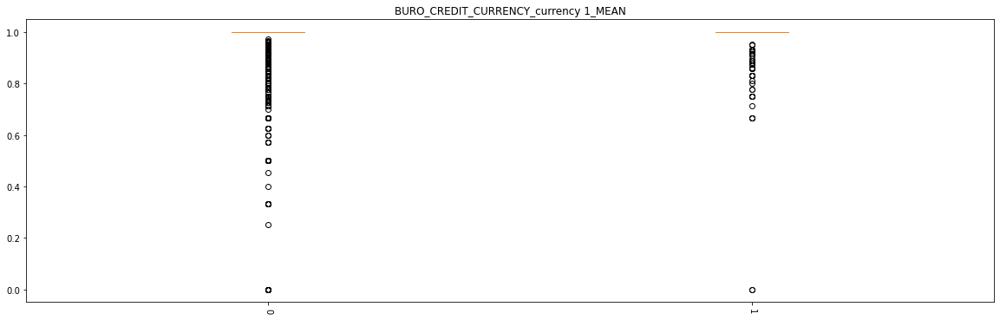

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


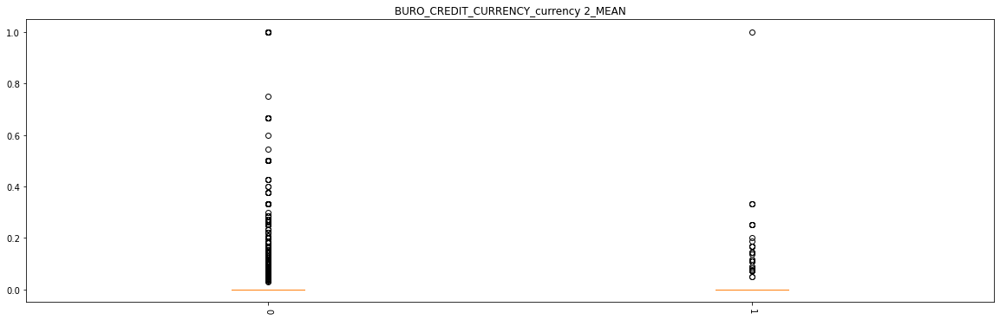

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


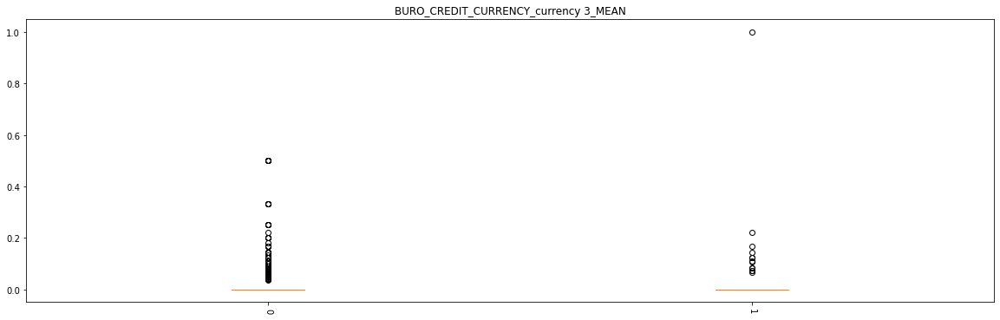

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


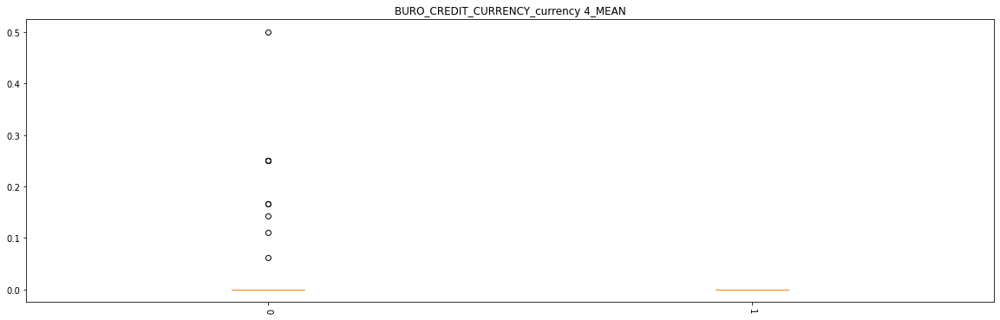

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


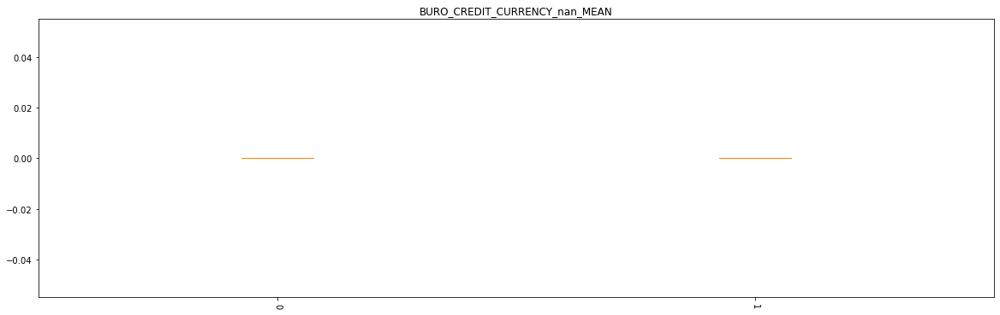

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


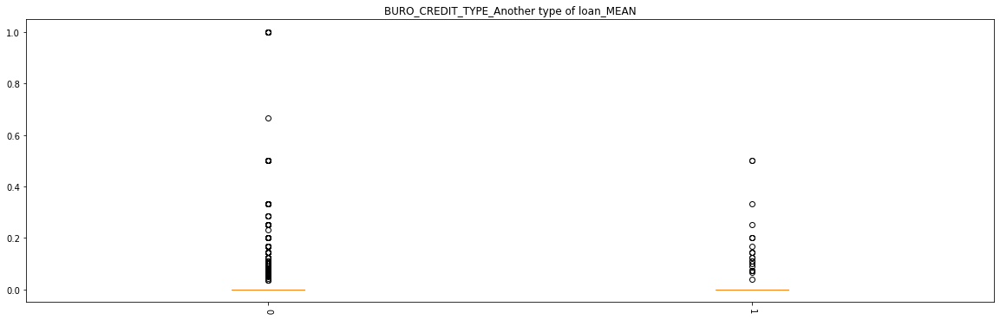

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


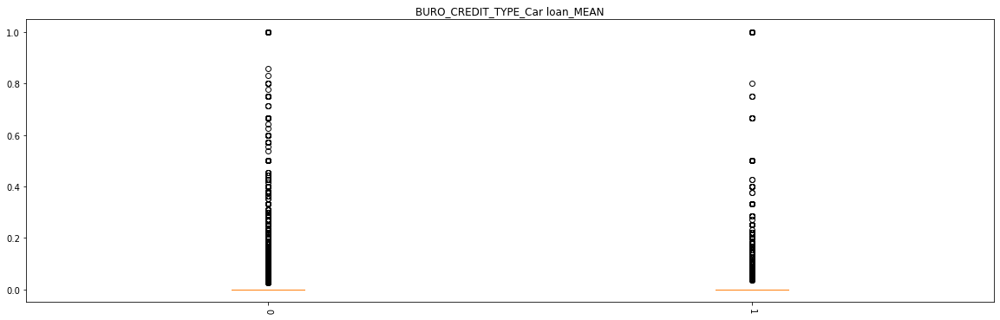

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


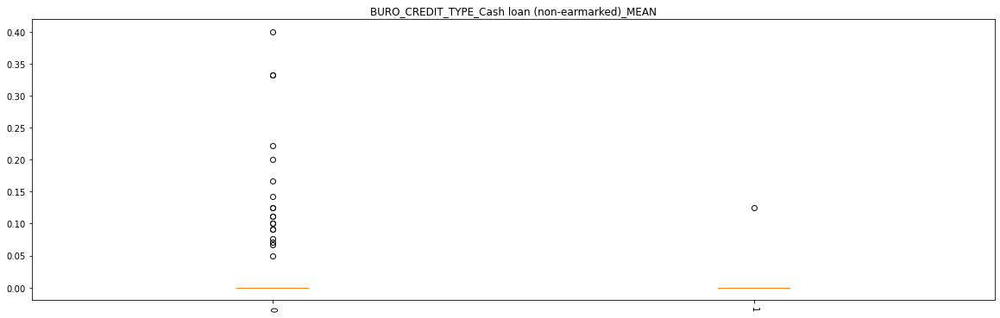

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


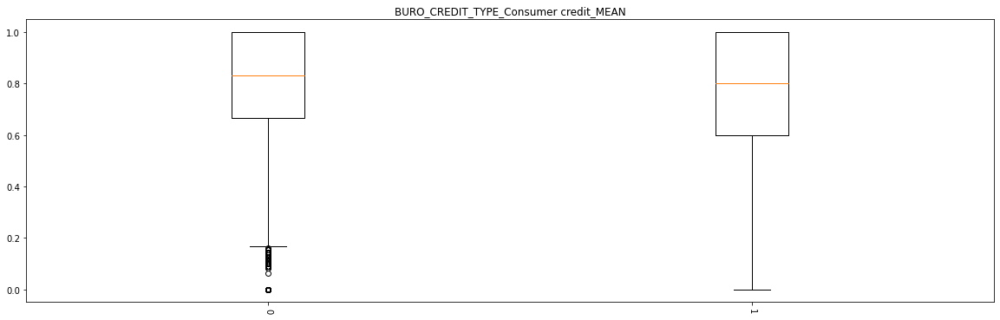

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


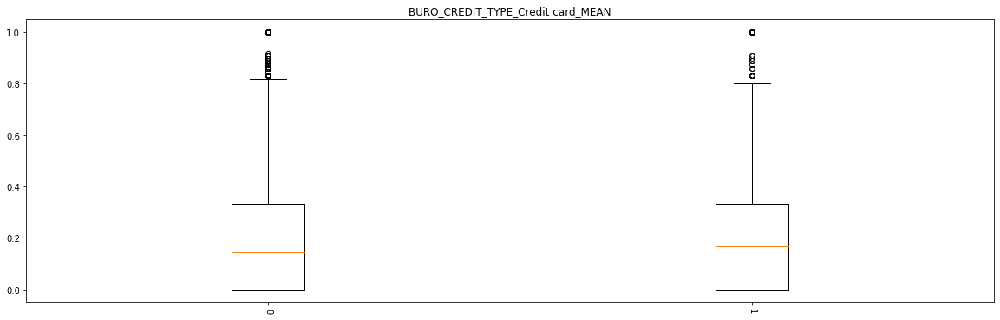

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


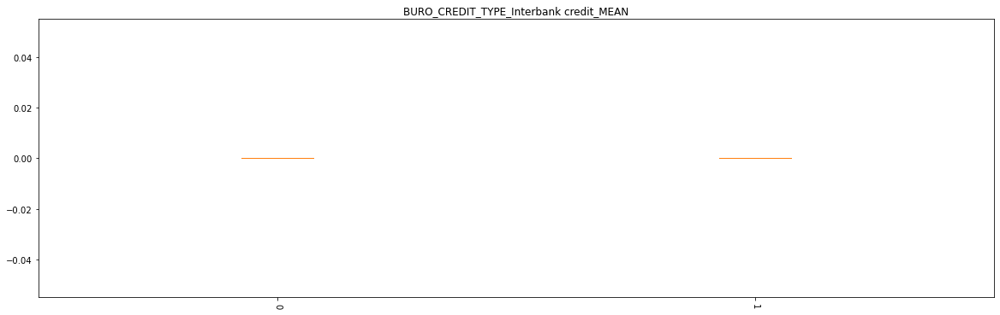

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


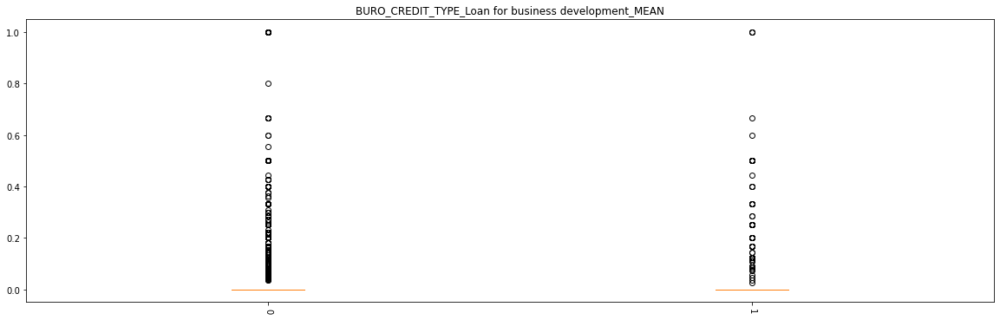

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


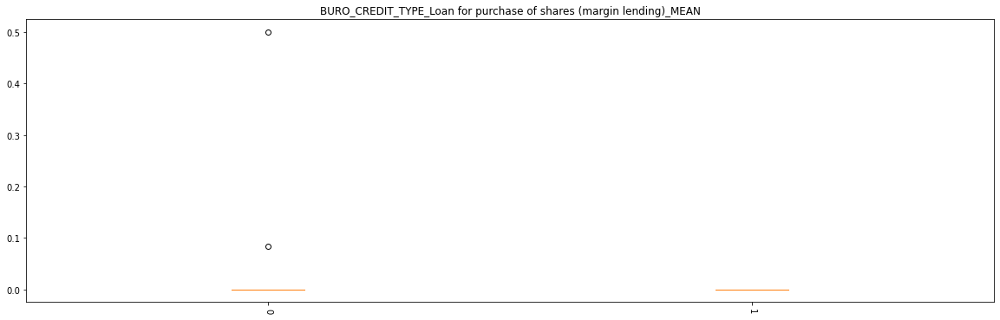

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


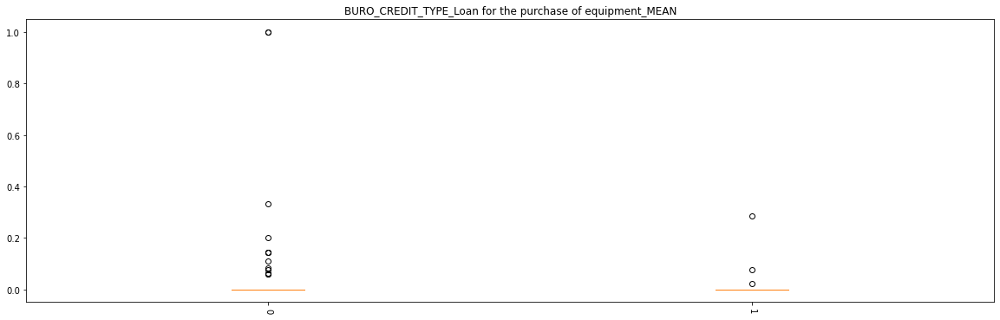

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


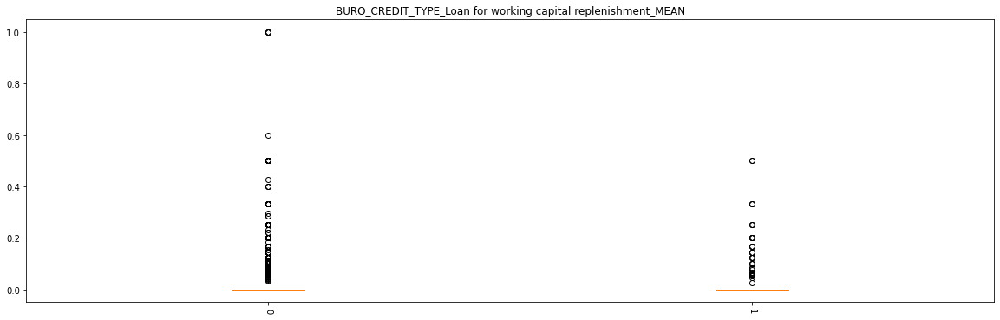

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


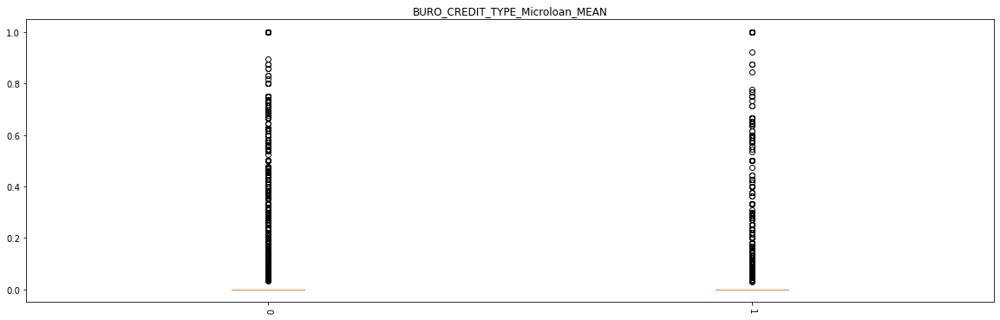

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


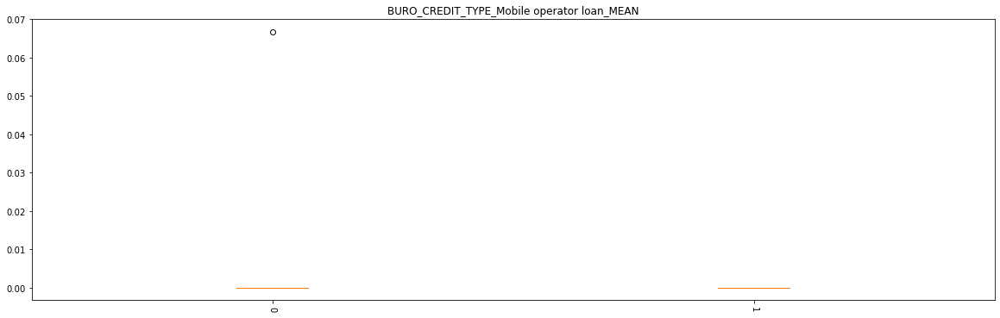

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


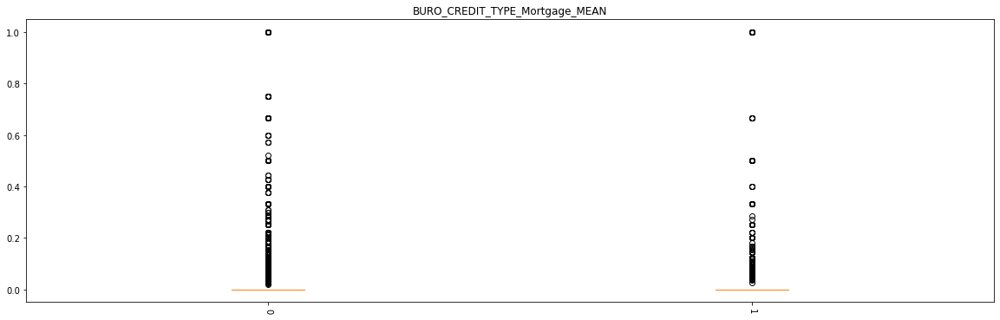

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


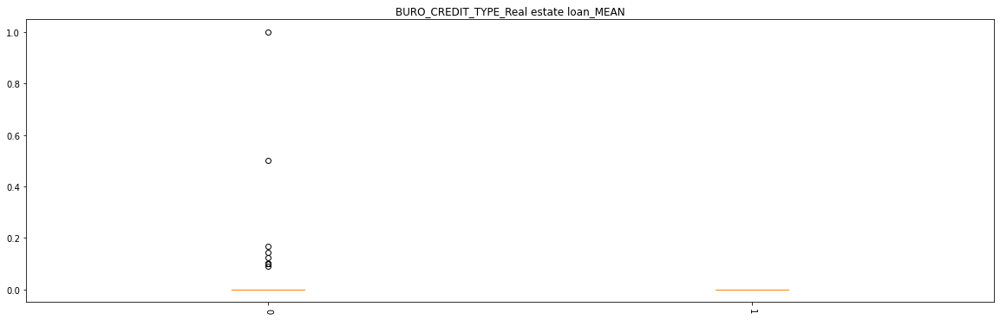

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


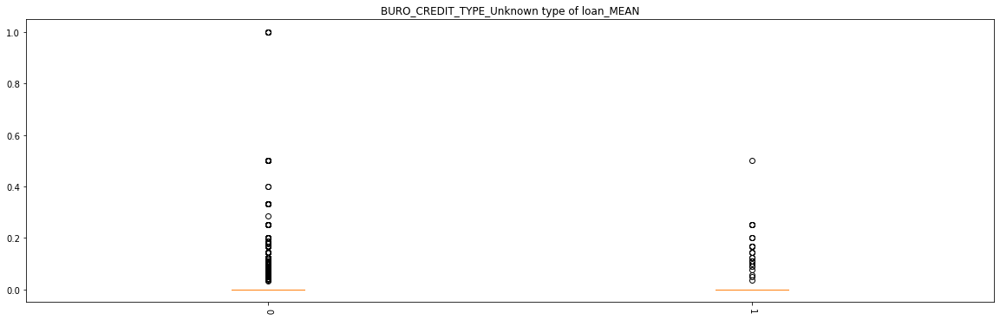

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


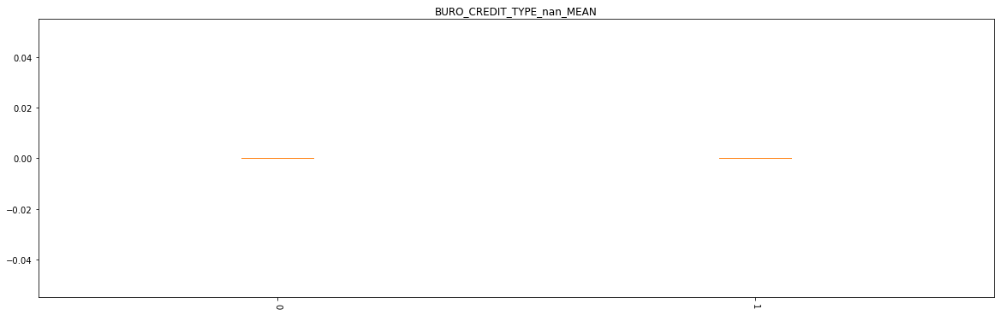

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


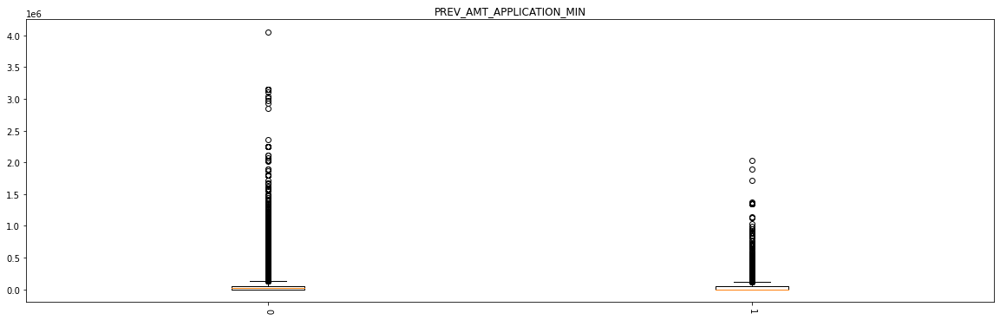

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


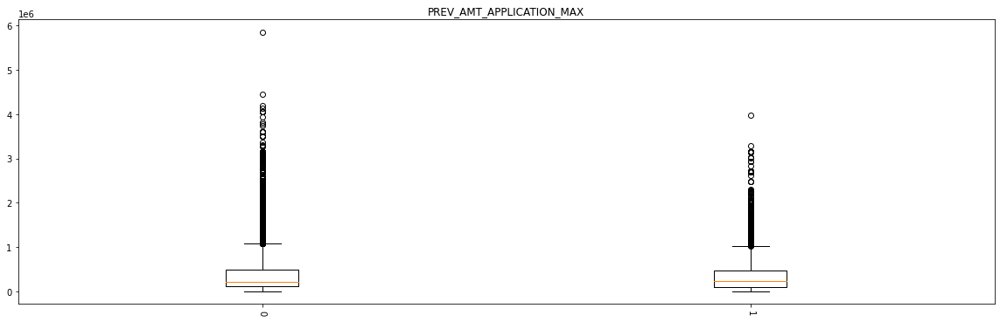

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


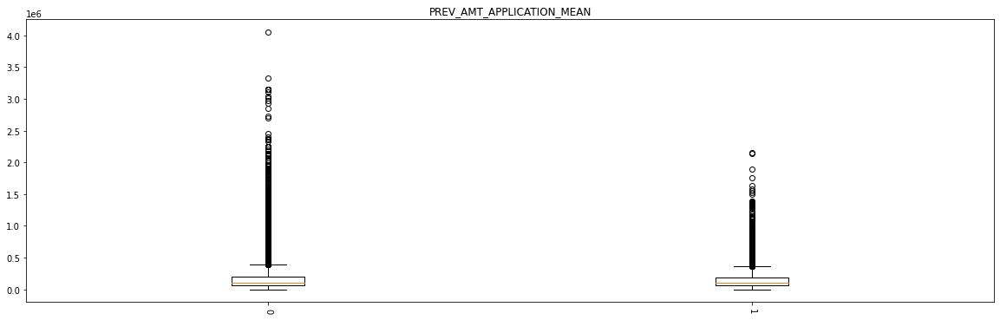

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


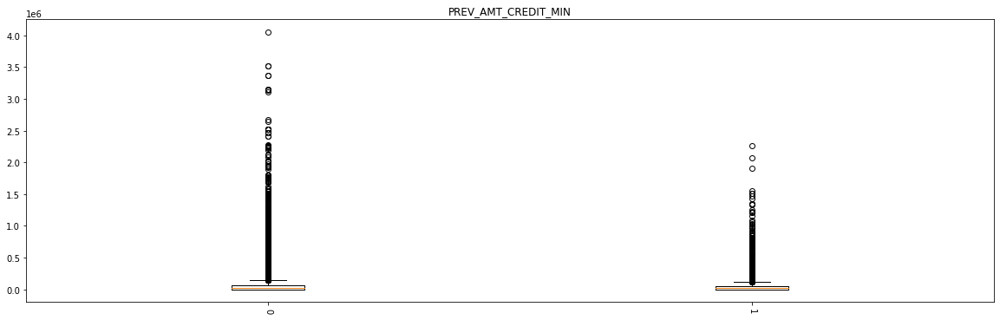

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


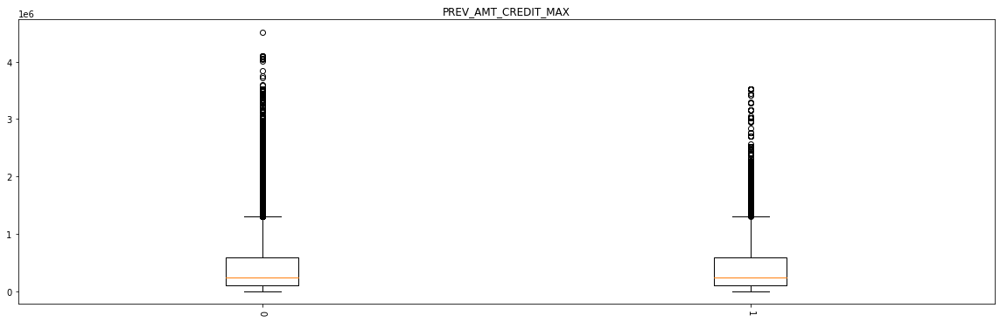

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


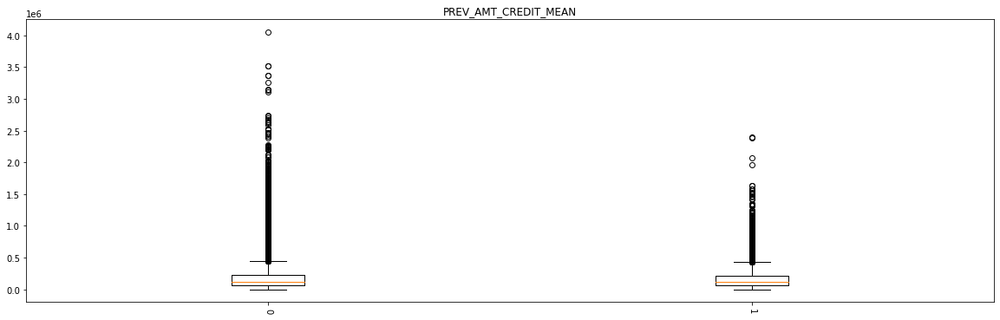

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


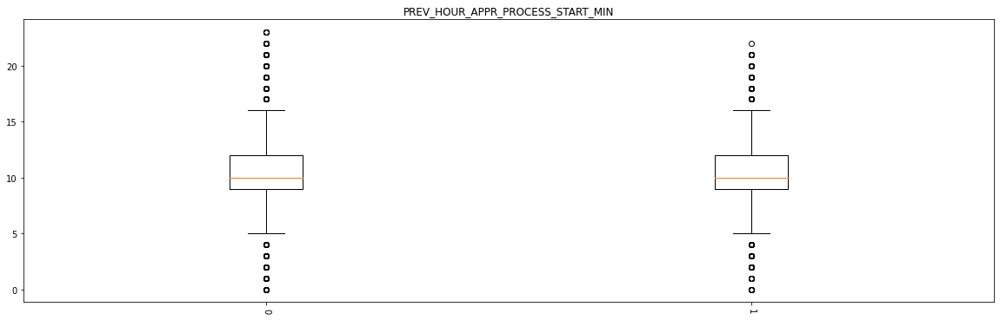

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


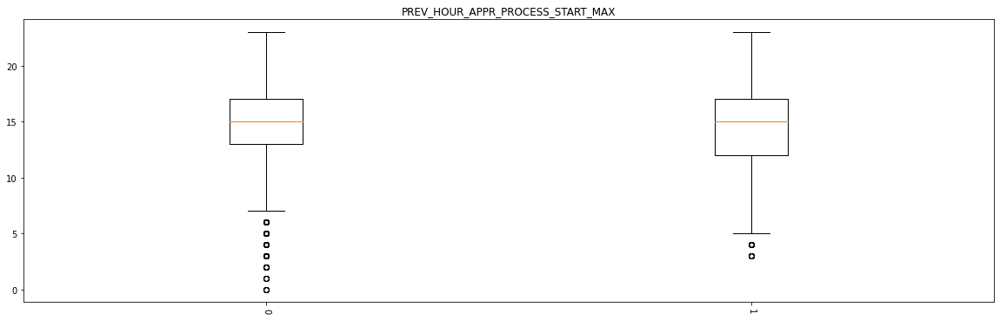

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


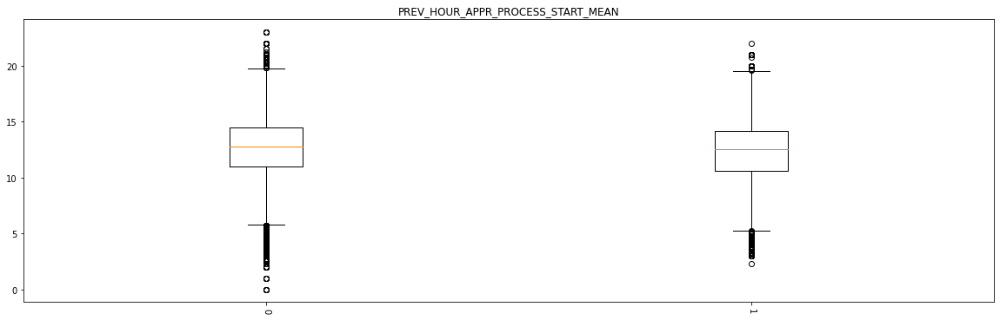

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


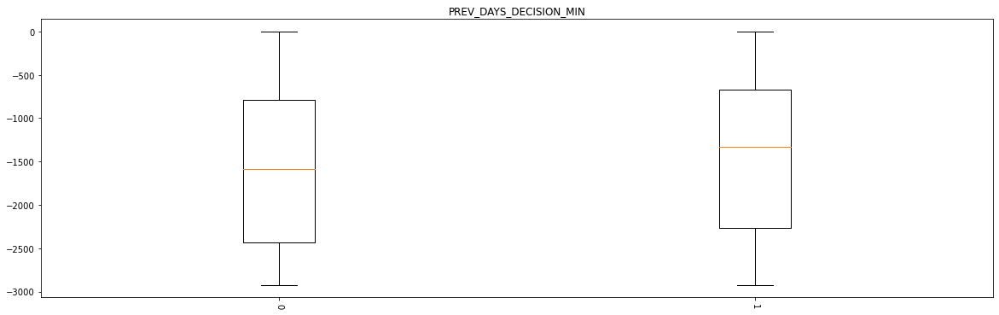

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


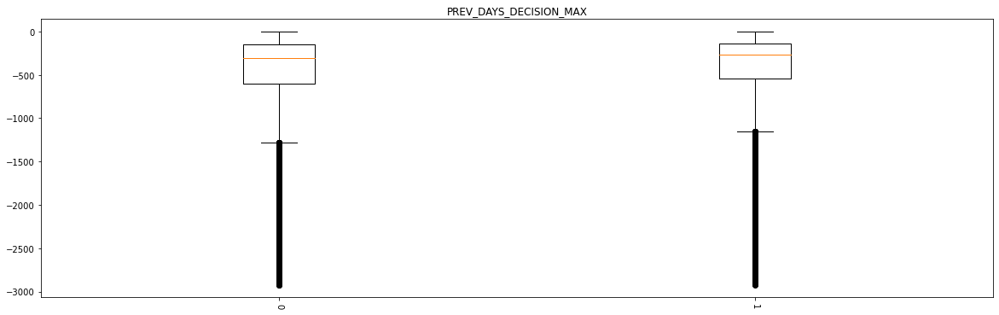

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


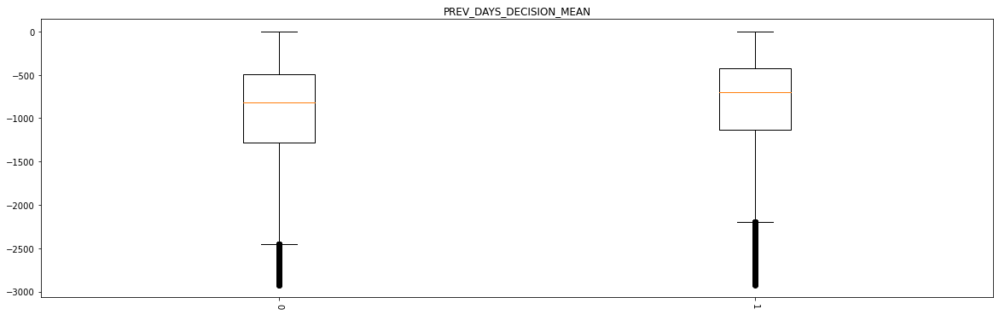

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


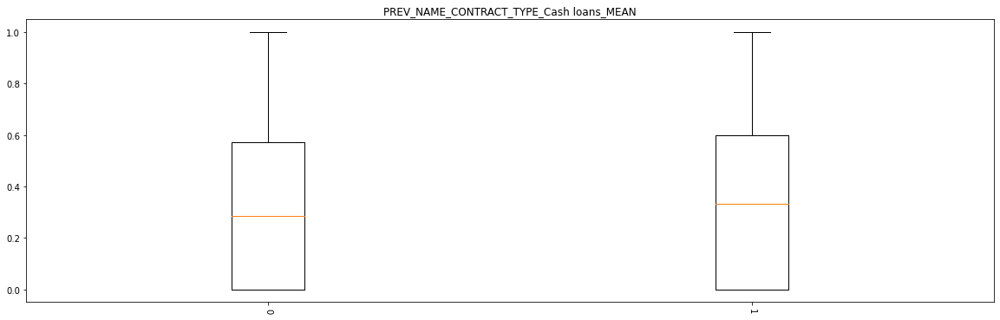

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


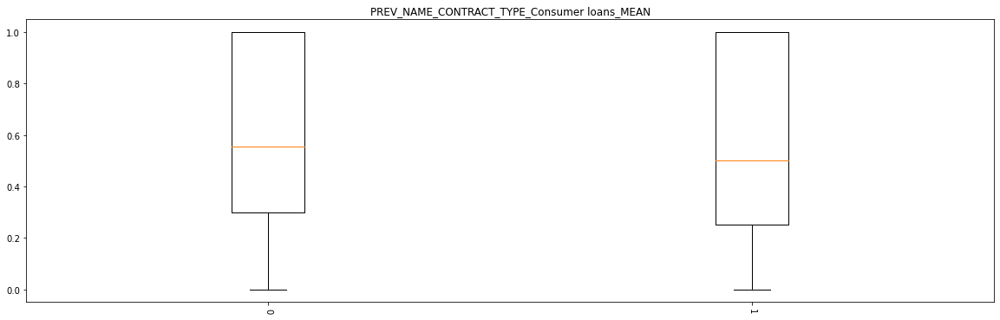

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


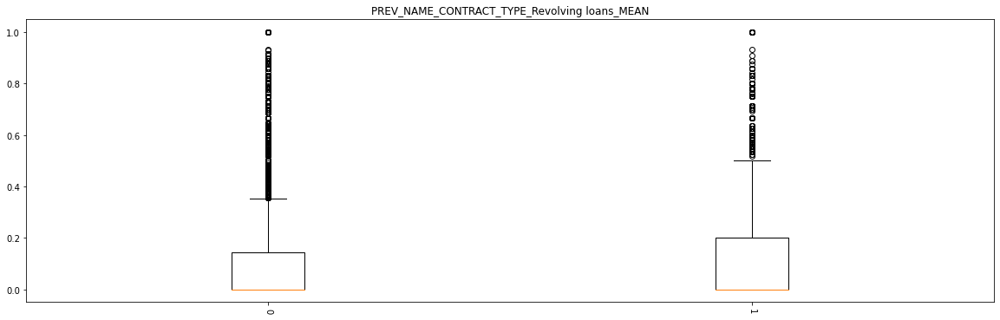

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


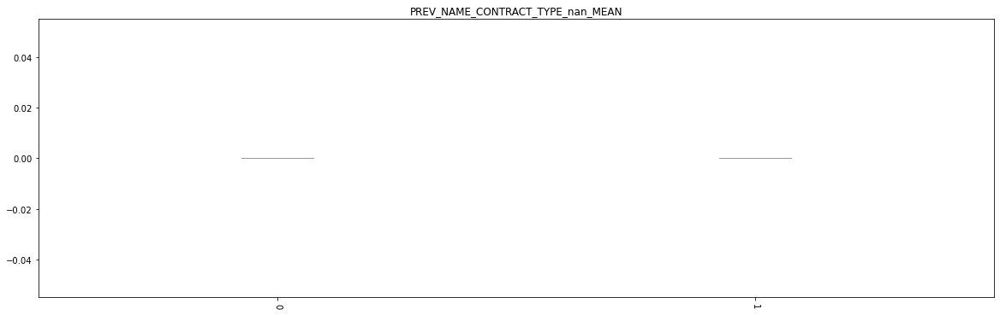

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


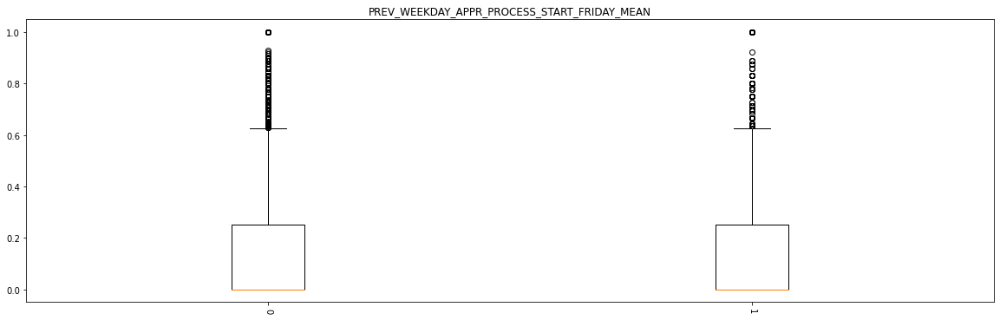

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


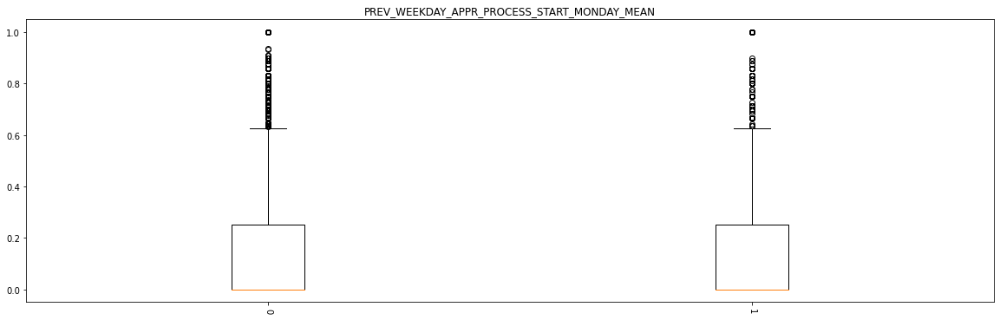

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


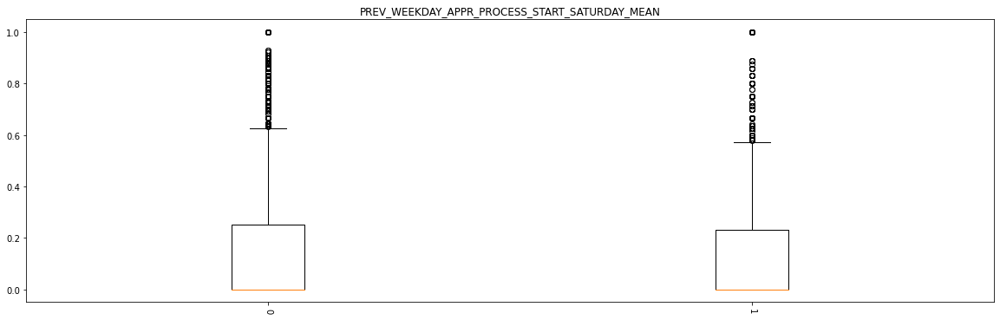

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


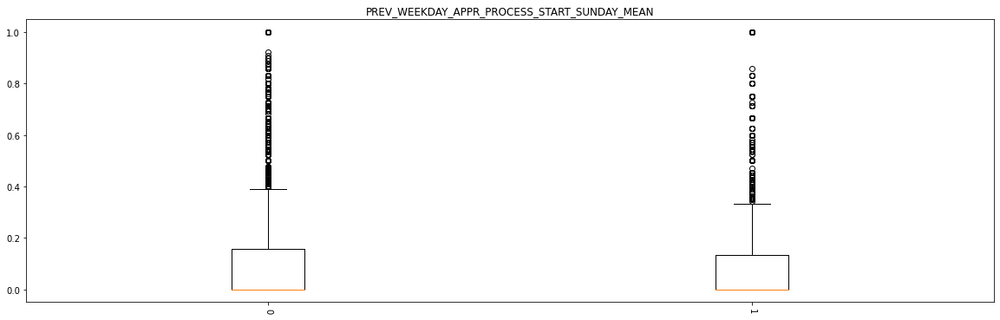

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


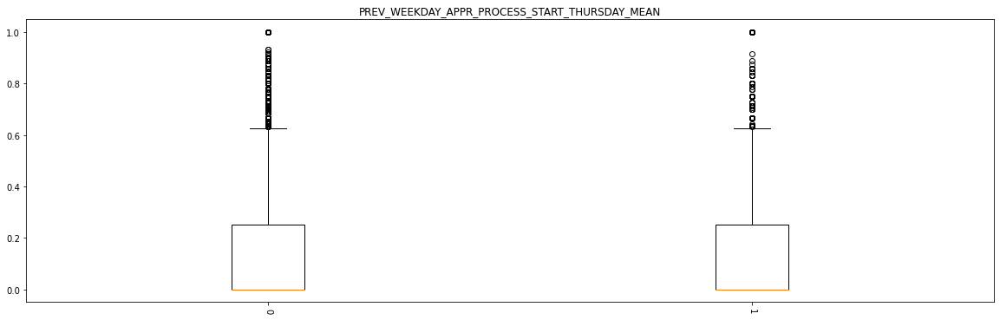

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


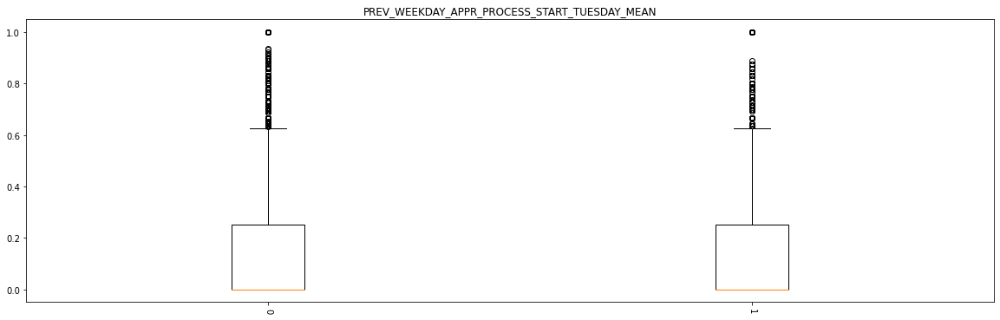

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


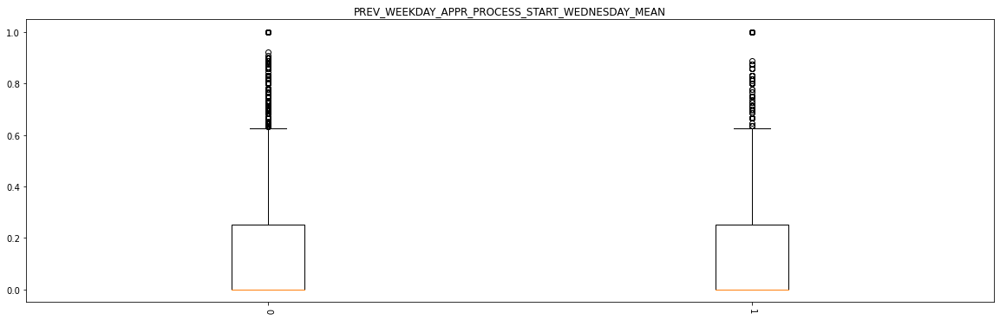

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


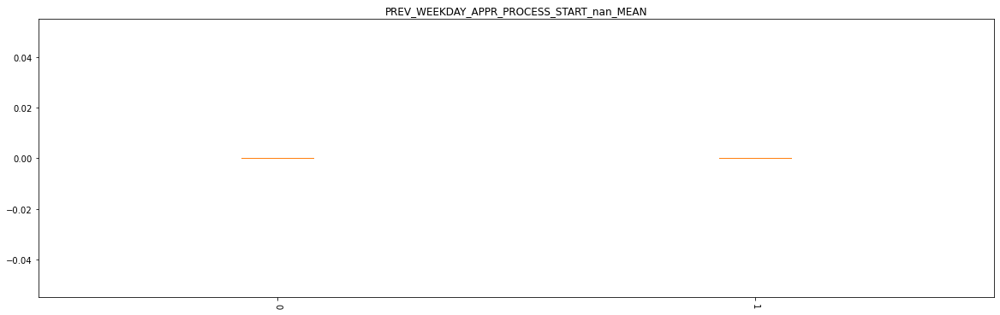

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


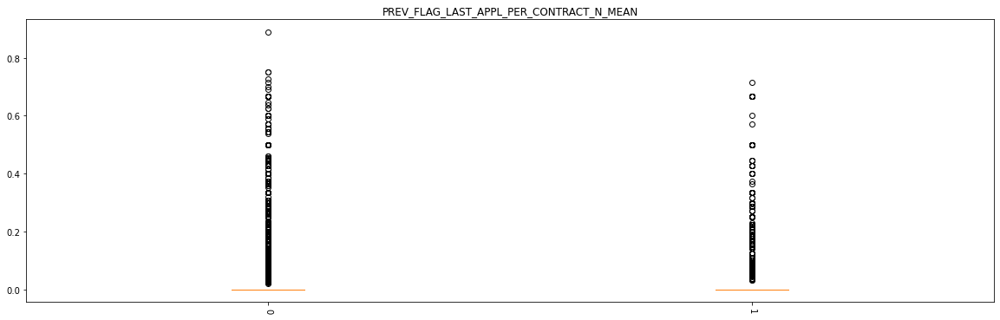

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


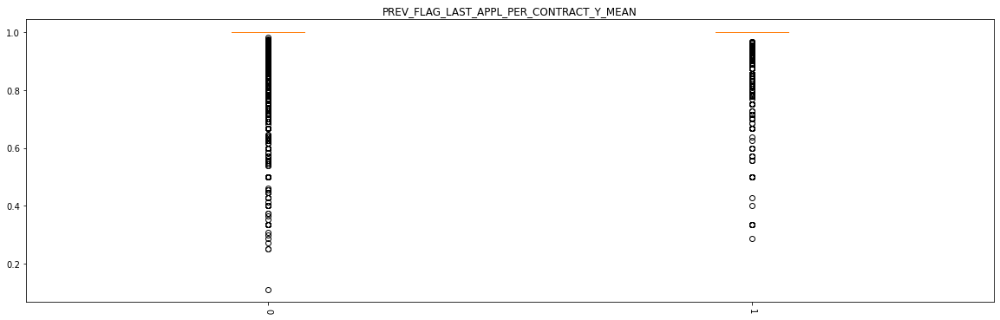

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


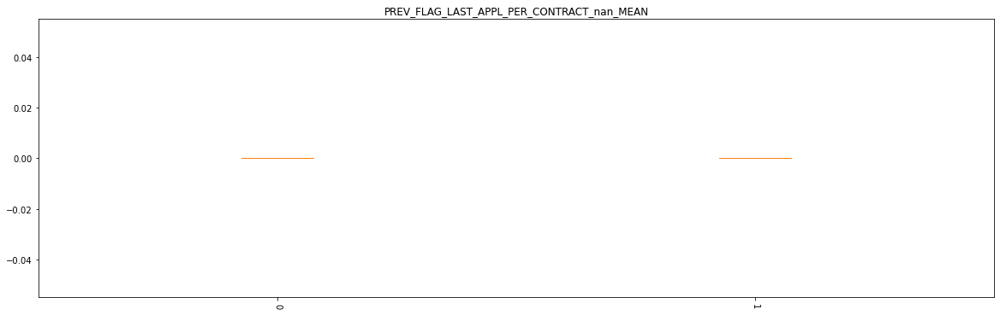

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


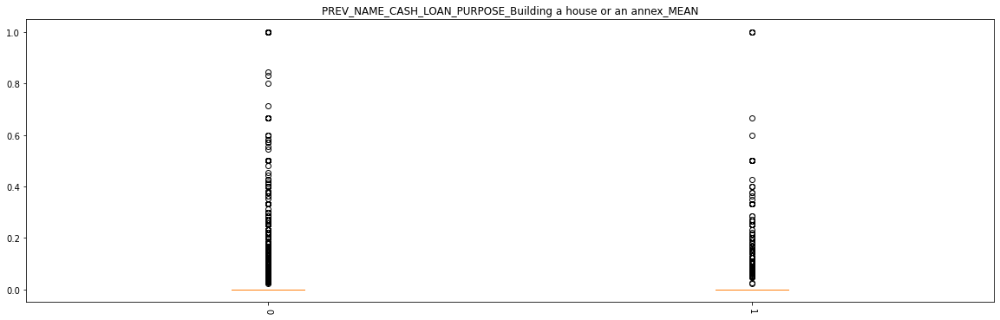

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


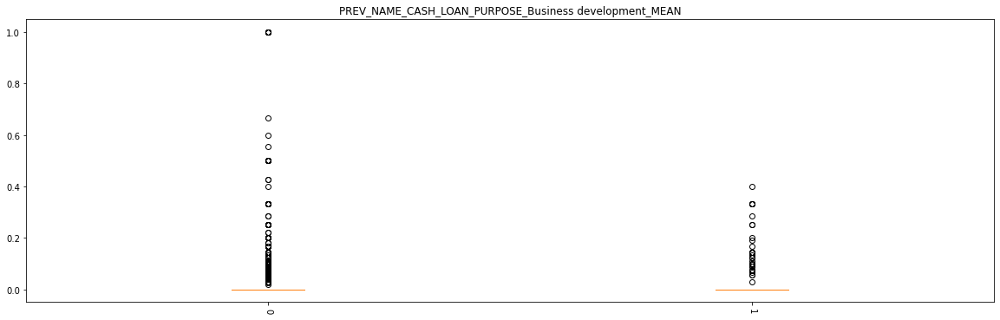

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


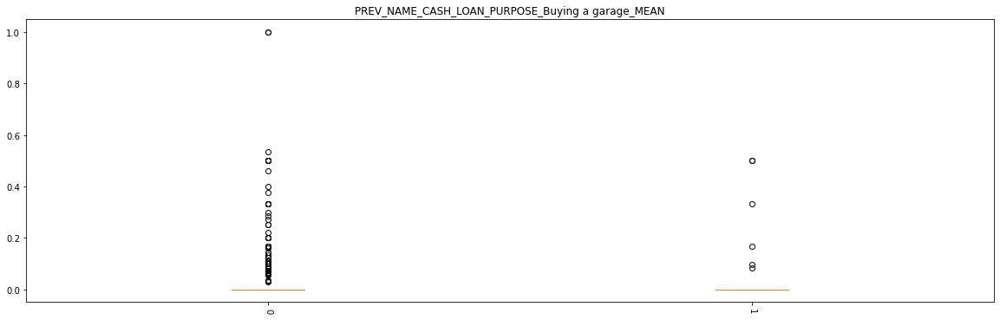

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


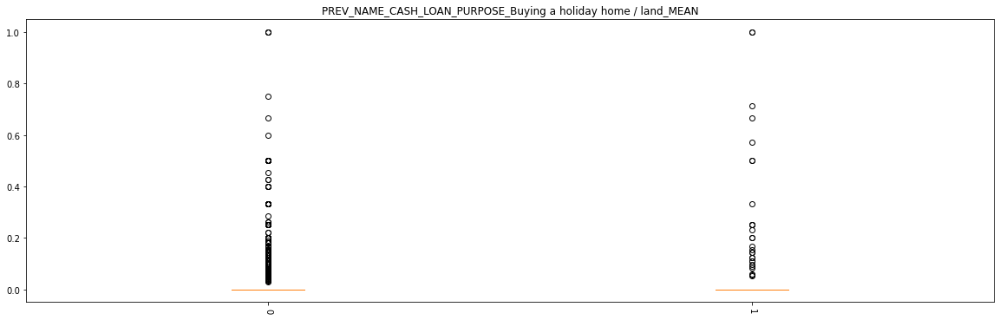

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


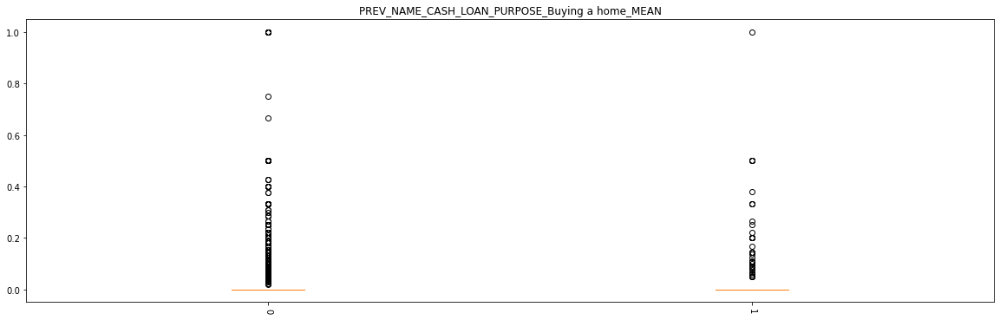

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


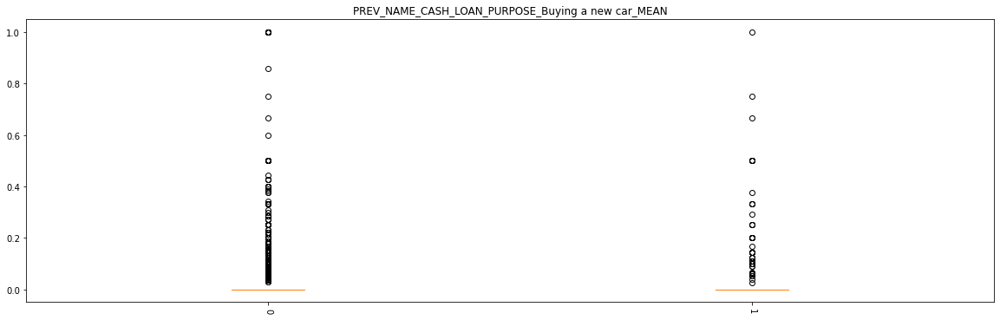

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


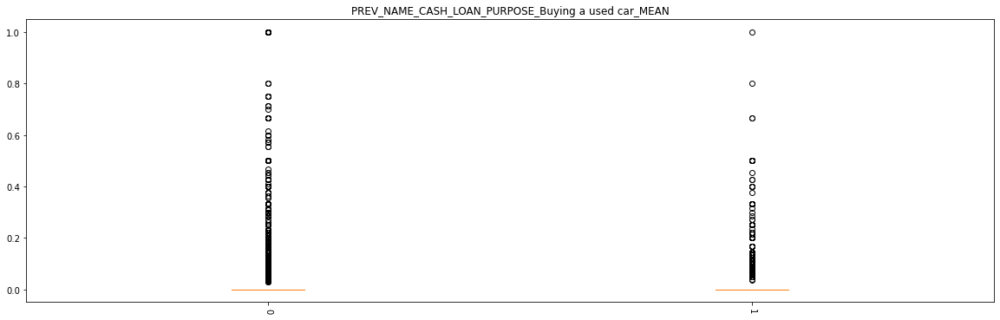

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


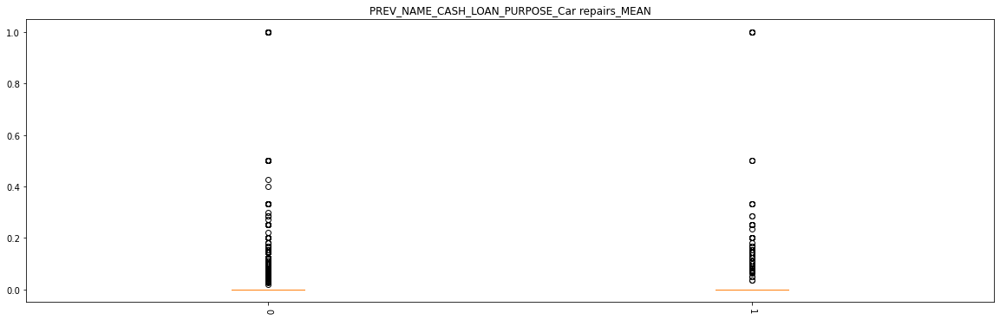

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


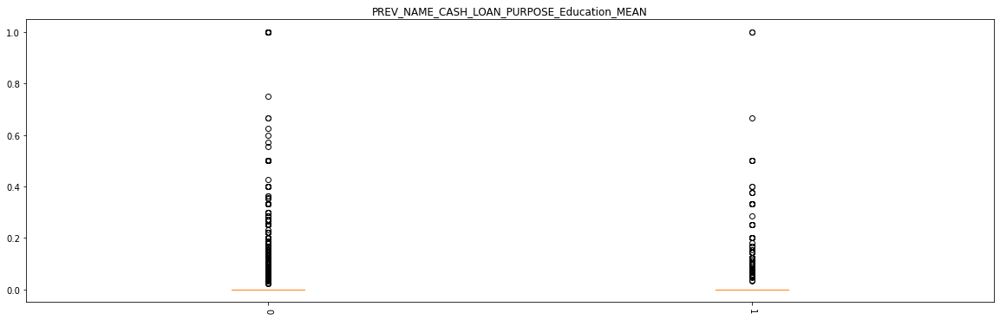

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


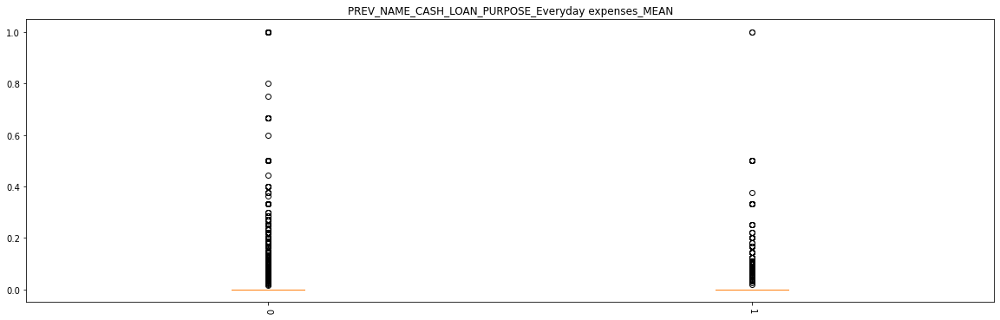

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


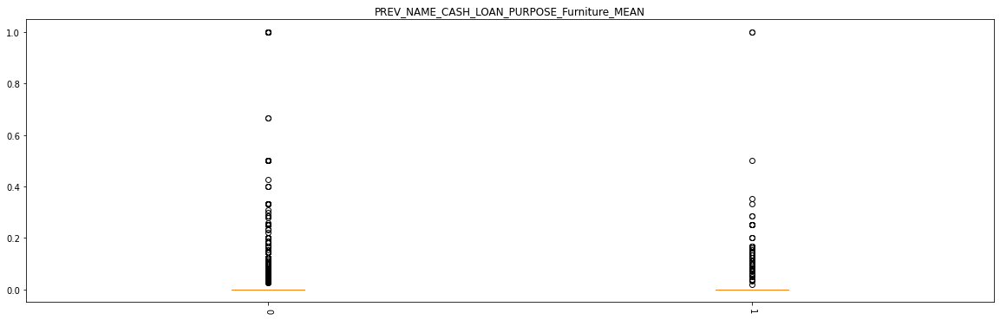

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


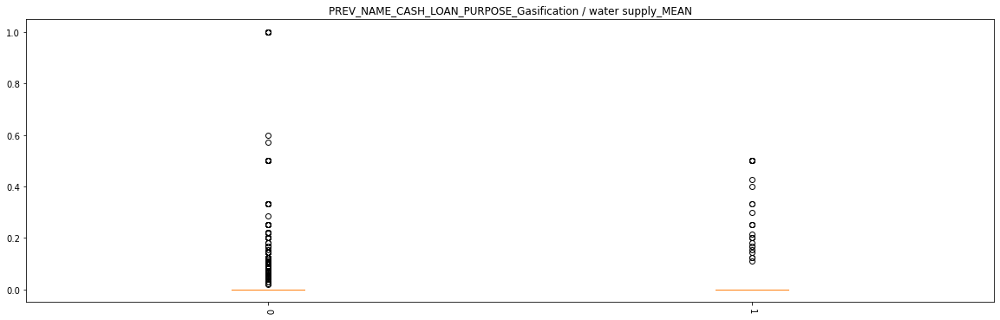

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


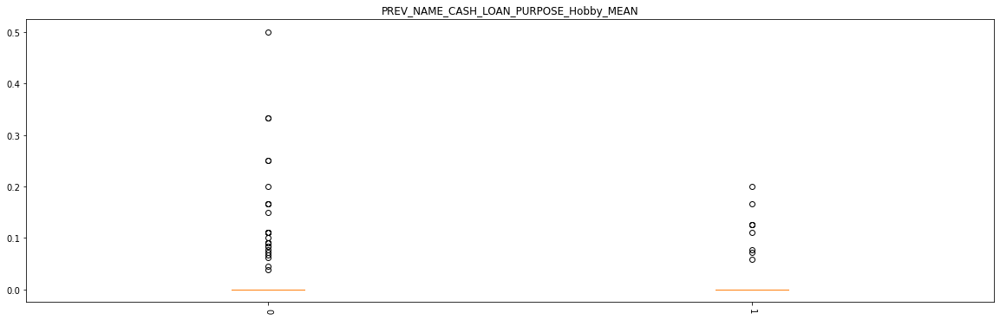

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


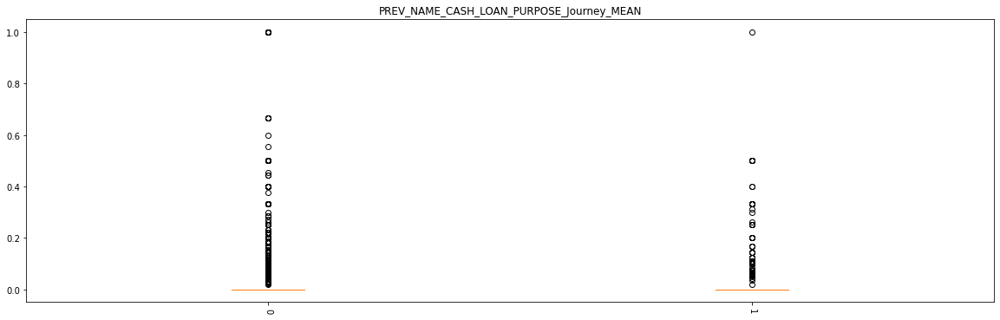

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


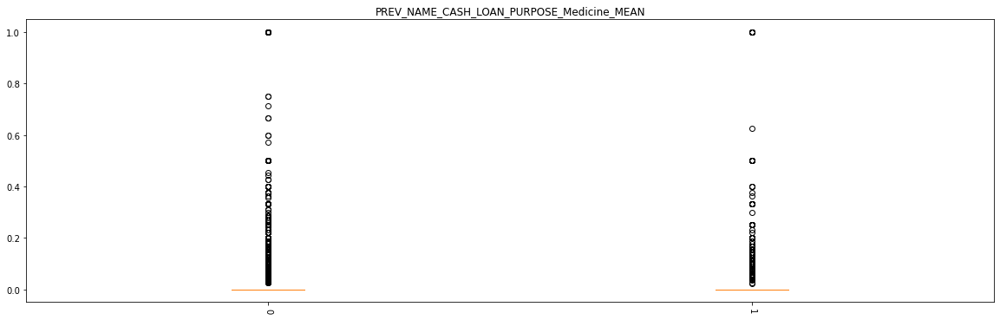

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


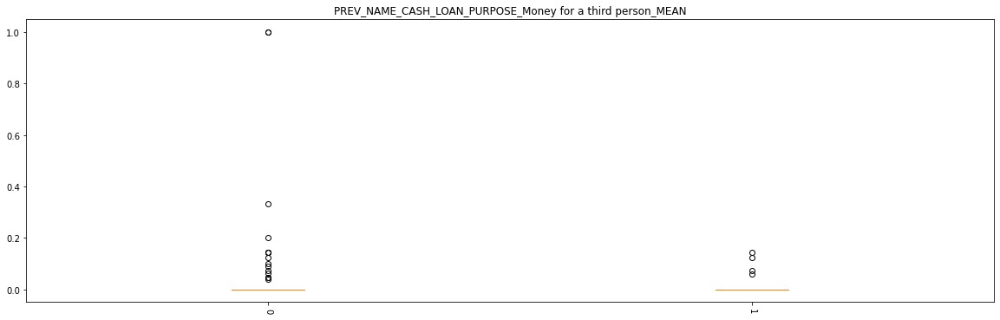

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


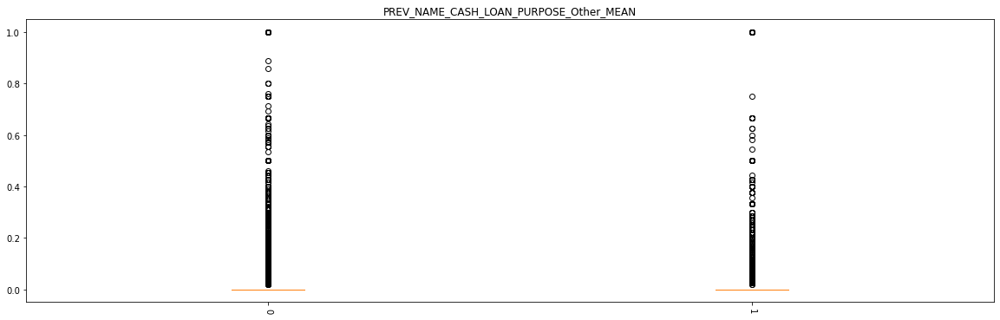

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


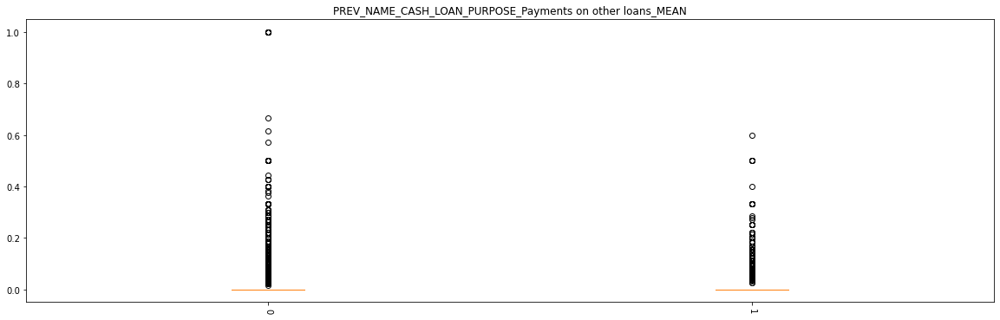

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


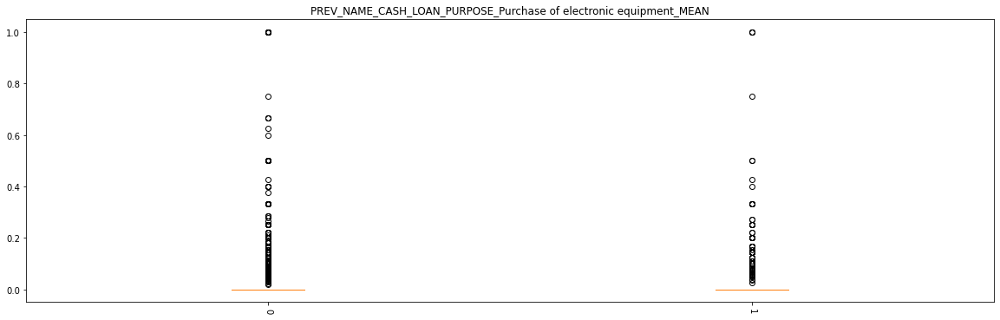

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


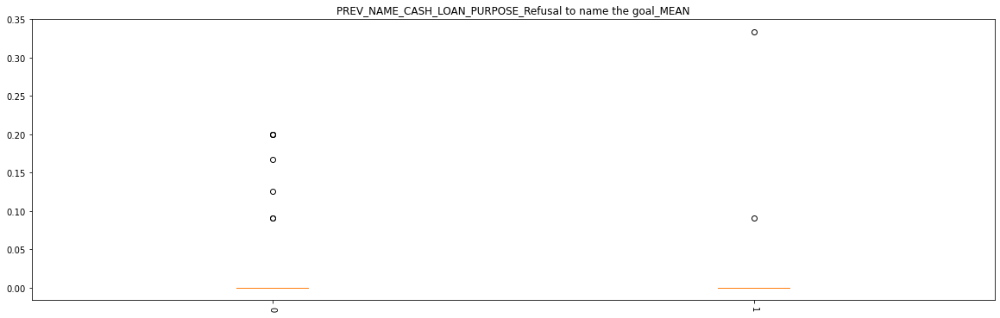

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


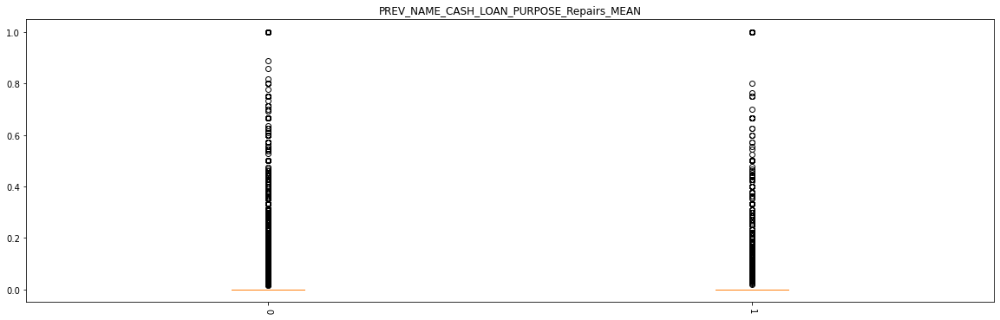

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


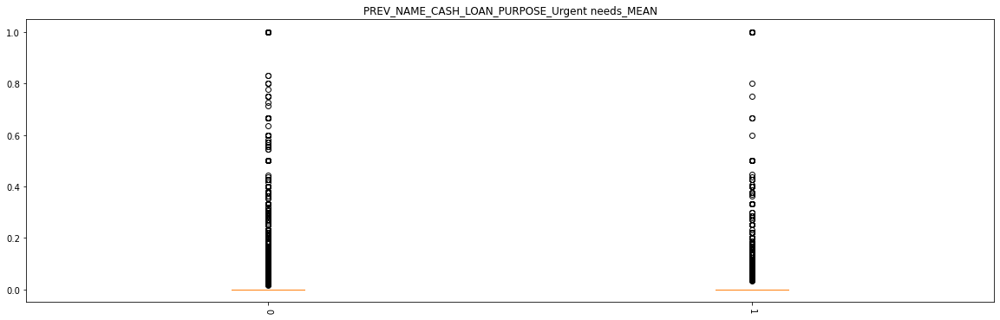

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


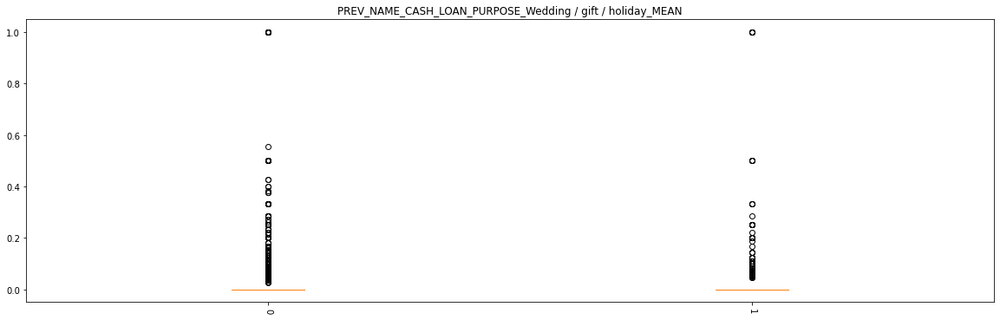

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


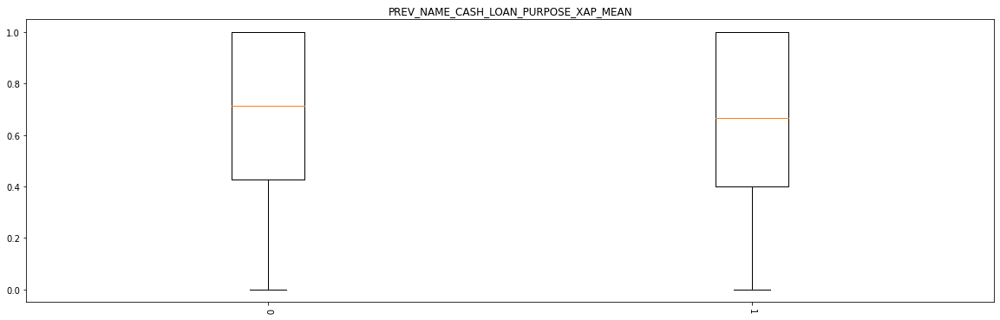

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


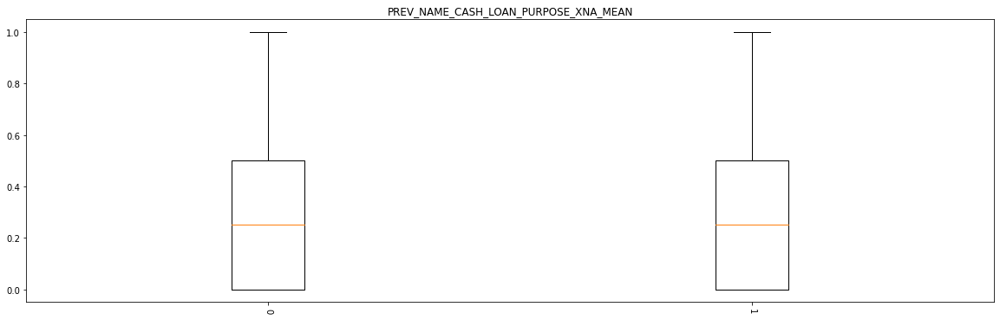

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


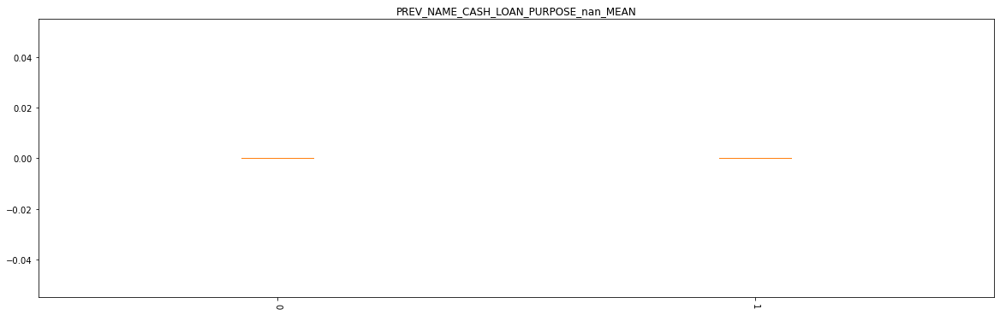

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


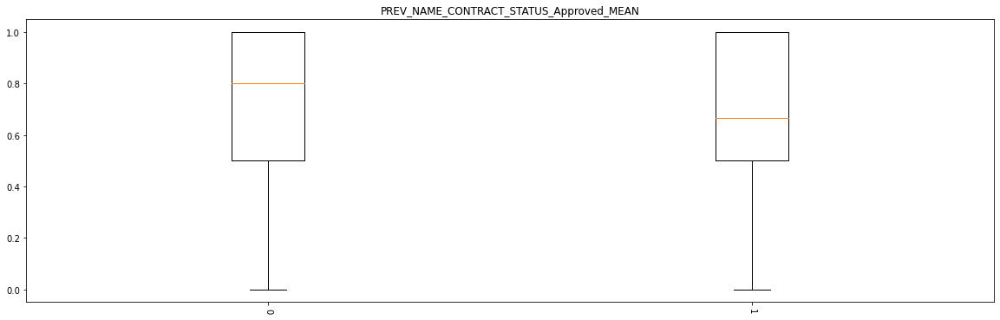

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


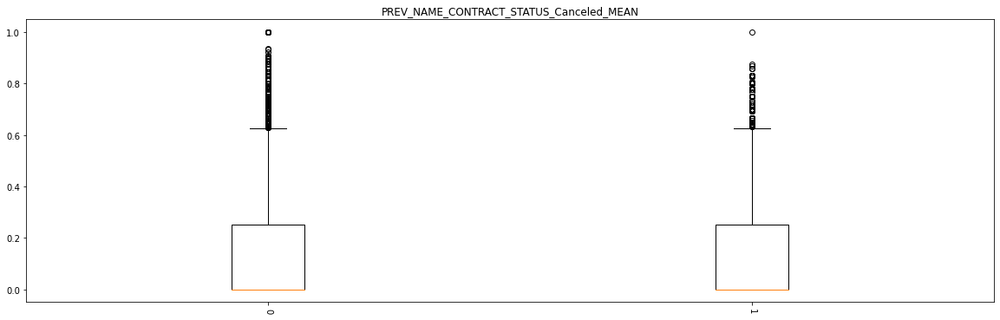

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


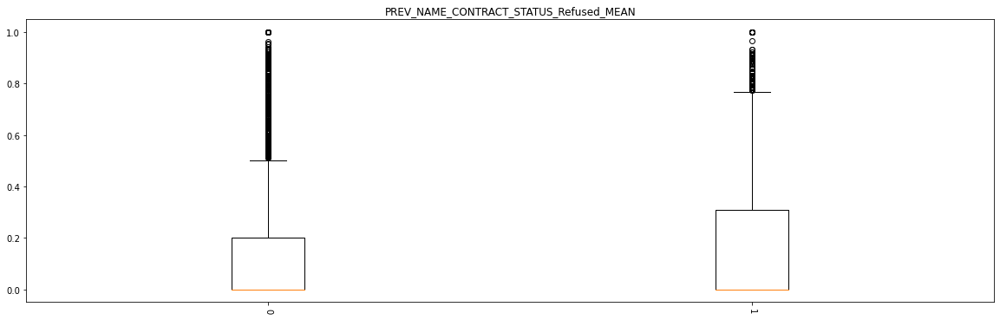

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


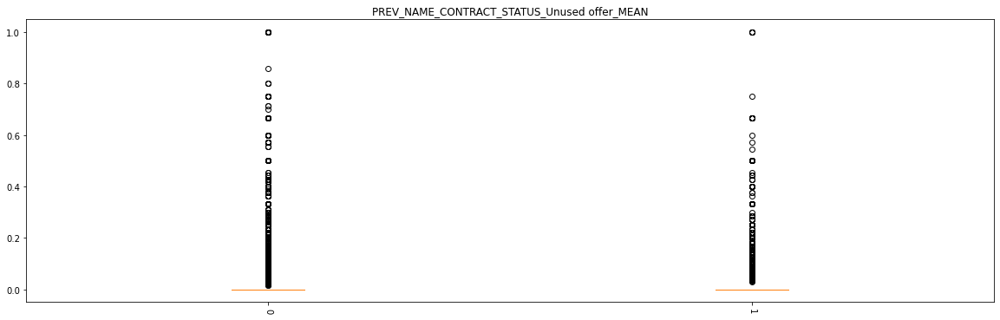

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


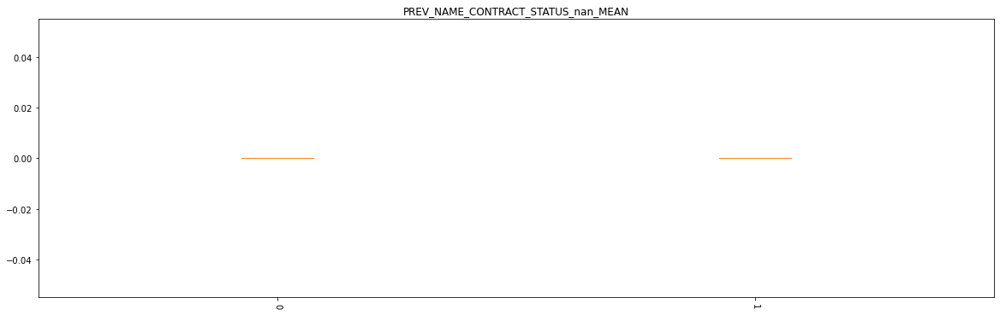

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


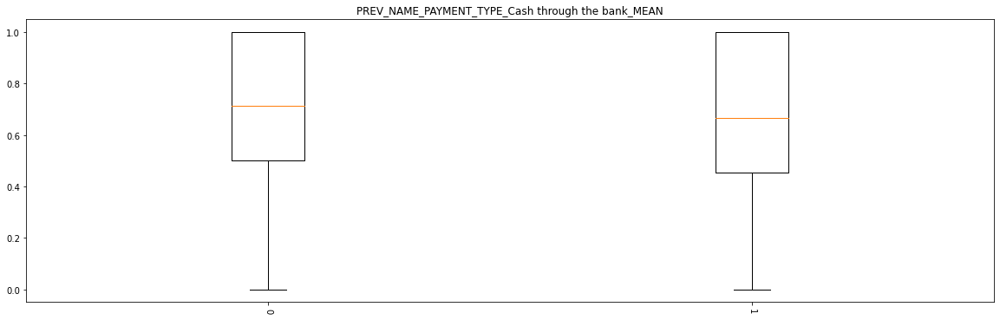

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


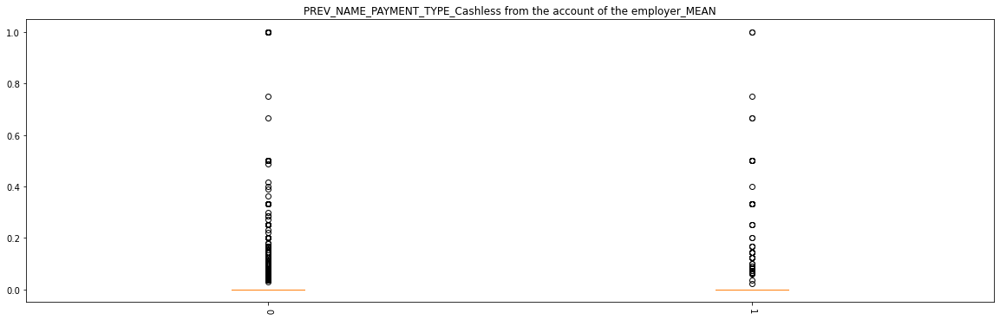

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


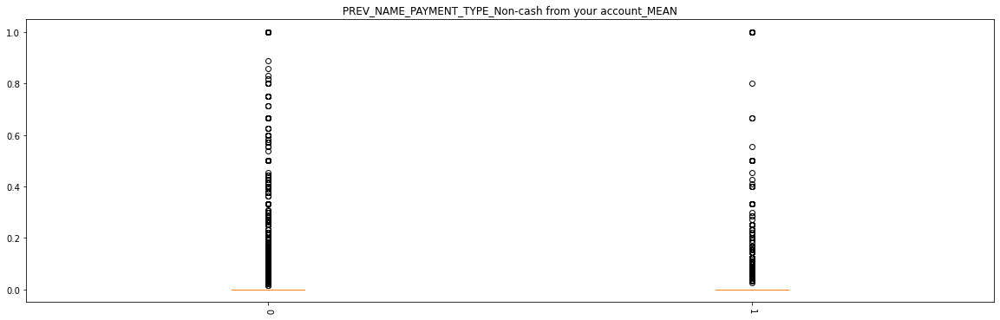

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


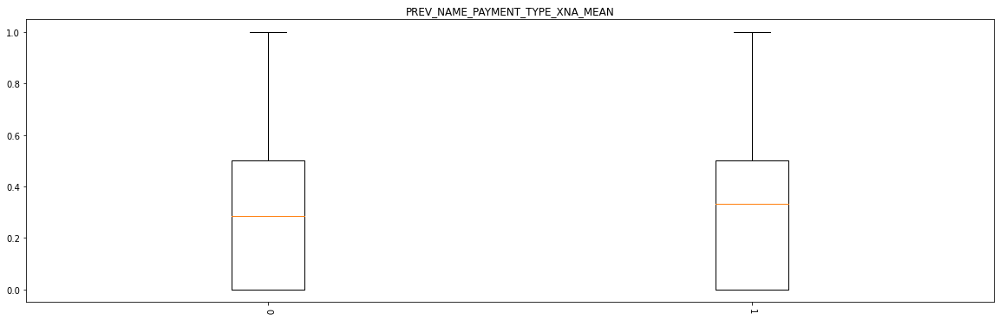

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


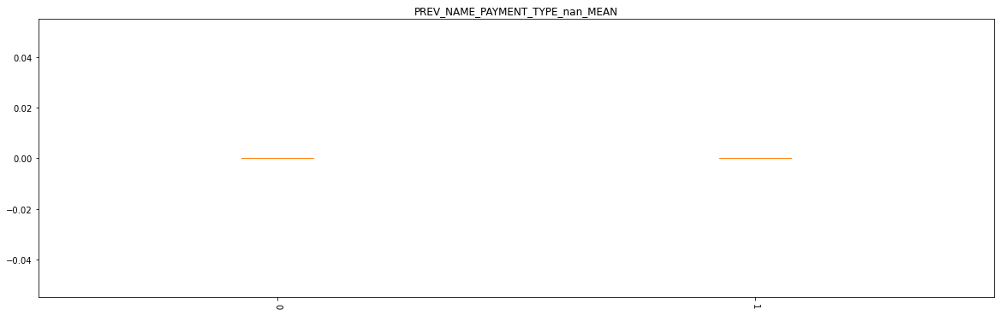

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


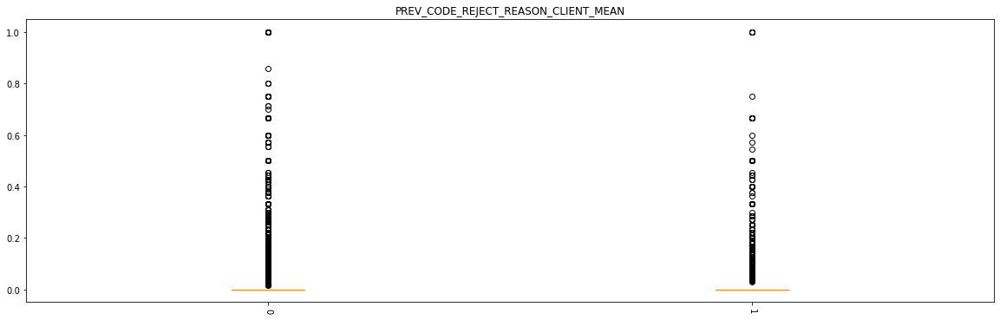

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


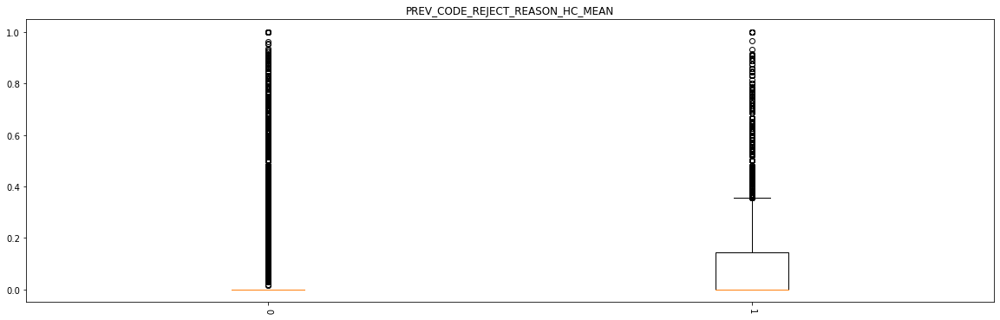

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


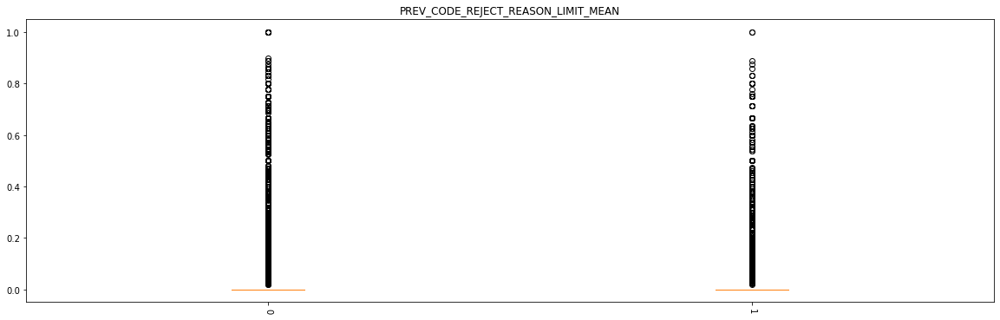

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


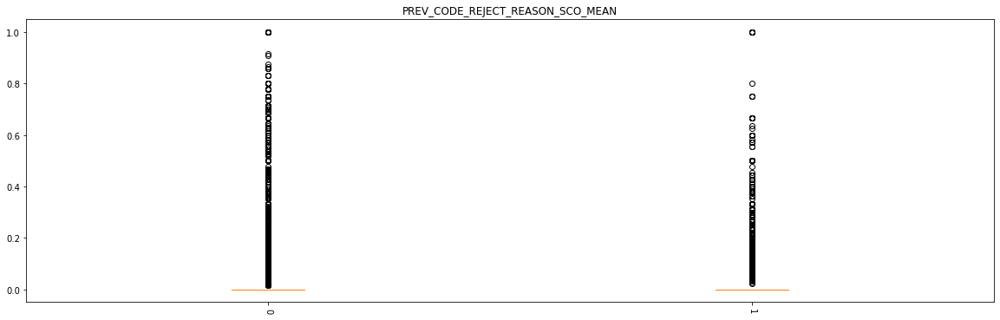

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


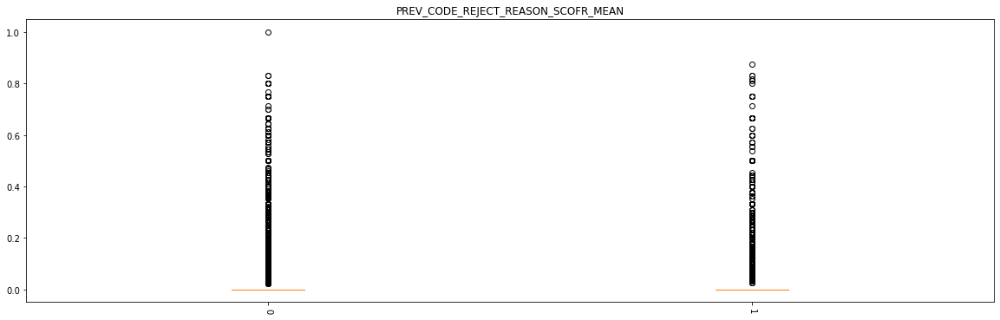

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


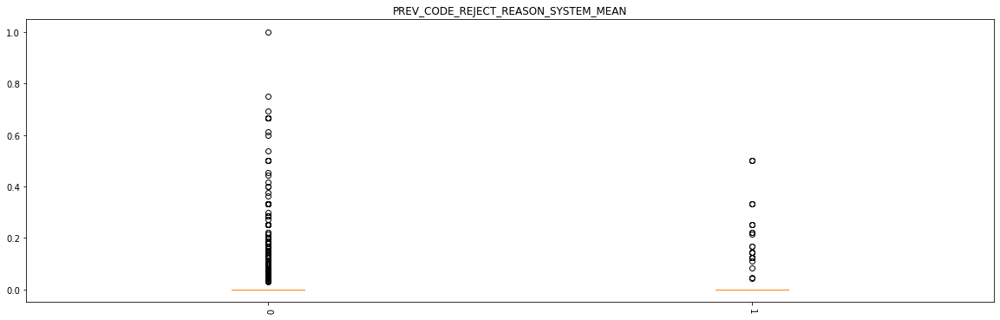

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


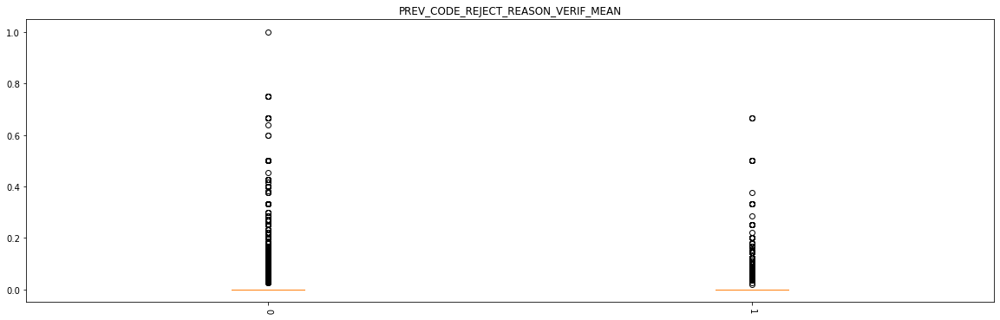

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


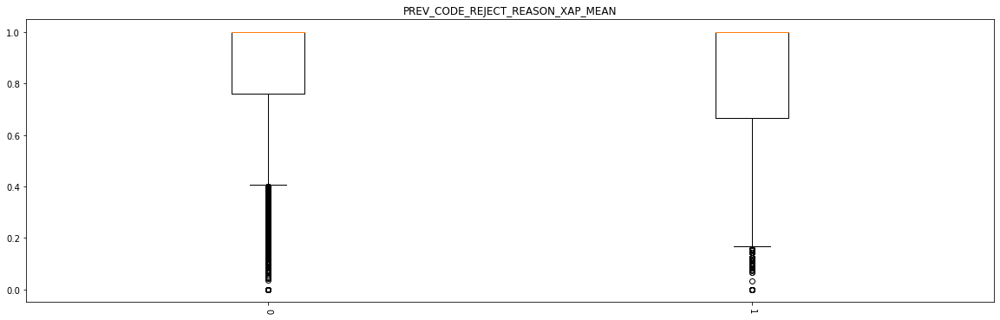

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


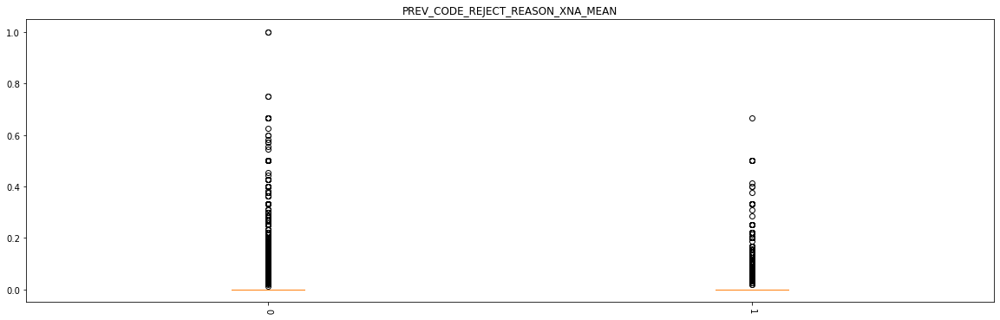

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


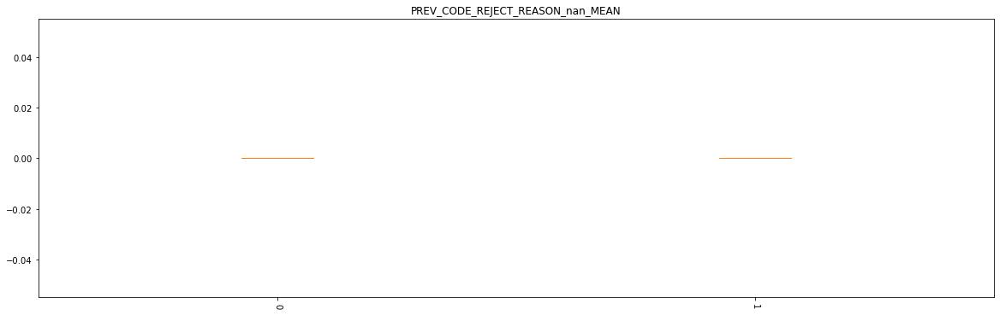

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


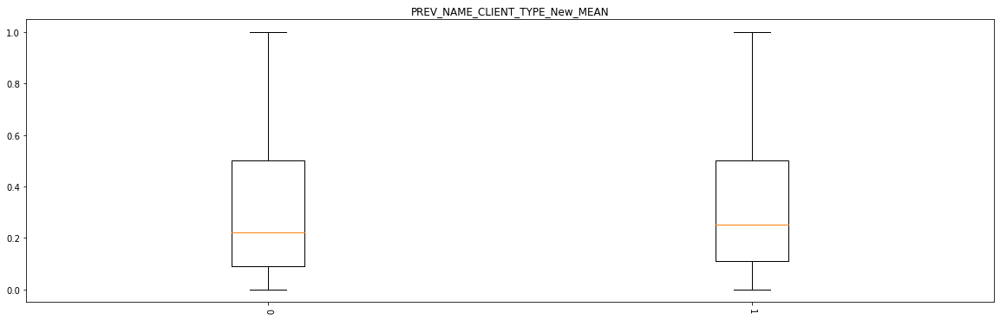

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


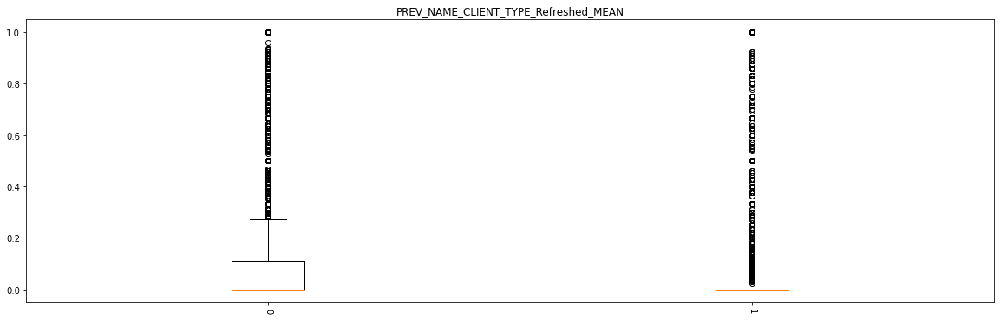

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


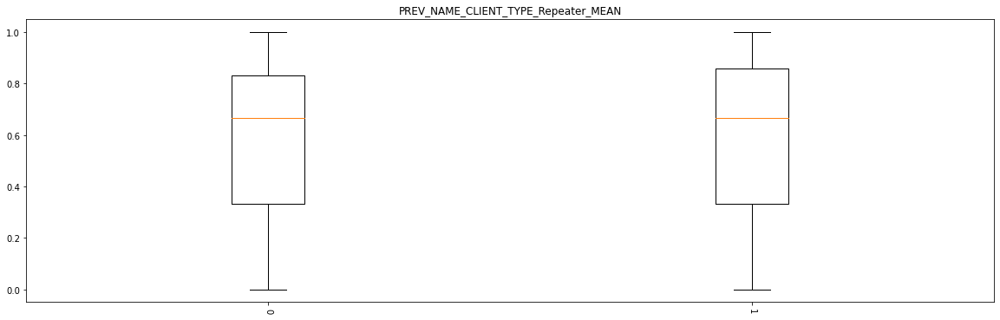

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


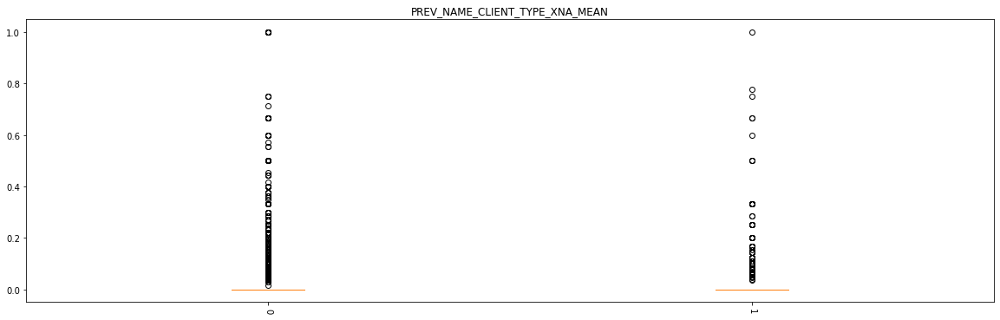

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


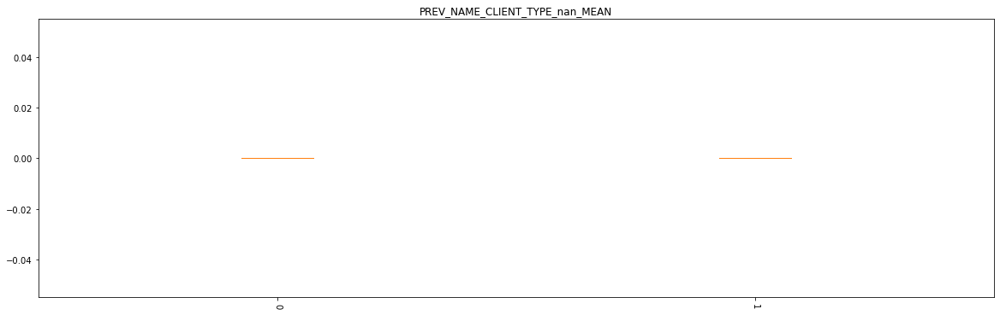

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


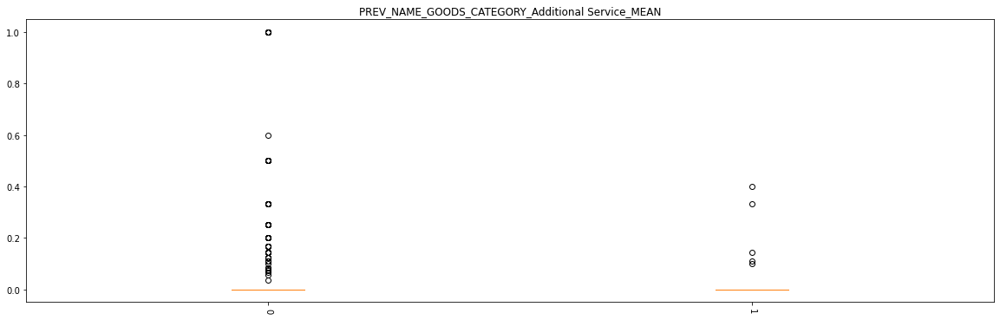

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


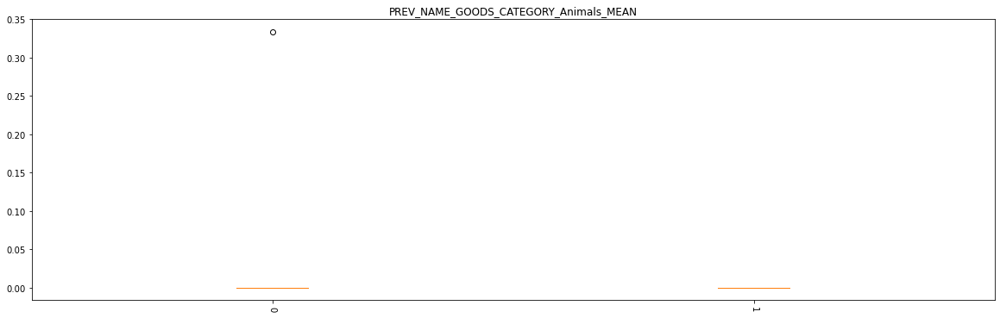

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


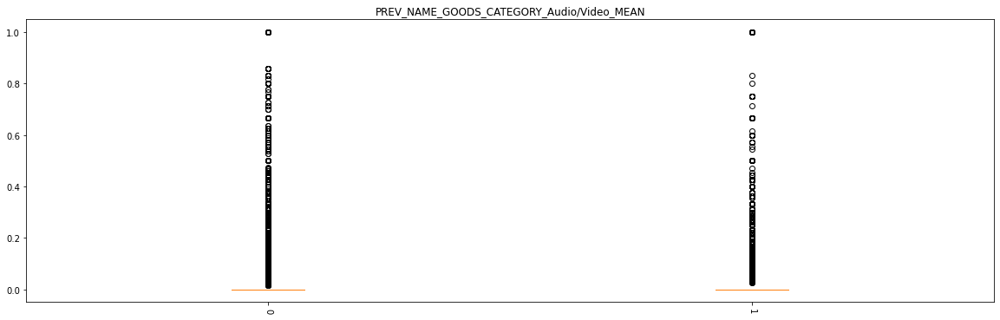

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


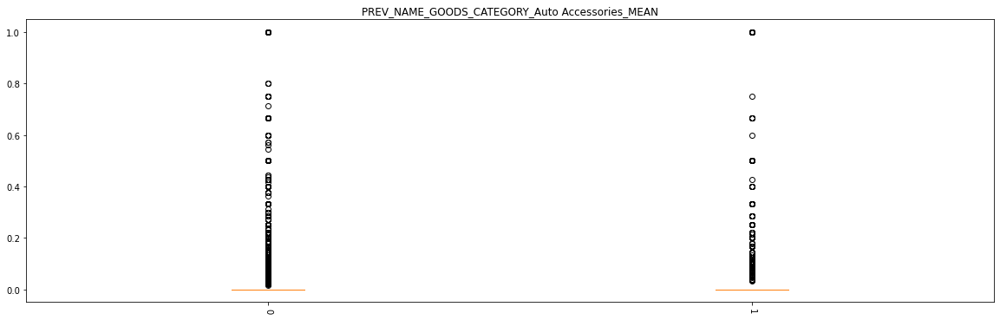

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


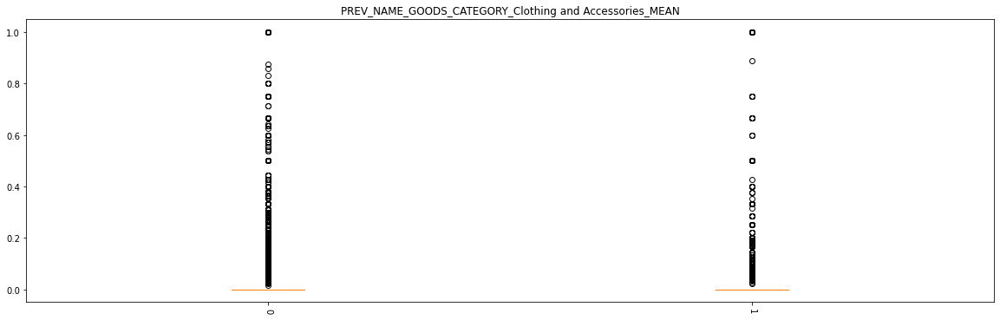

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


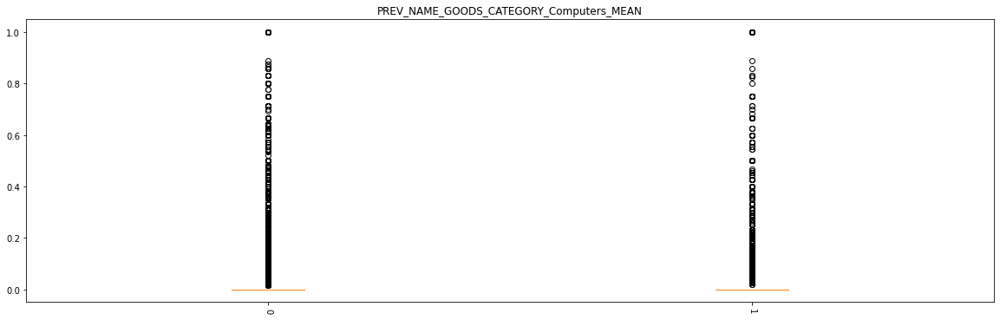

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


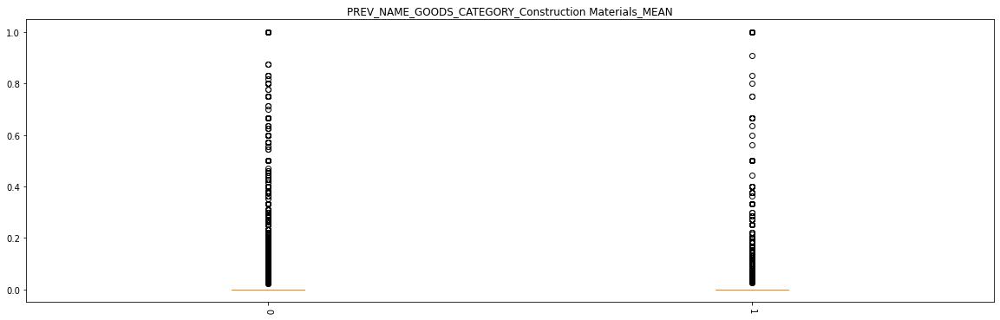

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


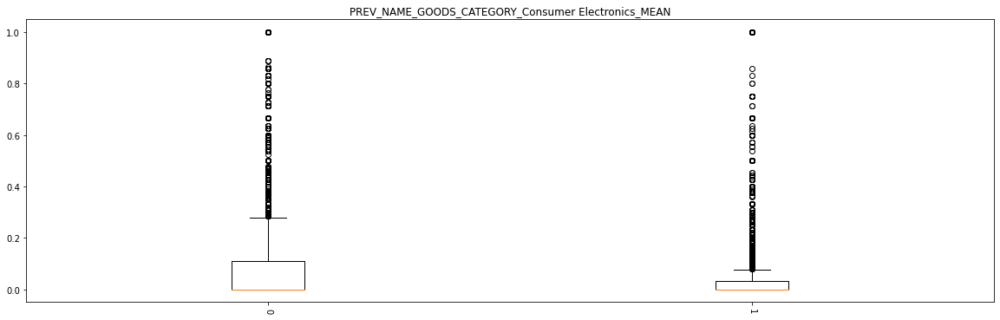

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


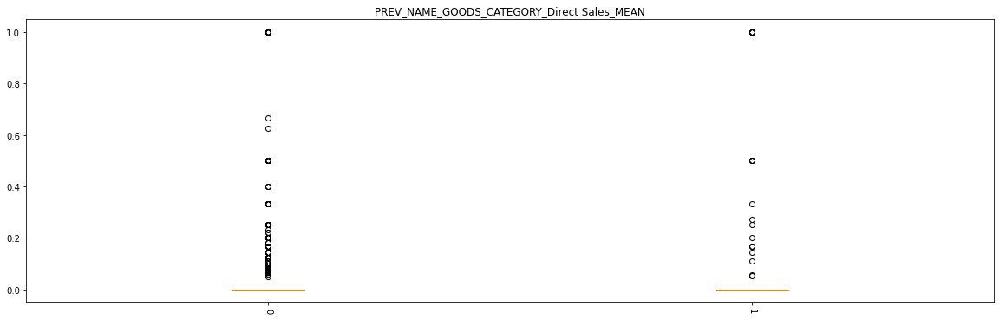

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


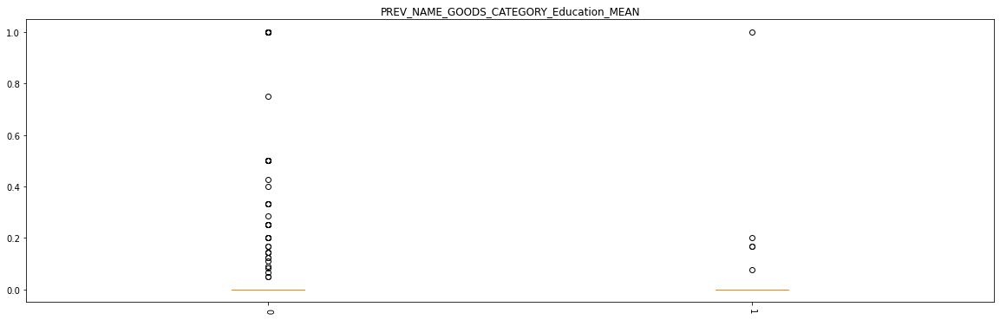

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


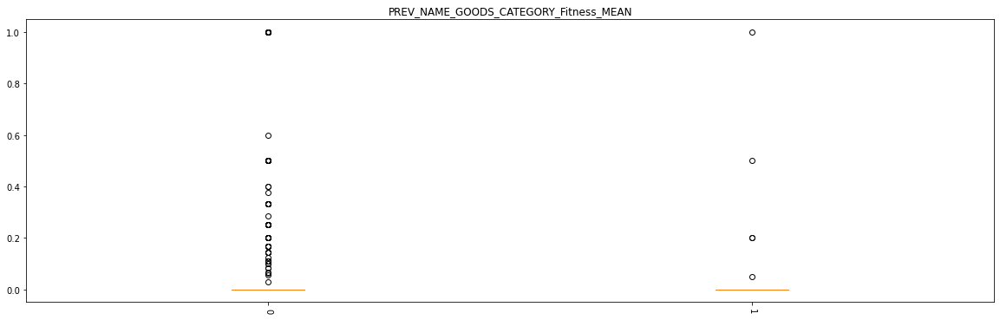

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


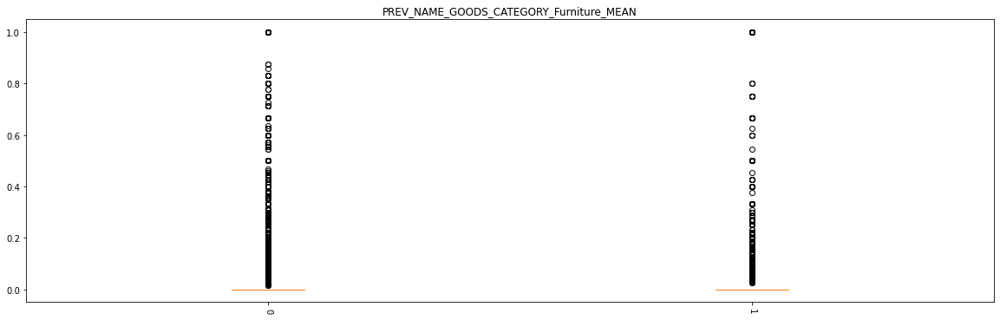

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


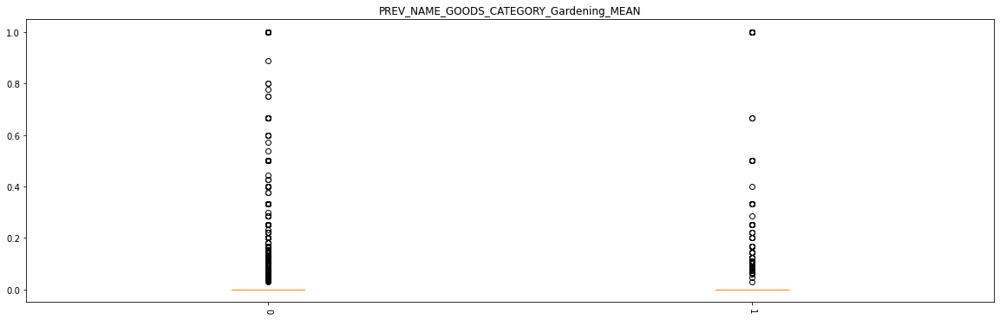

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


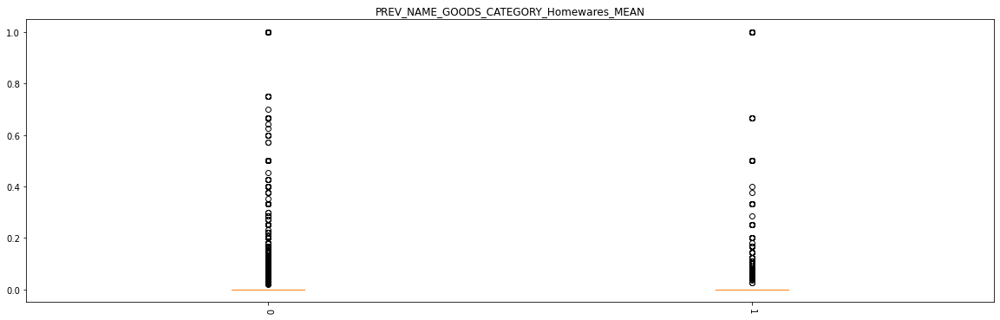

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


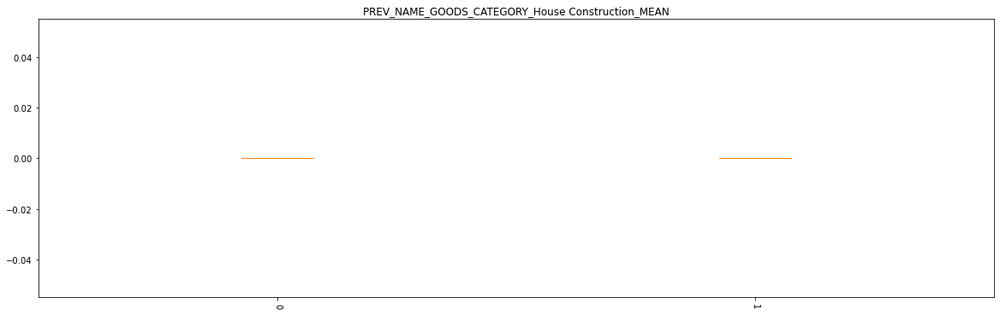

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


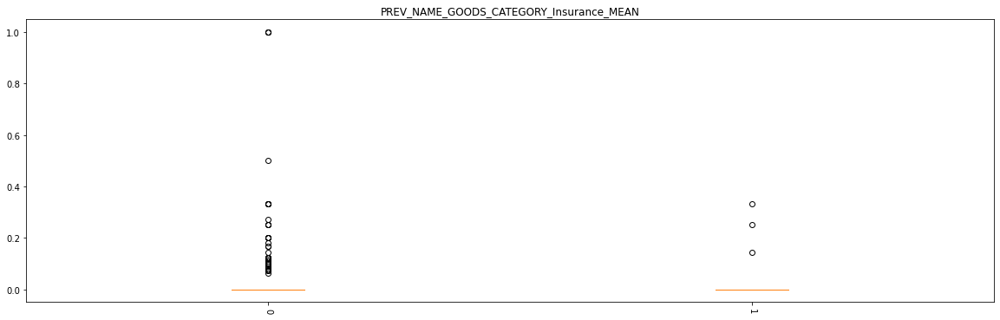

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


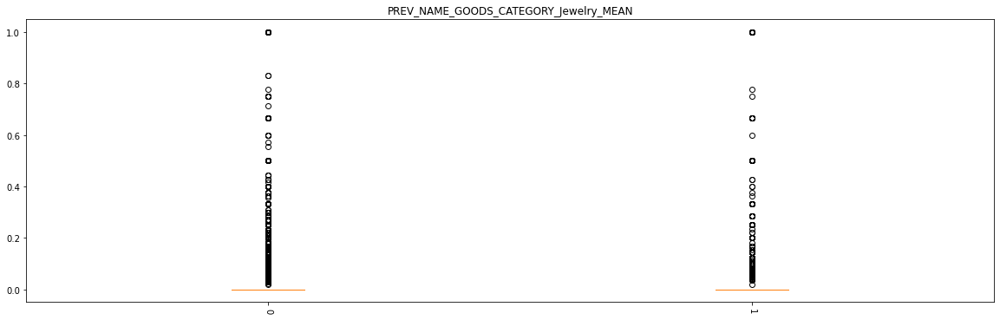

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


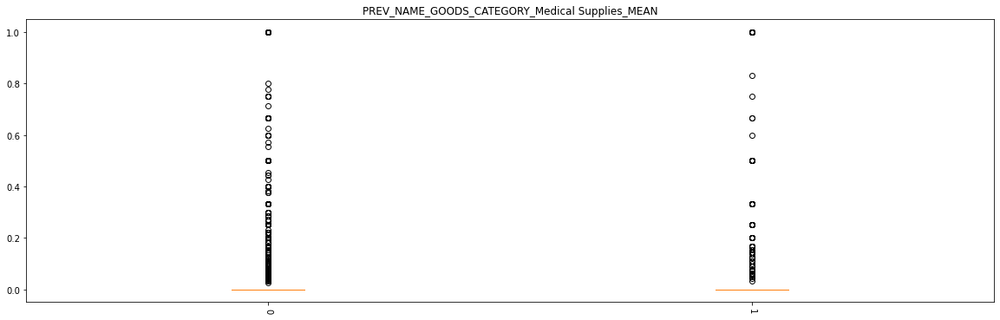

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


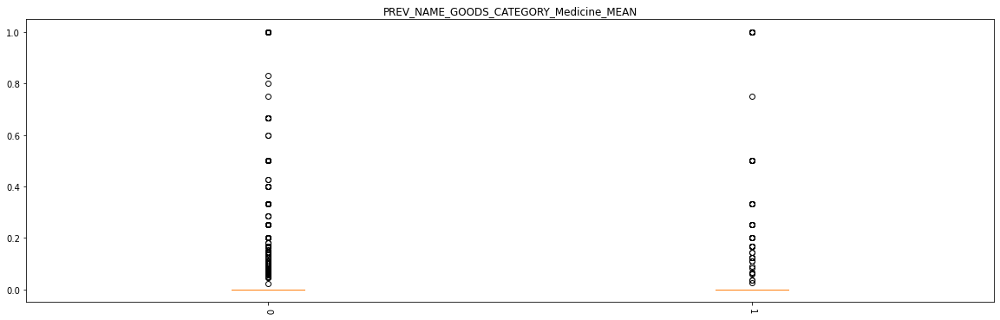

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


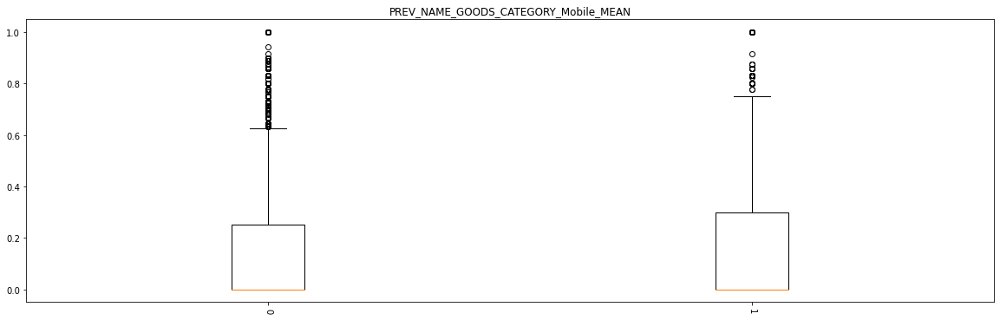

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


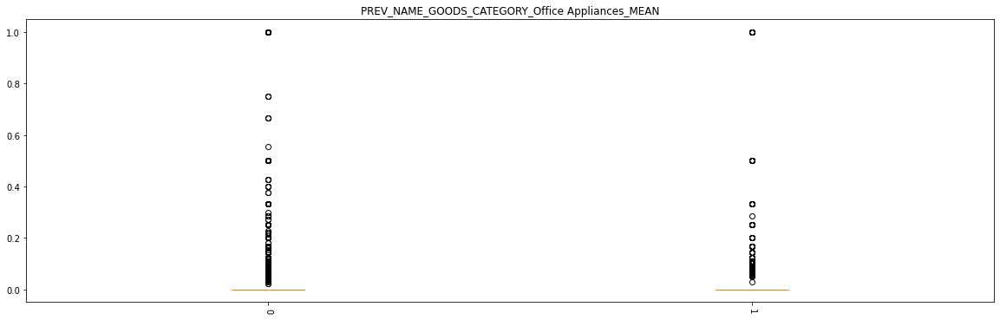

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


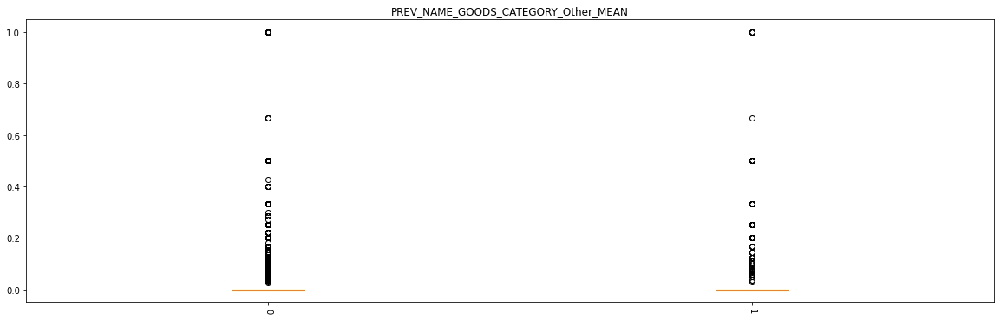

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


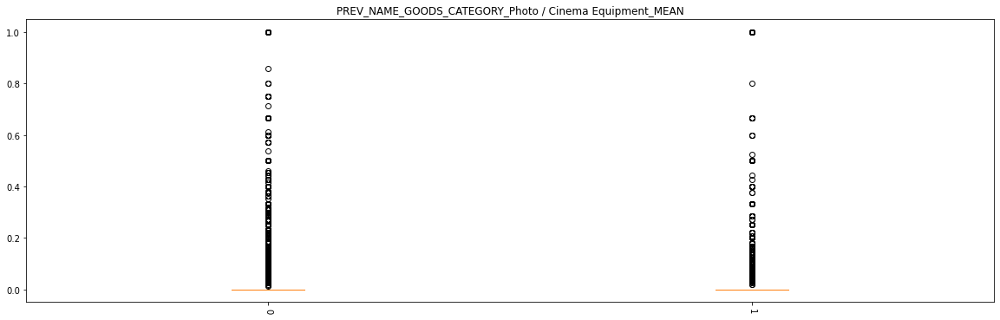

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


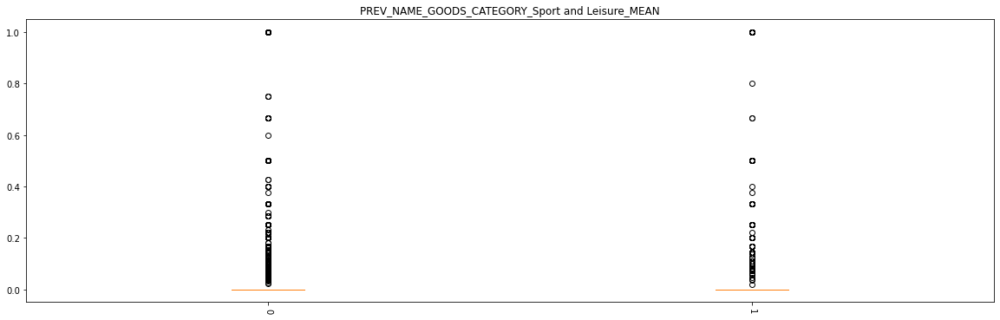

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


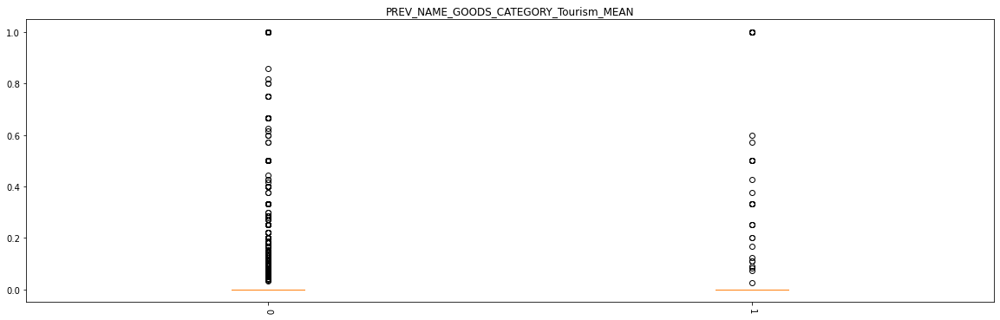

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


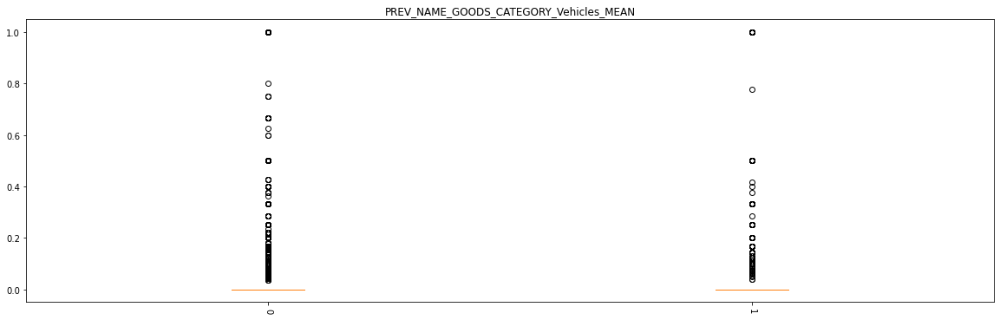

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


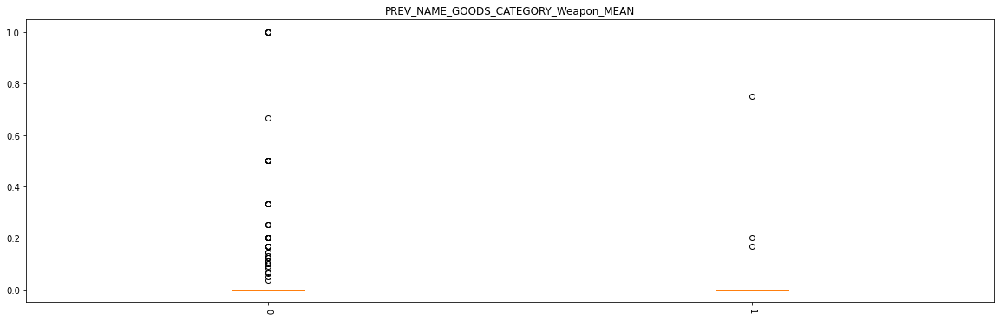

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


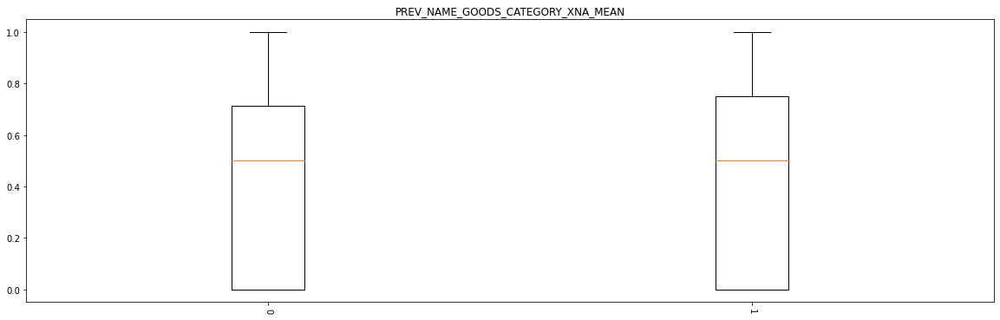

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


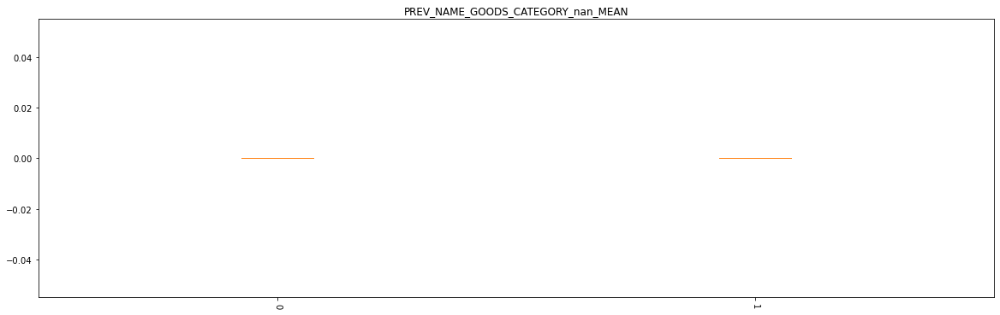

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


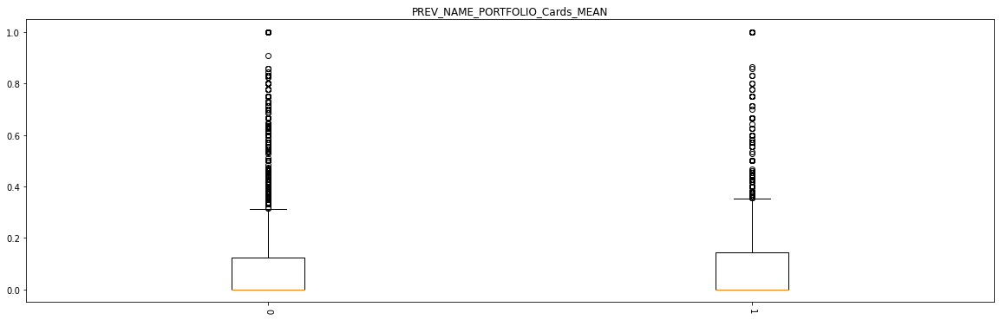

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


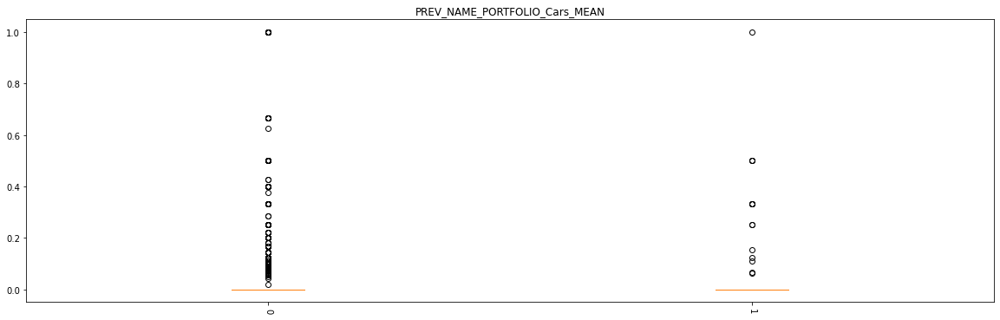

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


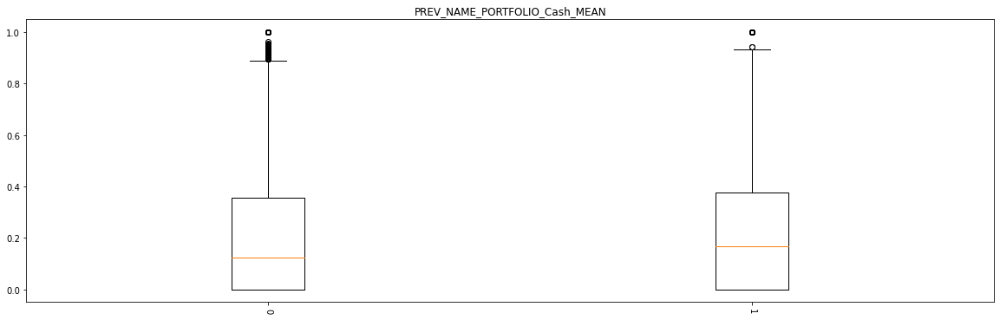

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


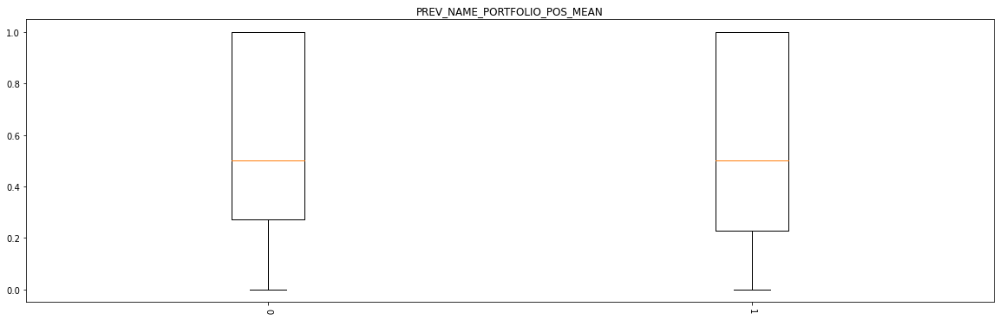

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


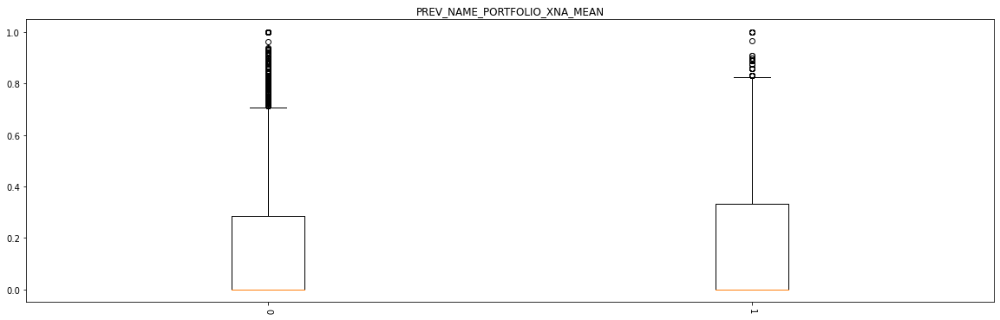

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


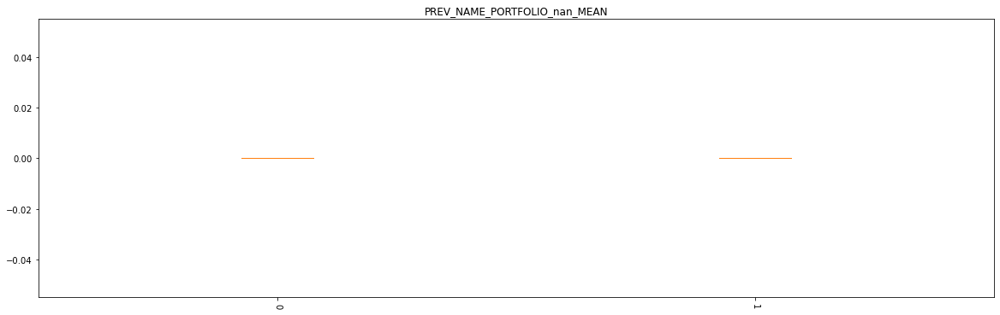

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


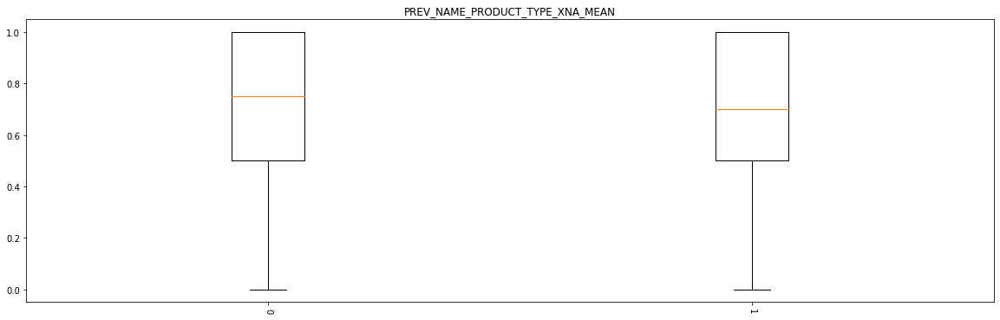

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


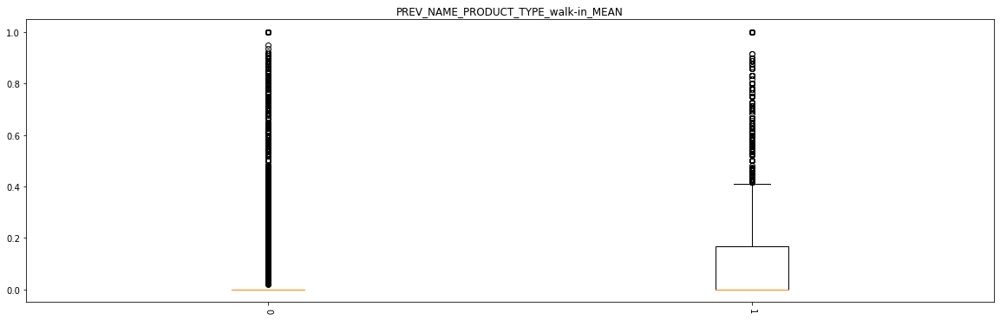

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


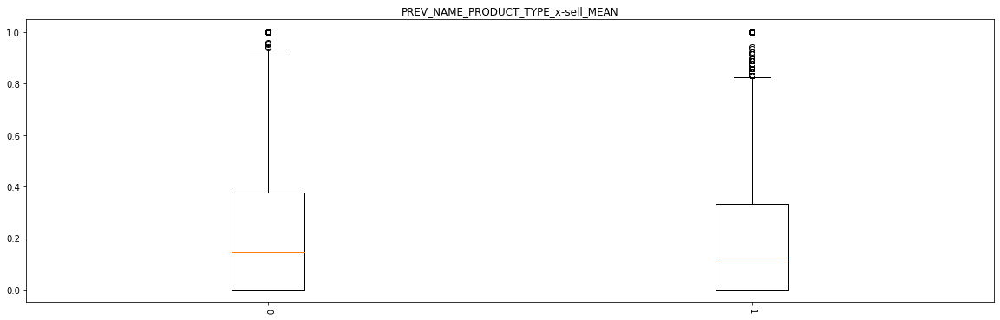

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


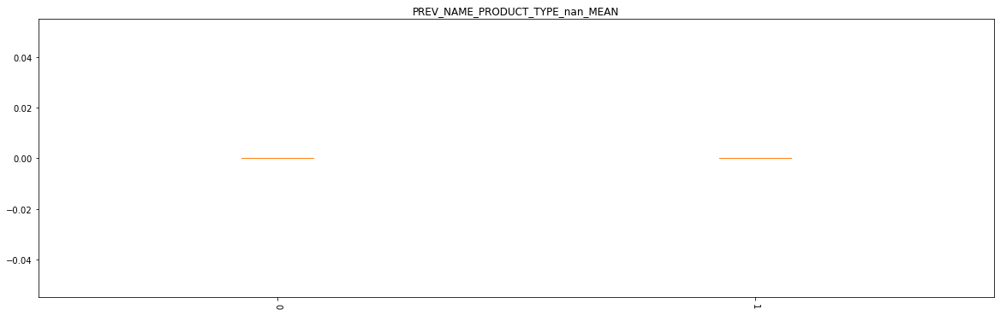

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


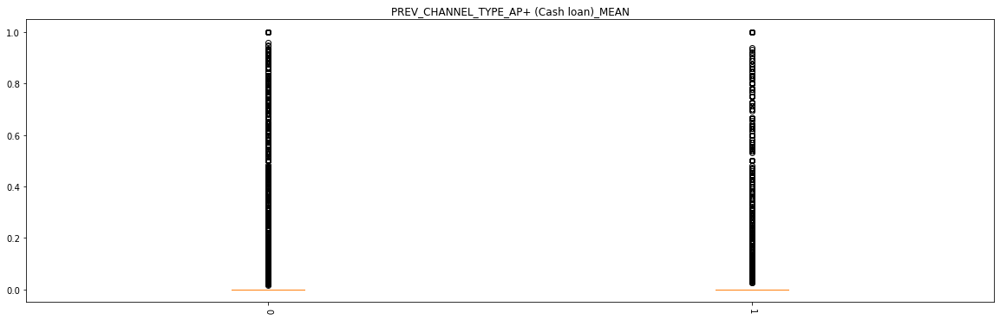

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


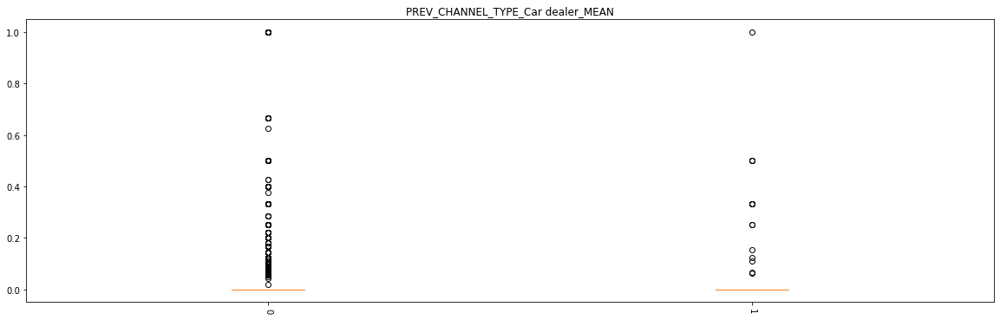

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


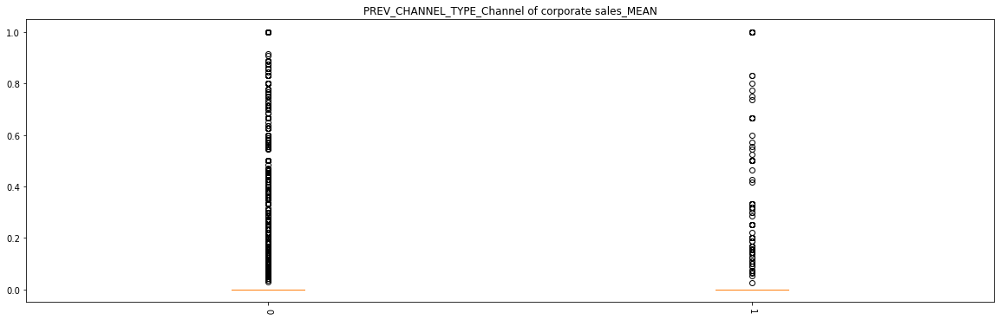

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


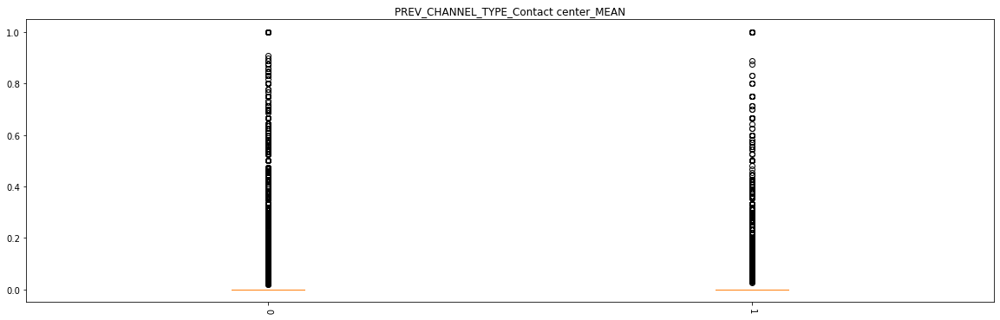

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


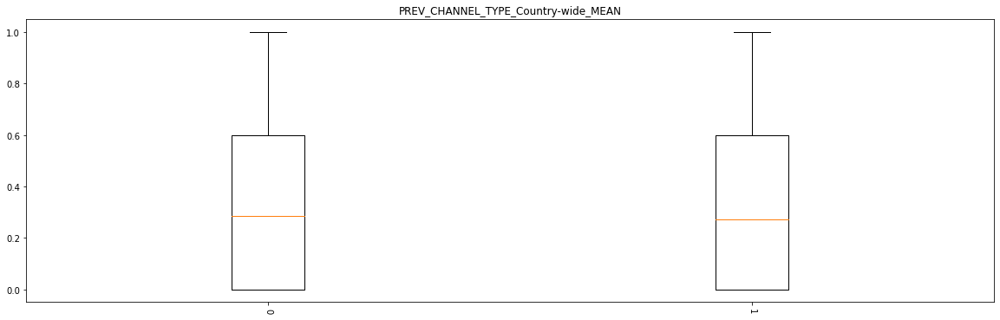

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


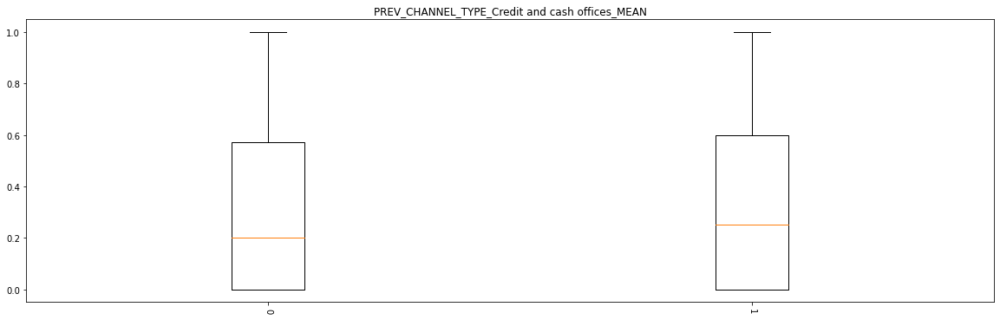

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


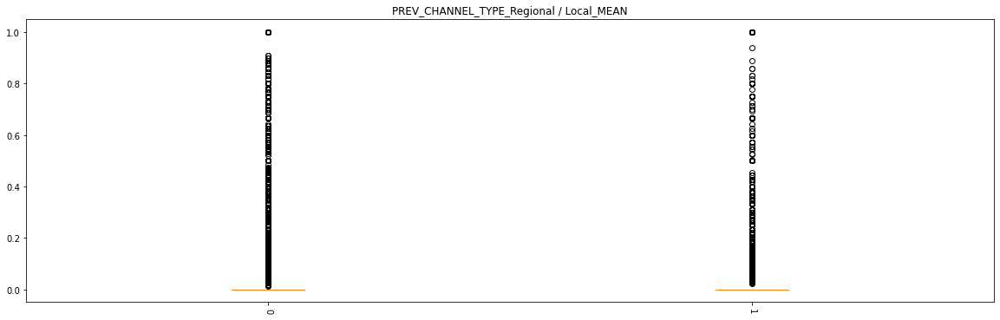

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


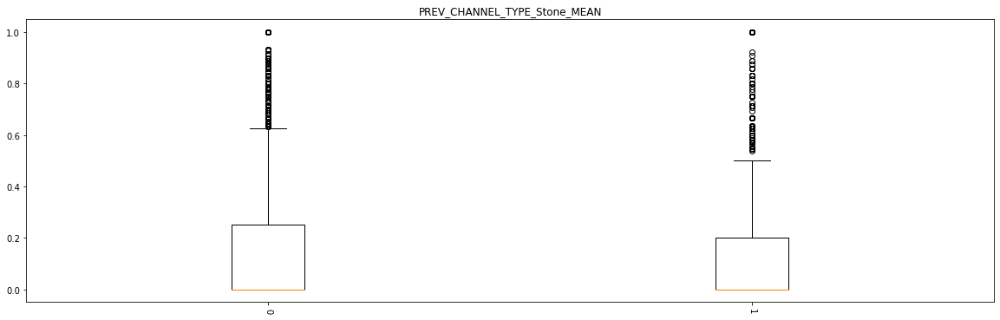

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


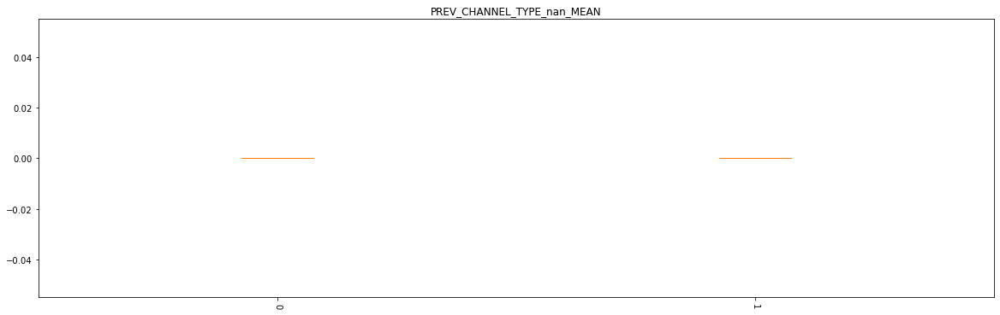

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


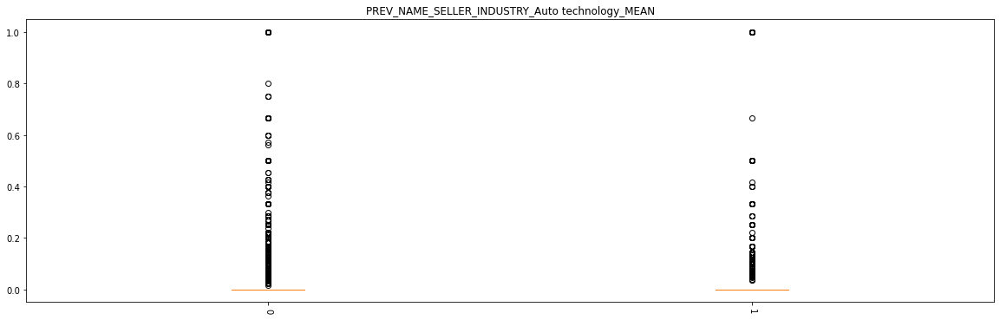

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


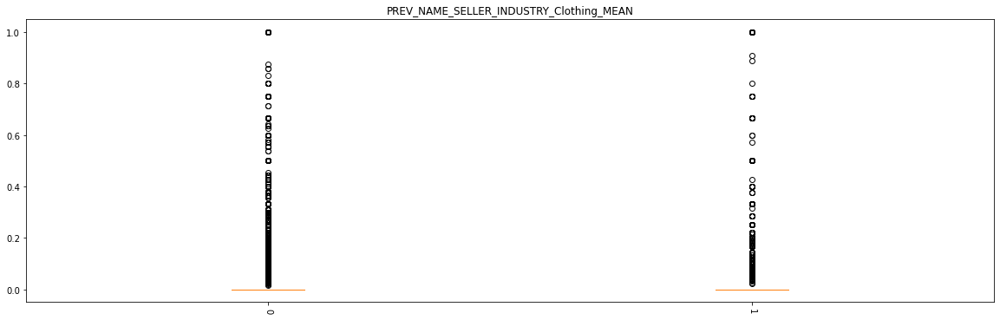

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


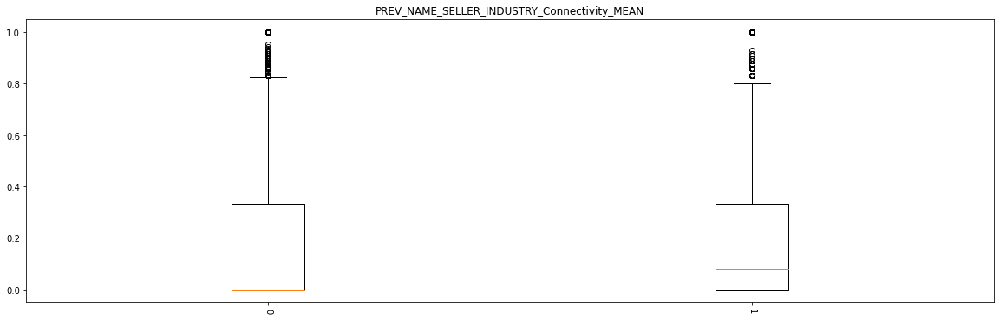

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


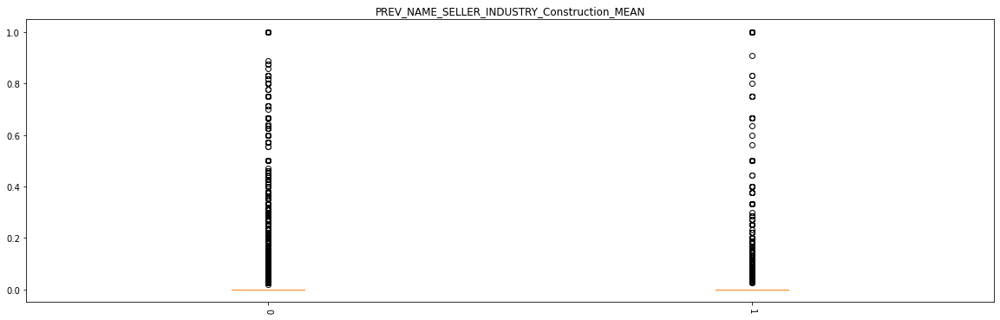

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


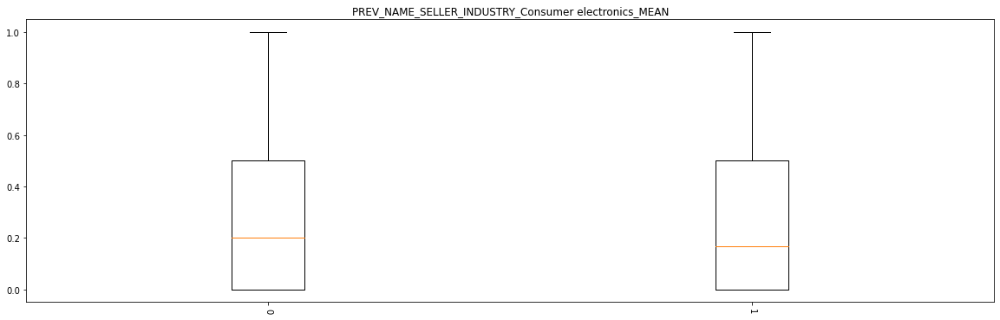

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


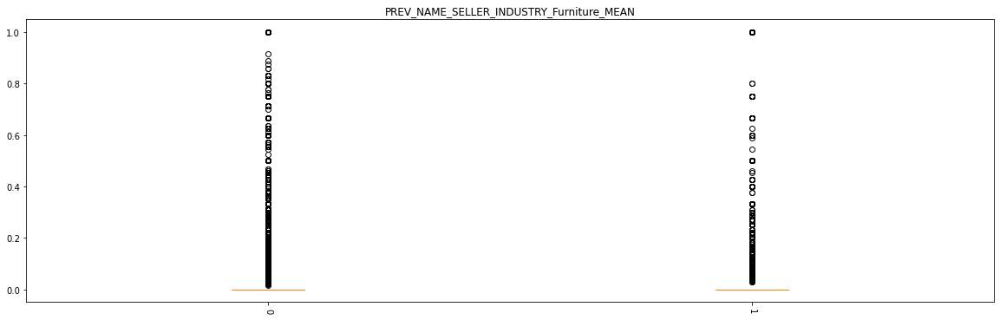

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


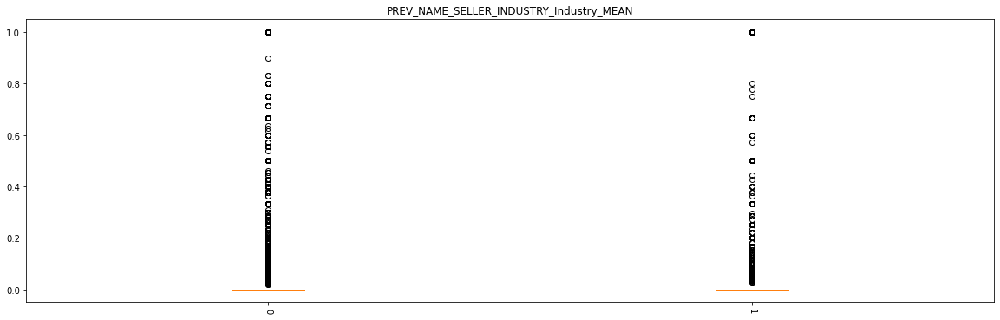

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


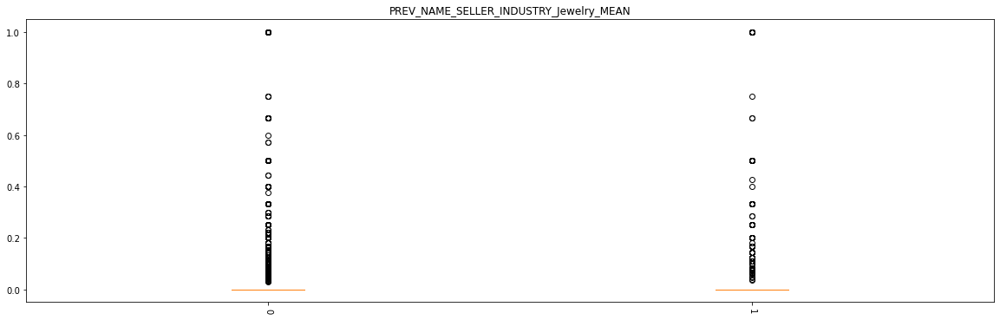

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


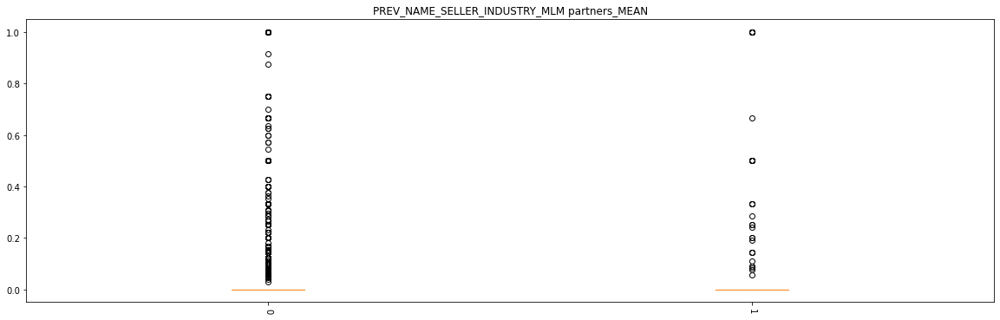

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


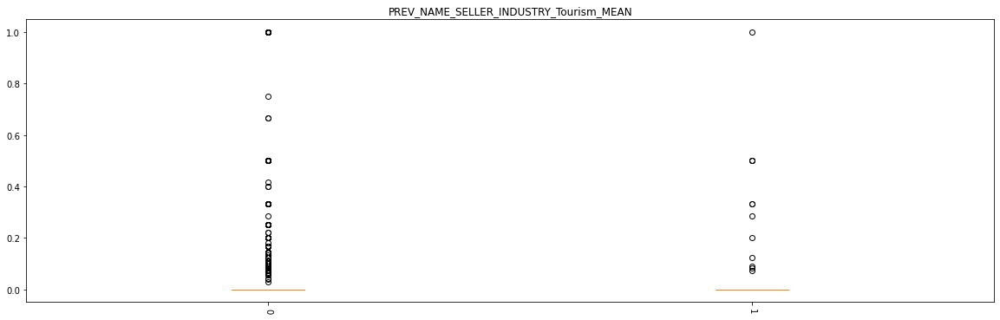

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


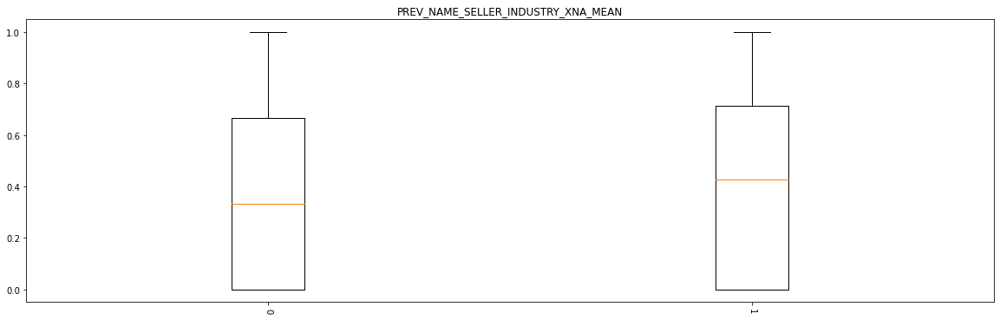

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


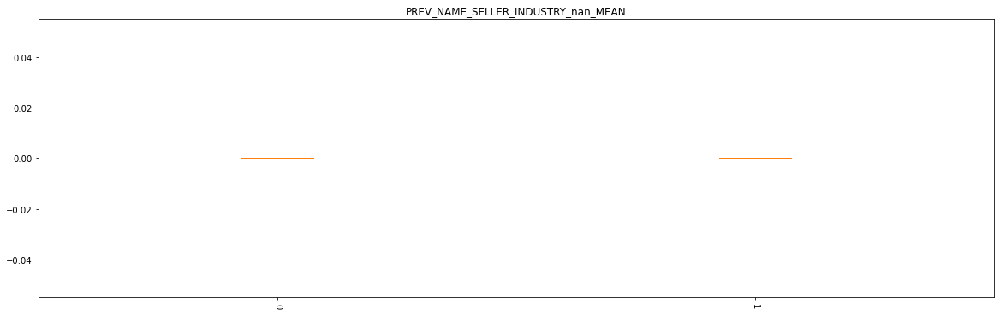

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


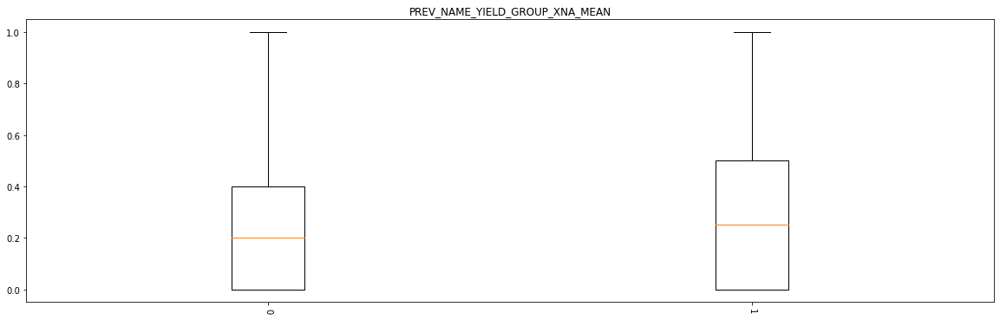

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


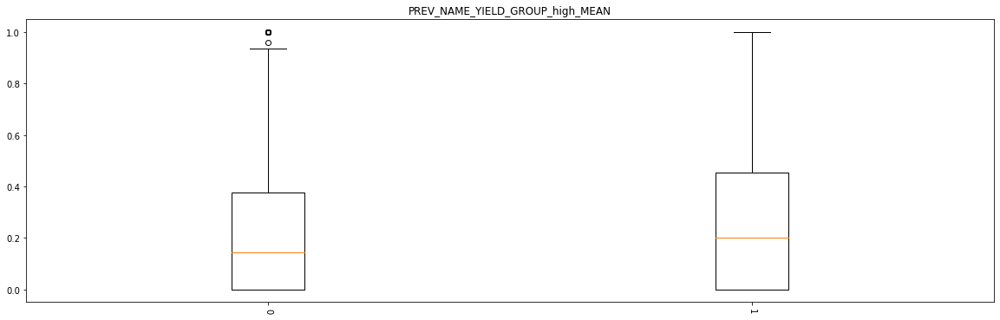

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


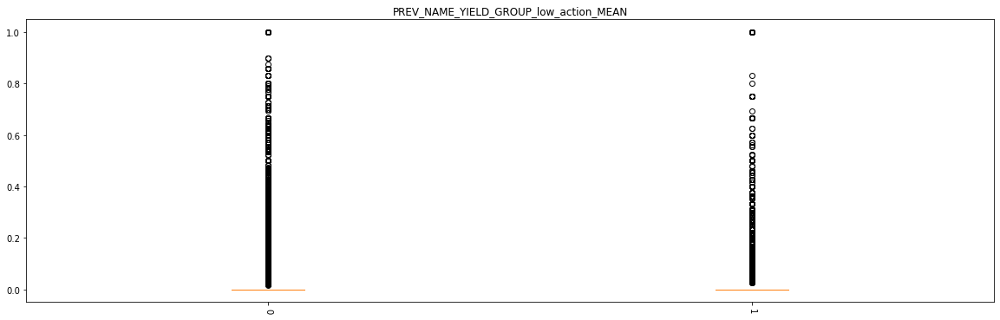

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


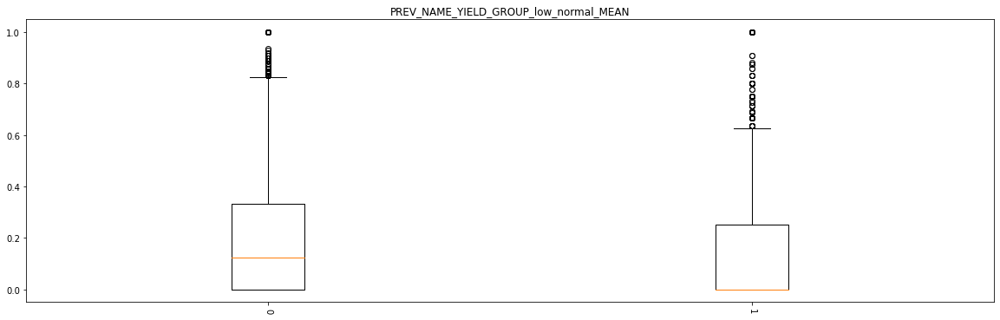

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


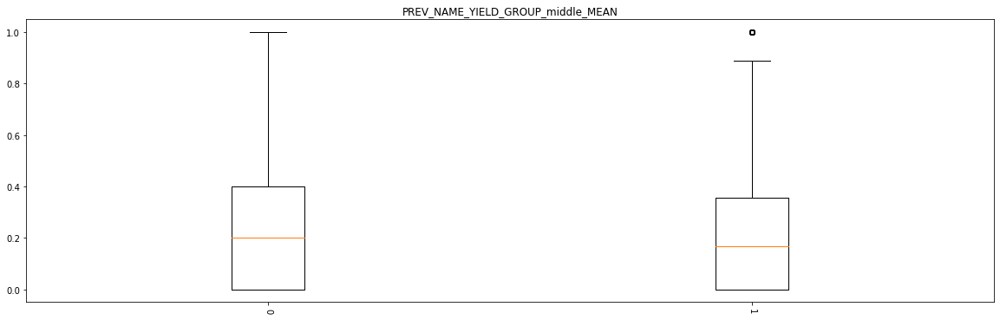

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


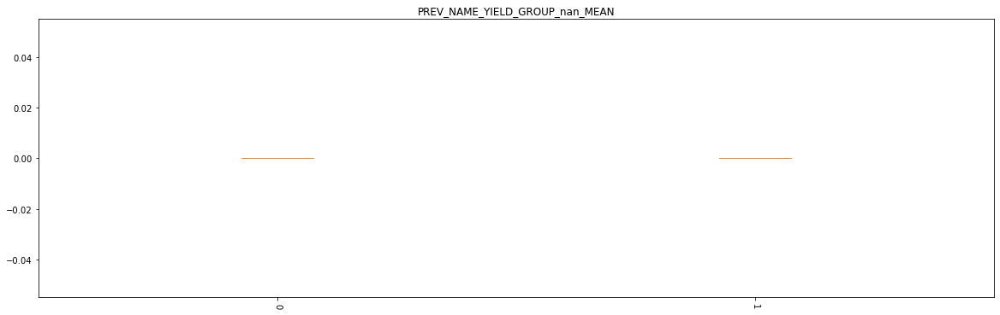

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


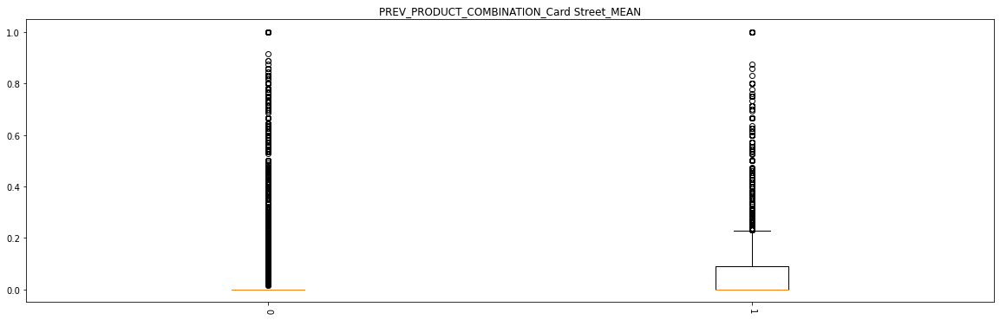

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


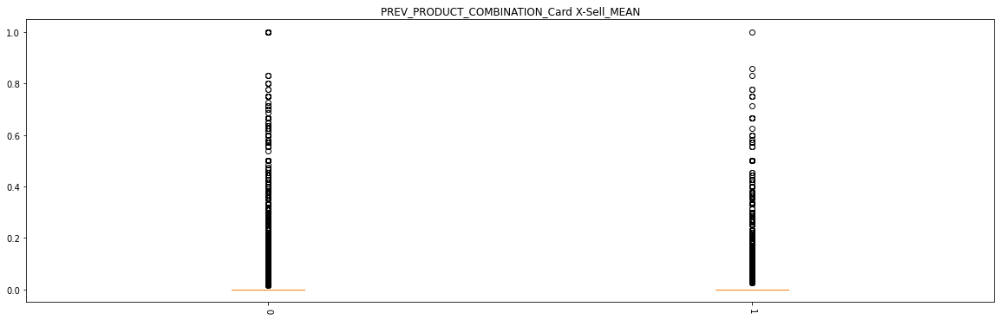

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


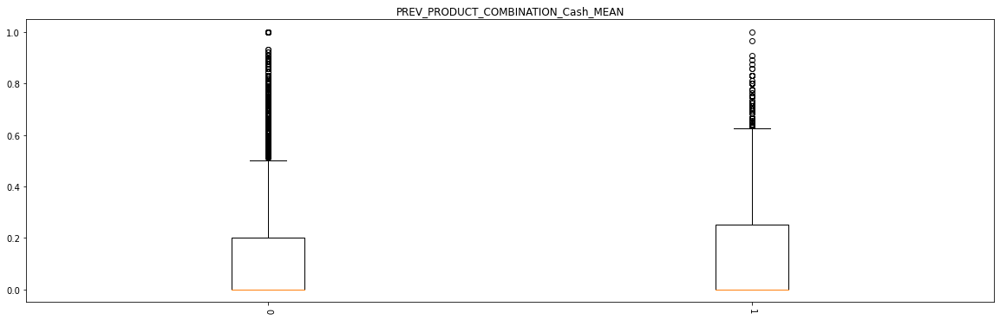

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


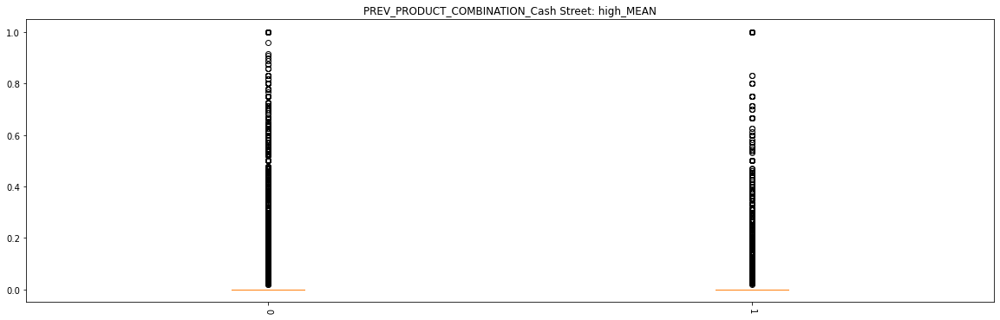

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


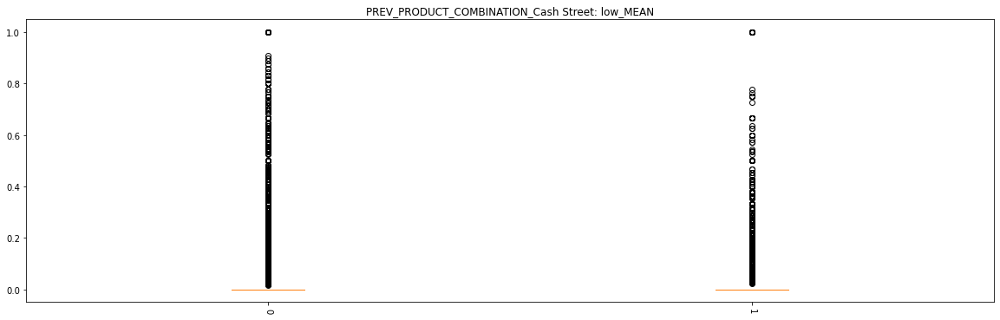

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


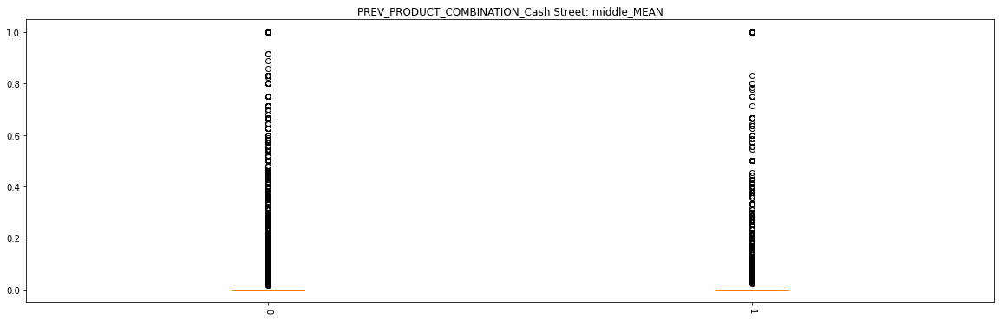

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


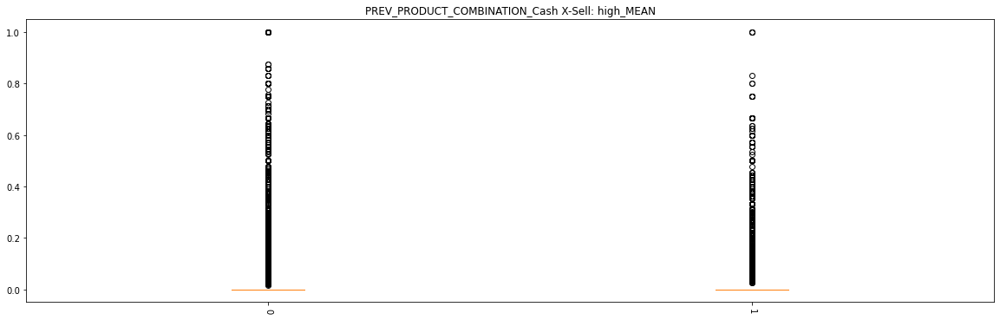

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


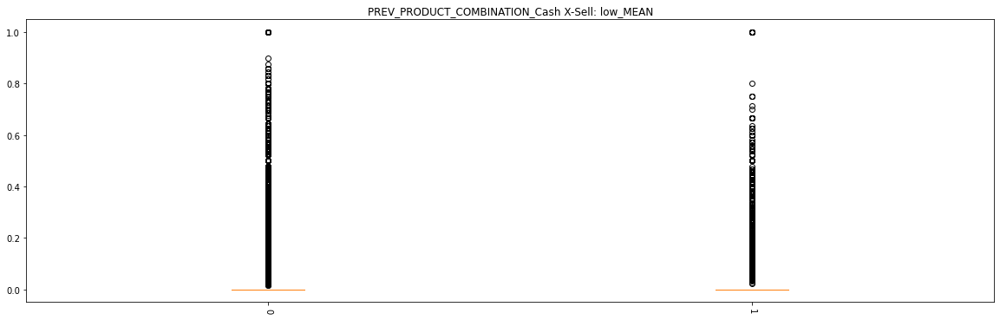

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


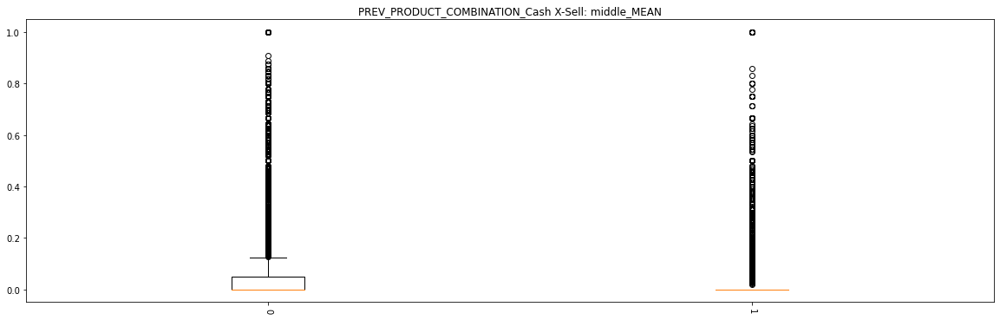

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


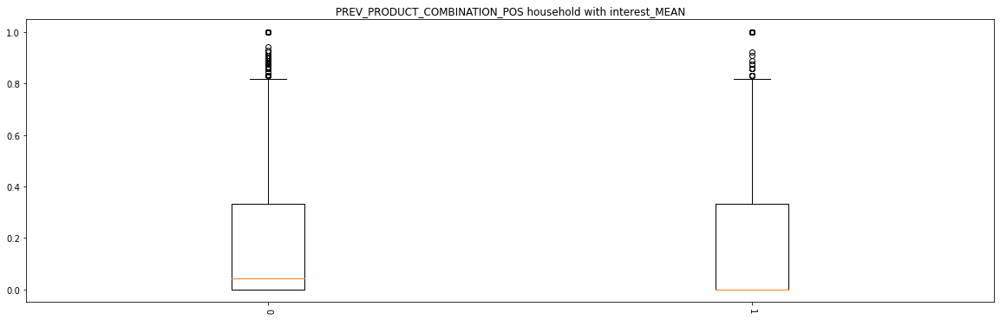

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


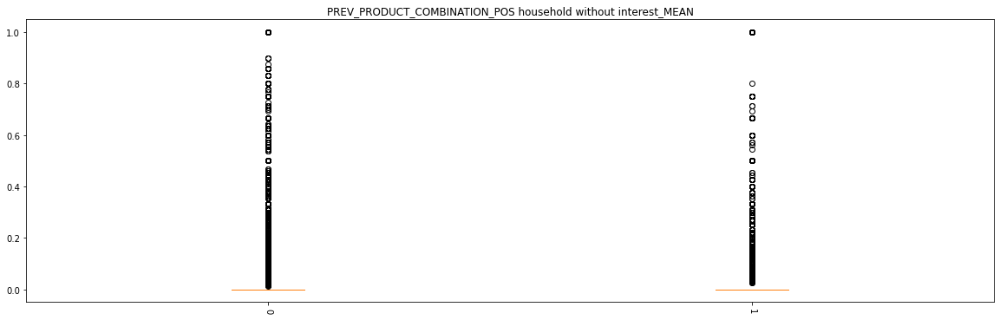

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


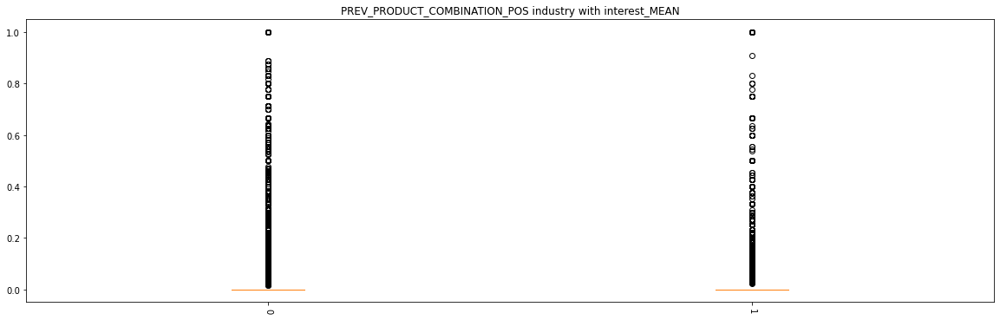

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


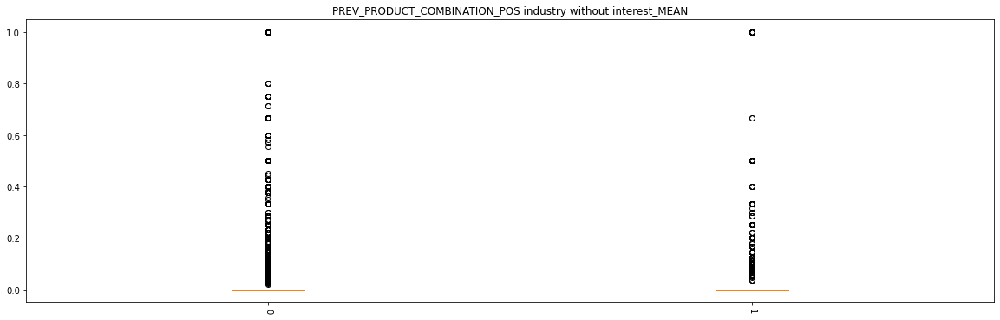

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


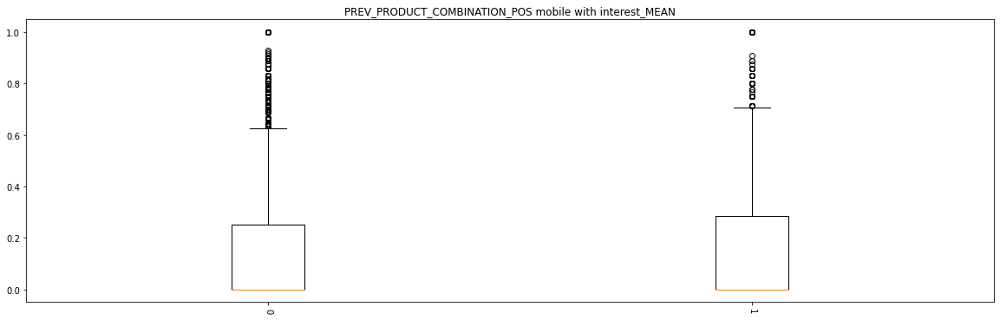

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


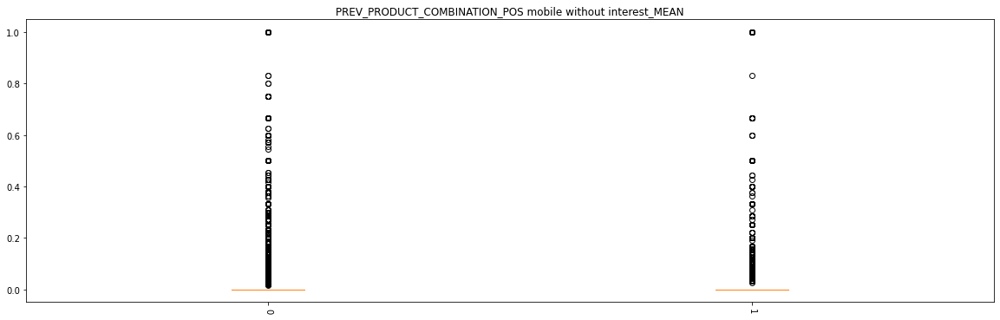

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


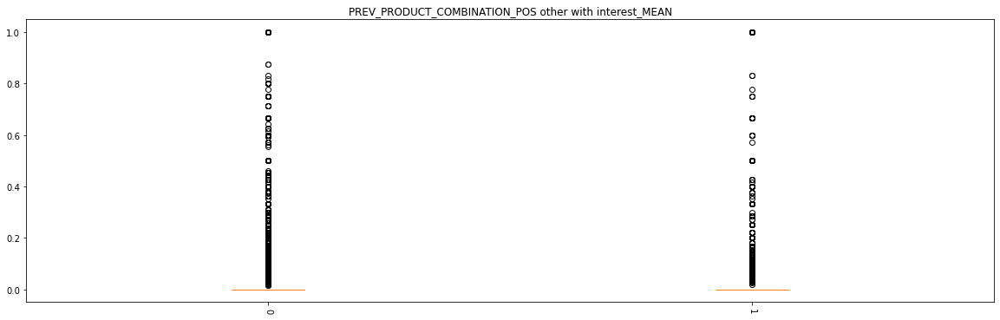

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


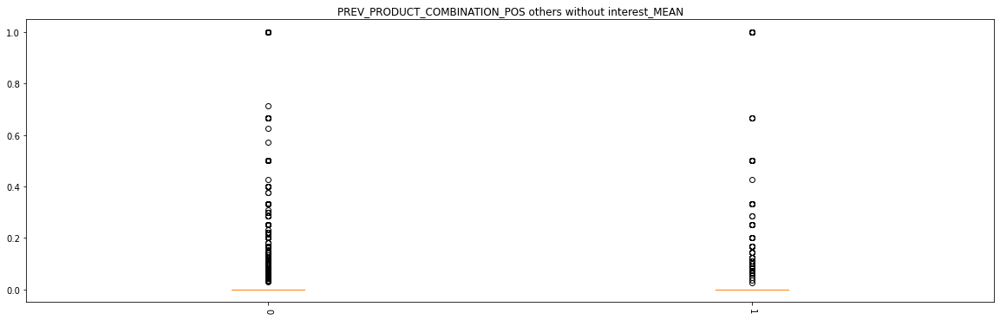

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


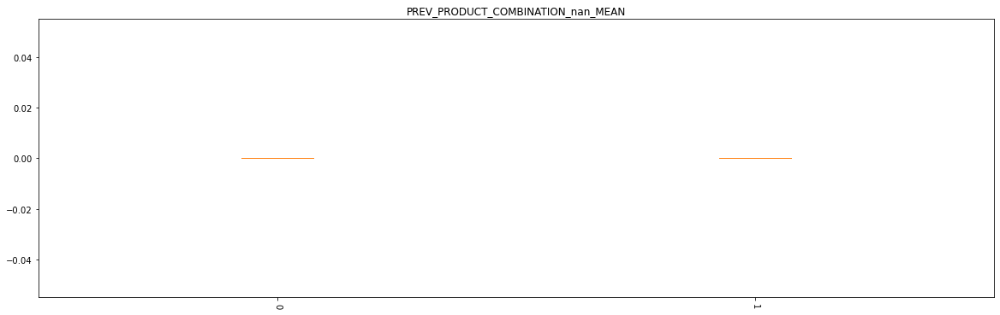

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


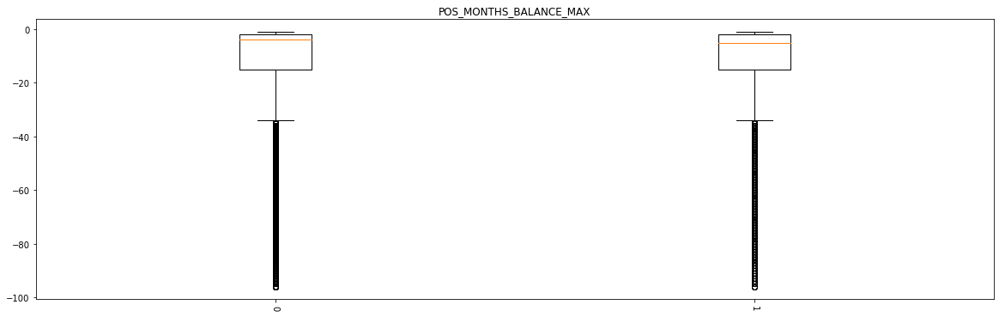

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


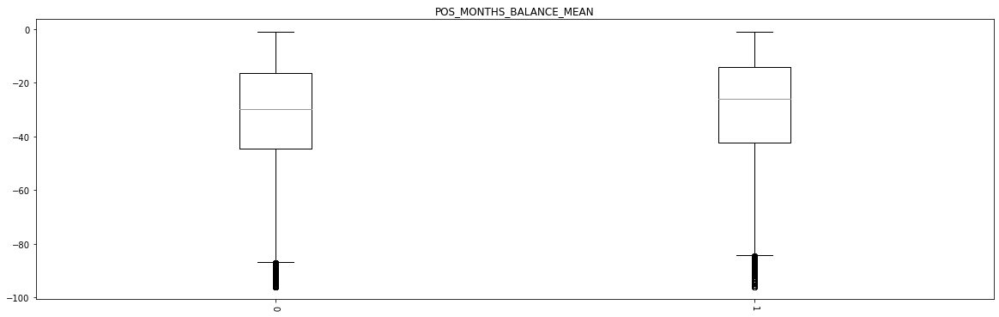

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


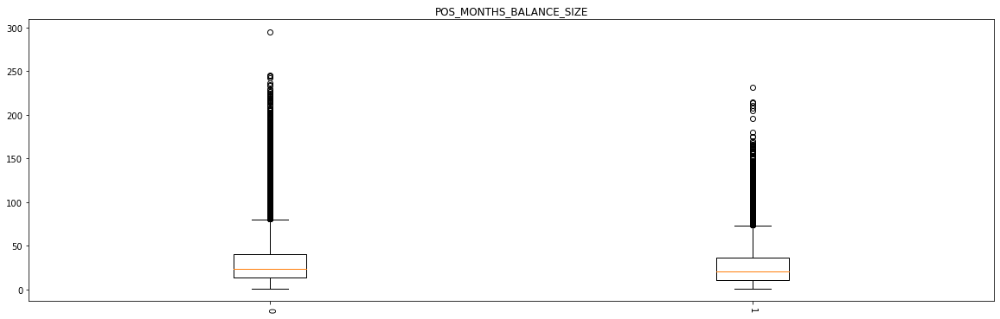

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


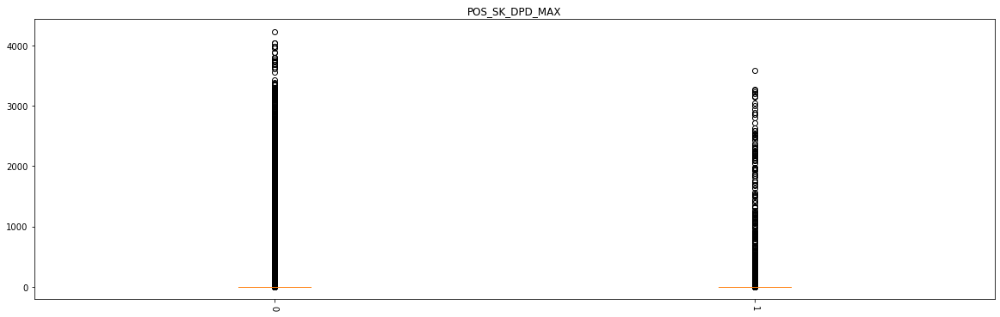

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


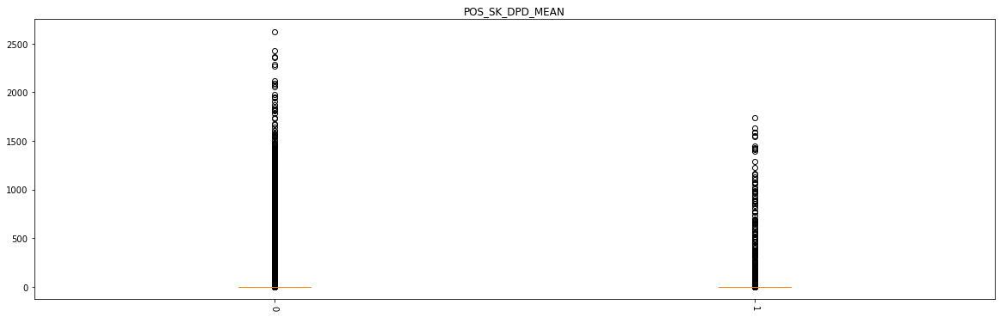

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


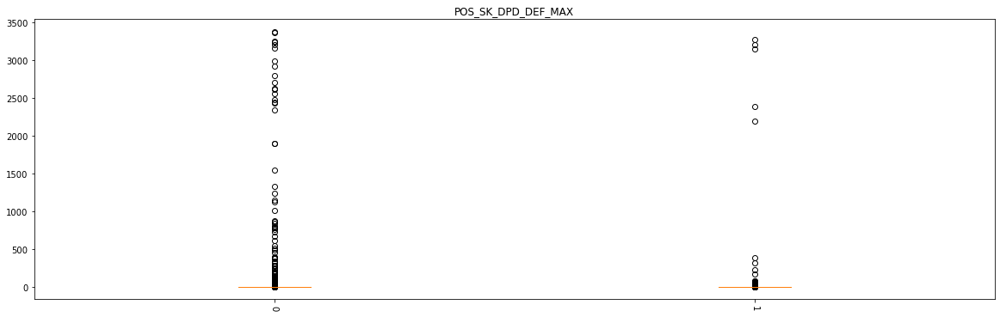

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


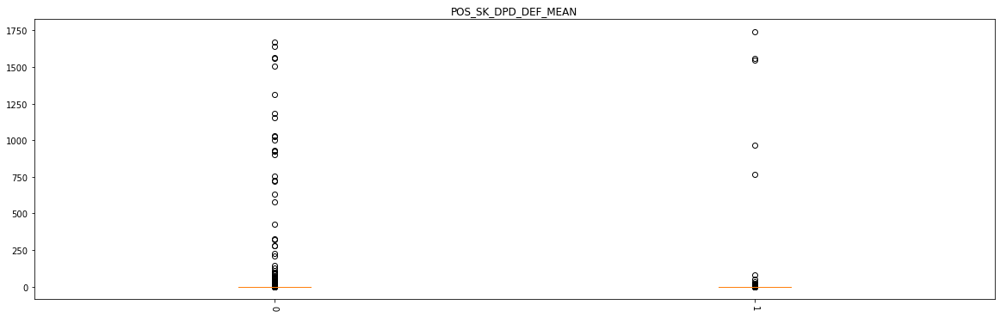

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


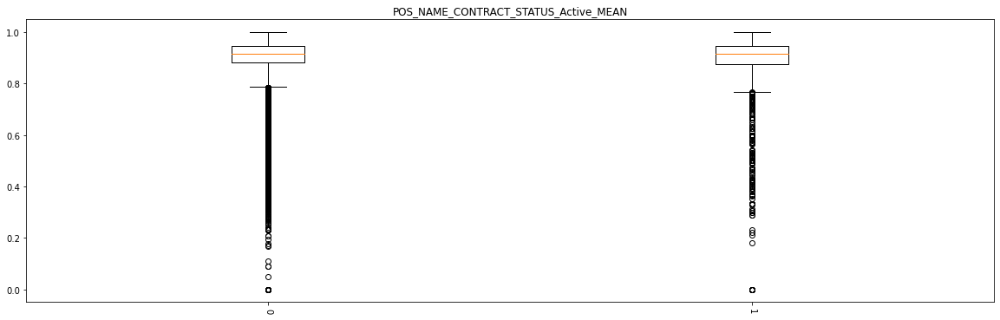

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


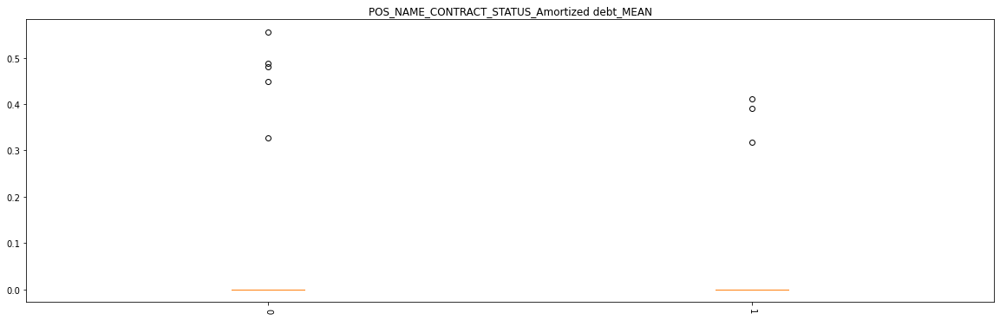

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


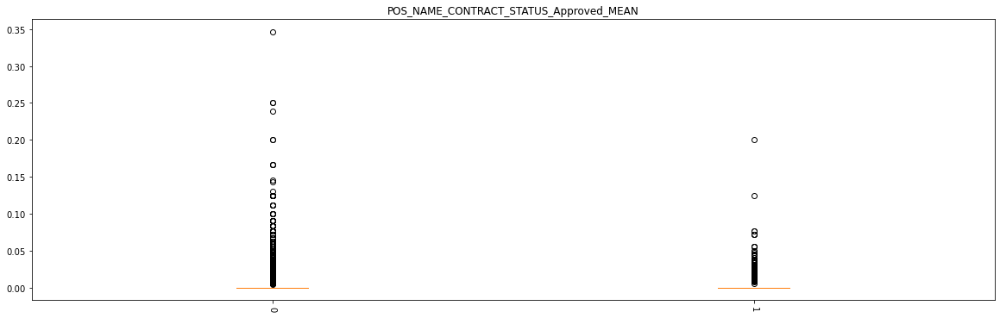

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


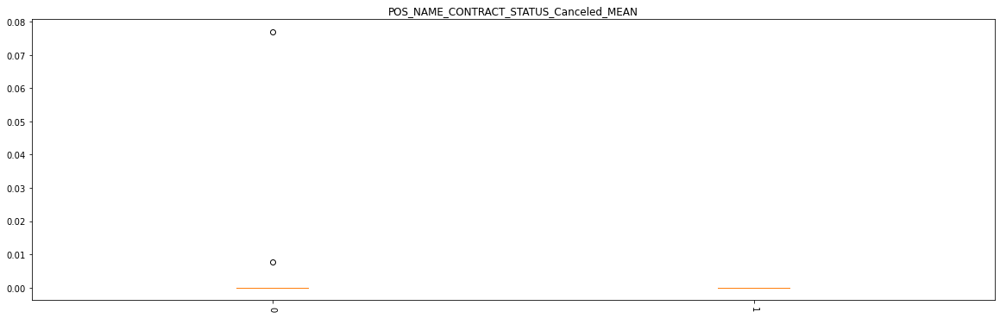

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


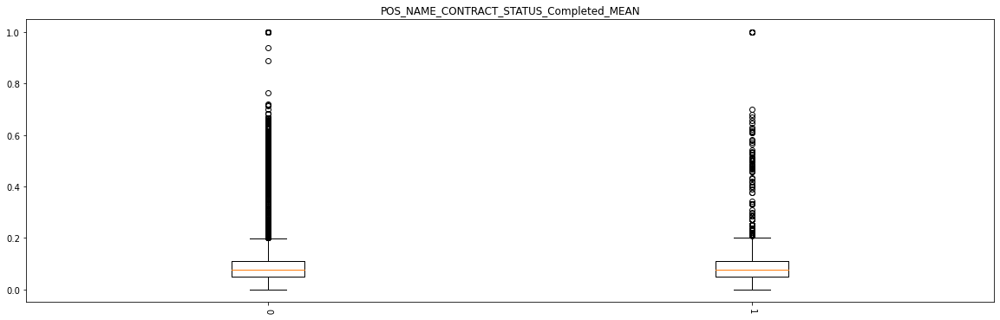

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


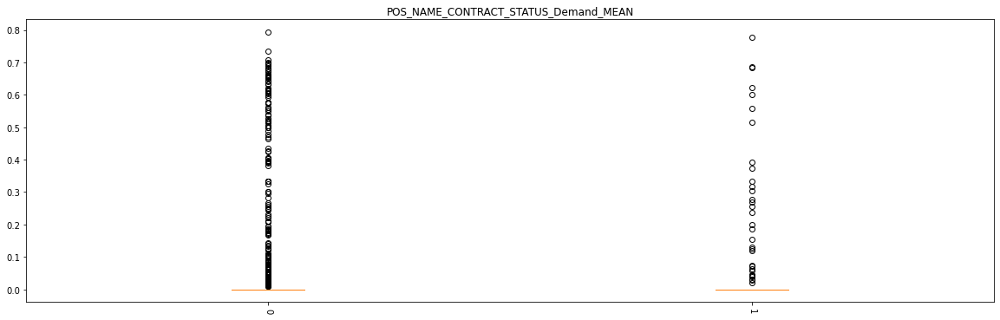

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


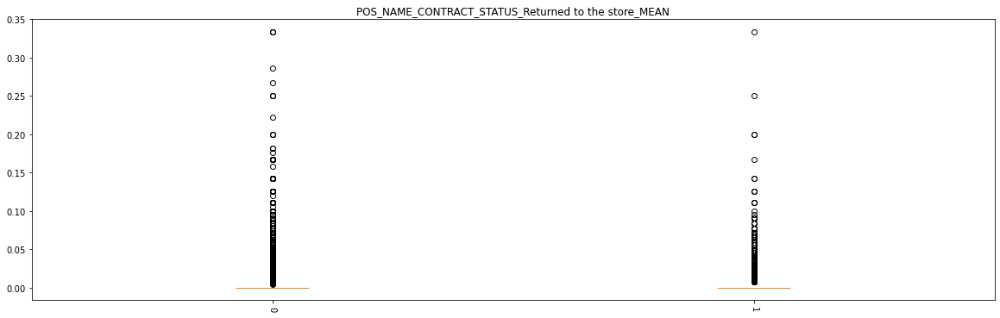

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


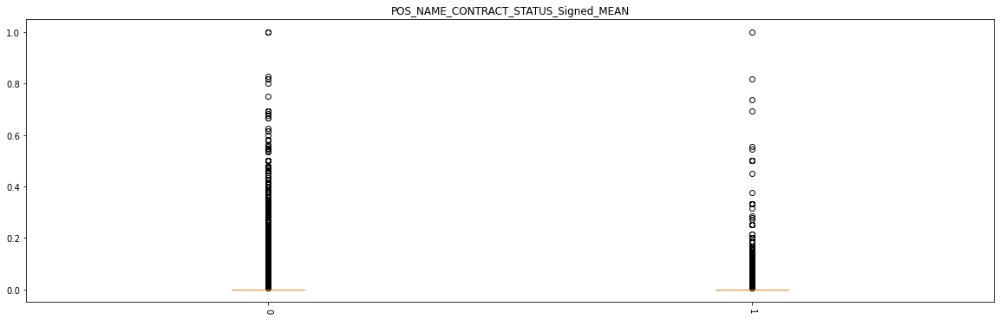

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


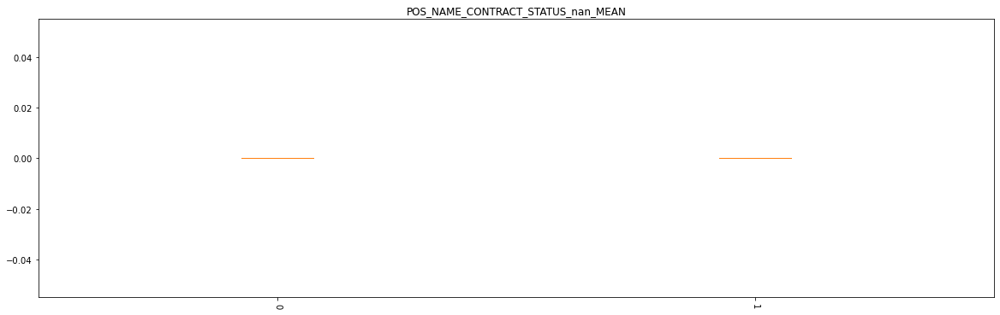

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


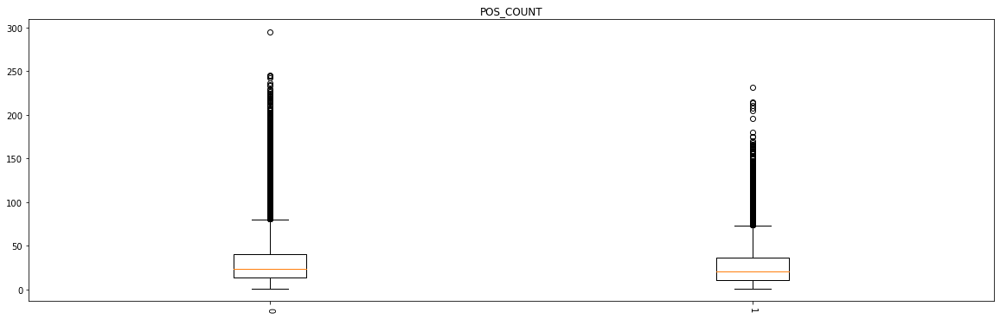

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


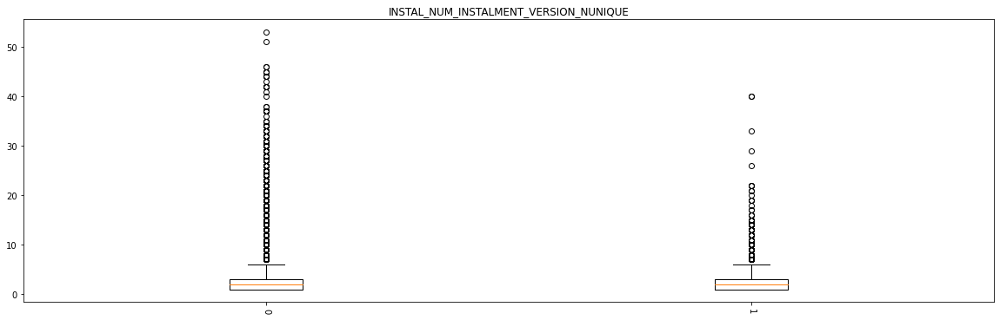

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


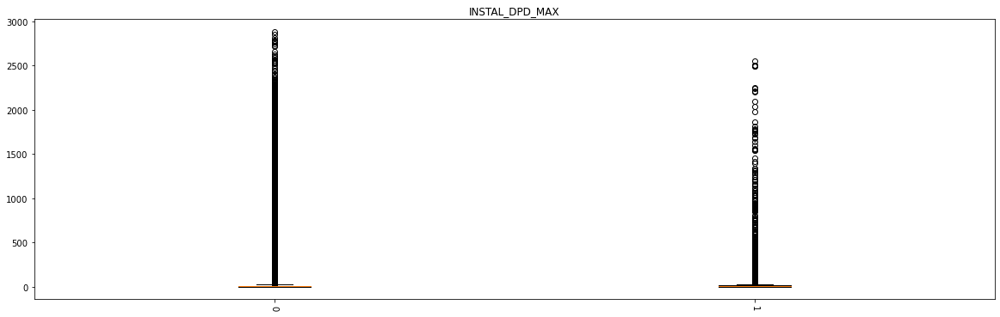

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


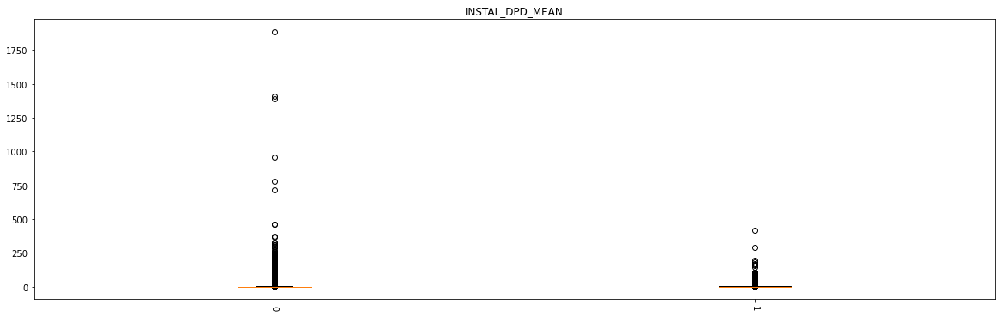

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


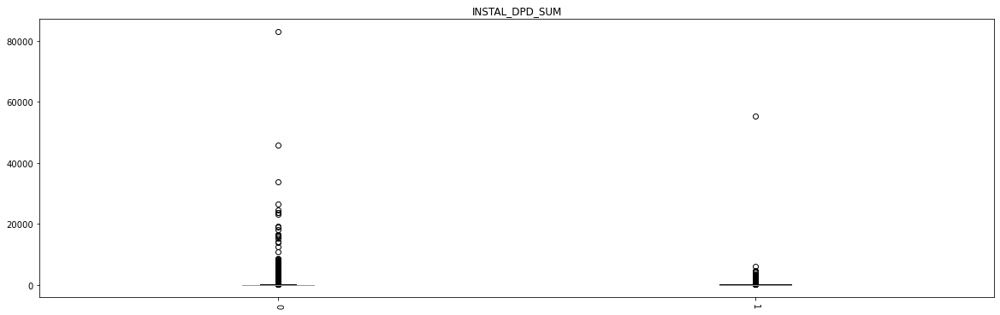

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


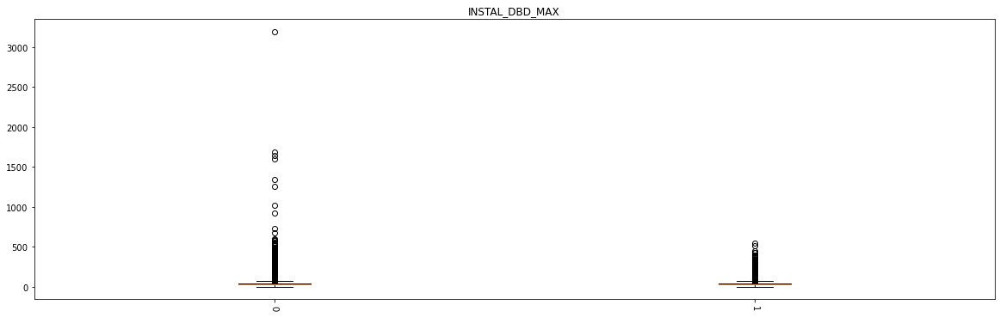

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


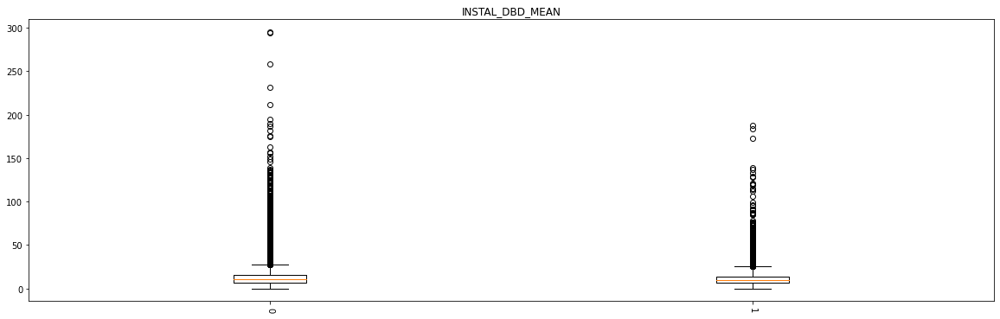

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


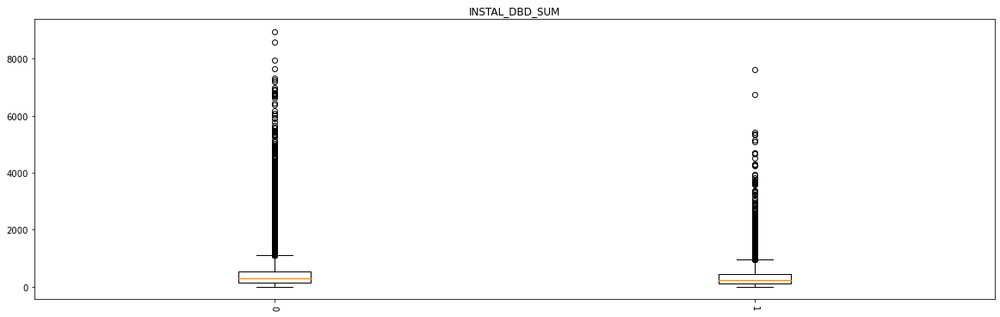

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


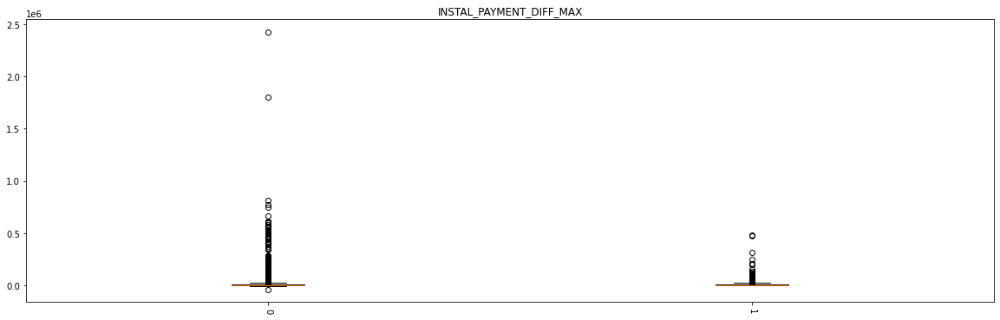

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


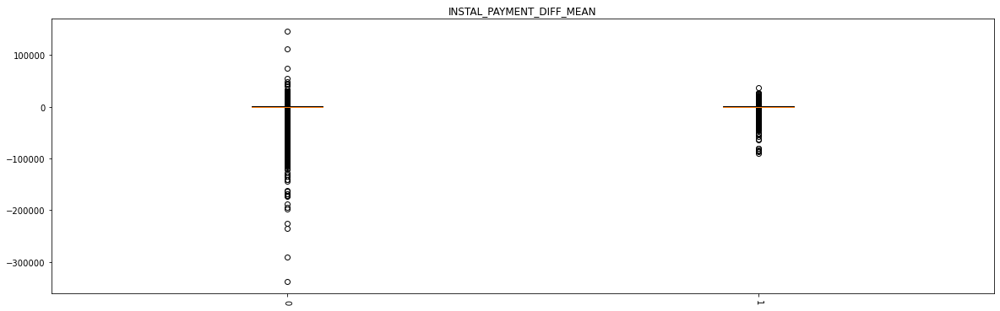

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


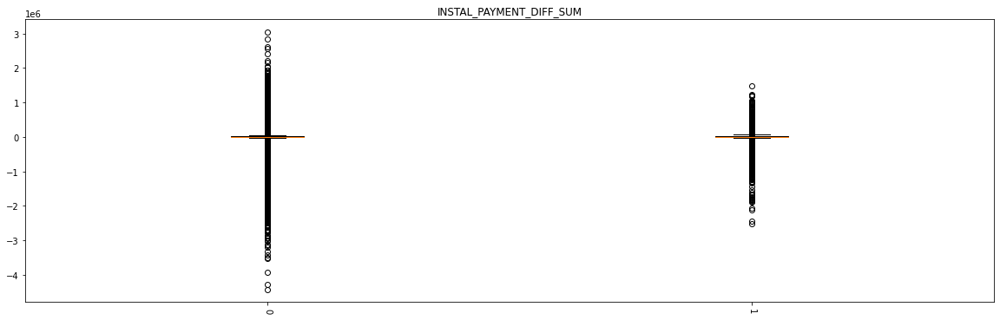

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


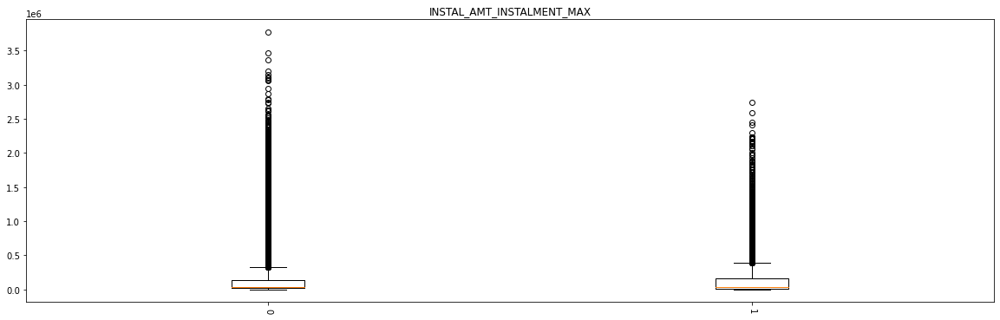

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


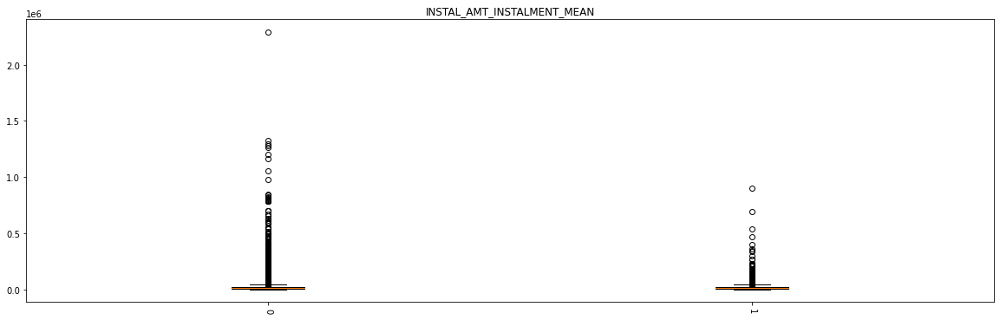

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


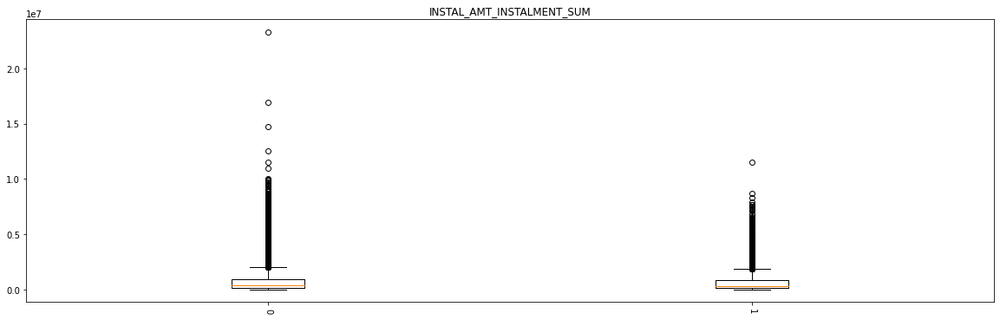

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


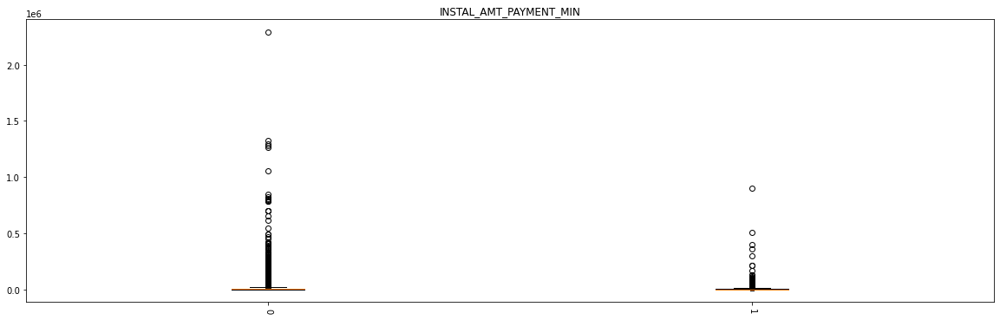

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


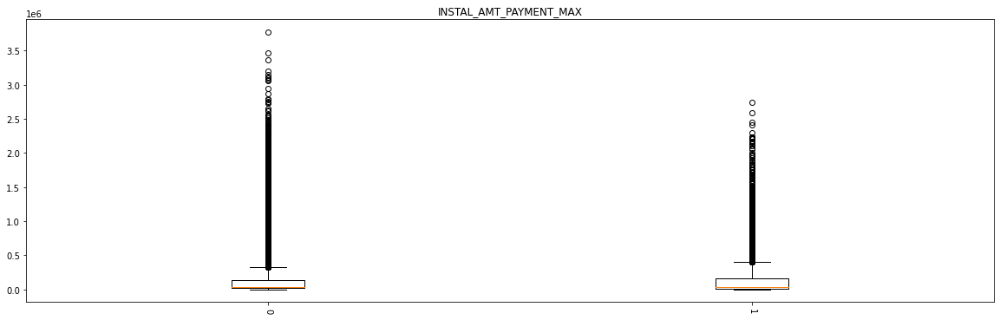

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


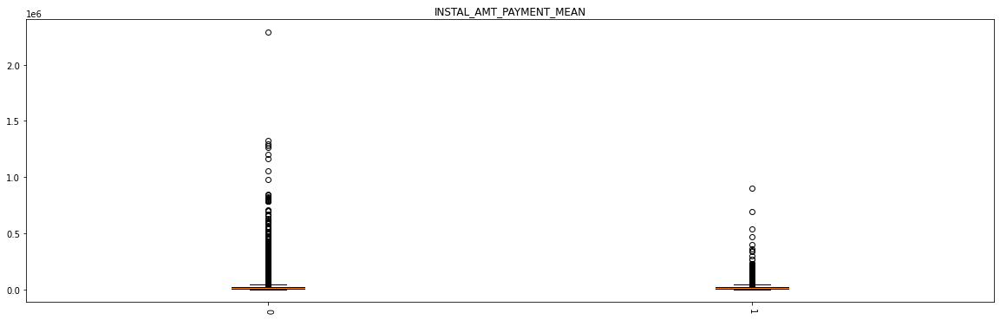

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


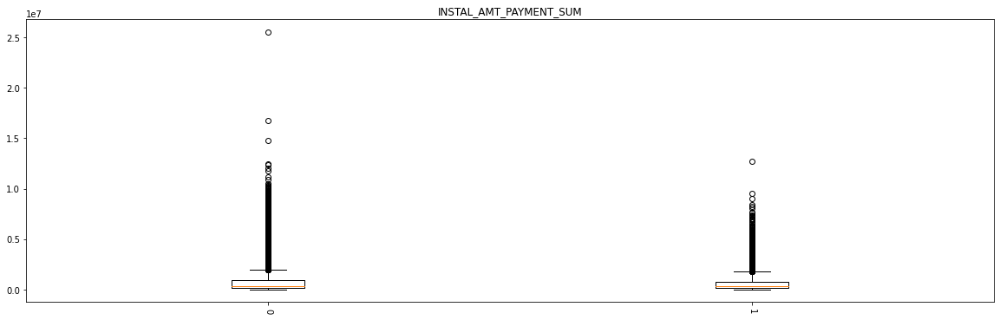

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


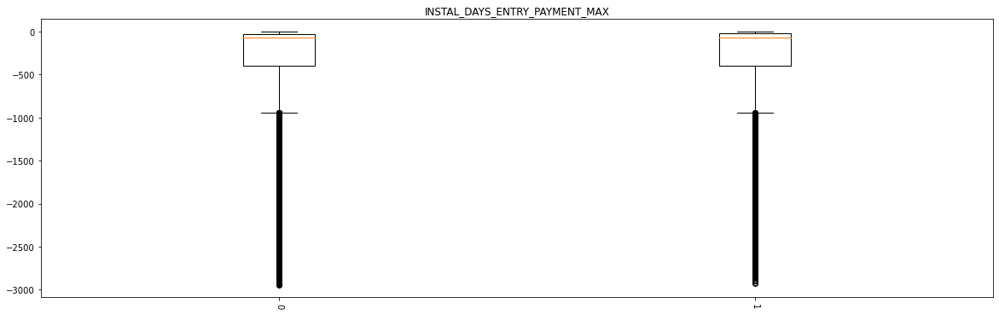

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


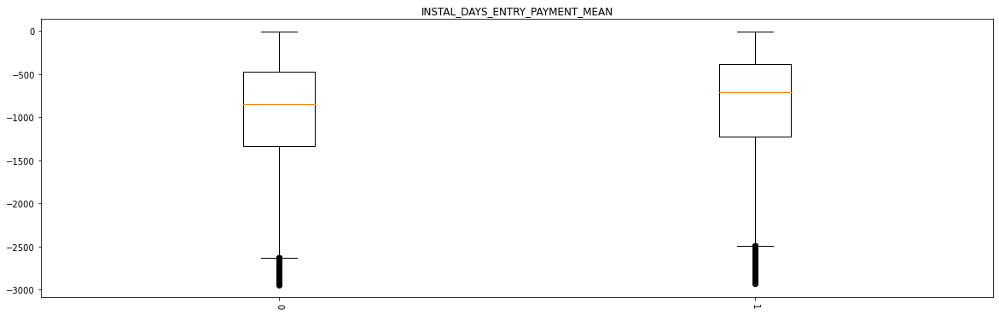

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


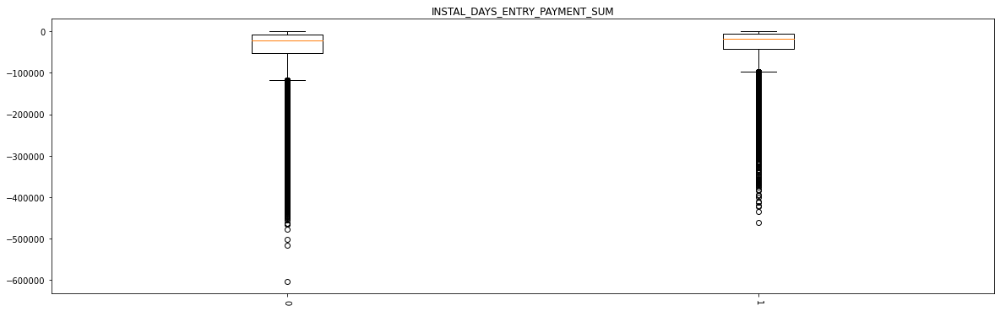

<ipython-input-220-d816a2cfc1d1>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(values,rotation=-90)


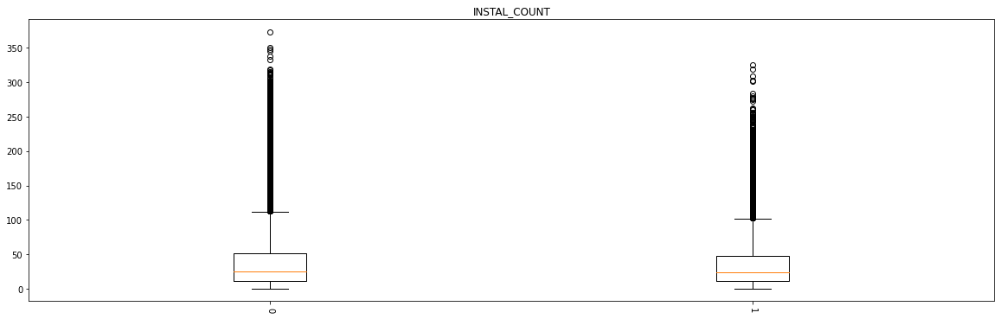

In [220]:
# Boxplot des variables en fonction de la variable cible
values = [0,1]
for var in df.columns.drop(['SK_ID_CURR','TARGET']):
    valueslist = []
    length = 50
    for val in values:
        data = list(df[(df['TARGET']==val)&(df[var].notnull())][var])
        valueslist += [data]
        length = min(length,len(data))
    if length >= 50:
        fig = plt.figure(figsize=(20,6))
        ax = plt.axes()
        ax.set_xticklabels(values,rotation=-90)
        plt.boxplot(valueslist)
        plt.title(var)
        plt.show()

In [221]:
df.drop(['SK_ID_CURR'], axis= 1, inplace = True)

In [222]:
df.to_csv('Données traitées.csv')

# Partie 2 : Prédiction
## Imports
Pour pouvoir faire fonctionner les deux parties séparément, on exporte les données à la fin de la partie 1 et on les importe au début de la partie 2.

In [223]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
import warnings
import time
from sklearn.pipeline import Pipeline
from imblearn.pipeline import Pipeline as imbpipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegressionCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import fbeta_score, precision_score, recall_score, roc_auc_score, make_scorer
import lightgbm as lgb
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import GridSearchCV, StratifiedKFold
import joblib
import shap
import lime
import lime.lime_tabular
from sklearn.inspection import permutation_importance

In [224]:
data = pd.read_csv("Données traitées.csv")
data.drop(['Unnamed: 0'],axis = 1, inplace = True)
data

,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,...,INSTAL_AMT_INSTALMENT_MEAN,INSTAL_AMT_INSTALMENT_SUM,INSTAL_AMT_PAYMENT_MIN,INSTAL_AMT_PAYMENT_MAX,INSTAL_AMT_PAYMENT_MEAN,INSTAL_AMT_PAYMENT_SUM,INSTAL_DAYS_ENTRY_PAYMENT_MAX,INSTAL_DAYS_ENTRY_PAYMENT_MEAN,INSTAL_DAYS_ENTRY_PAYMENT_SUM,INSTAL_COUNT
0,1,0,0,0,0,202500.0,406597.5,24700.5,351000.0,0.018801,...,11559.247105,219625.695,9251.775,53093.745,11559.247105,219625.695,-49.0,-315.421053,-5993.0,19
1,0,1,0,1,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,...,64754.586000,1618864.650,6662.970,560835.360,64754.586000,1618864.650,-544.0,-1385.320000,-34633.0,25
2,0,0,1,0,0,67500.0,135000.0,6750.0,135000.0,0.010032,...,7096.155000,21288.465,5357.250,10573.965,7096.155000,21288.465,-727.0,-761.666667,-2285.0,3
3,0,0,0,0,0,121500.0,513000.0,21865.5,513000.0,0.028663,...,12666.444545,835985.340,0.180,22678.785,12214.060227,806127.975,-14.0,-1032.242424,-68128.0,66
4,0,0,0,0,0,99000.0,490495.5,27517.5,454500.0,0.035792,...,27702.964286,969603.750,227.160,432218.295,27360.502714,957617.595,-82.0,-1237.800000,-43323.0,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243191,0,1,0,0,0,112500.0,345510.0,17770.5,247500.0,0.022800,...,5685.241231,761822.325,43.830,90990.000,5685.241231,761822.325,-34.0,-1606.014925,-215206.0,134
243192,0,1,0,0,0,112500.0,225000.0,22050.0,225000.0,0.022800,...,22771.410000,273256.920,22770.405,22782.465,22771.410000,273256.920,-1168.0,-1332.500000,-15990.0,12
243193,0,1,0,0,0,153000.0,677664.0,29979.0,585000.0,0.005002,...,4399.707857,61595.910,27.270,5575.185,4115.915357,57622.815,-1738.0,-2387.428571,-33424.0,14
243194,1,1,0,0,0,171000.0,370107.0,20205.0,319500.0,0.005313,...,10239.832895,194556.825,2296.440,19065.825,10239.832895,194556.825,-18.0,-161.263158,-3064.0,19


## Travail sur les données

In [225]:
scaler = StandardScaler()
transfo = scaler.fit_transform(data.drop(['TARGET'], axis= 1))
X = pd.DataFrame(transfo, columns=data.drop(['TARGET'], axis= 1).columns)
y = data['TARGET']

In [226]:
# Matrice de corrélations
data.corr(method='spearman').style.format("{:.2}").background_gradient(cmap=plt.get_cmap('coolwarm'))

All-NaN slice encountered
All-NaN slice encountered


In [227]:
def acp(df,n=100):
    standardized_df = StandardScaler().fit_transform(df)
    pca = PCA(n_components=n)
    principal_components = pca.fit_transform(standardized_df)
    principal_df = pd.DataFrame(data = principal_components)
    return [round(sum(list(pca.explained_variance_ratio_))*100, 2), principal_df]

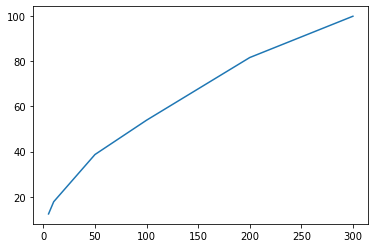

In [228]:
absc = []
ordo = [5,10,50,100,200,300]
for k in ordo:
    absc += [acp(X,n=k)[0]]
plt.plot(ordo,absc)

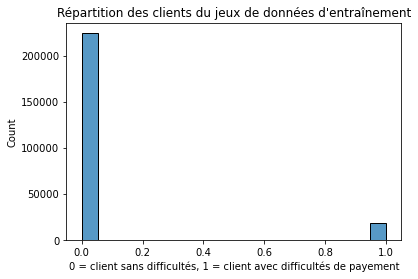

In [229]:
# Proportions de bons et mauvais clients : Problème d'équilibrage

sns.histplot(y)
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

In [230]:
# Rééquilibrage : undersampling des 0 et oversampling des 1

over = SMOTE(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.5)
Xres,yres = over.fit_resample(X, y)
Xres,yres = under.fit_resample(Xres,yres)

# fit_resample ne fonctionne plus avec pipeline
#steps = [('o', over), ('u', under)]
#ppl = Pipeline(steps=steps)
#Xres,yres = ppl.fit_resample(X, y)

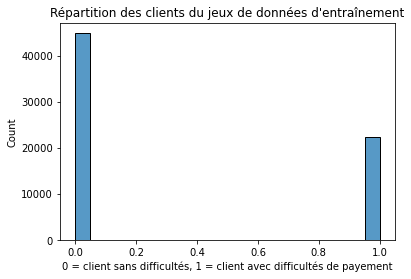

In [231]:
# Proportions de bons et mauvais clients : Problème d'équilibrage

sns.histplot(yres)
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

In [232]:
# Rééquilibrage : undersampling des 0 et oversampling des 1 v2

over = SMOTE(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.2)
Xres1,yres1 = over.fit_resample(X, y)
Xres1,yres1 = under.fit_resample(Xres1,yres1)

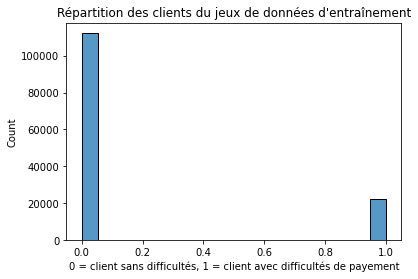

In [233]:
# Proportions de bons et mauvais clients : Problème d'équilibrage

sns.histplot(yres1)
plt.title('Répartition des clients du jeux de données d\'entraînement')
plt.xlabel('0 = client sans difficultés, 1 = client avec difficultés de payement')
plt.show()

In [234]:
# Certains modèles ne supportent pas les caractères spéciaux
# Ces modèles ont été abandonnés.

import re
X = X.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
data =  data.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

## Essais de prédiction

In [235]:
# Fonction pour faire tourner un modèle sur les données et récupérer les résultats : 

def train_model(model, X, y, b = 10): 
    X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=y)  #, random_state=42

    over = SMOTE(sampling_strategy=0.1)
    #under = RandomUnderSampler(sampling_strategy=0.2)
    X_train,y_train = over.fit_resample(X_train, y_train)
    #X_train,y_train = under.fit_resample(X_train,y_train)
    
    #pipe = Pipeline([('scaler', StandardScaler()),('clf', model["clf"])]) # Already scaled
    func_mod = model["clf"]
    start_time = time.time()
    func_mod.fit(X_train, y_train)
    train_time = time.time() - start_time

    train_prediction = func_mod.predict(X_train)
    test_prediction = func_mod.predict(X_test)
    
    train_precision = precision_score(y_train, train_prediction)
    test_precision = precision_score(y_test, test_prediction)
    
    train_recall = recall_score(y_train, train_prediction)
    test_recall = recall_score(y_test, test_prediction)
    
    train_fb = fbeta_score(y_train, train_prediction, beta = b)
    test_fb = fbeta_score(y_test, test_prediction, beta = b)
    
    train_auc = roc_auc_score(y_train, train_prediction)
    test_auc = roc_auc_score(y_test, test_prediction)
    
    model_details = {"name": model["name"], "train_precision":train_precision, "test_precision":test_precision, 
                     "train_time": train_time, "train_fb":train_fb, "test_fb":test_fb,
                     "train_recall": train_recall, "test_recall":test_recall,
                     "train_auc":train_auc,"test_auc":test_auc, "model": func_mod}
    return model_details

models = [
    {"name": "Naive Bayes", "clf": GaussianNB()},
    {"name": "logistic regression", "clf": LogisticRegressionCV()},
    {"name": "logistic regression balanced", "clf": LogisticRegressionCV(class_weight = "balanced")},
    {"name": "logistic regression rebalanced", "clf": LogisticRegressionCV(class_weight = {0: 1, 1: 2})},
    {"name": "Decision Tree", "clf": DecisionTreeClassifier()},
    {"name": "Decision Tree balanced", "clf": DecisionTreeClassifier(class_weight = "balanced")},
    {"name": "Decision Tree balanced 2", "clf": DecisionTreeClassifier(class_weight = "balanced", max_depth=2)},
    {"name": "Decision Tree rebalanced", "clf": DecisionTreeClassifier(class_weight = {0: 1, 1: 2})},
    {"name": "Random Forest", "clf": RandomForestClassifier(n_estimators=200)},
    {"name": "Random Forest balanced", "clf": RandomForestClassifier(n_estimators=200, class_weight = "balanced")},
    {"name": "Random Forest balanced 2", "clf": RandomForestClassifier(n_estimators=200, class_weight = "balanced", 
                                                                       max_depth=2)},
    {"name": "Random Forest rebalanced", "clf": RandomForestClassifier(n_estimators=200, class_weight = {0: 1, 1: 2})},
    {"name": "MLP Classifier", "clf": MLPClassifier(solver='adam', alpha=1e-1, hidden_layer_sizes=(10,10,5,2), 
                                                          max_iter=500, random_state=42)},
    {"name": "XGB Classifier", "clf": XGBClassifier()},
    {"name": "Faster Gradient Boosting", "clf": HistGradientBoostingClassifier()},
    {"name": "K-Nearest-Neighbours", "clf": KNeighborsClassifier()}]

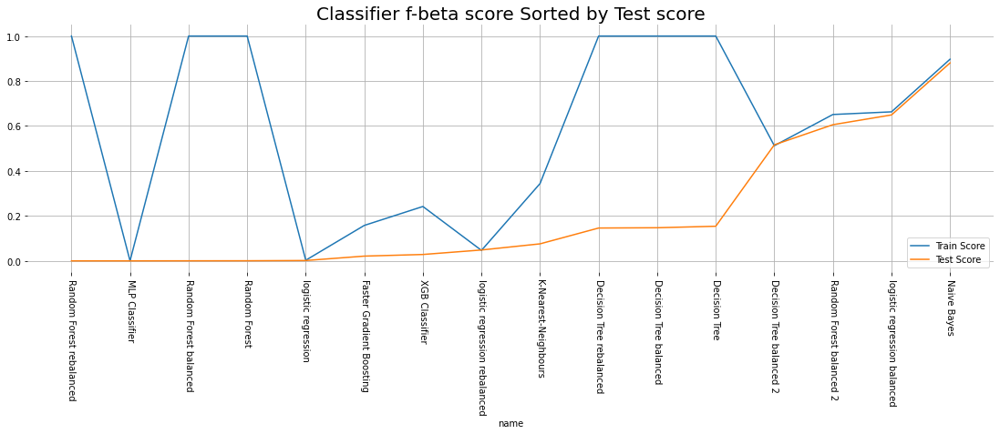

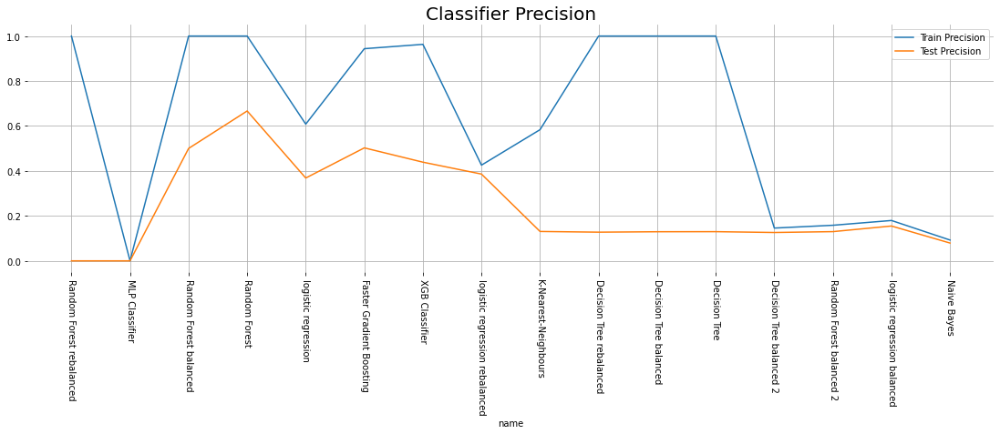

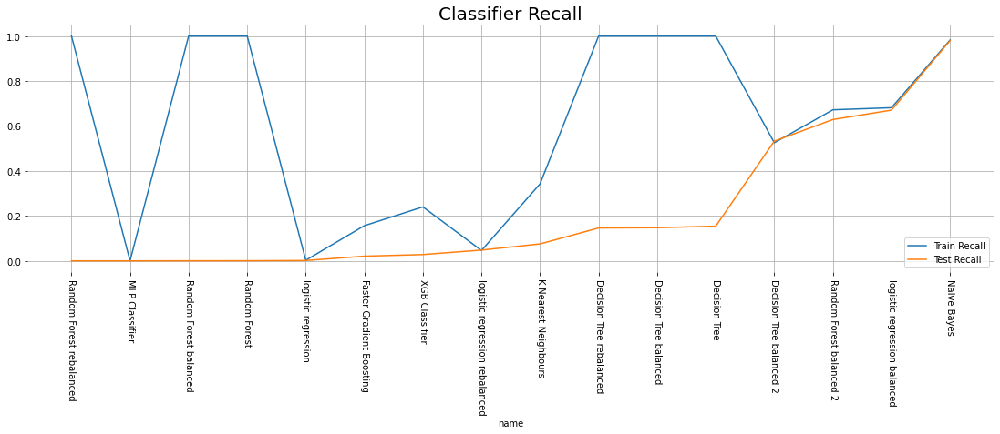

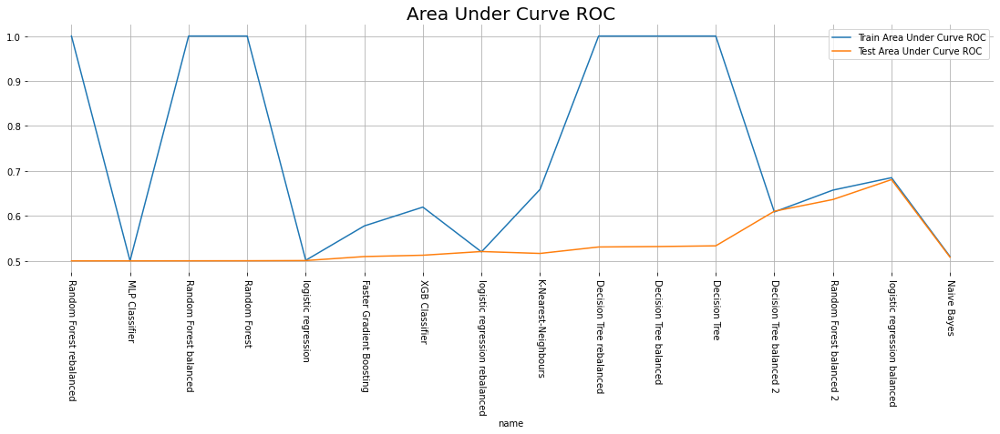

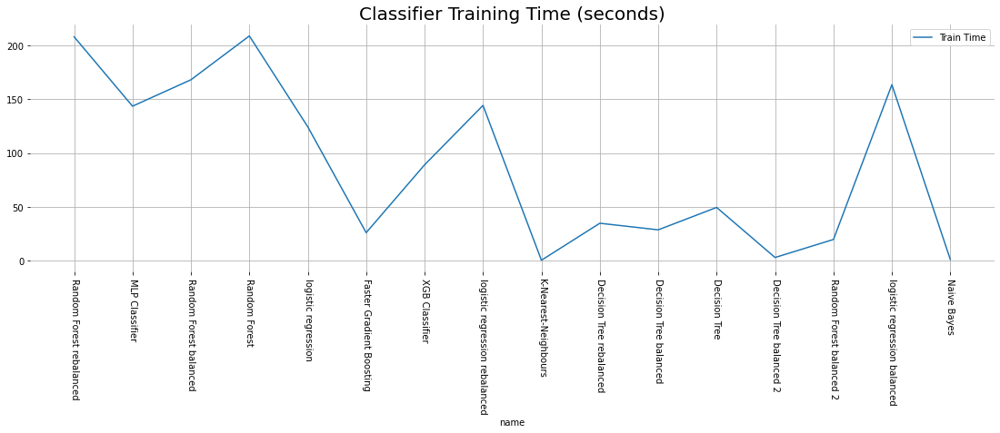

In [236]:
trained_models_00 = [] #  keep track of all details for models we train
for model in models:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        model_details = train_model(model, X, y) 
        trained_models_00.append(model_details)

# visualize accuracy and run time
model_df = pd.DataFrame(trained_models_00)
model_df.sort_values("test_fb", inplace=True) 
ax = model_df[["train_fb","test_fb", "name"]].plot(kind="line", x="name", figsize=(19,5), grid=True, 
                                                         title="Classifier f-beta score Sorted by Test score")
ax.legend(["Train Score", "Test Score"])
for p in ax.patches:
    ax.annotate(str(round(p.get_height(),3)), (p.get_x()*1.005, p.get_height()*1.005))
ax.title.set_size(20)
plt.xticks(range(len(models)),list(model_df["name"]),rotation=-90)
plt.box(False)
ax= model_df[["train_precision","test_precision", "name"]].plot(kind="line", x="name", figsize=(19,5), grid=True, 
                                         title="Classifier Precision")
ax.title.set_size(20)
ax.legend(["Train Precision", "Test Precision"])
plt.xticks(range(len(models)),list(model_df["name"]),rotation=-90)
plt.box(False)  
ax= model_df[["train_recall","test_recall", "name"]].plot(kind="line", x="name", figsize=(19,5), grid=True, 
                                         title="Classifier Recall")
ax.title.set_size(20)
ax.legend(["Train Recall", "Test Recall"])
plt.xticks(range(len(models)),list(model_df["name"]),rotation=-90)
plt.box(False)  
ax= model_df[["train_auc","test_auc", "name"]].plot(kind="line", x="name", figsize=(19,5), grid=True, 
                                         title="Area Under Curve ROC")
ax.title.set_size(20)
ax.legend(["Train Area Under Curve ROC", "Test Area Under Curve ROC"])
plt.xticks(range(len(models)),list(model_df["name"]),rotation=-90)
plt.box(False)  
ax= model_df[["train_time","name"]].plot(kind="line", x="name", figsize=(19,5), grid=True, 
                                         title="Classifier Training Time (seconds)")
ax.title.set_size(20)
ax.legend(["Train Time"])
plt.xticks(range(len(models)),list(model_df["name"]),rotation=-90)
plt.box(False)  

## Optimisation des meilleurs modèles

In [237]:
best_models = [{"name": "Random Forest balanced 2", "clf": RandomForestClassifier()},
    {"name": "logistic regression balanced", "clf": LogisticRegression(class_weight = "balanced")}]
scoring_methods = ['roc_auc','recall','f1']
search_parameters_1 = {"classifier__n_estimators" : [50,200,1000],
                       "classifier__class_weight": ["balanced",{0: 1, 1: 2}],
                       "classifier__max_depth": [3,5,10,100,None]}
search_parameters_2 = {"classifier__penalty" : ['none','l2'],"classifier__C" : [0.1,1,10], 
                       "classifier__fit_intercept":[True,False]}

In [238]:
ftwo_scorer = make_scorer(fbeta_score, beta=10)

In [239]:
X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=y)

stratified_kfold = StratifiedKFold(n_splits=3,shuffle=True)

pipe1 = imbpipeline(steps = [['smote', SMOTE(sampling_strategy=0.1)],
                             ['under',RandomUnderSampler(sampling_strategy=0.2)],
                             ['classifier',RandomForestClassifier()]])
grid1 = GridSearchCV(estimator=pipe1,param_grid = search_parameters_1,scoring=ftwo_scorer,cv=stratified_kfold)
grid1.fit(X_train, y_train)
print(grid1.best_params_) 
grid_predictions1 = grid1.predict(X_test) 
print("F-beta score :",fbeta_score(y_test,grid_predictions1, beta = 10))
print("Recall :",recall_score(y_test,grid_predictions1))
print("Precision :",precision_score(y_test,grid_predictions1))
print("ROC :",roc_auc_score(y_test,grid_predictions1))

{'classifier__class_weight': 'balanced', 'classifier__max_depth': 3, 'classifier__n_estimators': 1000}
F-beta score : 0.5978104856861965
Recall : 0.6185654008438819
Precision : 0.13725949159683534
ROC : 0.6449112346448131


In [240]:
X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=y)

pipe2 = imbpipeline(steps = [['scale',StandardScaler()],
                             ['smote', SMOTE(sampling_strategy=0.1)],
                             ['under',RandomUnderSampler(sampling_strategy=0.2)],
                             ['classifier',LogisticRegression(class_weight = "balanced")]])

grid2 = GridSearchCV(estimator=pipe2,param_grid = search_parameters_2,
                     scoring=ftwo_scorer,n_jobs=-1,error_score='raise')
grid2.fit(X_train, y_train)
print(grid2.best_params_) 
grid_predictions2 = grid2.predict(X_test) 
print("F-beta score :",fbeta_score(y_test,grid_predictions2, beta = 10))
print("Recall :",recall_score(y_test,grid_predictions2))
print("Precision :",precision_score(y_test,grid_predictions2))
print("ROC :",roc_auc_score(y_test,grid_predictions2))

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


{'classifier__C': 0.1, 'classifier__fit_intercept': False, 'classifier__penalty': 'l2'}
F-beta score : 0.7510070022943349
Recall : 0.7891960329183372
Precision : 0.12861957493637802
ROC : 0.6686080057563502


In [241]:
X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=y)

pipe_final_2 = imbpipeline(steps = [['scale',StandardScaler()],
                                  ['smote',SMOTE(sampling_strategy=0.1)],
                                  ['under',RandomUnderSampler(sampling_strategy=0.2)],
                                  ['classifier',RandomForestClassifier(class_weight= 'balanced', max_depth= 5,
                                                                       n_estimators= 1000)]])
pipe_final_2.fit(X_train, y_train)

Pipeline(steps=[('scale', StandardScaler()),
                ('smote', SMOTE(sampling_strategy=0.1)),
                ('under', RandomUnderSampler(sampling_strategy=0.2)),
                ['classifier',
                 RandomForestClassifier(class_weight='balanced', max_depth=5,
                                        n_estimators=1000)]])

In [242]:
pipe_predictions2 = pipe_final_2.predict(X_test) 

print("F-beta score :",fbeta_score(y_test,pipe_predictions2, beta = 10))
print("Recall :",recall_score(y_test,pipe_predictions2))
print("Precision :",precision_score(y_test,pipe_predictions2))
print("ROC :",roc_auc_score(y_test,pipe_predictions2))

F-beta score : 0.6040337771741326
Recall : 0.6242616033755274
Precision : 0.14245137685345657
ROC : 0.6532535473664237


In [243]:
pipe_final = imbpipeline(steps = [['scale',StandardScaler()],
                                  ['smote',SMOTE(sampling_strategy=0.1)],
                                  ['under',RandomUnderSampler(sampling_strategy=0.2)],
                                  ['classifier',LogisticRegression(class_weight = "balanced",fit_intercept= False,
                                                                   C=0.1)]])

pipe_final.fit(X_train, y_train)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Pipeline(steps=[('scale', StandardScaler()),
                ('smote', SMOTE(sampling_strategy=0.1)),
                ('under', RandomUnderSampler(sampling_strategy=0.2)),
                ['classifier',
                 LogisticRegression(C=0.1, class_weight='balanced',
                                    fit_intercept=False)]])

In [244]:
pipe_predictions = pipe_final.predict(X_test) 

print("F-beta score :",fbeta_score(y_test,pipe_predictions, beta = 10))
print("Recall :",recall_score(y_test,pipe_predictions))
print("Precision :",precision_score(y_test,pipe_predictions))
print("ROC :",roc_auc_score(y_test,pipe_predictions))

F-beta score : 0.7563822751979473
Recall : 0.7955696202531646
Precision : 0.12764445046203837
ROC : 0.6679198464276223


In [245]:
imps = permutation_importance(pipe_final, X_test, y_test)
col = X.columns
sor01 = [(x,z) for y,z,x in sorted(zip(abs(pipe_final.named_steps['classifier'].coef_[0]),
                                      pipe_final.named_steps['classifier'].coef_[0], col))]
sor02 = [(x,y) for y, x in sorted(zip(imps['importances_mean'], col))]

In [246]:
sor01 = [(x,z) for y,z, x in sorted(zip(abs(pipe_final.named_steps['classifier'].coef_[0]),
                                      pipe_final.named_steps['classifier'].coef_[0], col))]

In [247]:
# Coefficients absolus de régression de LogisticRegression
sor01[-5:]

[('INSTAL_COUNT', 0.2844635000098215),
 ('EXT_SOURCE_2', -0.35008364102027084),
 ('FLAG_DOCUMENT_12', 0.5285616827527695),
 ('AMT_CREDIT', 0.7769727455596763),
 ('AMT_GOODS_PRICE', -0.79972104516727)]

In [248]:
# Permutation importance de LogisticRegression
sor02[-5:]

[('INSTAL_COUNT', 0.006618529910031401),
 ('INSTAL_DAYS_ENTRY_PAYMENT_SUM', 0.009292916001907913),
 ('EXT_SOURCE_2', 0.011776509482063857),
 ('AMT_CREDIT', 0.029405088899488473),
 ('AMT_GOODS_PRICE', 0.040372374545633936)]

In [249]:
sor02[100]

('ORGANIZATION_TYPE_Industrytype1', -2.3026694518057945e-05)

In [250]:
# Importance de Gini de Random Forest
col = X.columns
imp2 = pipe_final_2.steps[3][1].feature_importances_
sor11 = [(x,y) for y, x in sorted(zip(imp2, col))]
sor11[-10:]

[('INSTAL_DPD_SUM', 0.024851257895586985),
 ('INSTAL_DPD_MEAN', 0.026963142308093983),
 ('NAME_INCOME_TYPE_Working', 0.028274102776338607),
 ('NAME_EDUCATION_TYPE_Highereducation', 0.028463728494609233),
 ('BURO_CREDIT_ACTIVE_Active_MEAN', 0.033574895472793506),
 ('BURO_CREDIT_ACTIVE_Closed_MEAN', 0.036370756364674336),
 ('BURO_DAYS_CREDIT_ENDDATE_MEAN', 0.03678224233865496),
 ('DAYS_BIRTH', 0.038601858546378556),
 ('BURO_DAYS_CREDIT_MEAN', 0.05065331370281368),
 ('EXT_SOURCE_2', 0.12823124539943004)]

In [251]:
droppable = sor11[:100]
droppable = [x for x,y in droppable if x in [z for z,_ in sor02[:100]]]
droppable = [x for x in droppable if x in [z for z,_ in sor01[:100]]]

In [252]:
len(droppable)

6

In [253]:
X_lean = X.drop(columns=droppable)

In [270]:
data_lean = data.drop(columns=droppable)
data100 = shap.utils.sample(data_lean, 10000)
X_lean = data100.drop(columns=['TARGET'])
y_lean = data100['TARGET']

In [271]:
X_ltrain, X_ltest, y_ltrain, y_ltest = train_test_split(X_lean, y_lean,stratify=y_lean)

pipe_final = imbpipeline(steps = [['scale',StandardScaler()],
                                  ['smote',SMOTE(sampling_strategy=0.1)],
                                  ['under',RandomUnderSampler(sampling_strategy=0.2)],
                                  ['classifier',LogisticRegression(class_weight = "balanced",fit_intercept= False,
                                                                   C=0.1)]])

pipe_final.fit(X_ltrain, y_ltrain)

imps = permutation_importance(pipe_final, X_ltest, y_ltest)
col = X_lean.columns
sor01 = [(x,z) for y,z,x in sorted(zip(abs(pipe_final.named_steps['classifier'].coef_[0]),
                                      pipe_final.named_steps['classifier'].coef_[0], col))]
sor02 = [(x,y) for y,x in sorted(zip(imps['importances_mean'], col))]

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


In [272]:
pipe_final_predictions_2 = pipe_final.predict(X_ltest) 
print("F-beta score :",fbeta_score(y_ltest,pipe_final_predictions_2, beta = 10))
print("Recall :",recall_score(y_ltest,pipe_final_predictions_2))
print("Precision :",precision_score(y_ltest,pipe_final_predictions_2))
print("ROC :",roc_auc_score(y_ltest,pipe_final_predictions_2))

F-beta score : 0.6464388835418672
Recall : 0.6785714285714286
Precision : 0.11271186440677966
ROC : 0.6120721726190477


In [273]:
# Test : le seuil de décision par défaut est-il optimal ?
# Au final, le seuil par défaut a été conservé pour ne pas surestimer l'importance d'éviter les faux négatifs
# Cette importance est déjà prise en compte dans le score (f-béta)

for i in range(7):
    print("-"*10)
    pipe_final_predictions_2 = (pipe_final.predict_proba(X_ltest)[:,1] >= (i/10)).astype(bool)
    print("Avec seuil de décision à", i/10)
    print("F-beta score :",fbeta_score(y_ltest,pipe_final_predictions_2, beta = 10))
    print("Recall :",recall_score(y_ltest,pipe_final_predictions_2))
    print("Precision :",precision_score(y_ltest,pipe_final_predictions_2))

----------
Avec seuil de décision à 0.0
F-beta score : 0.8957466063348417
Recall : 1.0
Precision : 0.0784
----------
Avec seuil de décision à 0.1
F-beta score : 0.8951458958276521
Recall : 0.9948979591836735
Precision : 0.08118234804329726
----------
Avec seuil de décision à 0.2
F-beta score : 0.8777762449993103
Recall : 0.9642857142857143
Precision : 0.08802980903586399
----------
Avec seuil de décision à 0.3
F-beta score : 0.8340097970608816
Recall : 0.9030612244897959
Precision : 0.09645776566757493
----------
Avec seuil de décision à 0.4
F-beta score : 0.7612704432329935
Recall : 0.8112244897959183
Precision : 0.10635451505016723
----------
Avec seuil de décision à 0.5
F-beta score : 0.6464388835418672
Recall : 0.6785714285714286
Precision : 0.11271186440677966
----------
Avec seuil de décision à 0.6
F-beta score : 0.5635277995301488
Recall : 0.5816326530612245
Precision : 0.13701923076923078


## Interprétation des résultats

In [274]:
sor01[-5:]

[('BURO_AMT_CREDIT_SUM_OVERDUE_MEAN', 0.5522467499120234),
 ('ORGANIZATION_TYPE_Religion', 0.5907994116329188),
 ('POS_SK_DPD_DEF_MAX', 0.5931964592515063),
 ('PREV_NAME_GOODS_CATEGORY_Fitness_MEAN', 0.7082005810428643),
 ('PREV_NAME_SELLER_INDUSTRY_Tourism_MEAN', 0.8419196205373269)]

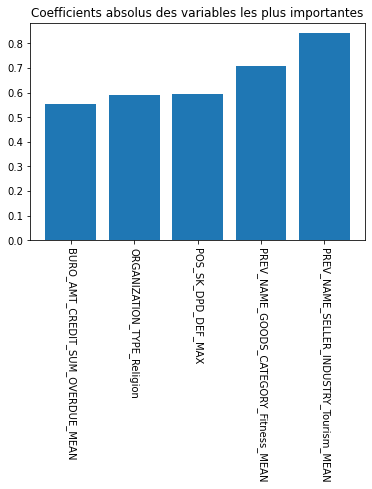

In [304]:
comb1 = [x[0] for x in sor01[-5:]]
comb2 = [x[1] for x in sor01[-5:]]

plt.title("Coefficients absolus des variables les plus importantes")
plt.bar(comb1,comb2)
plt.xticks(range(len(comb1)),comb1,rotation=-90)
plt.show()

In [275]:
sor02[-5:]

[('PREV_PRODUCT_COMBINATION_POSindustrywithinterest_MEAN',
  0.0017600000000000283),
 ('AMT_ANNUITY', 0.001920000000000055),
 ('PREV_PRODUCT_COMBINATION_CashXSellhigh_MEAN', 0.002240000000000042),
 ('PREV_AMT_CREDIT_MEAN', 0.0026400000000000425),
 ('DAYS_BIRTH', 0.00512000000000008)]

In [278]:
X100 = shap.utils.sample(X_lean, 700) #X_ltrain

In [279]:
explainer = shap.Explainer(pipe_final.predict, X100)
shap_values = explainer(X100)

Permutation explainer: 701it [02:30,  4.46it/s]                                                                        


In [280]:
shap_values.values.shape

(700, 385)

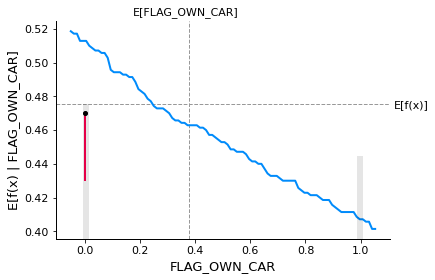

In [281]:
sample_ind = 0
shap.partial_dependence_plot(
    "FLAG_OWN_CAR", pipe_final.predict, X100, model_expected_value=True,
    feature_expected_value=True, ice=False,
    shap_values=shap_values[sample_ind:sample_ind+1,:]
)

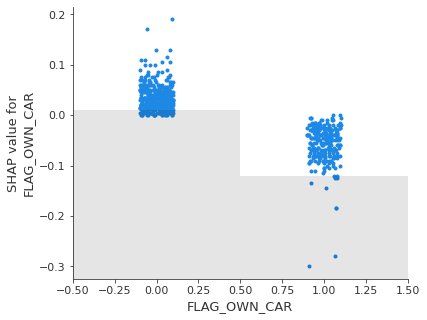

In [282]:
shap.plots.scatter(shap_values[:,"FLAG_OWN_CAR"])

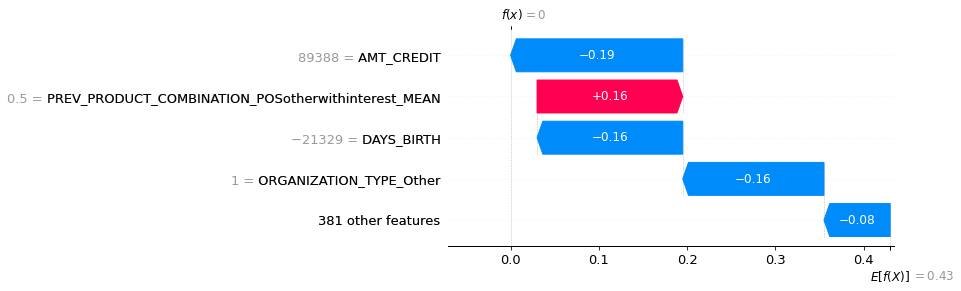

In [283]:
shap.plots.waterfall(shap_values[sample_ind], max_display=5)

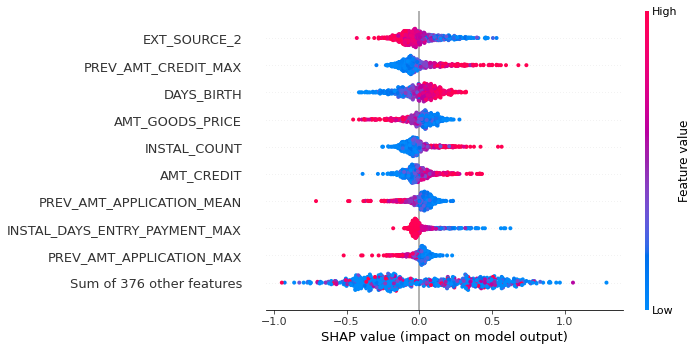

In [284]:
shap.plots.beeswarm(shap_values)

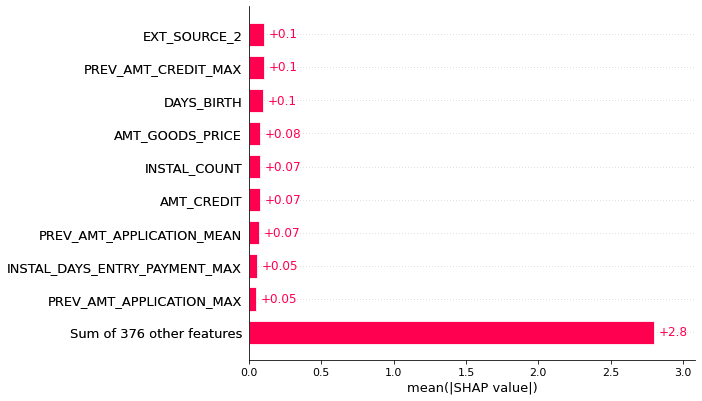

In [285]:
shap.plots.bar(shap_values)

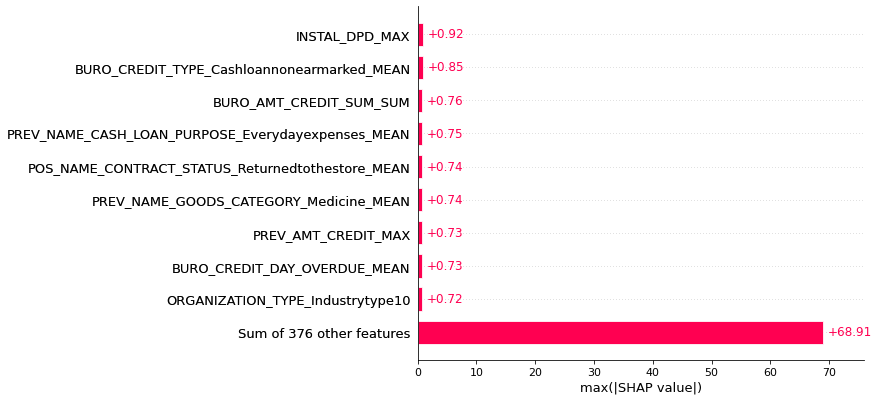

In [286]:
shap.plots.bar(shap_values.abs.max(0))

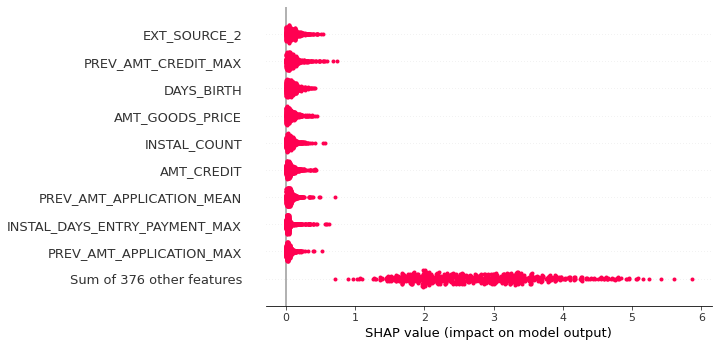

In [287]:
shap.plots.beeswarm(shap_values.abs, color="shap_red")

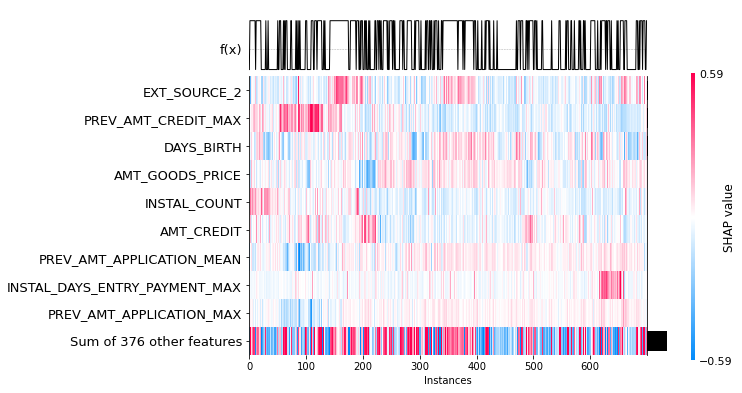

In [288]:
shap.plots.heatmap(shap_values[:1000])

In [289]:
X_tract = X_lean.loc[X_lean.index[0:50]]

In [290]:
def probas(data):
    return pipe_final.predict_proba(data)
explainer = lime.lime_tabular.LimeTabularExplainer(np.array(X_ltrain), 
                                                   training_labels=np.array(y_ltrain),
                                                   feature_names=list(X_ltrain.columns))

X does not have valid feature names, but StandardScaler was fitted with feature names


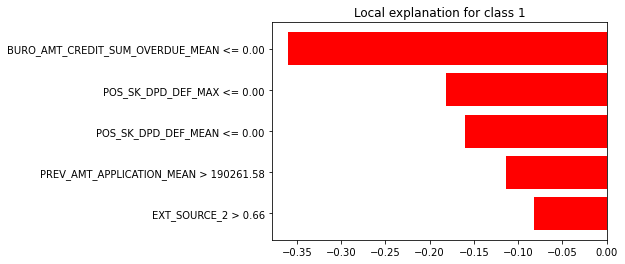

In [291]:
# Importance locale des features pour Logistic Regression
line = X_tract.loc[X_tract.index[0]]
exp = explainer.explain_instance(line.values, probas, num_features=5)
exp.as_pyplot_figure(label=1)
pass

## Export du modèle et des éléments nécessaires à son fonctionnement

In [292]:
X_tract.to_csv('X_tract.csv',index=False)
data_lean.to_csv('data_lean.csv',index=False)
X_ltrain.to_csv('X_ltrain.csv',index=False)
y_ltrain.to_csv('y_ltrain.csv',index=False)

In [293]:
joblib.dump(pipe_final, 'pipeline_final.pkl')
col = list(X_lean.columns)
joblib.dump(col, 'feat_cols.pkl')

['feat_cols.pkl']

In [294]:
pipe_final.predict(X_lean)

array([0, 1, 1, ..., 1, 1, 0], dtype=int64)